<h1 align="center"> EL7037 </h1>
<h2 align="center"> Tarea 1: Programación Genética </h2>
<h3 align="center"> Problema 1/2 - Regresión simbólica de funciones </h3>
***

In [1]:
%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Image
import pydotplus
import jpype
import os
from utilsGPalta import *
from tqdm import tqdm

In [2]:
# --- Rutas / classpath ---
libGPjar = 'GPaltav2.jar'
jar_path = os.path.join(os.getcwd(), libGPjar)

if not os.path.exists(jar_path):
    raise FileNotFoundError(f"No se encontró el JAR en: {jar_path}")

# Si en el futuro agregas más JARs o carpetas de clases:
# otros = [r"C:\mi\otra\carpeta\clases", r"C:\algo\lib2.jar"]
# classpath = os.pathsep.join([jar_path] + otros)
classpath = jar_path  # por ahora solo tu GPaltav2.jar

# --- Arranque JVM ---
jvmPath = jpype.getDefaultJVMPath()

# OJO: pasar los args desglosados con * y activar convertStrings
jvm_args = [f"-Djava.class.path={classpath}"]

if not jpype.isJVMStarted():
    jpype.startJVM(
        jvmPath,
        *jvm_args,
        convertStrings=True  # <-- clave para que java.lang.String sea str de Python
    )
GP = jpype.JPackage("gpalta")

### Configuración GP

In [3]:
config = GP.core.Config('Config.txt')

# ---------------- 1) Conjunto de terminales ----------------
# la variable 'x' y constantes aleatorias
config.constLowLimit  = 0      # límite inferior para constantes terminales
config.constUpLimit   = 10     # límite superior para constantes terminales

##### ---- Funciones disponibles --- 
#['Cos', 'Sin', 'Exponential', 'Square', 'SquareRoot', 'Divide', 'Plus', 'Minus', 'Times']
# ---------------- 2) Conjunto de funciones primitivas ----------------
selectedFuntion = ['Plus', 'Minus', 'Times','Divide']
setFuntions(selectedFuntion)

# ---------------- 3) Medida de fitness ----------------
config.fitness        = 'gpalta.core.FitnessClassic'        # criterio de fitness

# ---------------- 4) Parámetros que controlan la simulación ----------------
config.nGenerations   = 1000     # numero de generaciones
config.populationSize = 100       # tamaño de la poblacion
config.maxDepth       = 4     # profundidad maxima
config.initialMinDepth= 3        # profundidad minima arboles poblacion inicial
config.initialMaxDepth= 4        # profundidad maxima arboles poblacion inicial
config.population     = 'gpalta.core.SingleTreePopulation'  # numero de salidas-arboles

config.constLowLimit  = 0
config.constUpLimit   = 10
prob_mutation         = 0.15
prob_crossover        = 0.7
# probability of crossover = upLimitProbCrossOver - 0
# probability of mutation = upLimitProbMutation - upLimitProbCrossOver
# probability of reproduction = 1 - upLimitProbMutation
config.upLimitProbCrossOver = prob_crossover
config.upLimitProbMutation  = prob_mutation + prob_crossover


## Expresión matemática a encontrar
$$
f(x)=2\cdot x^{3}-x^{2}-x+5
$$

### Creación base de datos

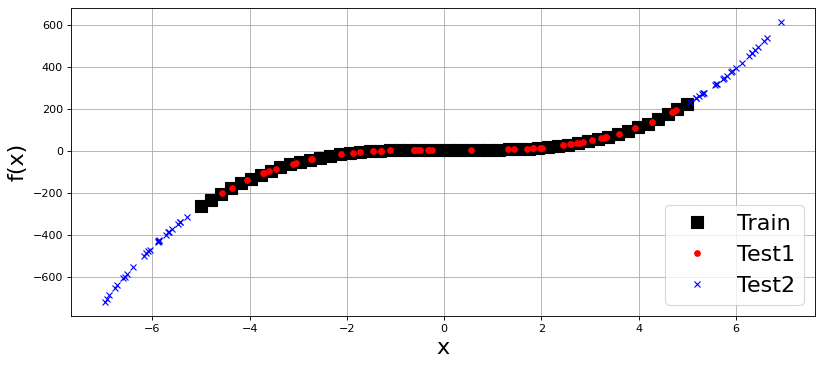

In [4]:
fnc = lambda x: (2*np.power(x, 3) - np.power(x, 2) - x + 5)   # Función objetivo f(x)
limitInner = [-5.0, 5.0]   # Rango de ENTRENAMIENTO [xmin, xmax]
limitOuter = [-7.0, 7.0]   # Rango EXTERNO (para tests fuera del entrenamiento)
n_train = 50               # Nº de puntos equidistantes para entrenamiento (P1 pide 50)
n_test1 = 50               # Nº de puntos aleatorios para Test 1 
n_test2 = 50               # Nº de puntos aleatorios para Test 2
seed = 42                  # Semilla para reproducibilidad en muestreos aleatorios (opcional)

# --------- Entrenamiento ---------
x_train = np.linspace(limitInner[0], limitInner[1], n_train, dtype=np.float64)
y_train = fnc(x_train)

# --------- Test 1  ---------
rng = np.random.default_rng(seed)  # generador reproducible
x_test1 = rng.uniform(low=limitInner[0], high=limitInner[1], size=n_test1).astype(np.float64)
y_test1 = fnc(x_test1)

# Test 2 
n2_left = n_test2 // 2
n2_right = n_test2 - n2_left
x_left  = rng.uniform(low=limitOuter[0], high=limitInner[0], size=n2_left)
x_right = rng.uniform(low=limitInner[1], high=limitOuter[1], size=n2_right)
x_test2 = np.concatenate([x_left, x_right]).astype(np.float64)
y_test2 = fnc(x_test2)
plt.close()
fig = plt.figure(figsize=(12, 5), dpi=80)
ax = fig.add_subplot(1,1,1)
ax.plot(x_train, y_train, 'ks', label='Train', linewidth=2,markersize=10)
ax.plot(x_test1, y_test1, 'ro', label='Test1', linewidth=1,markersize=5)
ax.plot(x_test2, y_test2, 'bx', label='Test2', linewidth=1,markersize=5)
ax.set_xlabel('x',size=20) 
ax.set_ylabel('f(x)',size=20) 
ax.grid()
ax.legend(loc='lower right',fontsize=20)

## Main loop GP

In [5]:
names   = ['fitness', 'nodes', 'MSETrain', 'MSETest1', 'MSETest2', 'EvalTrain', 'EvalTest1', 'EvalTest2','tree']
formats = [np.float64, np.float64, np.float64, np.float64, np.float64,
           np.float64, np.float64, np.float64, object]
dtypes  = list(zip(names, formats))
dtypes[5] += ((n_train,),)
dtypes[6] += ((n_test1,),)
dtypes[7] += ((n_test2,),)
R = np.empty((config.populationSize, config.nGenerations),dtype=dtypes)

msefun = lambda x,y: np.mean(np.power(x-y,2))
evo = GP.core.Evolution(config, py2java(x_train,True),py2java(y_train), py2java(np.zeros((1,n_train))),True)
evo.eval()
for gen in tqdm(range(config.nGenerations), desc='Generation'):
    # ------ Condicion de termino GP por tolerancia fitness ---------------
    if (evo.evoStats.bestSoFar.readFitness() >= config.stopFitness):
        print('\nObjective reached in generation %d',gen)
        break
    evo.evolve()
    evo.eval()
    for ind in range(config.populationSize):
        R['fitness'][ind,gen]   = evo.population.get(ind).readFitness()
        R['nodes'][ind,gen]     = evo.population.get(ind).getMaxDepthFromHere()
        R['tree'][ind,gen]      = evo.population.get(ind)
        R['EvalTrain'][ind,gen] = java2py((evo.getRawOutput(evo.population.get(ind),py2java(x_train,True)).x))
        R['EvalTest1'][ind,gen] = java2py((evo.getRawOutput(evo.population.get(ind),py2java(x_test1,True)).x))
        R['EvalTest2'][ind,gen] = java2py((evo.getRawOutput(evo.population.get(ind),py2java(x_test2,True)).x))
        R['MSETrain'][ind,gen]  = msefun(R['EvalTrain'][ind,gen],y_train)
        R['MSETest1'][ind,gen]  = msefun(R['EvalTest1'][ind,gen],y_test1)
        R['MSETest2'][ind,gen]  = msefun(R['EvalTest2'][ind,gen],y_test2)

Generation: 100%|██████████| 1000/1000 [00:32<00:00, 30.53it/s]


## Mejor árbol encontrado

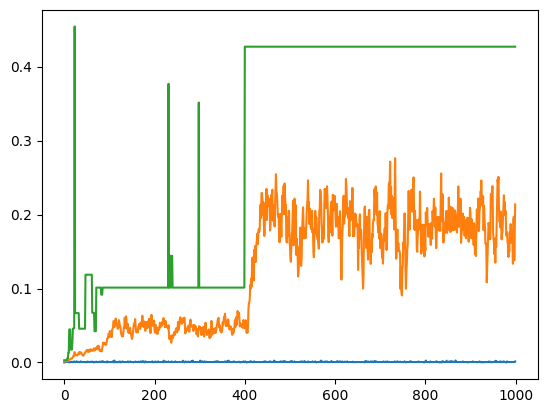

In [6]:

import matplotlib.pyplot as plt
plt.figure()
plt.plot(R['fitness'].min(axis=0))
plt.plot(R['fitness'].mean(axis=0))
plt.plot(R['fitness'].max(axis=0))
plt.show()

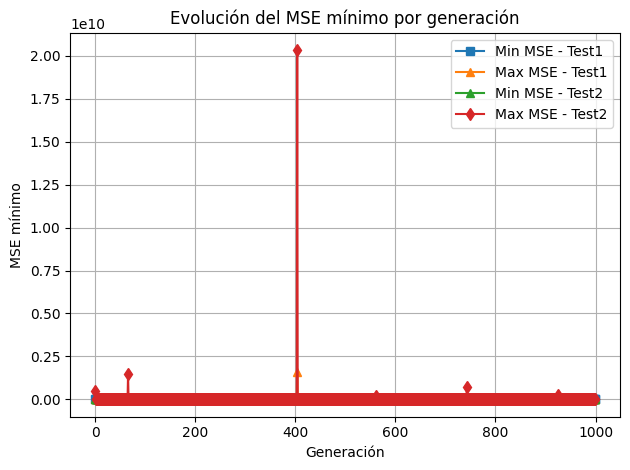

In [7]:
import matplotlib.pyplot as plt

# --- Detectar generaciones realmente completadas (por si hubo early-stop) ---
# Usamos fitness>0 como señal de generación evaluada; ajusta el umbral si tu fitness puede ser 0.
gen_valid = np.any(R['fitness'] > 0, axis=0)
if not np.any(gen_valid):
    raise ValueError("No hay generaciones válidas con fitness > 0.")

# --- Tomar mínimo MSE por generación (sobre todos los individuos) ---
#min_mse_train = np.nanmin(R['MSETrain'][:, gen_valid], axis=0)
#max_mse_train = np.nanmax(R['MSETrain'][:, gen_valid], axis=0)
min_mse_test1 = np.nanmin(R['MSETest1'][:, gen_valid], axis=0)
max_mse_test1 = np.nanmax(R['MSETest1'][:, gen_valid], axis=0)
min_mse_test2 = np.nanmin(R['MSETest2'][:, gen_valid], axis=0)
max_mse_test2 = np.nanmax(R['MSETest2'][:, gen_valid], axis=0)
gens = np.arange(np.sum(gen_valid))  # eje x para las generaciones válidas, reindexadas

# --- Graficar ---
plt.figure()
#plt.plot(gens, min_mse_train, marker='o', label='Min MSE - Train')
#plt.plot(gens, max_mse_train, marker='x', label='Max MSE - Train')
plt.plot(gens, min_mse_test1, marker='s', label='Min MSE - Test1')
plt.plot(gens, max_mse_test1, marker='^', label='Max MSE - Test1')
plt.plot(gens, min_mse_test2, marker='^', label='Min MSE - Test2')
plt.plot(gens, max_mse_test2, marker='d', label='Max MSE - Test2')
plt.xlabel('Generación')
plt.ylabel('MSE mínimo')
plt.title('Evolución del MSE mínimo por generación')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

In [8]:
R1 = R.copy()
R2 = R.copy()

Rt = np.concatenate((R1[:,:,np.newaxis], R2[:,:,np.newaxis]), axis=2)
# Rt['fitness'].min(axis=0).mean(axis=1)

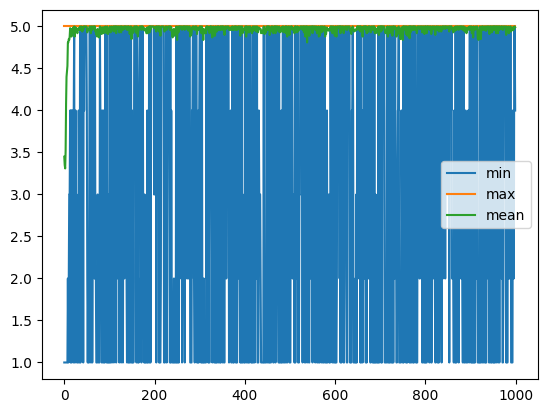

In [9]:
R1 = R.copy()
R2 = R.copy()

Rt = np.concatenate((R1[:,:,np.newaxis], R2[:,:,np.newaxis]), axis=2)
# Rt['fitness'].min(axis=0).mean(axis=1)
plt.figure()
plt.plot(Rt['nodes'].min(axis=0).mean(axis=1),label='min')
plt.plot(Rt['nodes'].max(axis=0).mean(axis=1),label='max')
plt.plot(Rt['nodes'].mean(axis=0).mean(axis=1),label='mean')
plt.legend()

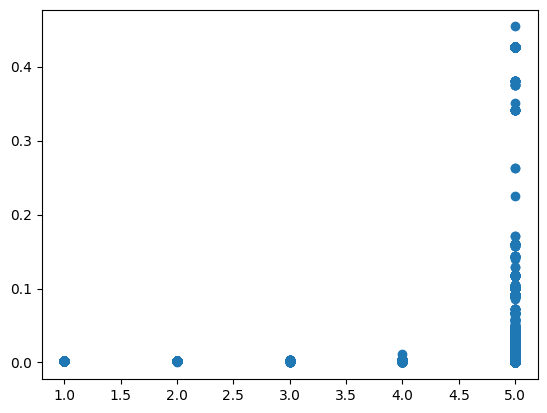

In [10]:
plt.figure()
plt.scatter(Rt['nodes'][:,:,0],Rt['fitness'][:,:,0])

In [11]:
R['tree']

array([[<java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>, ...,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>],
       [<java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>, ...,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>],
       [<java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>, ...,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>],
       ...,
       [<java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>, ...,
        <java object 'gpalta.core.Tree'>,
        <java object 'gpalta.core.Tree'>,

(plus (minus (times (times X1 X1) X1) (plus (times X1 X1) X1)) (plus (minus X1 (minus X1 4.830137403238296)) (times X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.45432
MSE         : 0.02885
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.830137403238296
*******************************************************************
 
                             TREE


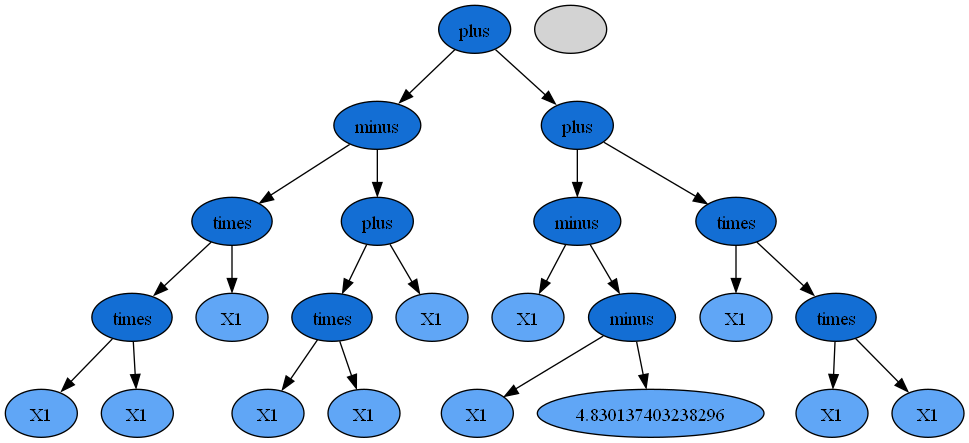

In [12]:
errtreebestsofar = java2py(evo.getRawOutput(evo.evoStats.bestSoFar).x) 
print(evo.evoStats.bestSoFar)
print('*******************************************************************')
print('                    WINNER TREE, BEST SO FAR ' )
print(' ')
print('FITNESS     : %.5f' %(evo.evoStats.bestSoFar.readFitness()))
print('MSE         : %.5f' %(msefun(errtreebestsofar, y_train)))
print('DEPTH       : %.5f' %(evo.evoStats.bestSoFar.getMaxDepthFromHere()))
print('*******************************************************************')
print(' ')
print('                        REDUCED TREE')
print('             %s' % getReducedAlgebraic(evo.evoStats.bestSoFar))
print('*******************************************************************')
print(' ')
print('                             TREE')

graph = pydotplus.graphviz.graph_from_dot_data(getTree2plot(evo.evoStats.bestSoFar))
Image(graph.create_png())

np.where(R['MSETrain']==R['MSETrain'].min()) # Encuentra mínimo error de entrenamiento

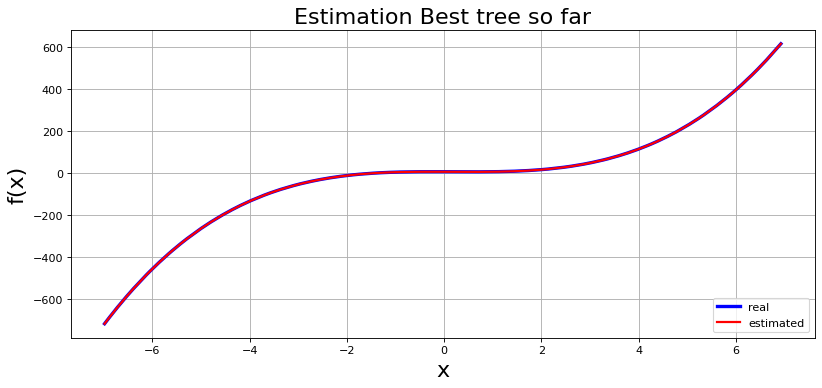

In [13]:
xx      = np.hstack((x_test1,x_test2,x_train))
yy_real = np.hstack((y_test1,y_test2,y_train))
yy_est  = np.hstack((java2py((evo.getRawOutput(evo.evoStats.bestSoFar,py2java(x_test1,True)).x)),
                     java2py((evo.getRawOutput(evo.evoStats.bestSoFar,py2java(x_test2,True)).x)),
                     java2py((evo.getRawOutput(evo.evoStats.bestSoFar,py2java(x_train,True)).x)),))
idx = np.argsort(xx)
xx      = xx[idx]
yy_real = yy_real[idx]
yy_est  = yy_est[idx]
fig = plt.figure(figsize=(12, 5), dpi=80)
ax = fig.add_subplot(1,1,1)
ax.plot(xx, yy_real,'b', label='real', linewidth=3)
ax.plot(xx, yy_est, 'r', label='estimated', linewidth=2)
ax.set_xlabel('x',size=20) 
ax.set_ylabel('f(x)',size=20) 
ax.set_title('Estimation Best tree so far', fontsize=20)
ax.grid()
ax.legend(loc='lower right',fontsize=10)


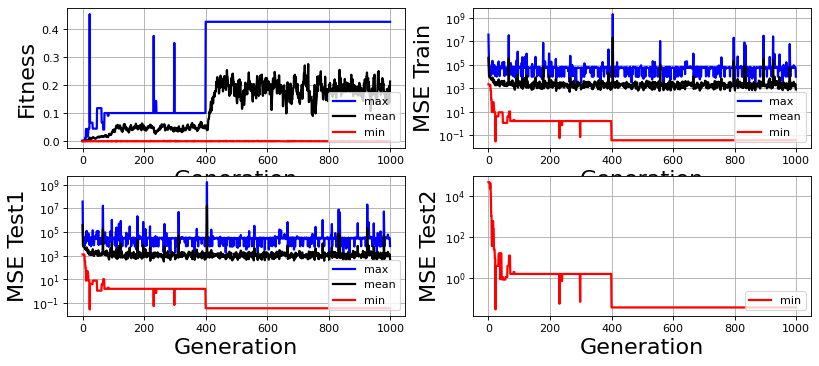

In [14]:
plt.close()
fig = plt.figure(figsize=(12, 5), dpi=80)

# Fitness vs Generacion
ax = fig.add_subplot(2,2,1)
ax.plot(np.arange(config.nGenerations), R['fitness'].max(axis=0), 'b', label='max', linewidth=2)
ax.plot(np.arange(config.nGenerations), R['fitness'].mean(axis=0), 'k', label='mean', linewidth=2)
ax.plot(np.arange(config.nGenerations), R['fitness'].min(axis=0), 'r', label='min', linewidth=2)
ax.set_xlabel('Generation',size=20) 
ax.set_ylabel('Fitness',size=20) 
ax.grid()
ax.legend(loc='lower right',fontsize=10)

# MSE entrenamiento vs Generacion
ax = fig.add_subplot(2,2,2)
ax.plot(np.arange(config.nGenerations), R['MSETrain'].max(axis=0), 'b', label='max', linewidth=2)
ax.plot(np.arange(config.nGenerations), R['MSETrain'].mean(axis=0), 'k', label='mean', linewidth=2)
ax.plot(np.arange(config.nGenerations), R['MSETrain'].min(axis=0), 'r', label='min', linewidth=2)
ax.set_xlabel('Generation',size=20) 
ax.set_ylabel('MSE Train',size=20) 
ax.set_yscale('log')
ax.grid()
ax.legend(loc='lower right',fontsize=10)

# MSE test1 vs Generacion
ax = fig.add_subplot(2,2,3)
ax.plot(np.arange(config.nGenerations), R['MSETest1'].max(axis=0), 'b', label='max', linewidth=2)
ax.plot(np.arange(config.nGenerations), R['MSETest1'].mean(axis=0), 'k', label='mean', linewidth=2)
ax.plot(np.arange(config.nGenerations), R['MSETest1'].min(axis=0), 'r', label='min', linewidth=2)
ax.set_xlabel('Generation',size=20) 
ax.set_ylabel('MSE Test1',size=20) 
ax.set_yscale('log')
ax.grid()
ax.legend(loc='lower right',fontsize=10)

# MSE test2 vs Generacion
ax = fig.add_subplot(2,2,4)
#ax.plot(np.arange(config.nGenerations), R['MSETest2'].max(axis=0), 'b', label='max', linewidth=2)
#ax.plot(np.arange(config.nGenerations), R['MSETest2'].mean(axis=0), 'k', label='mean', linewidth=2)
ax.plot(np.arange(config.nGenerations), R['MSETest2'].min(axis=0), 'r', label='min', linewidth=2)
ax.set_xlabel('Generation',size=20) 
ax.set_ylabel('MSE Test2',size=20) 
ax.set_yscale('log')
ax.grid()
ax.legend(loc='lower right',fontsize=10)

***
## Metodología para analizar árbol específico
### Árbol-individuo 6,  generación 3

REDUCED TREE: 0.1073718549609746*X1
*******************************************************************
 
 ---------------------- TREE -------------------------------------


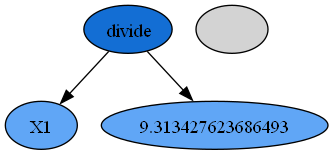

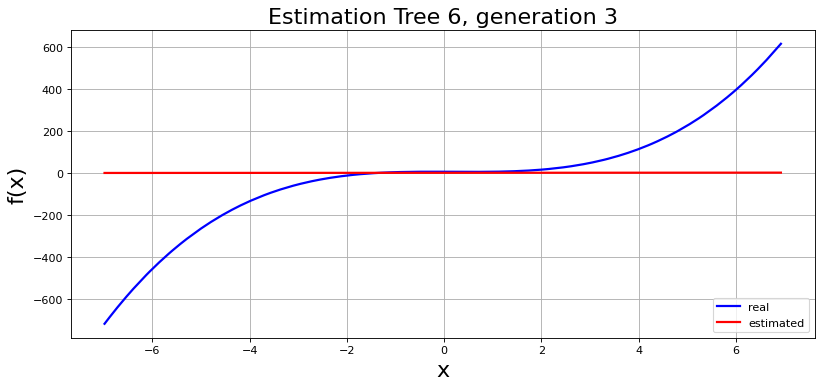

In [15]:
tree_check = [6,3] # Arbol 6 de la generacion 3 

xx      = np.hstack((x_test1,x_test2,x_train))
yy_real = np.hstack((y_test1,y_test2,y_train))
yy_est  = np.hstack((R['EvalTest1'][tree_check[0],tree_check[1]],
                     R['EvalTest2'][tree_check[0],tree_check[1]],
                     R['EvalTrain'][tree_check[0],tree_check[1]]))
idx = np.argsort(xx)
xx      = xx[idx]
yy_real = yy_real[idx]
yy_est  = yy_est[idx]
fig = plt.figure(figsize=(12, 5), dpi=80)
ax = fig.add_subplot(1,1,1)
ax.plot(xx, yy_real,'b', label='real', linewidth=2)
ax.plot(xx, yy_est, 'r', label='estimated', linewidth=2)
ax.set_xlabel('x',size=20) 
ax.set_ylabel('f(x)',size=20) 
ax.set_title('Estimation Tree %d, generation %d'%(tree_check[0],tree_check[1]), fontsize=20)
ax.grid()
ax.legend(loc='lower right',fontsize=10)

print('REDUCED TREE: %s' % getReducedAlgebraic(R['tree'][tree_check[0],tree_check[1]]))
print('*******************************************************************')
print(' ')
print(' ---------------------- TREE -------------------------------------')

graph = pydotplus.graphviz.graph_from_dot_data(getTree2plot(R['tree'][tree_check[0],tree_check[1]]))
Image(graph.create_png())

In [16]:
## Finalizar máquina virtual de java
## Ejecute este comando sólo cuando termine la sesión. Al cerrar la máquina virtual, no es posible graficar árboles

# jpype.shutdownJVM()

In [17]:
def build_gp_config(
    n_generations=1000,           # 4) Nº de generaciones
    population_size=100,          # 4) Tamaño de población
    max_depth=4,                  # 4) Profundidad máxima de árboles
    initial_min_depth=3,          # 4) Profundidad mínima inicial
    initial_max_depth=4,          # 4) Profundidad máxima inicial
    const_low=0.0,                # 1) Terminales: límite inferior constantes
    const_up=10.0,                # 1) Terminales: límite superior constantes
    fitness_str='gpalta.core.FitnessClassic',  # 3) Medida de fitness
    prob_mutation=0.15,           # 4) Operadores: p(mutación)
    prob_crossover=0.70,          # 4) Operadores: p(crossover)
    population_str='gpalta.core.SingleTreePopulation',  # 4) Tipo de población
    selection_method = 'tournament'
):
    """
    Devuelve un objeto GP.core.Config configurado.
    """
    config = GP.core.Config('Config.txt')

    # ---------------- 1) Conjunto de terminales ----------------
    # la variable 'x' y constantes aleatorias
    config.constLowLimit  = const_low      # límite inferior para constantes terminales
    config.constUpLimit   = const_up     # límite superior para constantes terminales

    ##### ---- Funciones disponibles --- 
    #['Cos', 'Sin', 'Exponential', 'Square', 'SquareRoot', 'Divide', 'Plus', 'Minus', 'Times']
    # ---------------- 2) Conjunto de funciones primitivas ----------------
    selectedFuntion = ['Plus', 'Minus', 'Times','Divide']
    setFuntions(selectedFuntion)

    # ---------------- 3) Medida de fitness ----------------
    config.fitness        = fitness_str        # criterio de fitness

    # ---------------- 4) Parámetros que controlan la simulación ----------------
    config.nGenerations   = n_generations     # numero de generaciones
    config.populationSize = population_size       # tamaño de la poblacion
    config.maxDepth       = max_depth     # profundidad maxima
    config.initialMinDepth= initial_min_depth        # profundidad minima arboles poblacion inicial
    config.initialMaxDepth= initial_max_depth        # profundidad maxima arboles poblacion inicial
    config.population     = population_str  # numero de salidas-arboles

    method_map = {
        'tournament'  : 'gpalta.ops.IndSelectorTournament',
        'roulette'    : 'gpalta.ops.IndSelectorRoulette',
        'proportional': 'gpalta.ops.IndSelectorProportional',
        'SUS'         : 'gpalta.ops.IndSelectorSUS',
        'sus'         : 'gpalta.ops.IndSelectorSUS',
    }
    config.selectionMethod    = method_map[selection_method]
    # probability of crossover = upLimitProbCrossOver - 0
    # probability of mutation = upLimitProbMutation - upLimitProbCrossOver
    # probability of reproduction = 1 - upLimitProbMutation
    config.upLimitProbCrossOver = prob_crossover
    config.upLimitProbMutation  = prob_mutation + prob_crossover

    return config


In [18]:

def run_gp(
    config, x_train, y_train, x_test1, y_test1, x_test2, y_test2
):
    names   = ['fitness', 'nodes', 'MSETrain', 'MSETest1', 'MSETest2', 'EvalTrain', 'EvalTest1', 'EvalTest2','tree']
    formats = [np.float64, np.float64, np.float64, np.float64, np.float64,
           np.float64, np.float64, np.float64, object]
    
    dtypes  = list(zip(names, formats))
    dtypes[5] += ((n_train,),)
    dtypes[6] += ((n_test1,),)
    dtypes[7] += ((n_test2,),)
    
    R = np.empty((config.populationSize, config.nGenerations),dtype=dtypes)

    msefun = lambda x,y: np.mean(np.power(x-y,2))
    evo = GP.core.Evolution(config, py2java(x_train,True),py2java(y_train), py2java(np.zeros((1,n_train))),True)
    evo.eval()
   
    for gen in tqdm(range(config.nGenerations), desc='Generation'):
       # ------ Condicion de termino GP por tolerancia fitness ---------------
       if (evo.evoStats.bestSoFar.readFitness() >= config.stopFitness):
           print('\nObjective reached in generation %d',gen)
           break
       evo.evolve()
       evo.eval()
       for ind in range(config.populationSize):
           R['fitness'][ind,gen]   = evo.population.get(ind).readFitness()
           R['nodes'][ind,gen]     = evo.population.get(ind).getMaxDepthFromHere()
           R['tree'][ind,gen]      = evo.population.get(ind)
           R['EvalTrain'][ind,gen] = java2py((evo.getRawOutput(evo.population.get(ind),py2java(x_train,True)).x))
           R['EvalTest1'][ind,gen] = java2py((evo.getRawOutput(evo.population.get(ind),py2java(x_test1,True)).x))
           R['EvalTest2'][ind,gen] = java2py((evo.getRawOutput(evo.population.get(ind),py2java(x_test2,True)).x))
           R['MSETrain'][ind,gen]  = msefun(R['EvalTrain'][ind,gen],y_train)
           R['MSETest1'][ind,gen]  = msefun(R['EvalTest1'][ind,gen],y_test1)
           R['MSETest2'][ind,gen]  = msefun(R['EvalTest2'][ind,gen],y_test2)
    return R, evo

In [ ]:
def depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth):
    Rt = np.concatenate(
        [R1[:, :, np.newaxis],
         R2[:, :, np.newaxis],
         R3[:, :, np.newaxis],
         R4[:, :, np.newaxis],
         R5[:, :, np.newaxis]],
        axis=2
    )
    plt.figure()
    plt.plot(Rt['nodes'].min(axis=0).mean(axis=1), label='min')
    plt.plot(Rt['nodes'].max(axis=0).mean(axis=1), label='max')
    plt.plot(Rt['nodes'].mean(axis=0).mean(axis=1), label='mean')
    plt.title(f'Evolución de la complejidad (N_gen={n_gen}, Max_depth={max_depth})')
    plt.xlabel('Generaciones')
    plt.ylabel('Profundidad (nodos)')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

    return Rt

In [20]:
def fitness_vs_nodes_plot(Rt, n_gen, max_depth, run_id=None):
    """
    Grafica fitness vs número de nodos para todos los individuos de todas las generaciones.
    """

    plt.figure()
    plt.scatter(Rt['nodes'][:,:,0],Rt['fitness'][:,:,0], label='individuos')
    plt.xlabel("Número de nodos (complejidad)")
    plt.ylabel("Fitness")
    title = f"Fitness vs complejidad (N_gen={n_gen}, Max_depth={max_depth})"
    if run_id is not None:
        title += f" - Run {run_id}"
    plt.title(title)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

In [21]:
def summary_plot_per_gen(R, n_gen, max_depth):
    fig = plt.figure(figsize=(16, 9), dpi=100)

    # Título global (sin ejes extras)
    fig.suptitle(f'N_gen={n_gen}, Max_depth={max_depth}',
                 fontsize=24, fontweight='bold')

    # Fitness vs Generacion
    ax = fig.add_subplot(2,2,1)
    ax.plot(np.arange(config.nGenerations), R['fitness'].max(axis=0), 'b', label='max', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['fitness'].mean(axis=0), 'k', label='mean', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['fitness'].min(axis=0), 'r', label='min', linewidth=2)
    ax.set_xlabel('Generation', size=14) 
    ax.set_ylabel('Fitness', size=14) 
    ax.grid()
    ax.legend(loc='lower right', fontsize=10)

    # MSE entrenamiento vs Generacion
    ax = fig.add_subplot(2,2,2)
    ax.plot(np.arange(config.nGenerations), R['MSETrain'].max(axis=0), 'b', label='max', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['MSETrain'].mean(axis=0), 'k', label='mean', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['MSETrain'].min(axis=0), 'r', label='min', linewidth=2)
    ax.set_xlabel('Generation', size=14) 
    ax.set_ylabel('MSE Train', size=14) 
    ax.set_yscale('log')
    ax.grid()
    ax.legend(loc='lower right', fontsize=10)

    # MSE test1 vs Generacion
    ax = fig.add_subplot(2,2,3)
    ax.plot(np.arange(config.nGenerations), R['MSETest1'].max(axis=0), 'b', label='max', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['MSETest1'].mean(axis=0), 'k', label='mean', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['MSETest1'].min(axis=0), 'r', label='min', linewidth=2)
    ax.set_xlabel('Generation', size=14) 
    ax.set_ylabel('MSE Test1', size=14) 
    ax.set_yscale('log')
    ax.grid()
    ax.legend(loc='lower right', fontsize=10)

    # MSE test2 vs Generacion
    ax = fig.add_subplot(2,2,4)
    ax.plot(np.arange(config.nGenerations), R['MSETest2'].max(axis=0), 'b', label='max', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['MSETest2'].mean(axis=0), 'k', label='mean', linewidth=2)
    ax.plot(np.arange(config.nGenerations), R['MSETest2'].min(axis=0), 'r', label='min', linewidth=2)
    ax.set_xlabel('Generation', size=14) 
    ax.set_ylabel('MSE Test2', size=14) 
    ax.set_yscale('log')
    ax.grid()
    ax.legend(loc='lower right', fontsize=10)

    plt.tight_layout(rect=[0, 0, 1, 0.96])  # deja espacio para el título global
    plt.show()

In [91]:
def tree_function(evo):
    errtreebestsofar = java2py(evo.getRawOutput(evo.evoStats.bestSoFar).x) 
    print(evo.evoStats.bestSoFar)
    print('*******************************************************************')
    print('                    WINNER TREE, BEST SO FAR ' )
    print(' ')
    print('FITNESS     : %.5f' %(evo.evoStats.bestSoFar.readFitness()))
    print('MSE         : %.5f' %(msefun(errtreebestsofar, y_train)))
    print('DEPTH       : %.5f' %(evo.evoStats.bestSoFar.getMaxDepthFromHere()))
    print('*******************************************************************')
    print(' ')
    print('                        REDUCED TREE')
    print('             %s' % getReducedAlgebraic(evo.evoStats.bestSoFar))
    print('*******************************************************************')
    print(' ')
    print('                             TREE')

    graph = pydotplus.graphviz.graph_from_dot_data(getTree2plot(evo.evoStats.bestSoFar))
    display(Image(graph.create_png()))

    xx      = np.hstack((x_test1,x_test2,x_train))
    yy_real = np.hstack((y_test1,y_test2,y_train))
    yy_est  = np.hstack((java2py((evo.getRawOutput(evo.evoStats.bestSoFar,py2java(x_test1,True)).x)),
                     java2py((evo.getRawOutput(evo.evoStats.bestSoFar,py2java(x_test2,True)).x)),
                     java2py((evo.getRawOutput(evo.evoStats.bestSoFar,py2java(x_train,True)).x)),))  
    idx = np.argsort(xx) 
    xx      = xx[idx]
    yy_real = yy_real[idx]
    yy_est  = yy_est[idx]
    fig = plt.figure(figsize=(12, 5), dpi=80)
    ax = fig.add_subplot(1,1,1)
    ax.plot(xx, yy_real,'b', label='real', linewidth=3)
    ax.plot(xx, yy_est, 'r', label='estimated', linewidth=2)
    ax.set_xlabel('x',size=20) 
    ax.set_ylabel('f(x)',size=20) 
    ax.set_title('Estimation Best tree so far', fontsize=20)
    ax.grid()
    ax.legend(loc='lower right',fontsize=10)
    plt.show()


Generation: 100%|██████████| 100/100 [00:03<00:00, 31.76it/s]


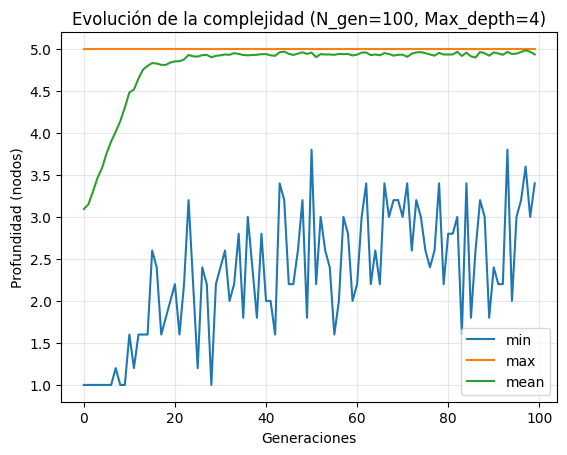

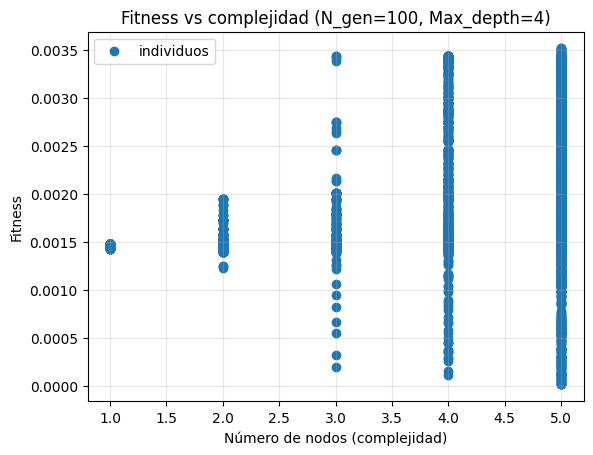

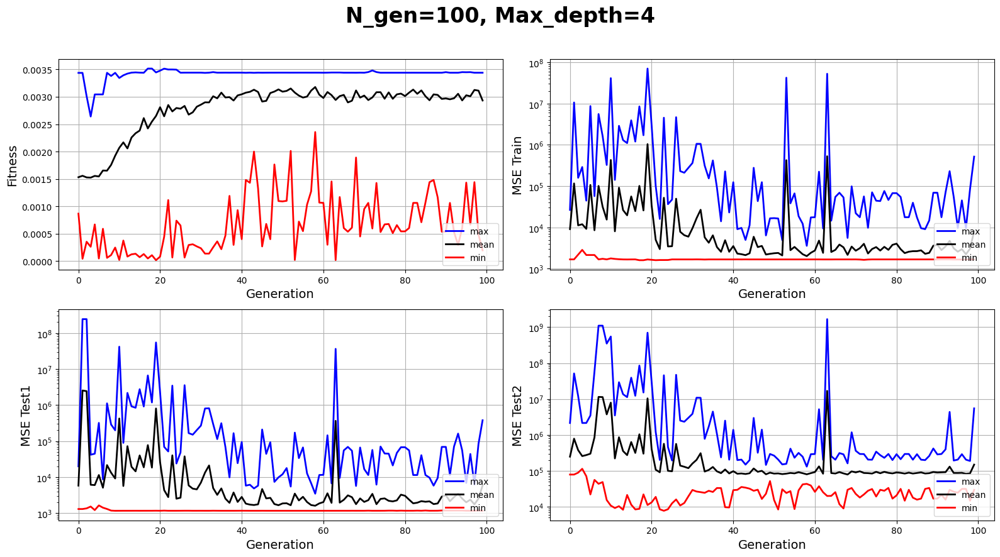

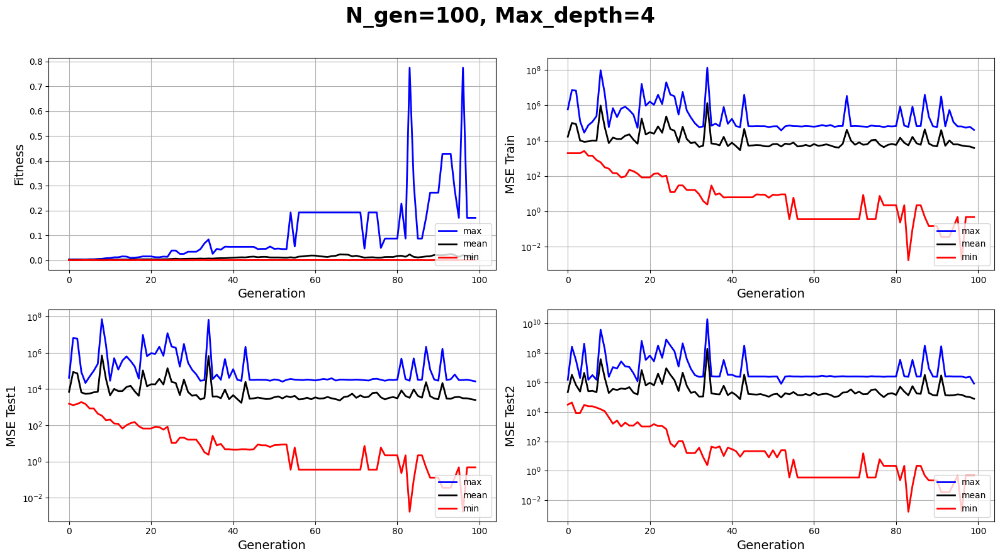

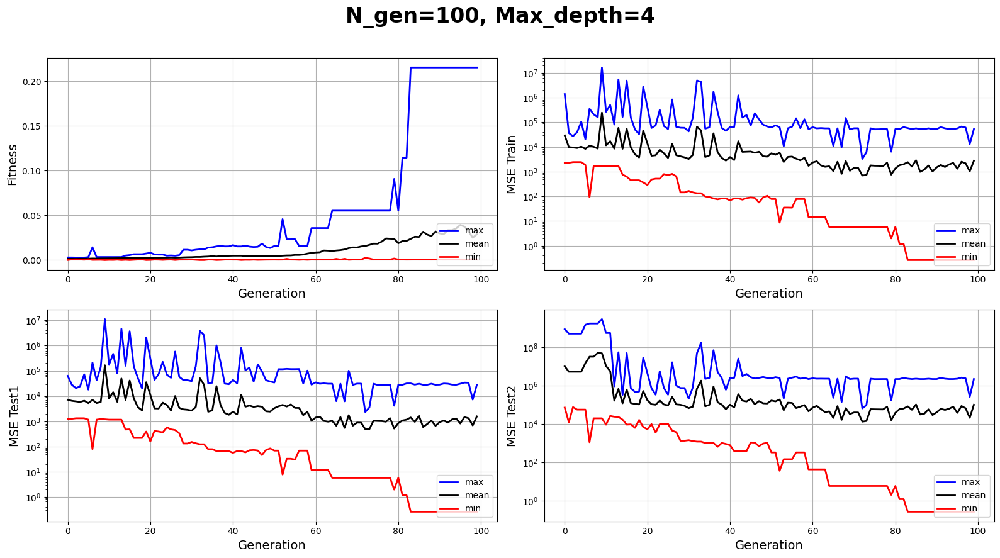

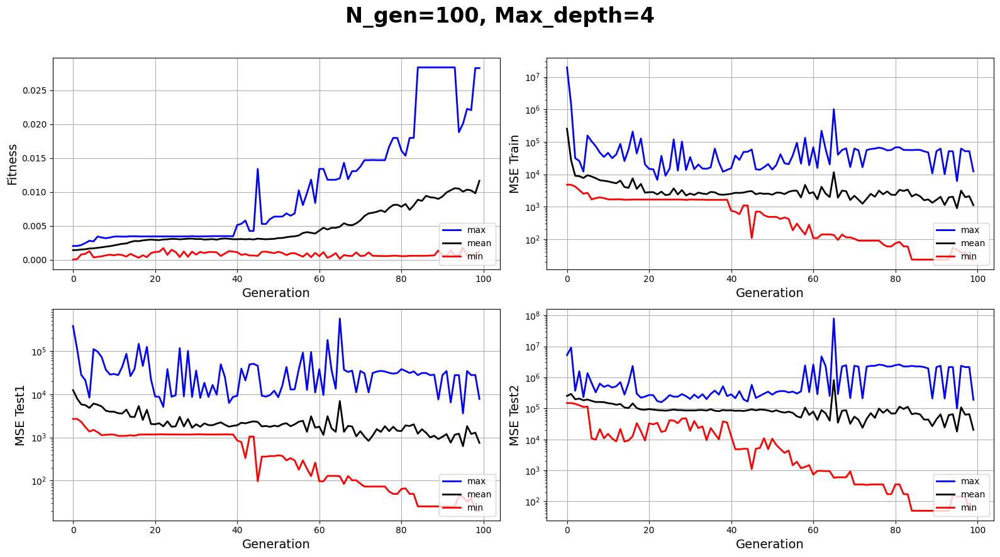

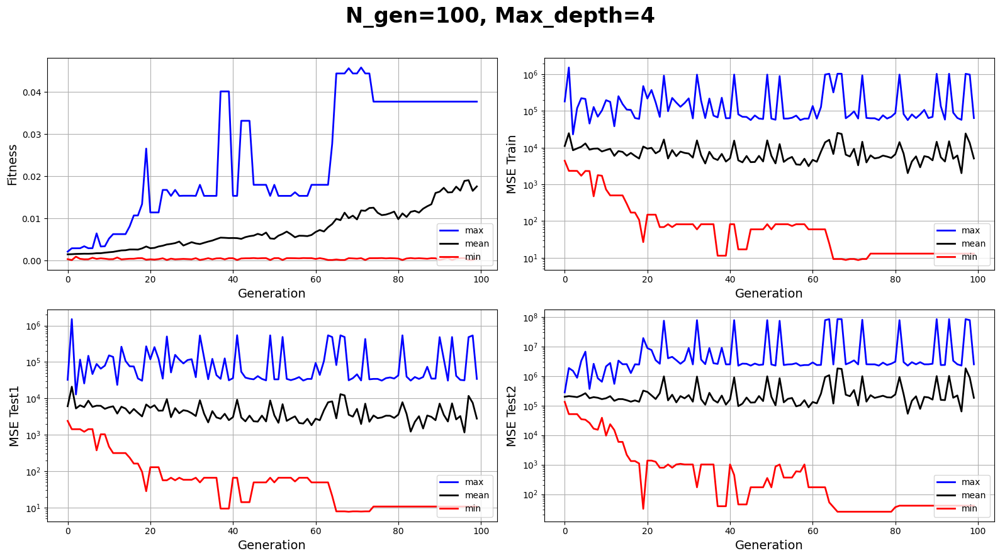

In [23]:
n_gen=100
max_depth=4
prob_mutation=0.15
prob_crossover=0.70 
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)
summary_plot_per_gen(R1, n_gen, max_depth)
summary_plot_per_gen(R2, n_gen, max_depth)
summary_plot_per_gen(R3, n_gen, max_depth)
summary_plot_per_gen(R4, n_gen, max_depth)
summary_plot_per_gen(R5, n_gen, max_depth)

(plus (plus (times (times 5.7282746891983125 X1) (minus 6.114095642641092 3.222338978254932)) (times X1 3.318291270541893)) (plus (minus 6.114095642641092 (times X1 X1)) (times 9.883275677992659 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00352
MSE         : 1606.58344
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             -X1**2 + 29.766343456458331*X1 + 6.114095642641092
*******************************************************************
 
                             TREE


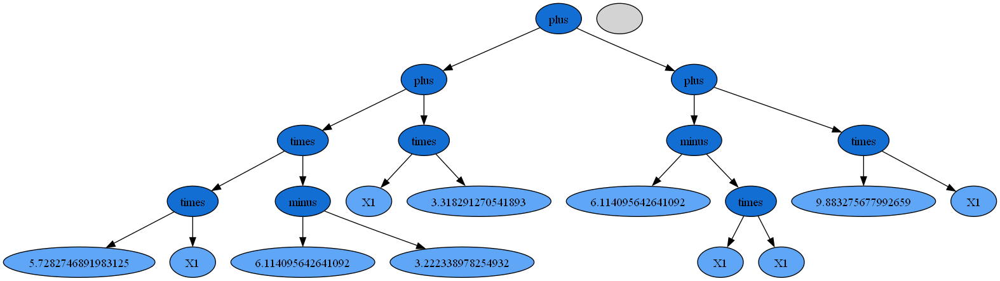

(plus (minus (times (plus X1 X1) (times X1 X1)) (times X1 X1)) (plus (plus X1 (minus 2.5205292443782112 X1)) (minus 2.5205292443782112 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.77500
MSE         : 0.00169
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.0410584887564224
*******************************************************************
 
                             TREE


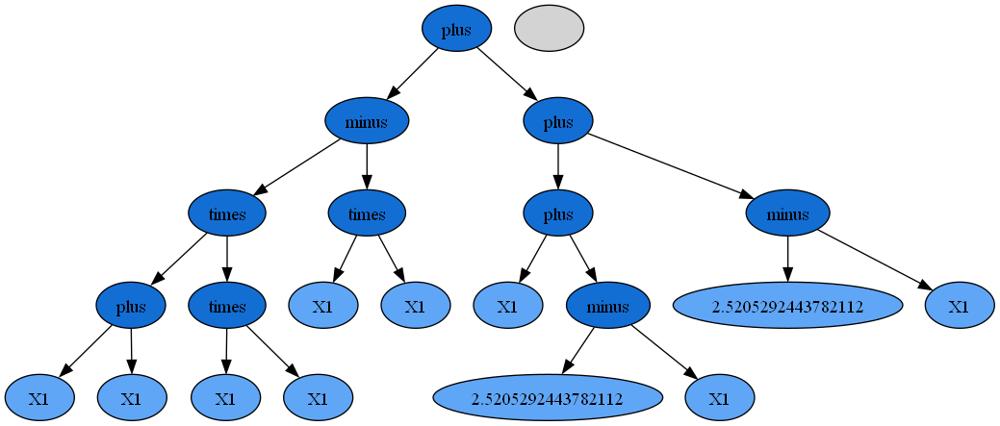

(plus (plus (times (times X1 X1) X1) (minus (times X1 X1) (times X1 X1))) (plus (times (times X1 X1) X1) (minus (minus 4.4846736377049865 X1) (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.21534
MSE         : 0.26556
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.4846736377049865
*******************************************************************
 
                             TREE


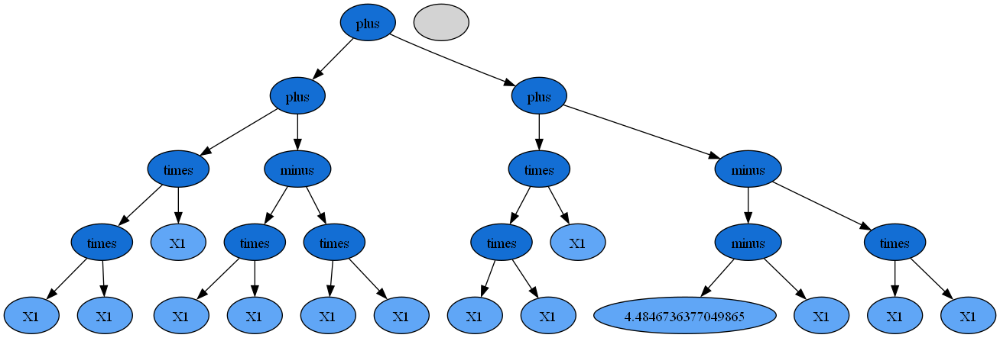

(plus (plus (minus X1 (times X1 X1)) (minus 8.843991212311973 X1)) (plus (times (times X1 X1) X1) (times (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02838
MSE         : 23.44974
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 + 8.843991212311973
*******************************************************************
 
                             TREE


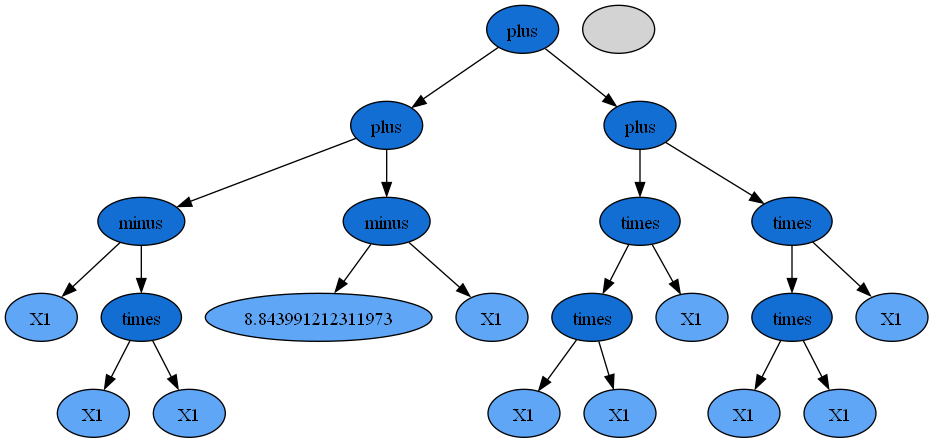

(plus (times (minus (times X1 X1) X1) X1) (plus (times (times X1 X1) X1) 4.95820426153796))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.04581
MSE         : 8.67522
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 + 4.95820426153796
*******************************************************************
 
                             TREE


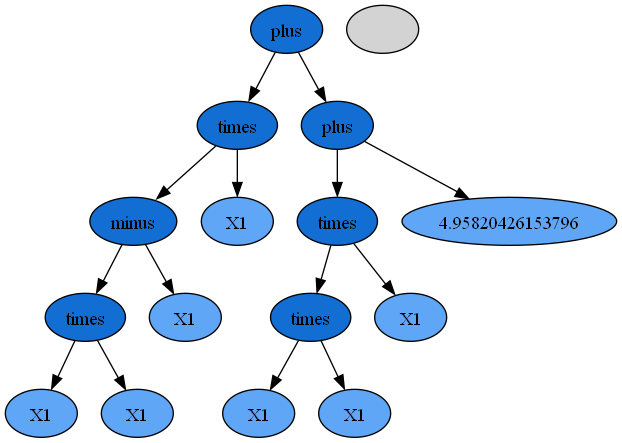

In [24]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)

In [25]:
import numpy as np
import matplotlib.pyplot as plt

def _stack_runs(R_list):
    """
    R_list: [R1, R2, ...], cada R con shape (P, G) y dtype estructurado.
    Devuelve Rt con shape (P, Gmin, K) apilando runs en el último eje.
    """
    # alinear por la menor cantidad de generaciones presente
    Gmin = min(R.shape[1] for R in R_list)
    # apilar en eje "runs" (K)
    Rt = np.concatenate([R[:, :Gmin, np.newaxis] for R in R_list], axis=2)  # (P, Gmin, K)
    return Rt

def _plot_metric_panel(ax, Rt, field, ylabel, logy=False, color_mean='k'):
    """
    Dibuja min/mean/max por generación (promedio entre corridas) y banda ±1σ del mean.
    Rt[field] tiene shape (P, G, K) tras indexar el campo.
    """
    # por población (P): min, mean, max → (G, K)
    per_run_min  = Rt[field].min(axis=0)         # (G, K)
    per_run_mean = Rt[field].mean(axis=0)        # (G, K)
    per_run_max  = Rt[field].max(axis=0)         # (G, K)

    # ahora promedio entre corridas (K) → (G,)
    g_min  = per_run_min.mean(axis=1)
    g_mean = per_run_mean.mean(axis=1)
    g_max  = per_run_max.mean(axis=1)

    # desviación estándar de la media entre corridas (para sombrear)
    g_mean_std = per_run_mean.std(axis=1, ddof=1) / np.sqrt(per_run_mean.shape[1])
    
    x = np.arange(len(g_mean))
    ax.plot(x, g_min,  'r',  label='min',  linewidth=2)
    ax.plot(x, g_mean, color_mean, label='mean', linewidth=2)
    ax.plot(x, g_max,  'b',  label='max',  linewidth=2)
    ax.fill_between(x, g_mean - g_mean_std, g_mean + g_mean_std,
                    alpha=0.15, edgecolor='none', label='±1 SEM')

    ax.set_xlabel('Generation', size=14)
    ax.set_ylabel(ylabel, size=14)
    if logy:
        ax.set_yscale('log')
    ax.grid(True, alpha=0.3)
    ax.legend(loc='best', fontsize=10)

def summary_plot_per_gen_multi(R_list, n_gen, max_depth, title_extra=None):
    """
    R_list: lista de corridas (por ejemplo, 5 matrices R)
    Grafica 4 paneles: fitness y MSE (train/test1/test2) vs generaciones,
    agregando entre población y promediando entre corridas.
    """
    # apilar corridas → Rt: (P, Gmin, K)
    Rt = _stack_runs(R_list)
    Gmin = Rt.shape[1]

    fig = plt.figure(figsize=(16, 9), dpi=110)
    ttl = f'N_gen={n_gen}, Max_depth={max_depth}'
    if title_extra:
        ttl += f' — {title_extra}'
    fig.suptitle(ttl, fontsize=24, fontweight='bold')

    # 1) Fitness vs generación
    ax = fig.add_subplot(2,2,1)
    _plot_metric_panel(ax, Rt, 'fitness', ylabel='Fitness', logy=False)

    # 2) MSE Train vs generación
    ax = fig.add_subplot(2,2,2)
    _plot_metric_panel(ax, Rt, 'MSETrain', ylabel='MSE Train', logy=True)

    # 3) MSE Test1 vs generación
    ax = fig.add_subplot(2,2,3)
    _plot_metric_panel(ax, Rt, 'MSETest1', ylabel='MSE Test1', logy=True)

    # 4) MSE Test2 vs generación (si existe el campo y está lleno)
    ax = fig.add_subplot(2,2,4)
    try:
        _plot_metric_panel(ax, Rt, 'MSETest2', ylabel='MSE Test2', logy=True)
    except (ValueError, KeyError):  # por si no existe el campo en tu dtype
        ax.text(0.5, 0.5, 'sin MSETest2', ha='center', va='center', fontsize=12)
        ax.set_axis_off()

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()
    return Rt  # lo devuelvo por si quieres reutilizar el stack


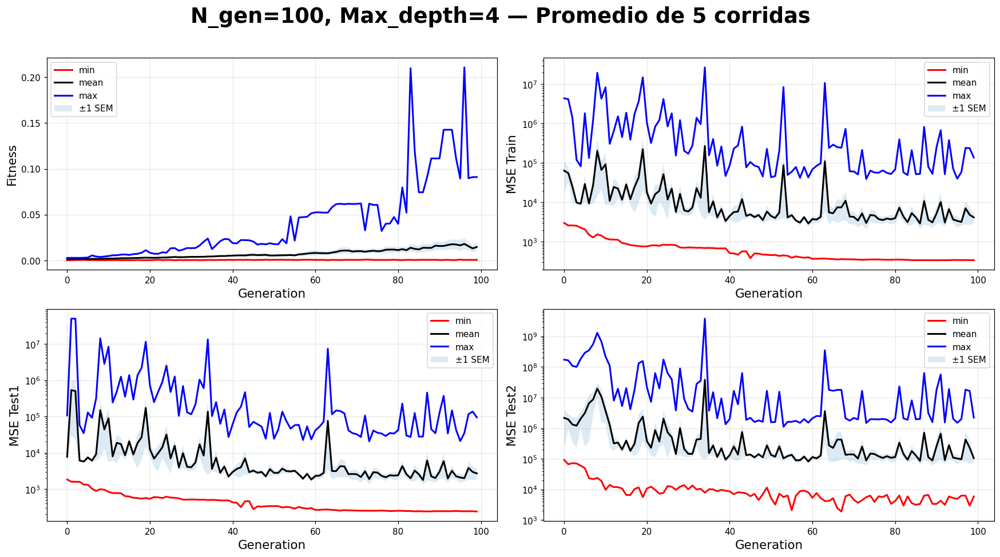

array([[[(0.00169003, 4., 6.97866758e+03, 3.96235699e+03, 1.52551024e+05, [ 2.91085702e+00,  3.46340941e+00,  4.03330698e+00,  4.62137951e+00,  5.22851050e+00,  5.85564172e+00,  6.50377798e+00,  7.17399256e+00,  7.86743314e+00,  8.58532835e+00,  9.32899500e+00,  1.00998462e+01,  1.08994003e+01,  1.17292909e+01,  1.25912778e+01,  1.34872597e+01,  1.44192883e+01,  1.53895835e+01,  1.64005512e+01,  1.74548037e+01,  1.85551816e+01,  1.97047797e+01,  2.09069760e+01,  2.21654649e+01,  2.34842949e+01,  2.48679125e+01,  2.63212120e+01,  2.78495932e+01,  2.94590288e+01,  3.11561425e+01,  3.29482994e+01,  3.48437136e+01,  3.68515738e+01,  3.89821922e+01,  4.12471817e+01,  4.36596678e+01,  4.62345428e+01,  4.89887738e+01,  5.19417770e+01,  5.51158760e+01,  5.85368669e+01,  6.22347218e+01,  6.62444682e+01,  7.06073026e+01,  7.53720112e+01,  8.05968015e+01,  8.63516927e+01,  9.27216709e+01,  9.98109151e+01,  1.07748539e+02], [ 5.17094188e+01,  2.03051433e+01,  6.65433103e+01,  4.16489531e+01,  5.61

In [26]:
R_list = [R1, R2, R3, R4, R5]
summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

# Casos

## Caso 1 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method = Tournament

Generation: 100%|██████████| 100/100 [00:03<00:00, 29.12it/s]


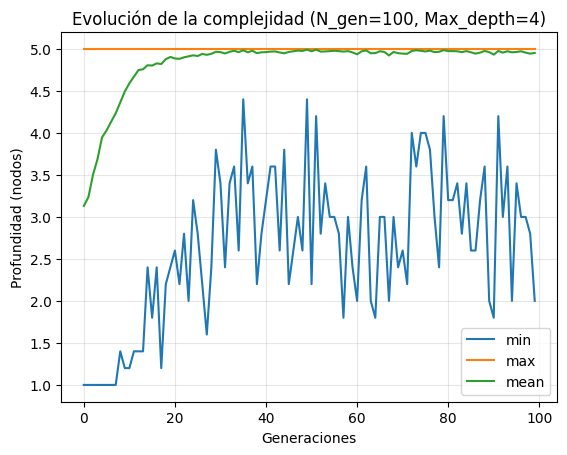

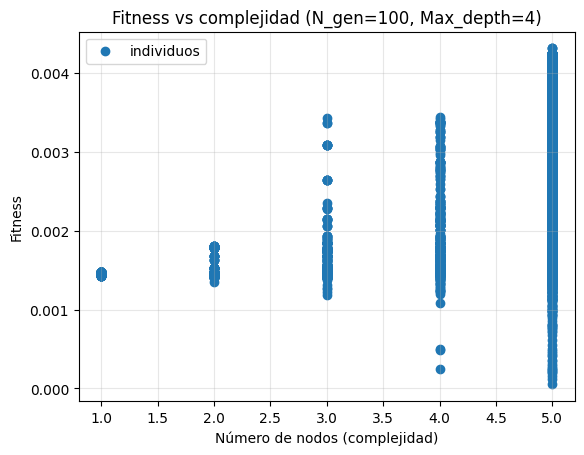

In [27]:
n_gen=100
max_depth=4
prob_mutation=0.15
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (plus (plus (times X1 X1) (times 5.398013222605201 X1)) (plus (times 5.398013222605201 X1) X1)) (plus (divide (times 7.29960961021585 X1) (plus X1 5.1699332756573195)) (plus (times 5.398013222605201 X1) (times 8.183955539386659 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00431
MSE         : 1065.63456
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*((X1 + 5.1699332756573195)*(X1 + 25.37799520720226) + 7.29960961021585)/(X1 + 5.1699332756573195)
*******************************************************************
 
                             TREE


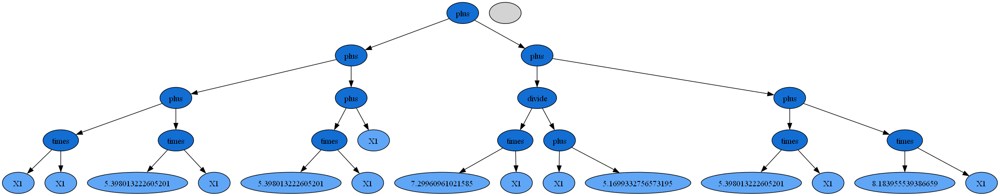

(minus (plus (times (times X1 X1) X1) (times (times X1 X1) X1)) (minus X1 (minus 3.9682918536713196 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.12055
MSE         : 1.06442
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 3.9682918536713196
*******************************************************************
 
                             TREE


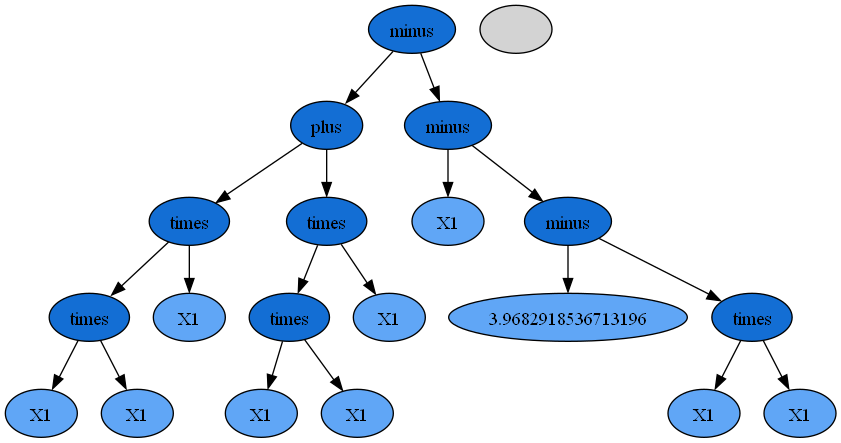

(times (plus X1 X1) (divide X1 (divide (divide 7.560486666750016 X1) 7.346822704146398)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01607
MSE         : 75.00703
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.94347878066017*X1**3
*******************************************************************
 
                             TREE


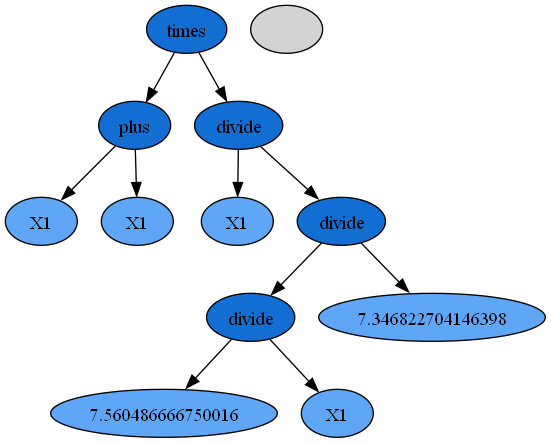

(plus (plus (times X1 (times X1 X1)) (times X1 (times X1 X1))) (minus (minus (minus 5.180139443463773 X1) (times X1 X1)) (divide (divide X1 X1) 7.735172987275139)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.73549
MSE         : 0.00259
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.050859852477887
*******************************************************************
 
                             TREE


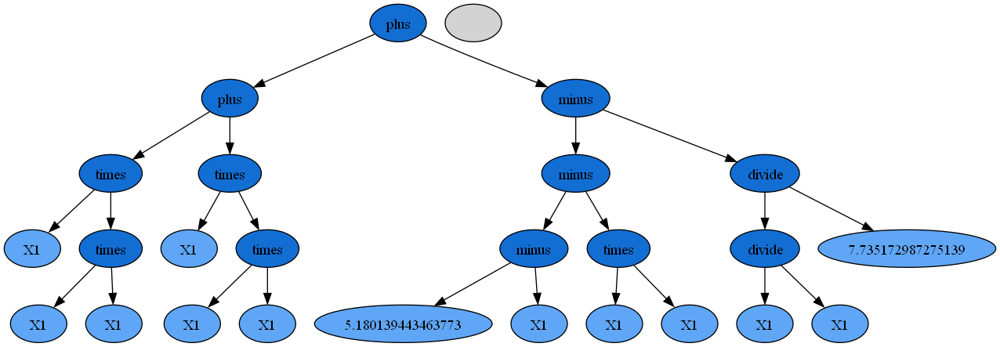

(plus (plus (times X1 (times X1 X1)) 5.258414321615106) (minus (times X1 (times X1 X1)) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.04565
MSE         : 8.74025
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 + 5.258414321615106
*******************************************************************
 
                             TREE


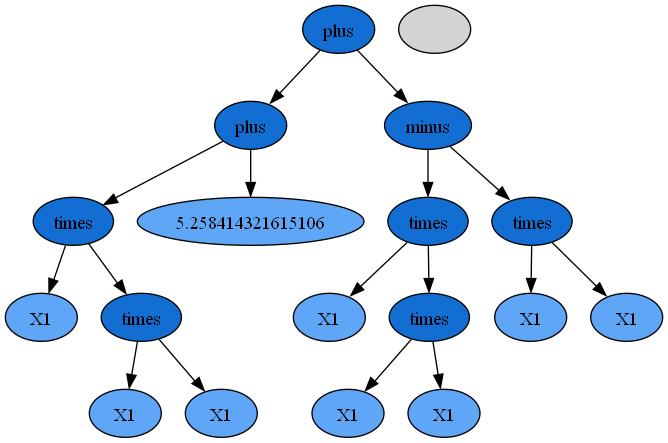

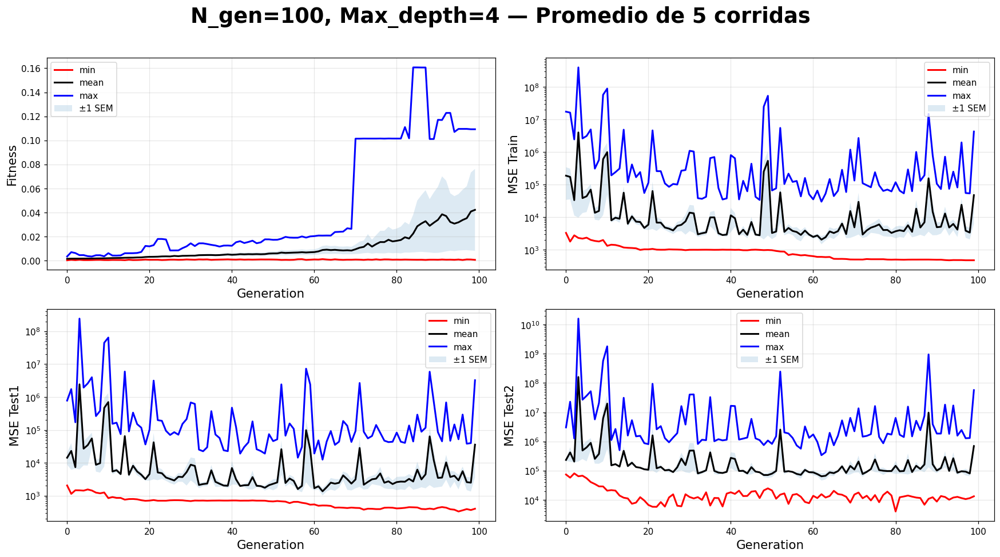

In [28]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 2 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:03<00:00, 32.37it/s]


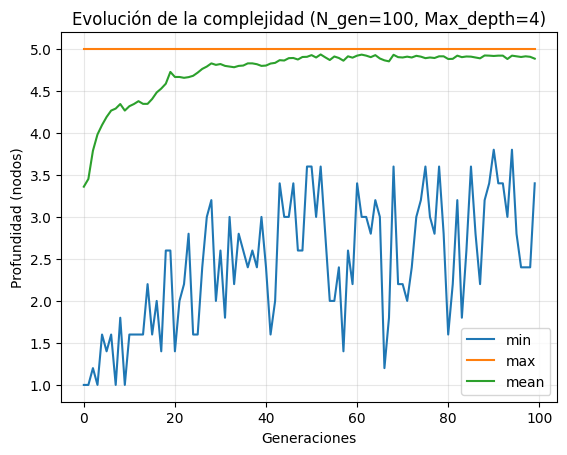

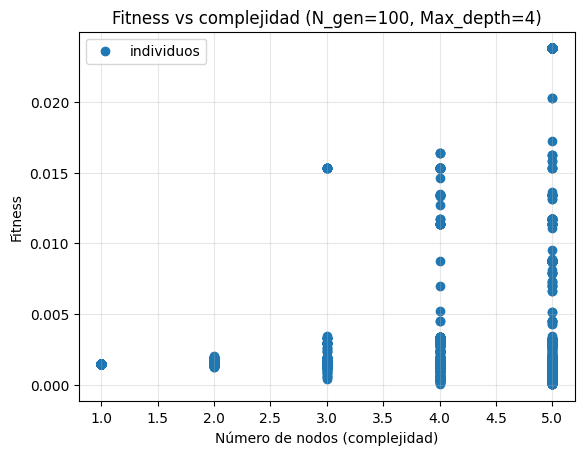

In [29]:
n_gen=100
max_depth=4
prob_mutation=0.15
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times X1 (minus (times X1 (plus X1 X1)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02379
MSE         : 33.67347
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2*X1 - 1)
*******************************************************************
 
                             TREE


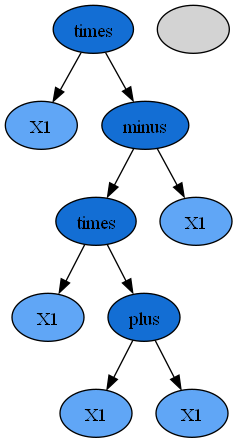

(minus (minus (times (times X1 X1) (times 1.8101286803301875 X1)) (minus (plus 4.090849211831157 X1) (times X1 3.574585160534637))) (plus (divide (times X1 X1) (minus X1 7.1733936083311365)) (plus (minus X1 7.1733936083311365) (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03799
MSE         : 12.82418
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             (-X1**2 + (X1 - 7.1733936083311365)*(1.8101286803301875*X1**3 - X1**2 + 1.574585160534637*X1 + 3.0825443964999795))/(X1 - 7.1733936083311365)
*******************************************************************
 
                             TREE


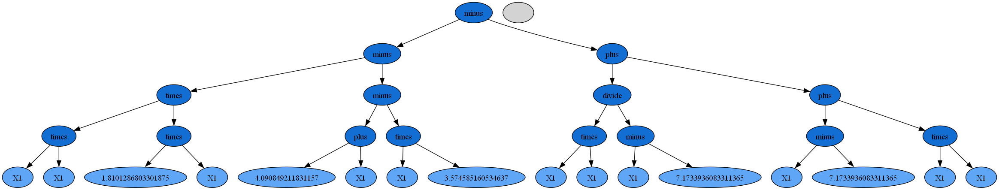

(minus (plus 4.900768526968829 (times (times 1.8919810898888045 X1) (times X1 X1))) (minus (times X1 X1) (minus (times 1.8919810898888045 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.05916
MSE         : 5.05746
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.8919810898888045*X1**3 - X1**2 + 0.8919810898888045*X1 + 4.900768526968829
*******************************************************************
 
                             TREE


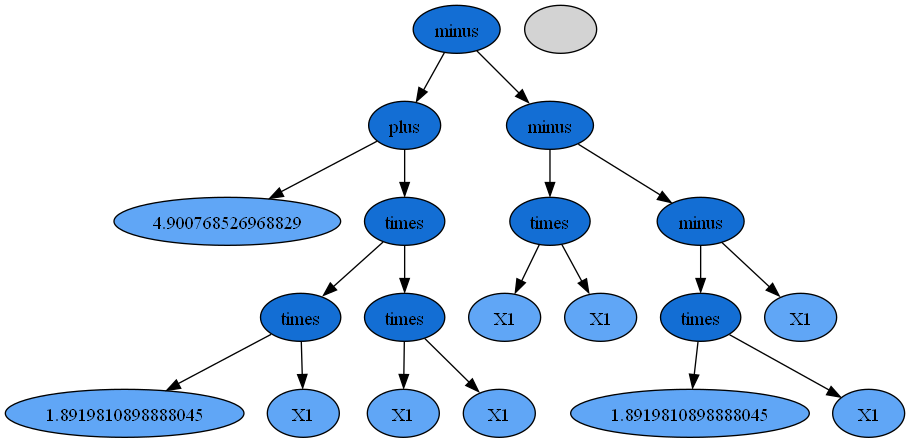

(plus (minus (times X1 (times X1 X1)) (times X1 (plus 9.781149867696914 X1))) (times (plus 8.035259021709392 (times X1 X1)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02524
MSE         : 29.82551
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2*X1**2 - X1 - 1.745890845987522)
*******************************************************************
 
                             TREE


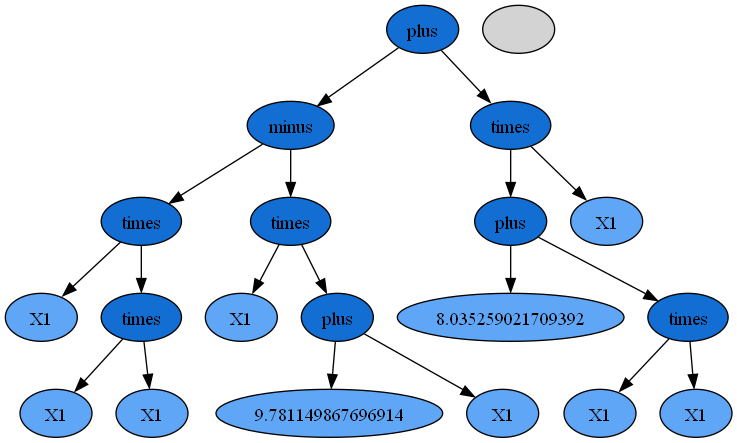

(plus (times (times (minus X1 0.44228459968975953) X1) (plus X1 X1)) (plus (plus (minus 2.0279104020873415 X1) (divide X1 0.9948591410953145)) (minus 2.0279104020873415 (divide X1 0.9948591410953145))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.13622
MSE         : 0.80419
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2*X1 - 0.88456919937951906) - 1.0*X1 + 4.055820804174683
*******************************************************************
 
                             TREE


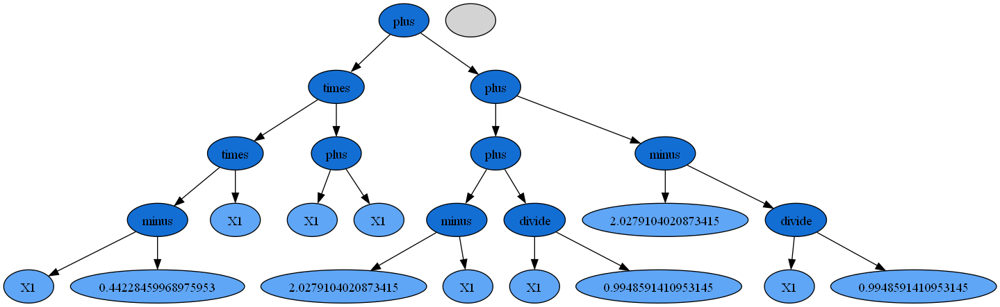

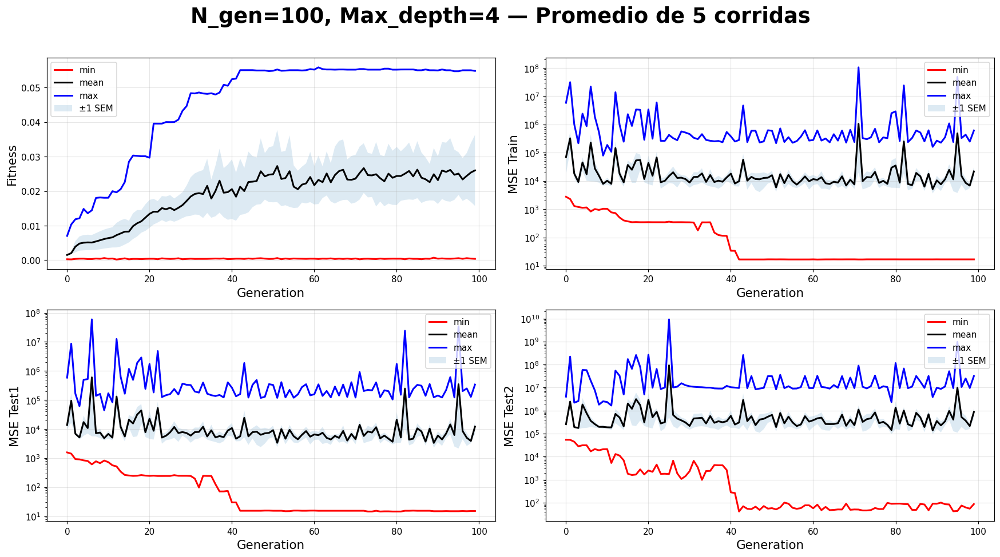

In [30]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 3 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 100/100 [00:03<00:00, 29.62it/s]


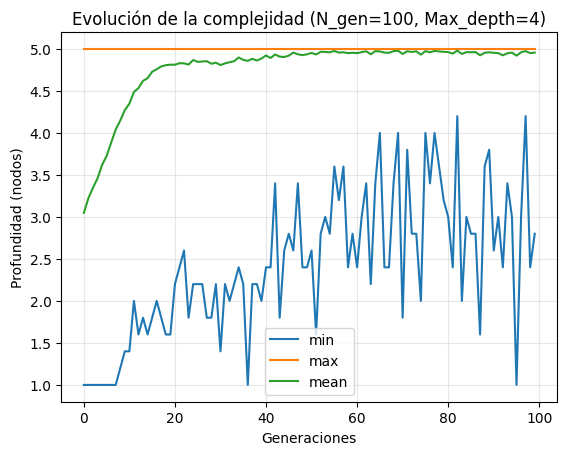

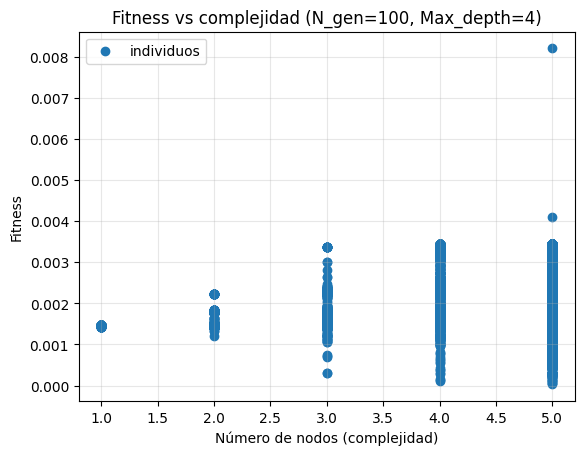

In [31]:
n_gen=100
max_depth=4
prob_mutation=0.15
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times (plus (minus X1 2.394627089312876) (plus (plus X1 X1) (plus 0.9784162894491744 X1))) (divide (times X1 X1) (plus 1.6840412057132093 0.795386614395065)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00820
MSE         : 292.48459
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(1.6132754370019627*X1 - 0.57118452425925308)
*******************************************************************
 
                             TREE


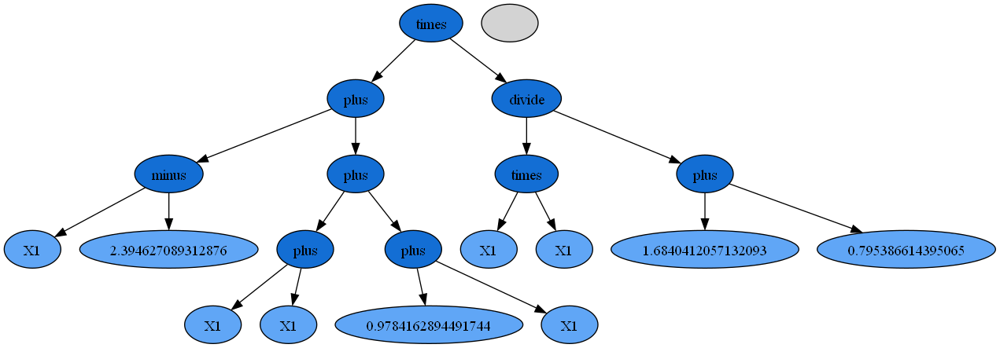

(plus (minus (times (plus X1 X1) (times X1 X1)) (plus X1 (times X1 X1))) (divide (times (times X1 X1) (times X1 9.6835310484331)) (times (plus X1 X1) (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.47195
MSE         : 0.02504
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.84176552421655
*******************************************************************
 
                             TREE


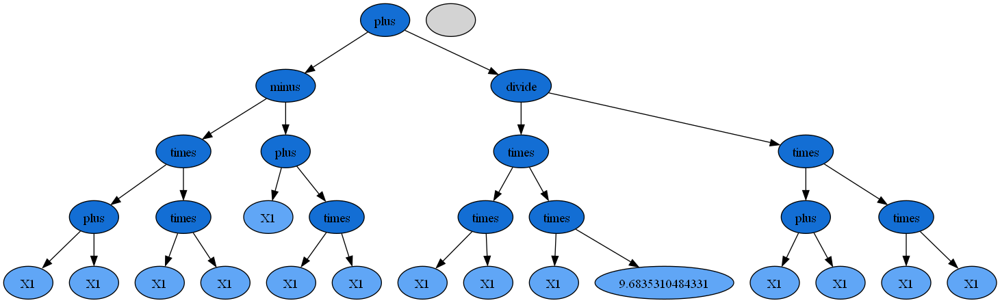

(plus (minus (times (times X1 X1) (plus X1 X1)) (plus (times X1 X1) (minus X1 2.5777209254919353))) (divide (times (plus 6.515242737994681 3.295204532366612) (plus X1 X1)) (plus (times 6.157070810465869 X1) (plus X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.89329
MSE         : 0.00029
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.9831057746154887
*******************************************************************
 
                             TREE


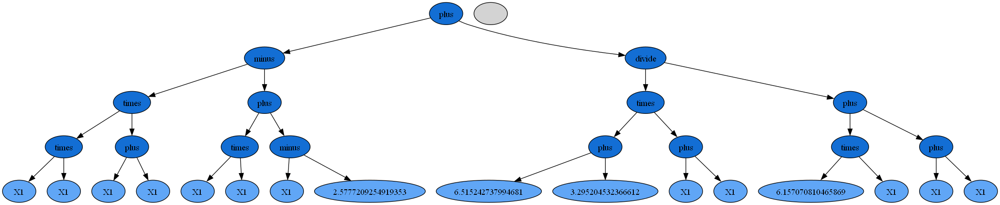

(plus (plus (minus 2.423836553719 X1) (times X1 (times X1 X1))) (plus (minus 2.423836553719 (times X1 X1)) (times X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.48144
MSE         : 0.02320
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.847673107438
*******************************************************************
 
                             TREE


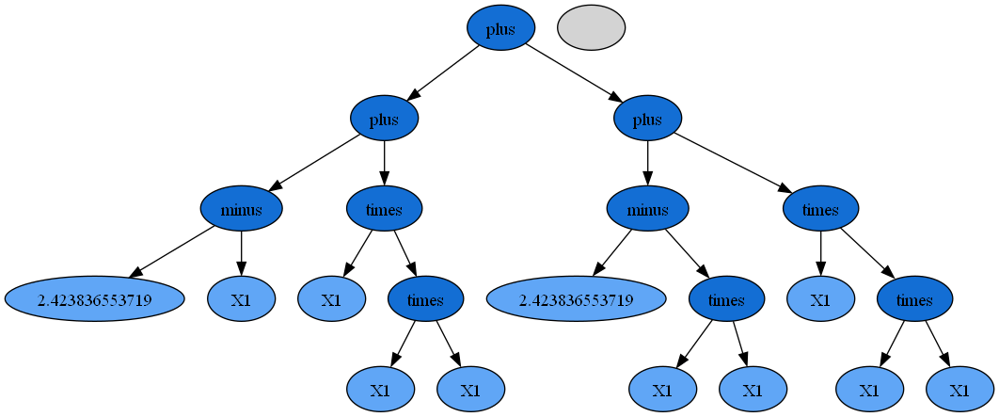

(plus (plus (times (times X1 X1) (plus X1 X1)) (minus 4.778393533555933 (times X1 X1))) (minus X1 (plus X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.38956
MSE         : 0.04911
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.778393533555933
*******************************************************************
 
                             TREE


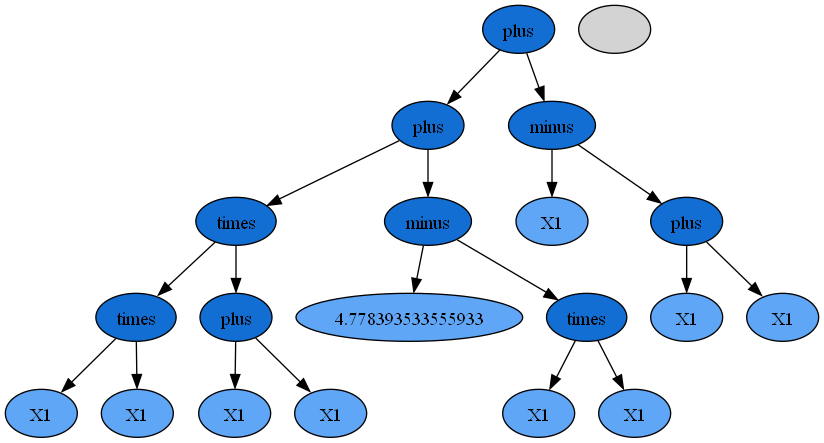

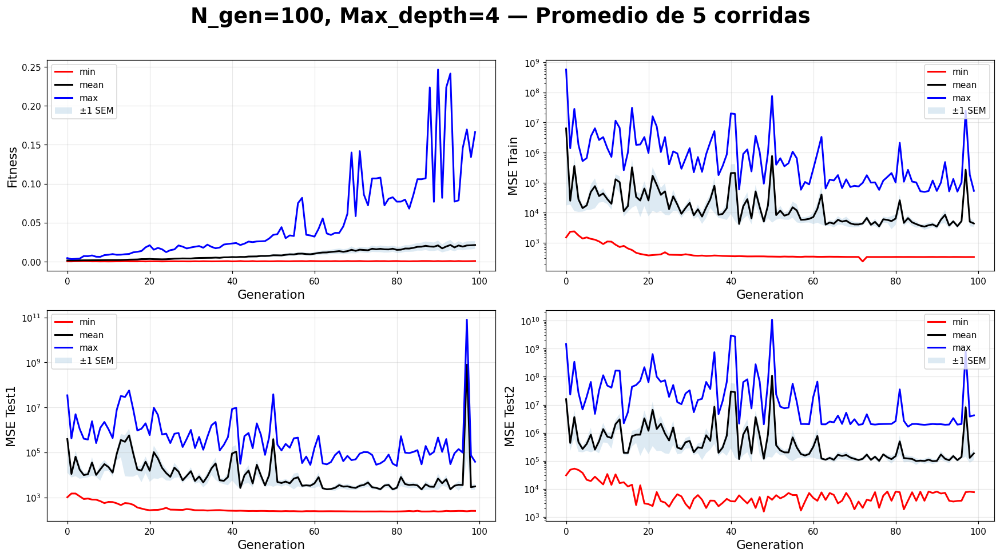

In [32]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 4 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:03<00:00, 28.19it/s]


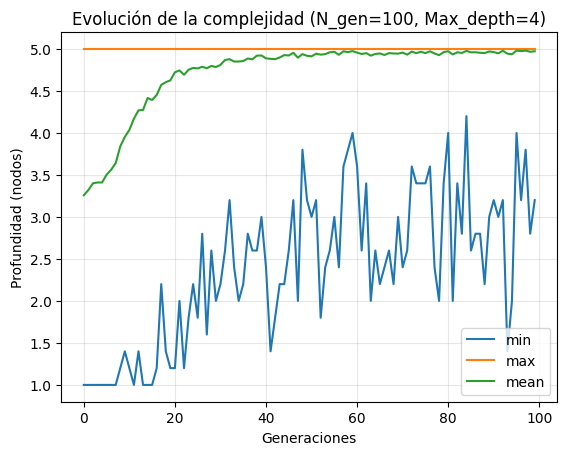

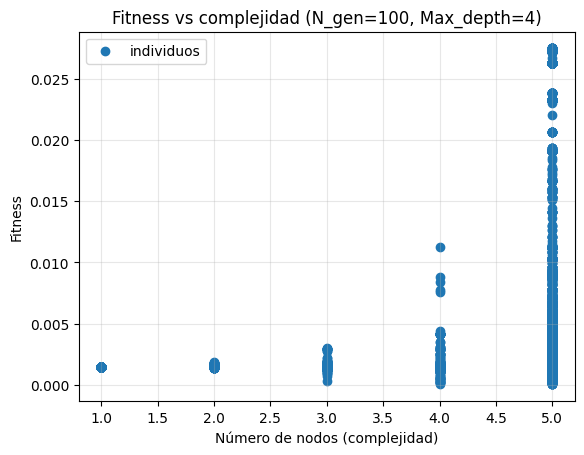

In [33]:
n_gen=100
max_depth=4
prob_mutation=0.15
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times (minus (times X1 X1) (minus X1 4.219260536991515)) X1) (times (minus (times X1 X1) (times 4.147457531359441 1.2822206688266913)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02746
MSE         : 25.08449
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2*X1**2 - X1 - 1.0986952327984853)
*******************************************************************
 
                             TREE


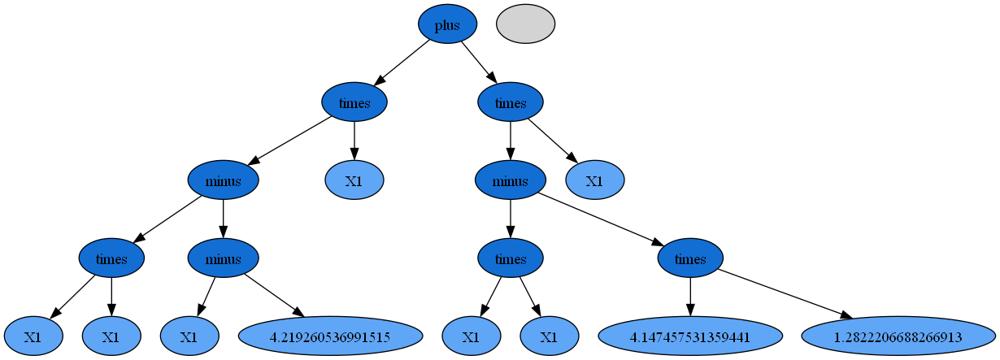

(plus (plus (times (times X1 X1) X1) (times (times X1 X1) X1)) (minus (minus 4.244711499007482 X1) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.15771
MSE         : 0.57046
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.244711499007482
*******************************************************************
 
                             TREE


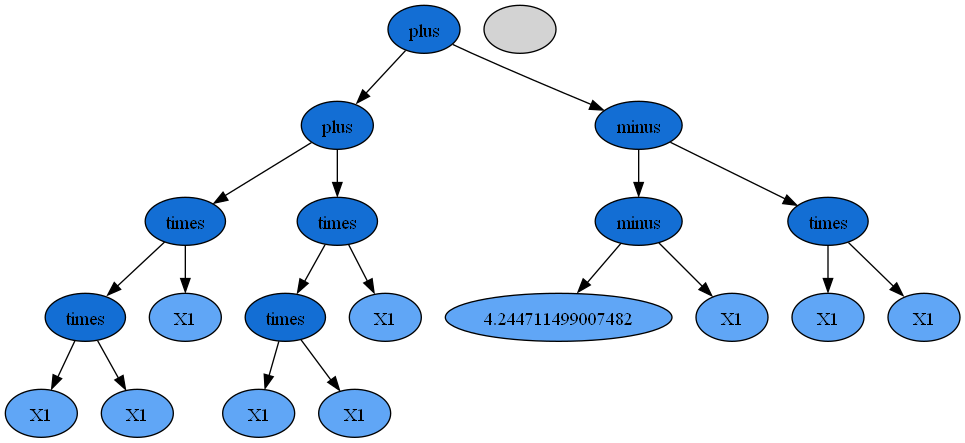

(minus (plus (times (times X1 X1) (plus X1 X1)) (divide (times X1 5.027052353543427) X1)) (plus X1 (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.83943
MSE         : 0.00073
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.027052353543427
*******************************************************************
 
                             TREE


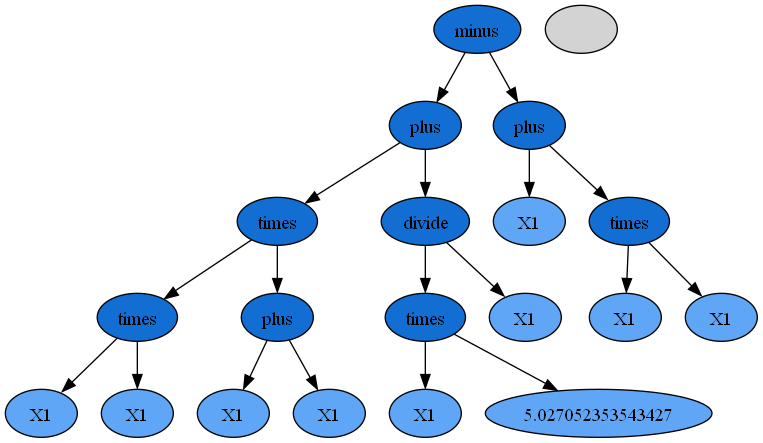

(plus (divide (times (times X1 X1) X1) (divide (minus X1 9.975676590610751) (divide X1 6.039187696236558))) (plus (times X1 (times X1 X1)) (times X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02914
MSE         : 22.20432
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**3*(2.165585183024394*X1 - 19.9513531812215)/(X1 - 9.975676590610751)
*******************************************************************
 
                             TREE


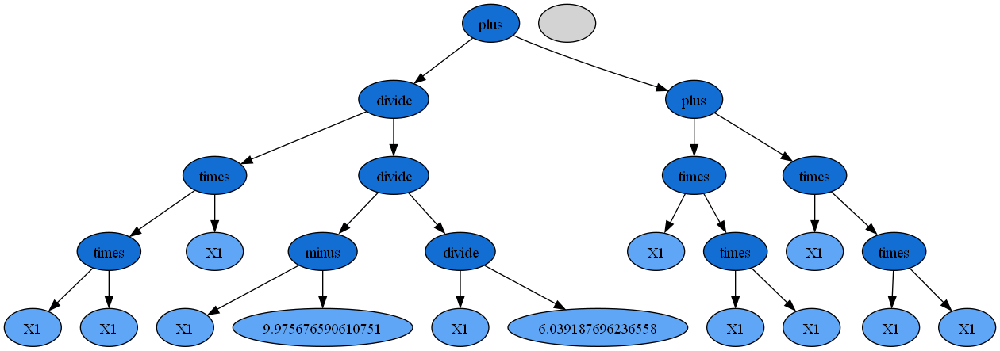

(minus (times X1 (times (times X1 0.48274244080438344) (times 3.9695531978446787 X1))) (times (times (times 0.6081820649546654 X1) (times X1 0.48274244080438344)) 2.154950555564624))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03520
MSE         : 15.02650
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(1.9162717996303858*X1 - 0.63268334297166351)
*******************************************************************
 
                             TREE


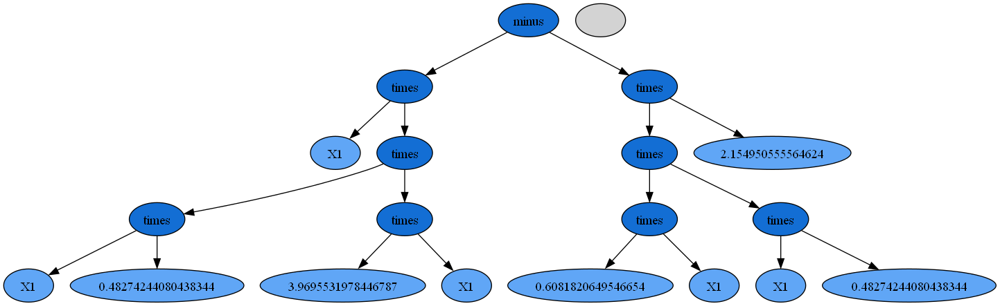

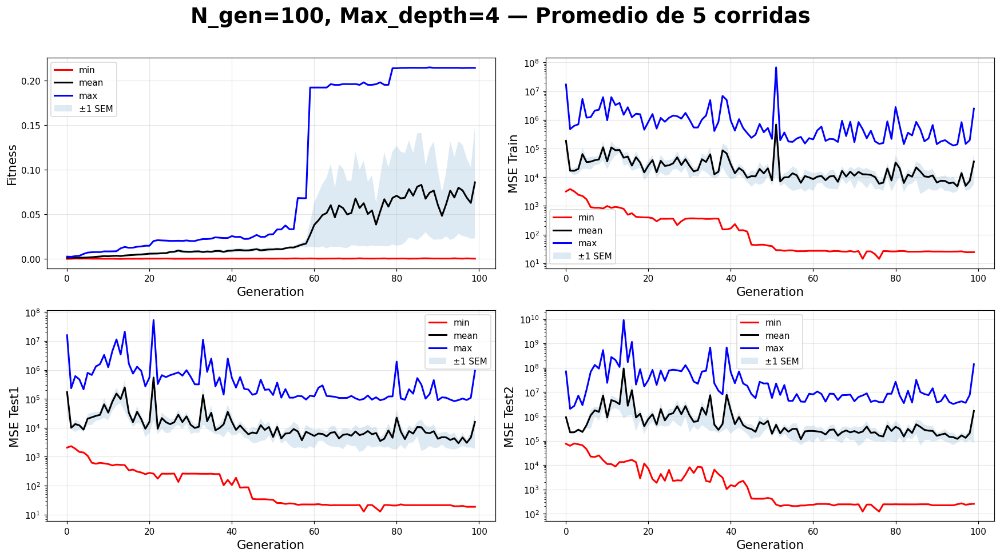

In [34]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 5 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Tournament

Generation: 100%|██████████| 100/100 [00:03<00:00, 27.95it/s]


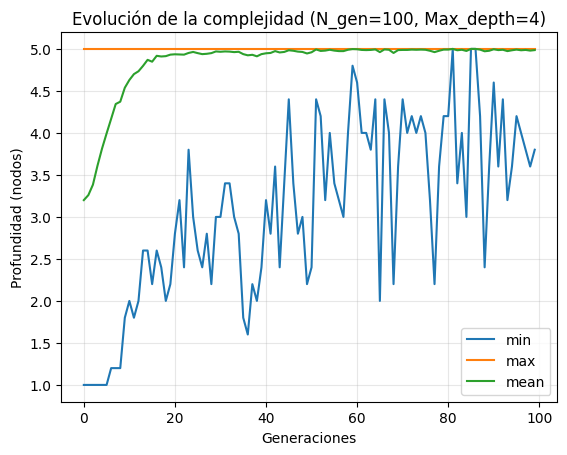

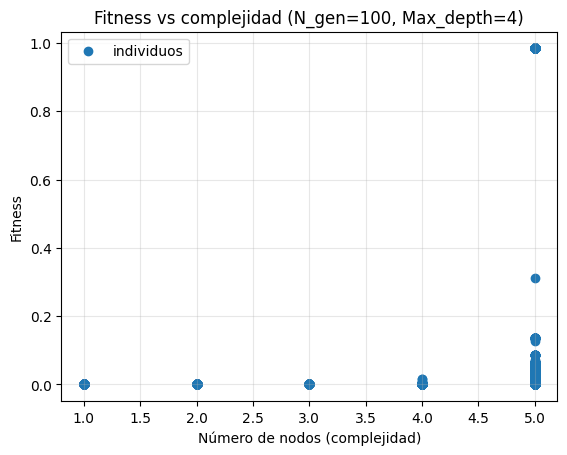

In [35]:
n_gen=100
max_depth=4
prob_mutation=0.10
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (plus (times (times X1 X1) X1) (times (times X1 X1) X1)) (minus (plus X1 (minus 2.4988398056888848 X1)) (minus (times X1 X1) (minus 2.4988398056888848 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.98386
MSE         : 0.00001
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.9976796113777696
*******************************************************************
 
                             TREE


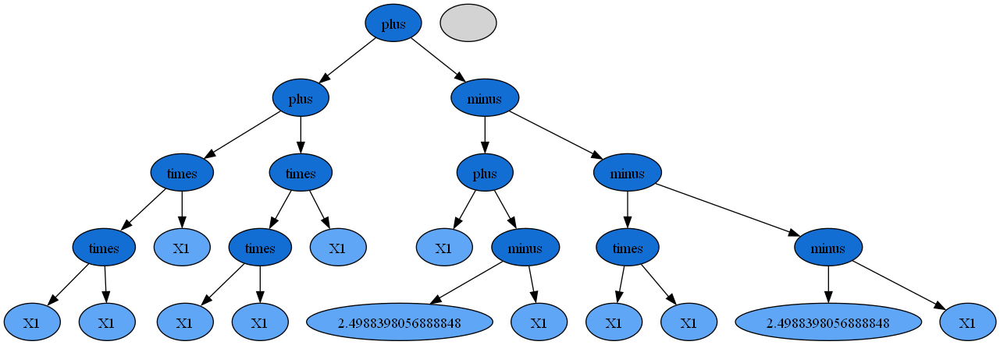

(times (times X1 (plus X1 X1)) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01535
MSE         : 82.27885
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3
*******************************************************************
 
                             TREE


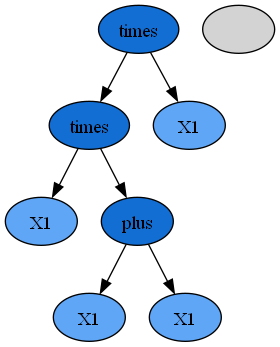

(plus (plus (minus 5.609953251179659 X1) (times X1 (times X1 X1))) (minus (times X1 (times X1 X1)) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.18822
MSE         : 0.37204
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.609953251179659
*******************************************************************
 
                             TREE


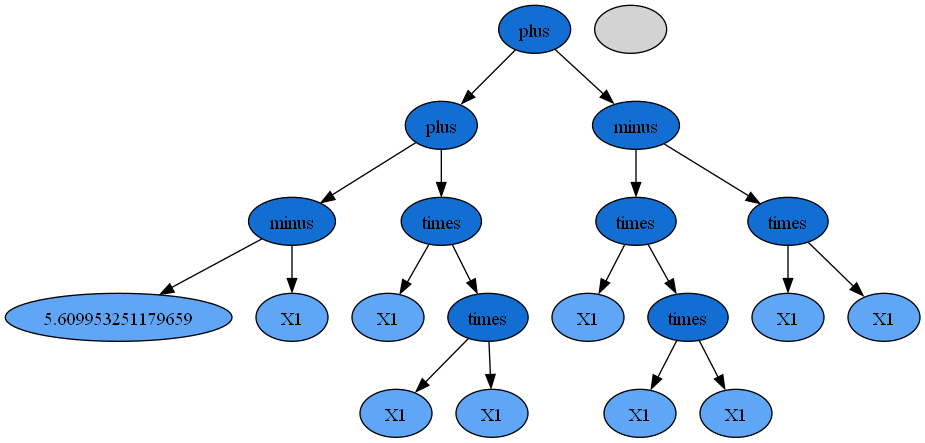

(plus (times (plus (times X1 X1) (times X1 X1)) X1) (minus (plus 2.14440937975493 (minus 3.663701213463476 X1)) (plus (divide X1 X1) (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.42429
MSE         : 0.03682
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.808110593218406
*******************************************************************
 
                             TREE


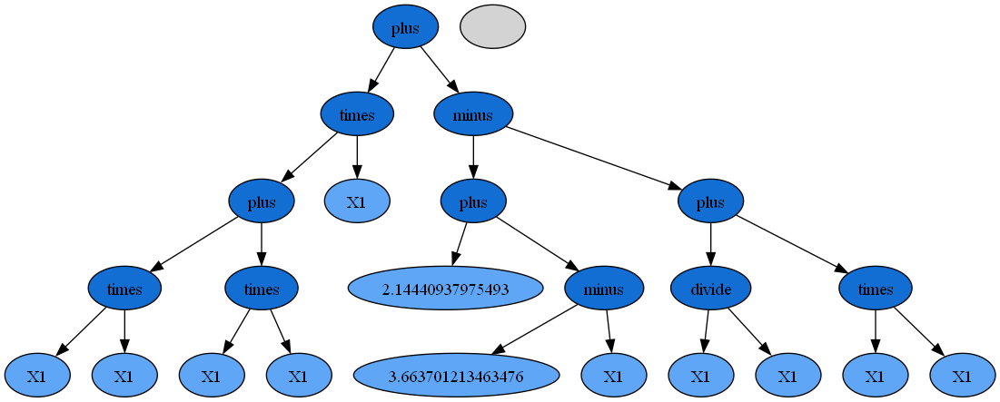

(plus (times (divide (divide X1 2.7359745391148516) (divide 9.260394449526515 X1)) (plus (plus X1 X1) (plus X1 X1))) (times (plus (plus X1 X1) (plus X1 X1)) (divide (times 4.113537469204498 X1) (divide 9.260394449526515 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01603
MSE         : 75.31761
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.9347071967372394*X1**3
*******************************************************************
 
                             TREE


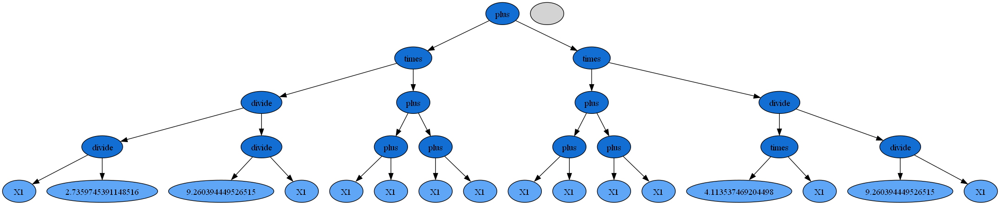

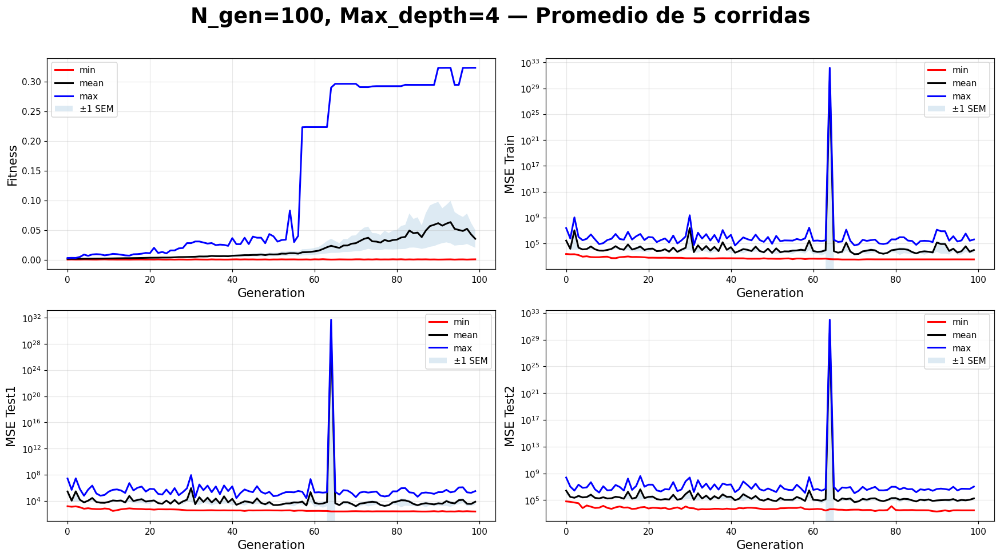

In [36]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 6 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:03<00:00, 29.39it/s]


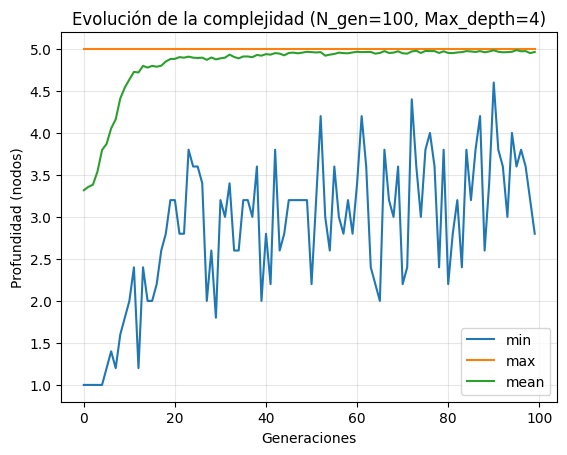

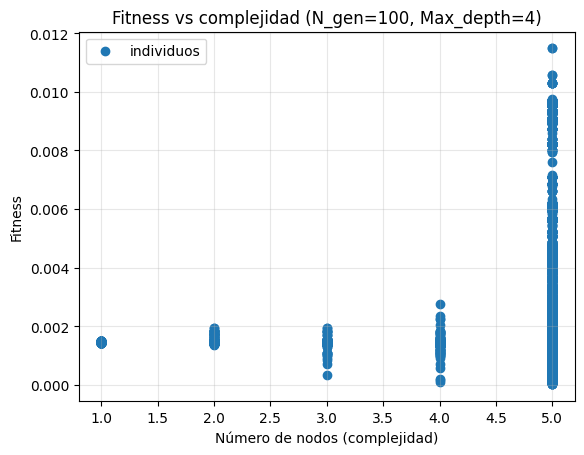

In [37]:
n_gen=100
max_depth=4
prob_mutation=0.10
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times (plus (minus (minus 1.896302946660875 X1) X1) (minus (minus 1.268884615695659 X1) X1)) (divide (minus (times X1 X1) (minus X1 X1)) (minus (minus 4.722320516396393 6.958862363891205) (minus X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01148
MSE         : 148.19165
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(1.788475366325234*X1 - 1.415214996268419)
*******************************************************************
 
                             TREE


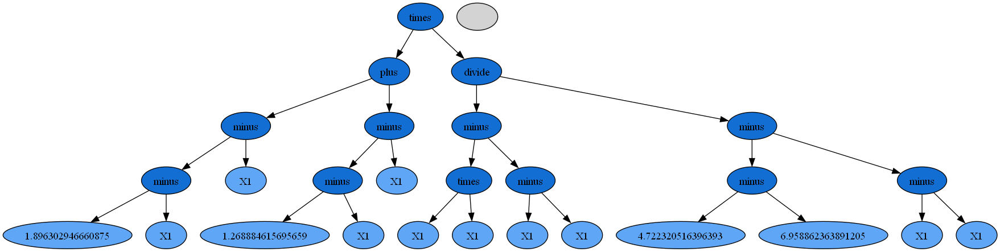

(plus (times (plus (times X1 X1) (times X1 X1)) X1) (minus (plus 6.925202272571608 (divide X1 X1)) (plus (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.04612
MSE         : 8.55681
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 7.925202272571608
*******************************************************************
 
                             TREE


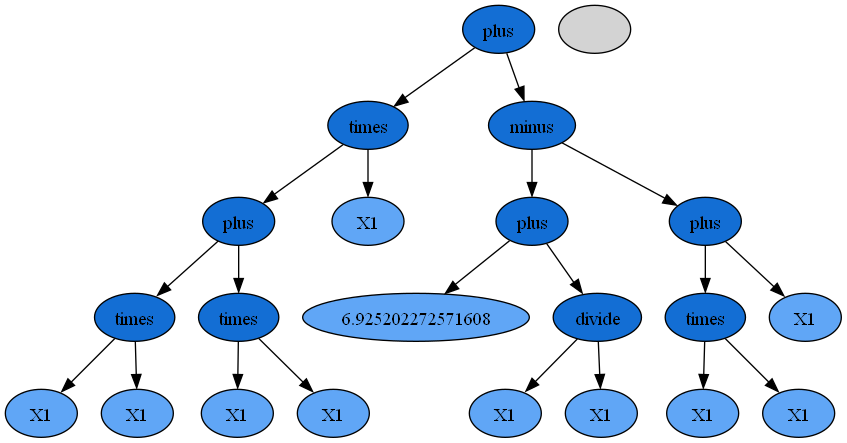

(plus (divide (times (times X1 3.0149570910301247) X1) (minus X1 8.560543833253263)) (times (minus (times X1 3.0149570910301247) X1) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03296
MSE         : 17.21320
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(X1*(2.0149570910301247*X1 - 17.249128499887868) + 3.0149570910301247)/(X1 - 8.560543833253263)
*******************************************************************
 
                             TREE


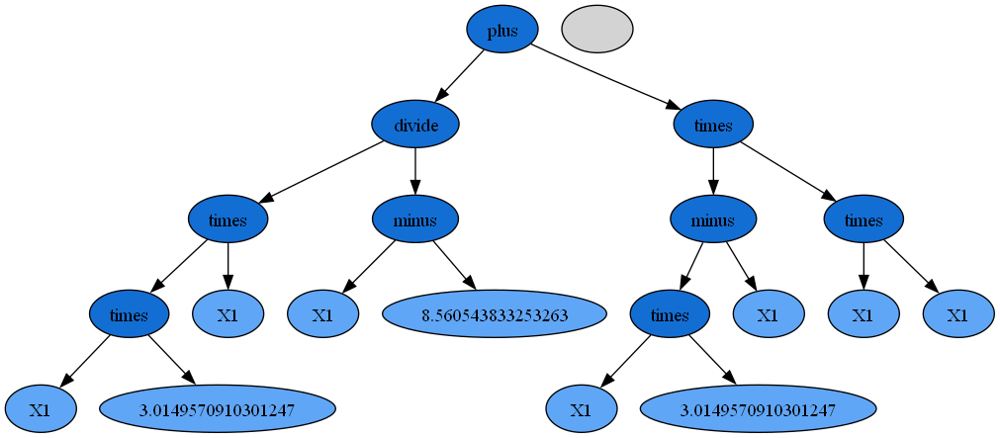

(plus (divide (plus (times X1 X1) (times X1 X1)) (minus X1 (plus 2.5068965759147552 X1))) (plus (divide (plus X1 X1) (minus X1 X1)) (times (times X1 X1) (plus X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03397
MSE         : 16.17661
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2*X1**2 - 0.79779916699204436*X1 + zoo)
*******************************************************************
 
                             TREE


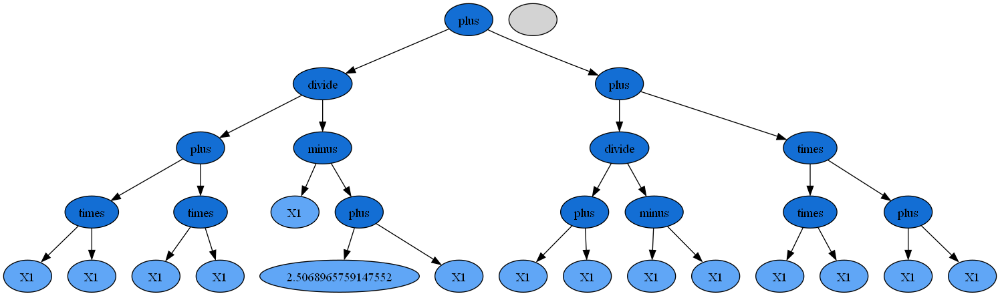

(times (divide X1 1.9459150488512056) (plus (divide (times X1 X1) (divide 1.9459150488512056 5.526075979133376)) (minus (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03221
MSE         : 18.05315
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(1.9732794281328141*X1 - 0.51389704837853125)
*******************************************************************
 
                             TREE


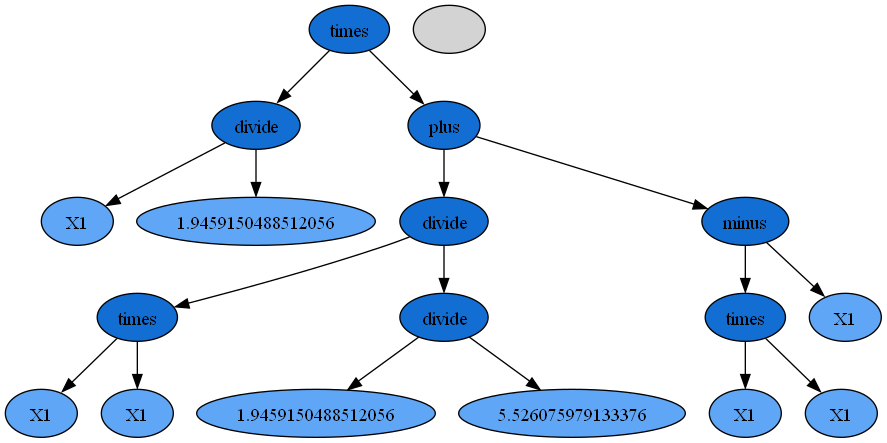

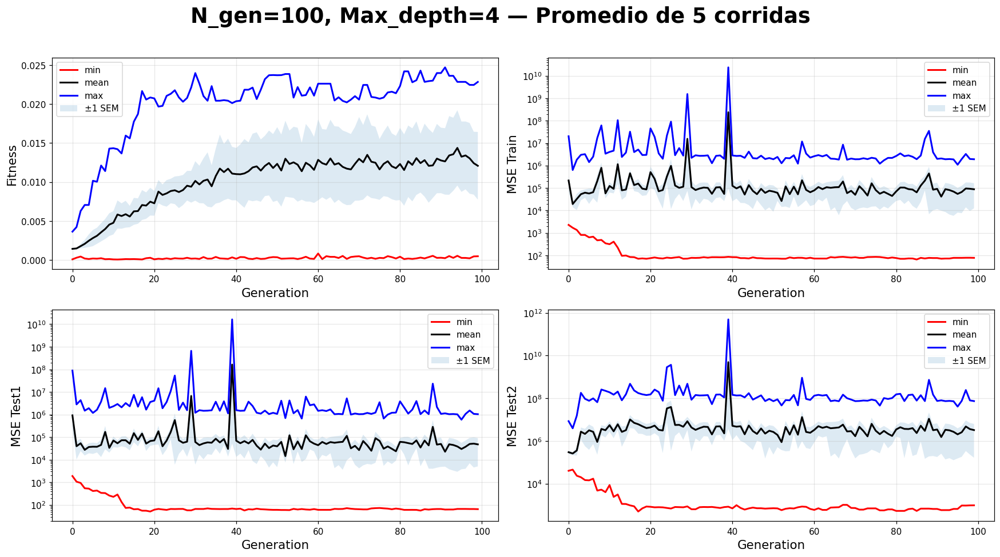

In [38]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 7 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 100/100 [00:03<00:00, 27.91it/s]


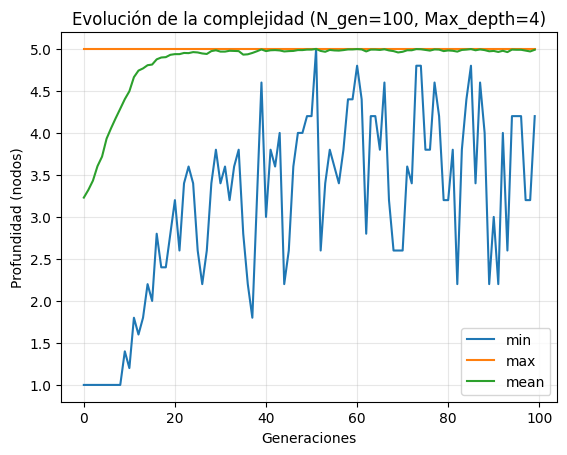

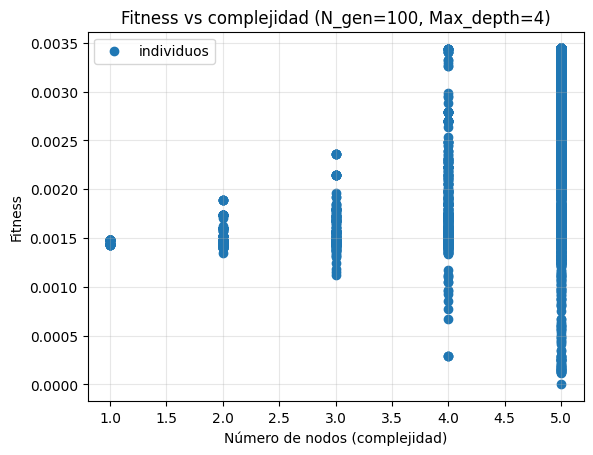

In [39]:
n_gen=100
max_depth=4
prob_mutation=0.10
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (plus X1 (plus (times X1 6.381137245969338) (times X1 6.381137245969338))) (plus (plus (times X1 9.065065768690854) (times X1 6.381137245969338)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00344
MSE         : 1677.25707
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             30.20847750659887*X1
*******************************************************************
 
                             TREE


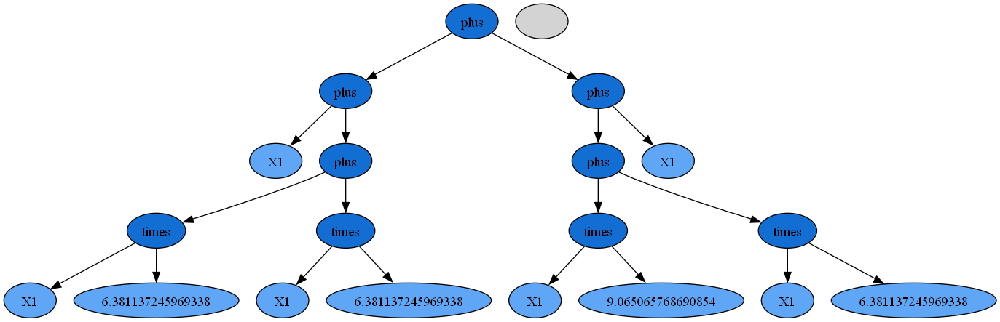

(minus (times (times 7.854057581722102 X1) 4.119000074869131) (times (divide X1 9.57311262324024) (plus (times 4.9410393686981315 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00346
MSE         : 1655.05976
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(32.3508637671398 - 0.62059641440708868*X1)
*******************************************************************
 
                             TREE


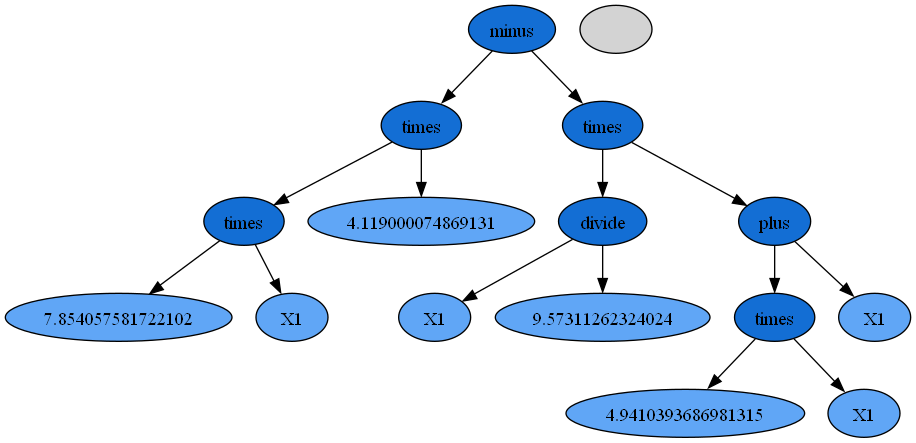

(plus (times X1 (times (minus X1 0.3886548801325118) (plus X1 X1))) (minus (divide 9.045810336650549 6.45340191692124) (times (minus X1 0.3886548801325118) (divide 5.720919649088185 5.136773486308799))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.06176
MSE         : 4.61573
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2*X1 - 0.7773097602650236) - 1.113718497484136*X1 + 1.834564040641851
*******************************************************************
 
                             TREE


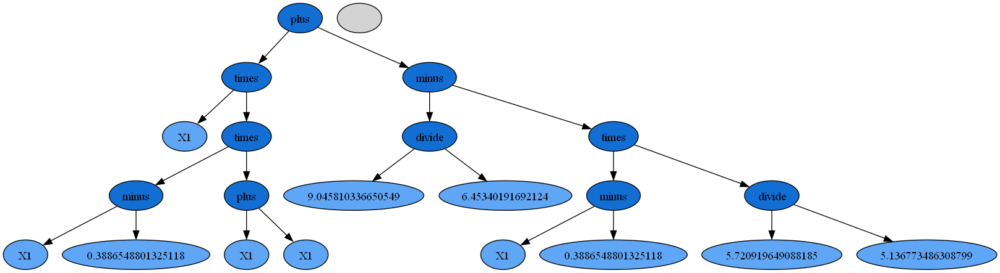

(plus (divide (minus (divide X1 0.5050769597876736) (times X1 X1)) X1) (plus (minus 2.846304381256264 (times X1 X1)) (times (times X1 X1) (divide X1 0.5050769597876736))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.12149
MSE         : 1.04576
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.979896292280654*X1**3 - X1**2 - X1 + 4.826200673536918
*******************************************************************
 
                             TREE


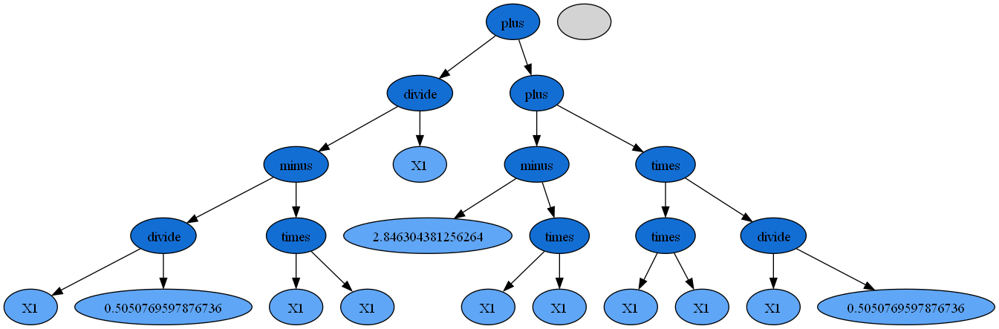

(minus (plus (divide (divide X1 X1) (times 4.476028799464196 X1)) (times (times X1 X1) (plus X1 X1))) (plus (plus (minus 3.204965051420788 9.292425130801625) X1) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.10618
MSE         : 1.41721
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 6.087460079380837 + 0.2234123248089255/X1
*******************************************************************
 
                             TREE


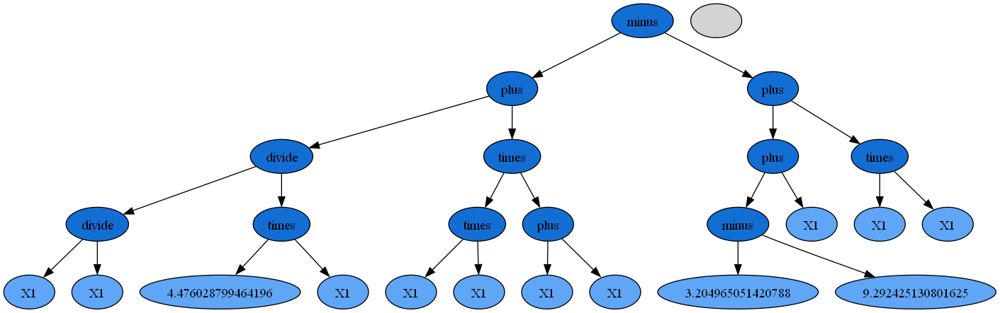

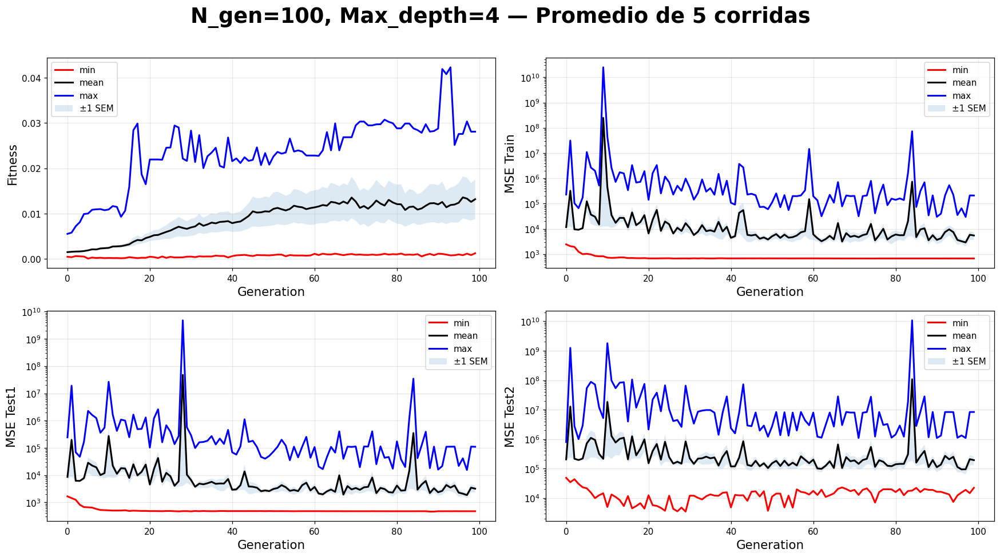

In [40]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 8 

- Numero de generaciones = 100
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:02<00:00, 34.86it/s]


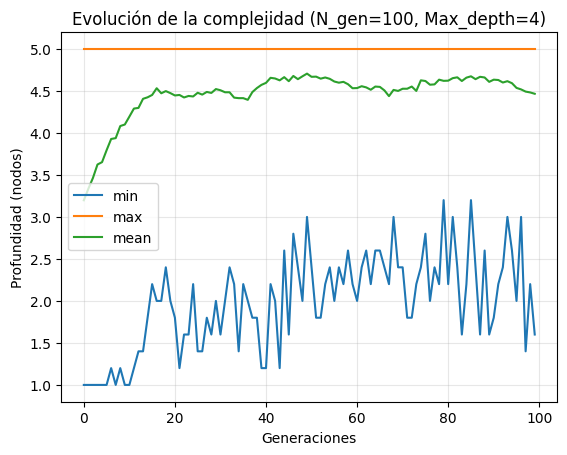

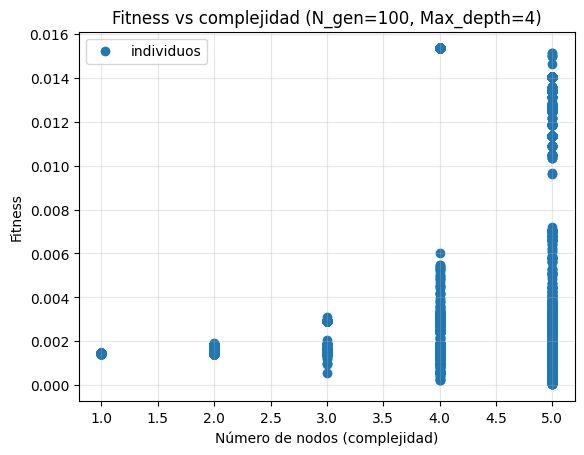

In [92]:
n_gen=100
max_depth=4
prob_mutation=0.10
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times X1 (times X1 X1)) (times X1 (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01535
MSE         : 82.27885
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3
*******************************************************************
 
                             TREE


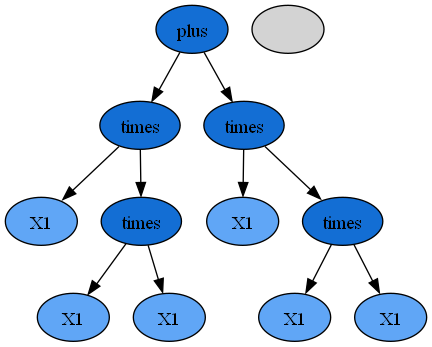

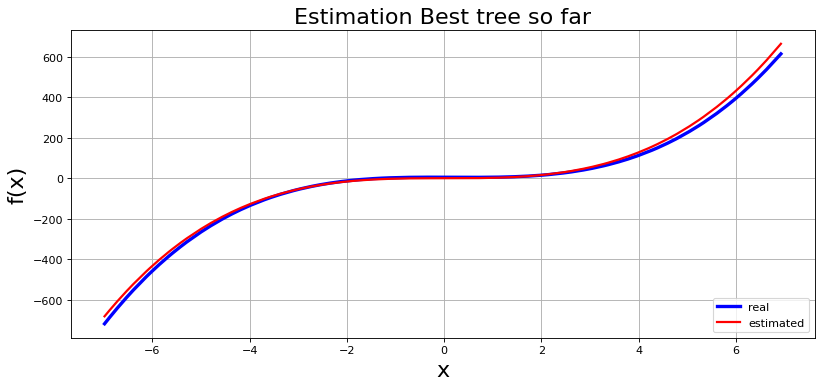

(minus (times (times (divide X1 1.7975555074122807) (divide X1 1.7975555074122807)) (times 6.557104208387436 X1)) (times (divide X1 6.557104208387436) (times (divide X1 1.7975555074122807) 9.016948930980387)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02483
MSE         : 30.85559
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2.0293056554508823*X1 - 0.76500665682547508)
*******************************************************************
 
                             TREE


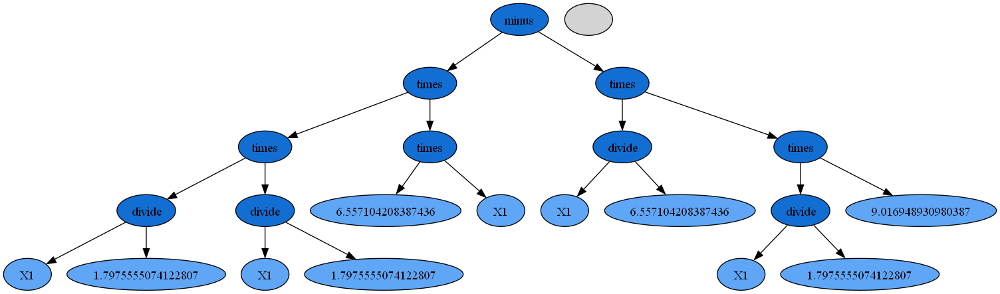

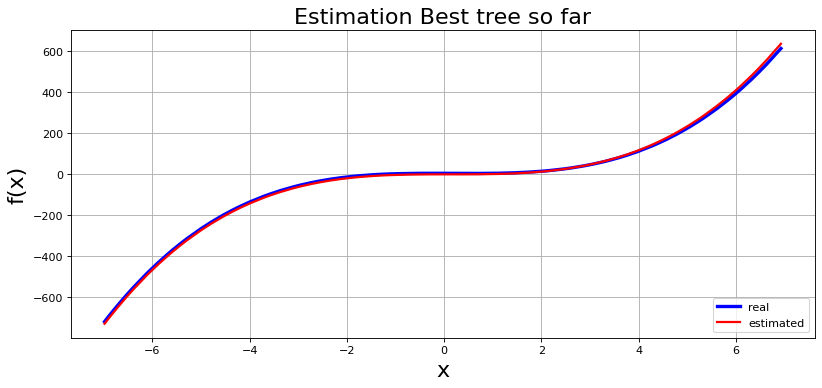

(plus (times (minus (times X1 X1) (plus 1.4716340335046718 X1)) X1) (plus (plus 1.4716340335046718 X1) (times (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03538
MSE         : 14.87074
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - 0.4716340335046718*X1 + 1.4716340335046718
*******************************************************************
 
                             TREE


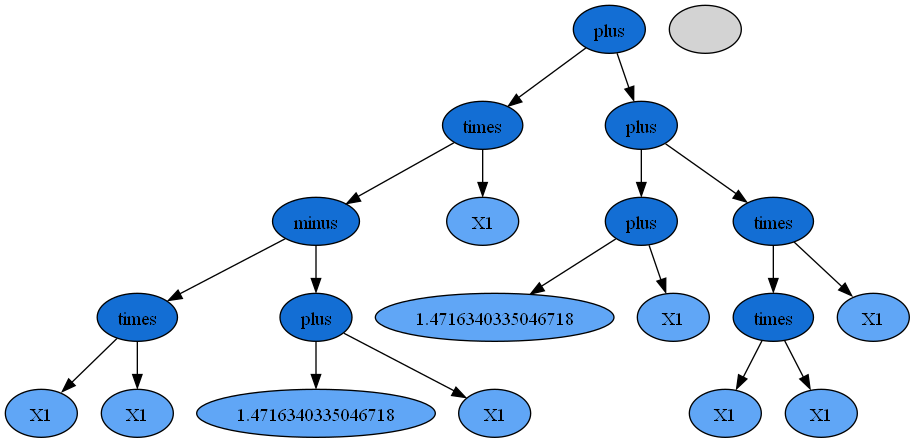

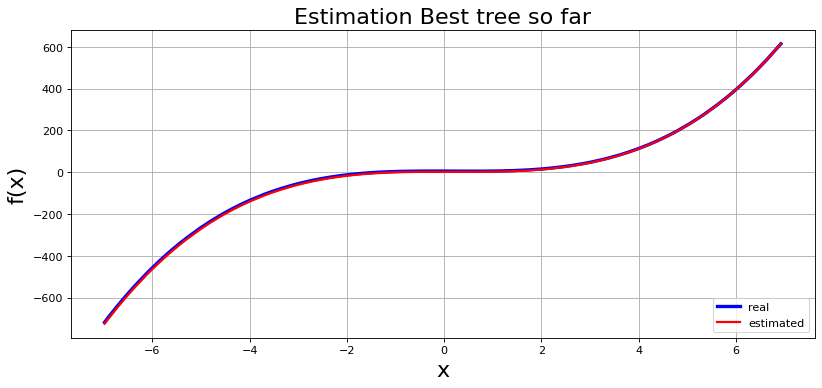

(minus (times (plus X1 X1) (times X1 X1)) (plus (times X1 X1) (minus (minus X1 4.486696592693727) (divide X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.22515
MSE         : 0.23687
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.486696592693727
*******************************************************************
 
                             TREE


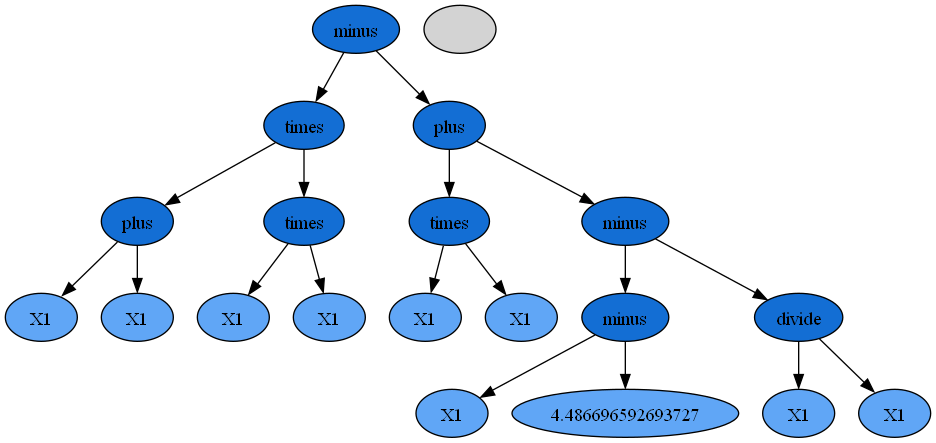

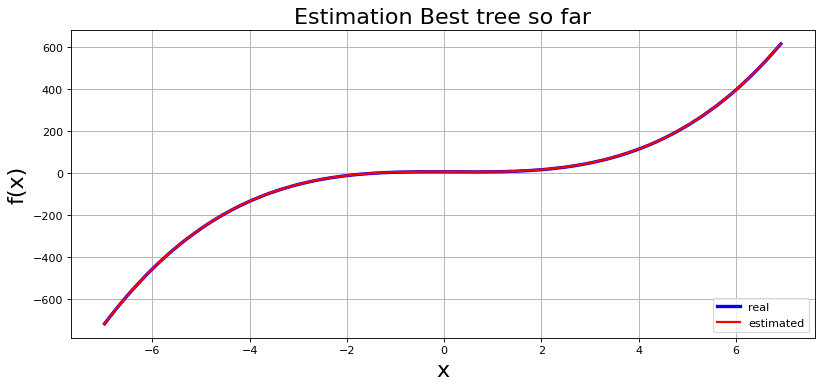

(plus (divide (divide X1 0.03949700353488517) (plus (plus 6.244968892161205 X1) 0.03949700353488517)) (minus (plus (divide X1 0.03949700353488517) X1) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00394
MSE         : 1278.56146
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             25.31837634510082*X1*(X1 + 7.28446589569609)/(X1 + 6.28446589569609)
*******************************************************************
 
                             TREE


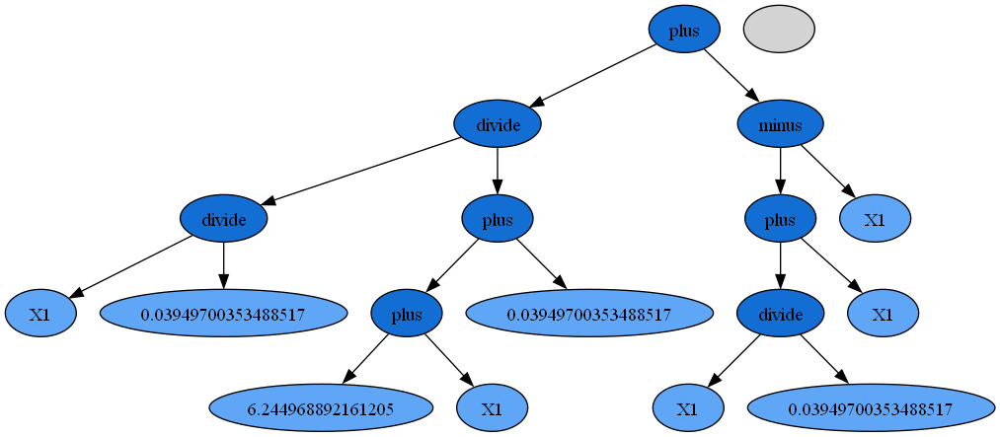

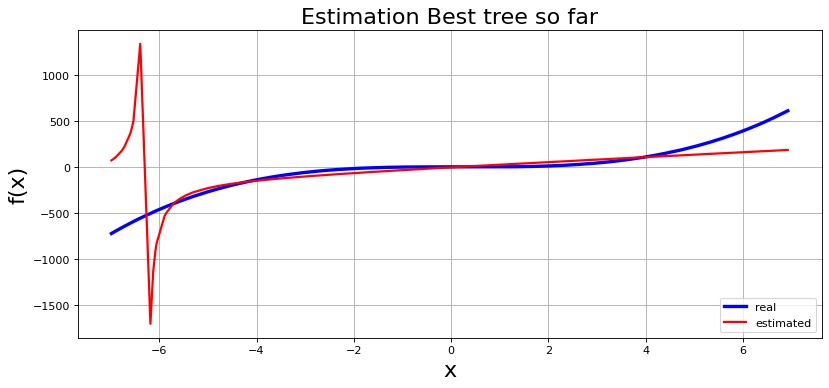

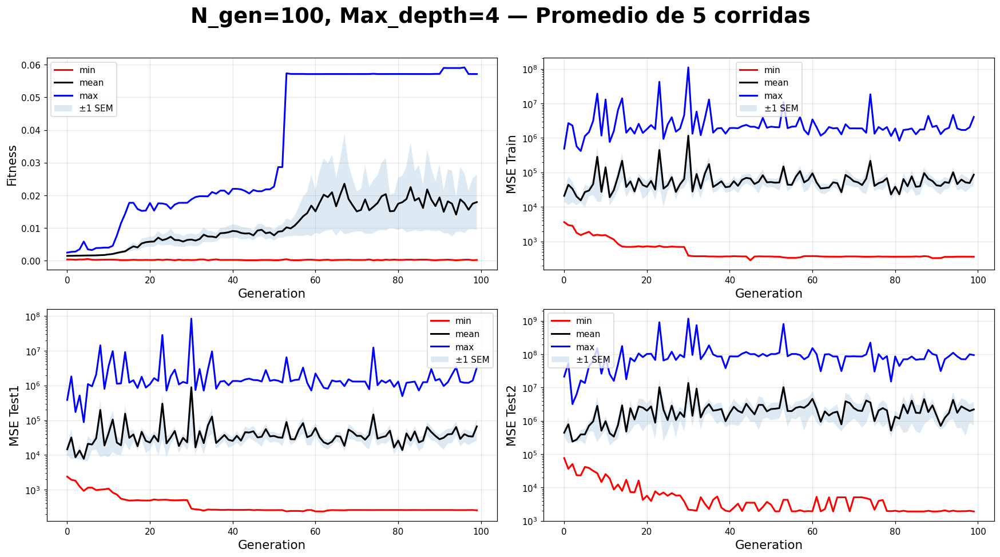

In [93]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 9 

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method = Tournament

Generation: 100%|██████████| 100/100 [00:04<00:00, 20.56it/s]


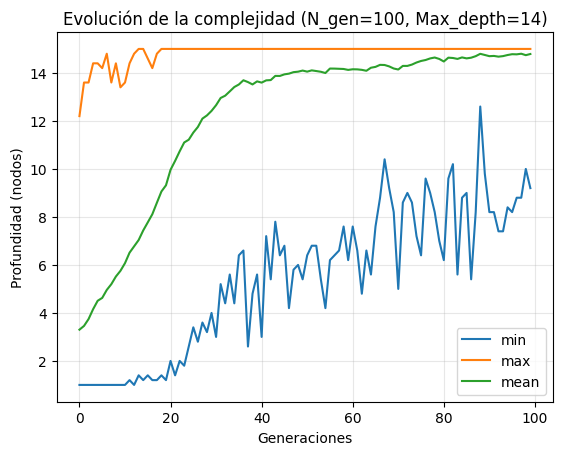

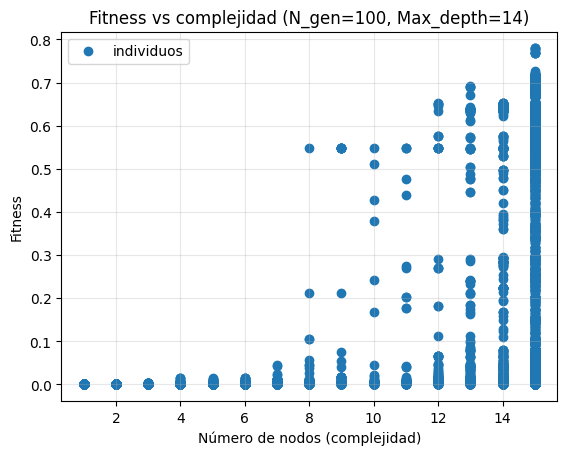

In [43]:
n_gen=100
max_depth=14
prob_mutation=0.15
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times X1 (times X1 X1)) (plus (minus (divide (plus (plus (plus X1 X1) (times (times X1 4.149221549990434) 4.149221549990434)) (times (minus X1 X1) (minus 4.446950292694789 (minus (times X1 4.149221549990434) X1)))) (plus (minus (minus (divide 9.936216750000682 X1) (plus (times 1.8267776865274754 (minus X1 X1)) (minus (plus X1 (times 1.198568304200145 1.782627598598514)) X1))) (minus (times X1 X1) (times (minus (times X1 X1) (times (times X1 4.149221549990434) 7.045297531854871)) 7.045297531854871))) (plus (plus (plus (plus 2.134247391137488 X1) (times X1 X1)) X1) (times (minus X1 X1) (plus (times X1 X1) X1))))) (plus (plus (plus 2.134247391137488 X1) (times X1 X1)) X1)) (plus (plus (plus 5.116651599272352 (plus X1 (times 1.198568304200145 1.782627598598514))) (times X1 (times X1 X1))) (times (minus X1 X1) (minus 4.446950292694789 (minus (minus (plus (times X1 X1) 9.840709211917488) (plus (times X1 X1) (minus (plus X1 (times X1 (times X1 X1))) 3.310604320626159))) (minus (times (

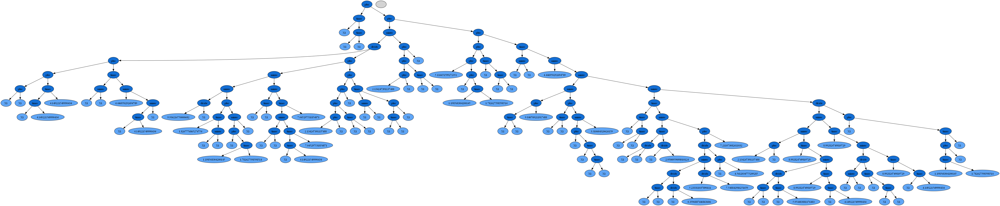

(plus (plus (plus (minus (times (times X1 X1) X1) (times X1 X1)) (minus (divide 9.394039326108153 (divide (plus (divide (times (times (minus X1 X1) (minus (divide X1 (plus (minus X1 X1) X1)) X1)) X1) 5.8458249120471075) (times (minus 9.394039326108153 X1) 3.642589060337956)) (minus (plus (minus (minus X1 (plus X1 (divide 6.889812792240917 (minus X1 X1)))) (minus 2.8734839996326746 (divide X1 9.50474169482365))) (divide (times (minus X1 X1) (times (minus 9.394039326108153 X1) X1)) 5.8458249120471075)) (divide X1 (plus (divide (times (times X1 X1) X1) (times (minus (divide (minus 0.7040808655607245 X1) 5.8458249120471075) X1) (minus X1 X1))) (times (minus (times X1 X1) 0.9469242301309144) X1)))))) X1)) X1) (plus (minus (times (times X1 X1) X1) (minus X1 (minus 7.731753615163863 (plus (divide (times (times X1 (times (times X1 X1) X1)) X1) (times (minus X1 X1) (minus (divide X1 (plus (times X1 X1) X1)) X1))) X1)))) X1))
*******************************************************************
  

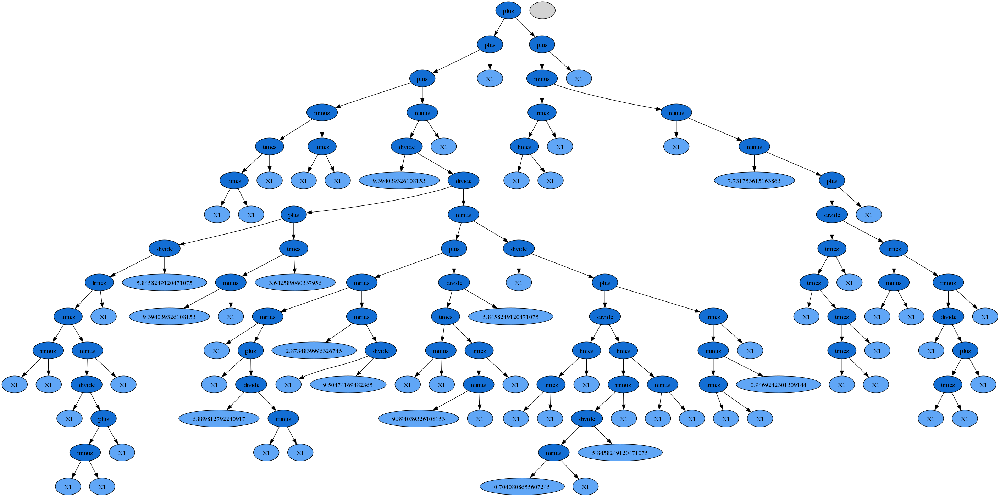

(plus (plus (times X1 (times X1 X1)) (times X1 (minus (divide (plus (divide (minus (minus 6.853555600134188 (times 4.195481432960379 X1)) (minus (minus (plus (times 7.780851025086307 X1) (times 8.134013080045623 X1)) X1) (minus 7.198482559543424 X1))) 5.93723013533134) (plus 7.213466470169932 X1)) (plus X1 X1)) X1))) (times X1 (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.18883
MSE         : 0.36907
DEPTH       : 13.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - 1.193579756865026*X1 + 4.790116550147707
*******************************************************************
 
                             TREE


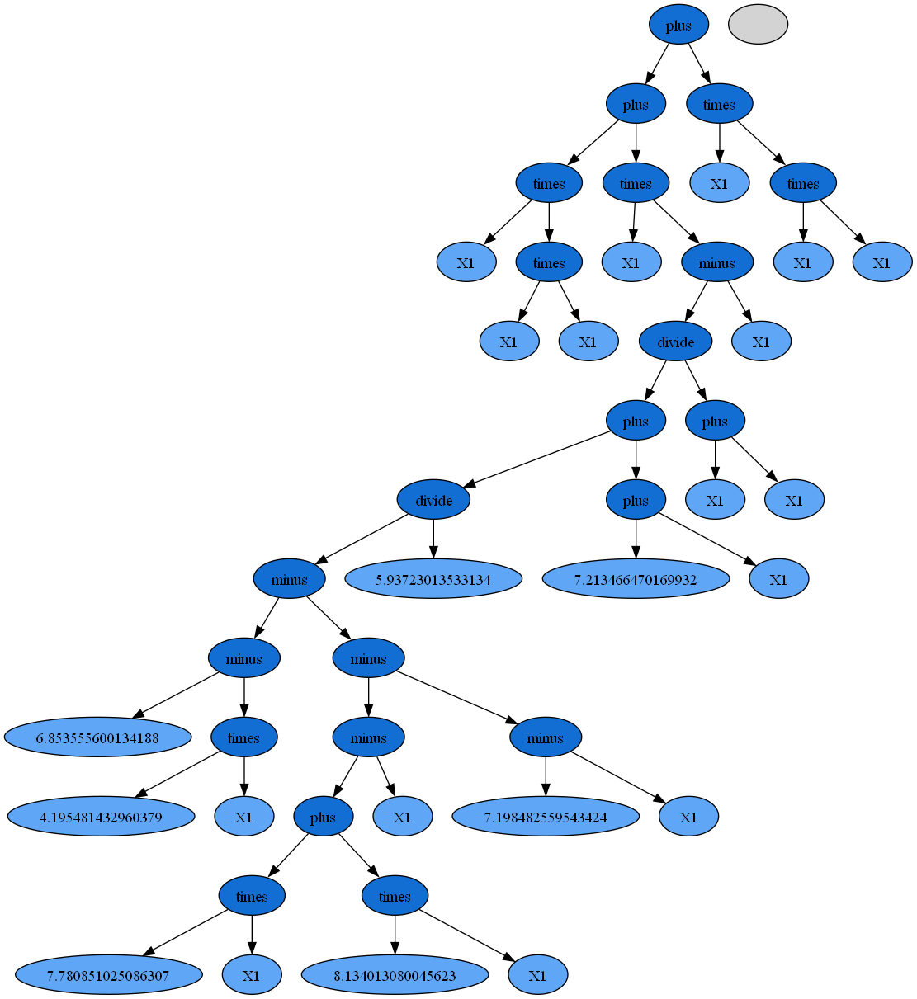

(plus (divide (times X1 X1) (divide 0.6052654416501502 X1)) (plus (divide 2.221031826338221 (plus (times (divide 0.6052654416501502 X1) (plus 5.553505408279635 X1)) (divide 2.221031826338221 (plus (times (times (minus 8.605588045512635 (divide (divide 0.6052654416501502 X1) (divide 1.1918549733772221 X1))) X1) (plus (minus X1 (divide 8.859305975289155 4.350532630132004)) (plus 5.553505408279635 X1))) (plus (times 4.190181966891322 (minus X1 (plus 5.553505408279635 X1))) X1))))) (divide 2.221031826338221 (plus (times (minus (divide 2.221031826338221 (plus (times 4.190181966891322 (plus (minus (times X1 (times 5.942700498761661 (times X1 7.772832582854949))) (times (minus (plus 3.429559883833464 X1) (minus 8.0439586269139 0.048127055264954866)) X1)) 3.1233021329490285)) (plus (times (divide 0.6052654416501502 X1) (plus 5.553505408279635 (times (divide (times X1 X1) (divide 0.6052654416501502 X1)) (minus X1 (plus 3.429559883833464 X1))))) (divide (divide (plus X1 5.059345725489126) (divid

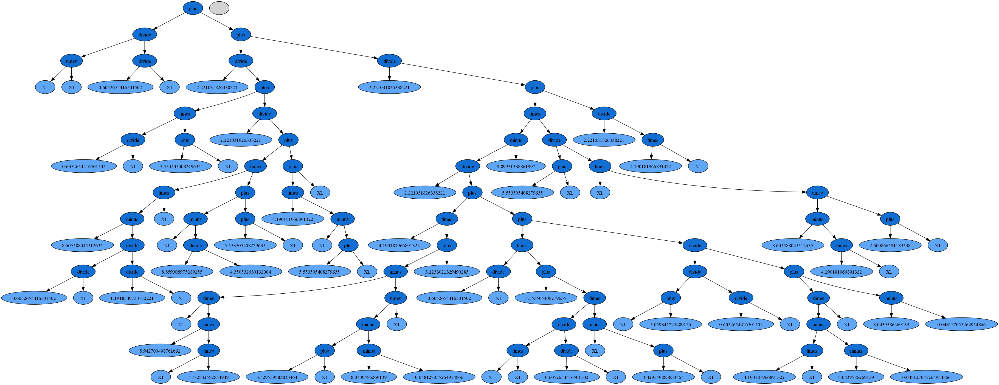

(plus (plus (times (times X1 X1) X1) (minus (plus (divide 2.7674632085393647 (plus (times (minus X1 X1) (times (times (plus 0.3380630569539156 (divide (times X1 (divide X1 (minus 9.296540155020587 5.045394730469378))) X1)) (times (plus X1 7.9292658879357205) (divide 2.7674632085393647 (plus (times (divide X1 0.9458550492656914) X1) 4.473440299826828)))) X1)) (divide (plus 2.8624199441657217 3.361116262801543) 9.106938237815033))) (minus (plus (divide 2.7674632085393647 (plus (divide (divide (minus (times X1 5.399160416067767) (plus X1 X1)) (times (times X1 X1) X1)) (plus (times X1 5.399160416067767) (times (times X1 X1) X1))) (plus 7.283973714306066 (plus (minus (plus 0.3380630569539156 (divide (divide 1.4929153066378487 X1) (divide X1 0.9458550492656914))) (plus X1 X1)) (plus 7.283973714306066 (divide (plus 2.8624199441657217 3.361116262801543) 9.106938237815033)))))) (times (minus X1 X1) (plus (times (divide X1 0.9458550492656914) X1) (times (minus X1 X1) (plus (plus X1 (plus X1 (plu

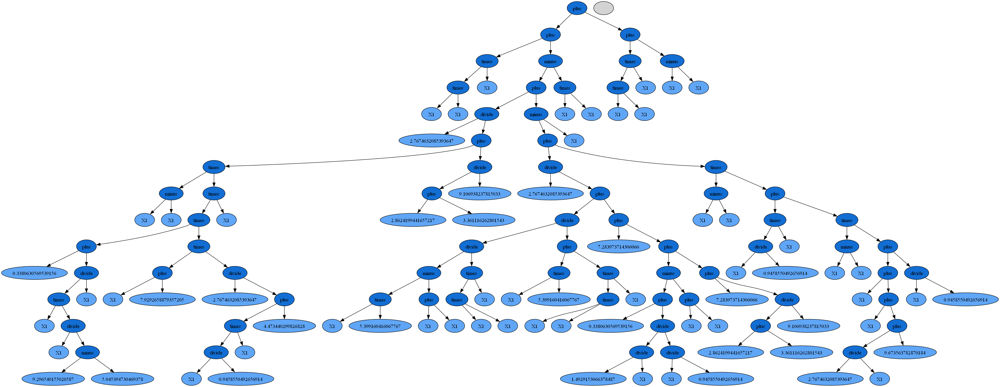

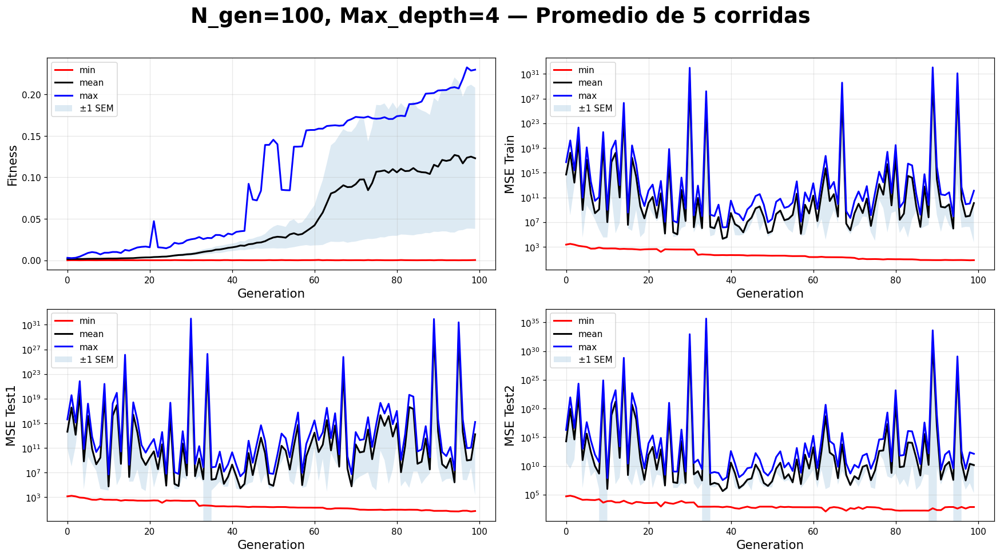

In [44]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 10

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:04<00:00, 20.06it/s]


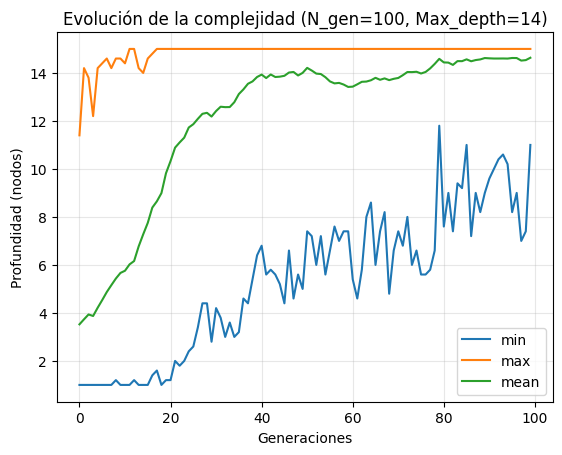

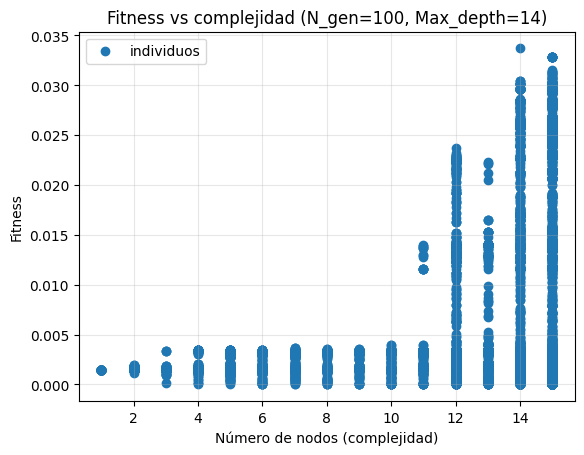

In [45]:
n_gen=100
max_depth=14
prob_mutation=0.15
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times (plus (times X1 X1) (minus (plus (divide (times (divide X1 4.667184997056579) (divide (minus 4.271799188964071 9.625540229802183) (times 5.906835780048408 X1))) (divide 2.230570518066134 (plus (minus (plus (divide (divide 0.05177059081358237 1.7274944288646665) (divide 1.059233653567896 (times 4.682208184023496 7.150552190430912))) (times 3.119640023153729 (plus X1 (plus X1 X1)))) (times 3.3392217815171135 (divide X1 (plus 2.432589511900507 7.475364552504638)))) X1))) 0.43647145171371693) (divide (times (divide X1 4.667184997056579) (divide (minus 4.271799188964071 9.625540229802183) (times 5.906835780048408 X1))) (divide 2.230570518066134 (plus (plus (times (times (plus 2.432589511900507 7.475364552504638) X1) X1) (times X1 X1)) X1))))) X1) (divide (times (plus (times (minus 7.150552190430912 (divide X1 (plus X1 X1))) (times (times (divide X1 4.667184997056579) (divide (minus 4.271799188964071 9.625540229802183) (times 5.906835780048408 X1))) X1)) (plus (minus X1 X1) (div

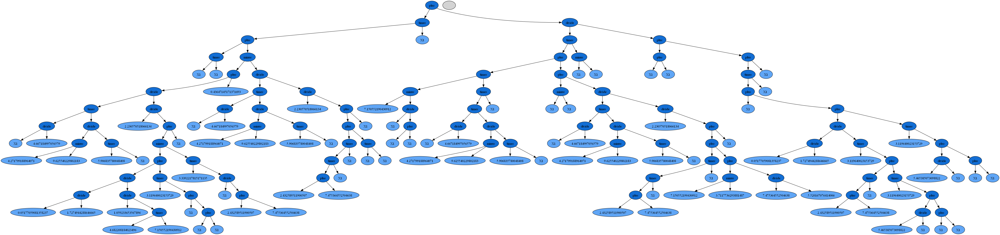

(plus X1 (plus (plus (minus 8.63514196362648 (minus (plus X1 (plus X1 5.426828555479045)) (times X1 X1))) (minus (minus (times (times X1 X1) (minus X1 1.7515915292599071)) (divide (times (times X1 X1) (minus X1 1.7515915292599071)) (times (minus X1 1.7515915292599071) (times (divide 4.809297421932489 7.3187291593502195) 9.50695208899923)))) (times (times (divide (divide (divide 7.682450645357177 9.609989809336343) 8.710856187139921) 7.212661838453565) X1) (times 3.206046564509081 (divide (divide X1 (plus X1 1.1464456872114137)) (times (times (times X1 X1) (minus (plus X1 (plus X1 5.426828555479045)) (times X1 X1))) (times (divide X1 X1) 9.50695208899923))))))) (plus (times (times X1 X1) X1) (plus (divide 7.682450645357177 9.609989809336343) (times (divide (divide 1.6390314448861887 8.710856187139921) 7.212661838453565) X1)))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.16415
MSE         : 0.51856
D

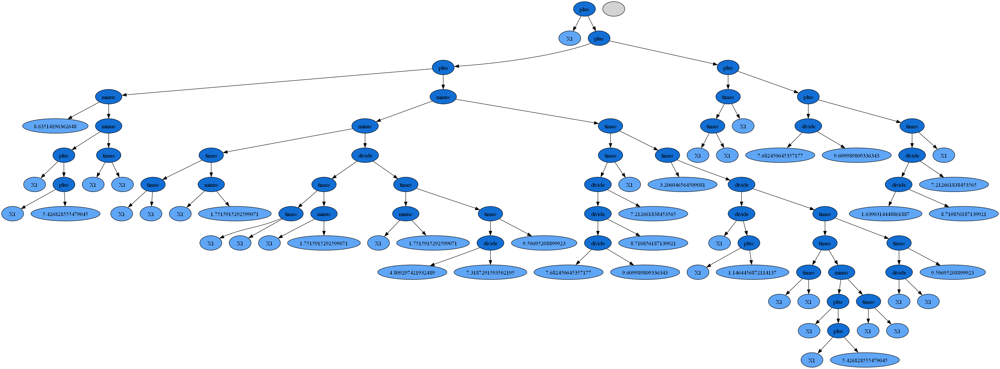

(minus (plus (times X1 (times X1 X1)) (plus (times X1 (times X1 X1)) (divide (plus (minus (plus X1 (divide (plus X1 (divide (times X1 X1) (plus X1 X1))) X1)) (times (plus (times 4.719258233030831 X1) (times 0.5639105148553747 X1)) (divide (plus X1 (minus X1 8.550510424538038)) X1))) (divide X1 X1)) 9.541104907144204))) (times (times X1 X1) (divide X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.94350
MSE         : 0.00007
DEPTH       : 12.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - 1.002644619137278*X1 + 4.996673856682712
*******************************************************************
 
                             TREE


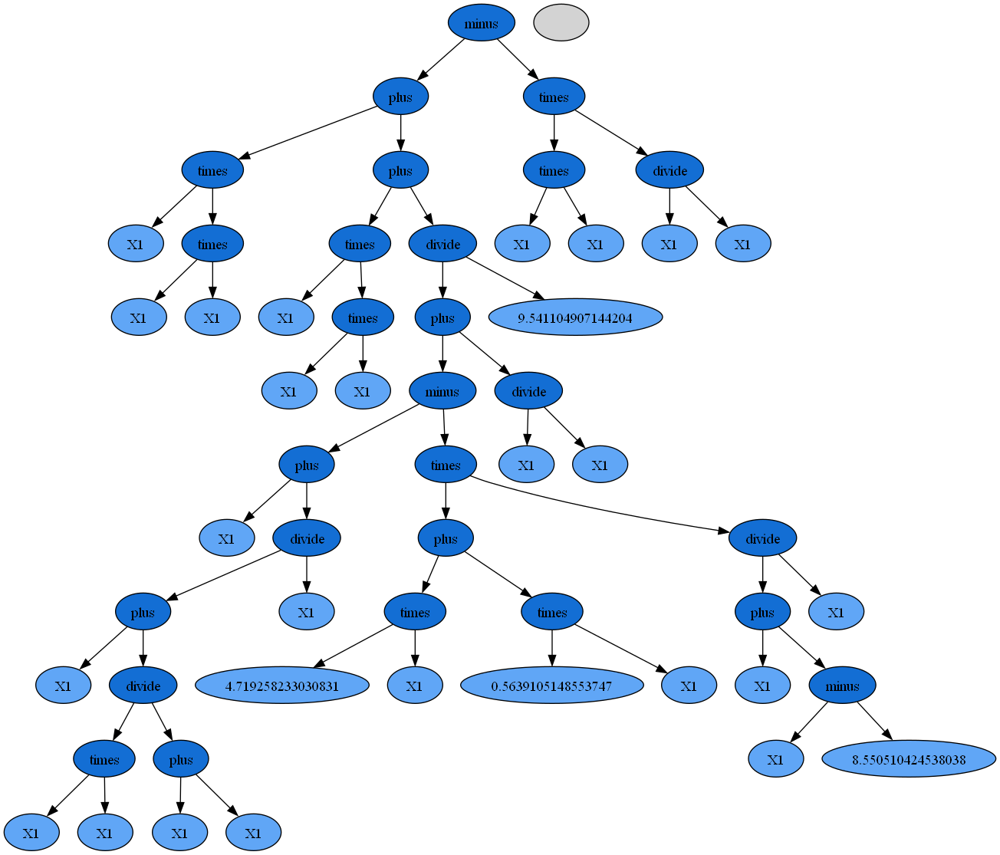

(times (plus (times X1 (minus X1 (divide X1 (times (plus (minus X1 (divide (times X1 X1) (minus X1 (times (divide X1 (divide 3.1526089926082754 X1)) 1.4865868813110816)))) (divide (plus 2.1621879194972404 (plus X1 X1)) (times (minus X1 (plus (divide (divide (plus 8.20487684811077 X1) (divide 3.581577526506182 4.439043628557846)) (divide 3.581577526506182 4.439043628557846)) (plus X1 7.154828203479058))) 9.244562775318784))) X1)))) (times X1 (minus X1 (divide X1 (minus X1 (divide X1 (times X1 (times X1 (divide (times X1 X1) (minus X1 (divide (plus 8.20487684811077 X1) (divide 3.581577526506182 4.439043628557846)))))))))))) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.06065
MSE         : 4.79812
DEPTH       : 15.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1*(X1 - X1/(X1 + (0.2394101749036044*X1 + 10.1692078493795

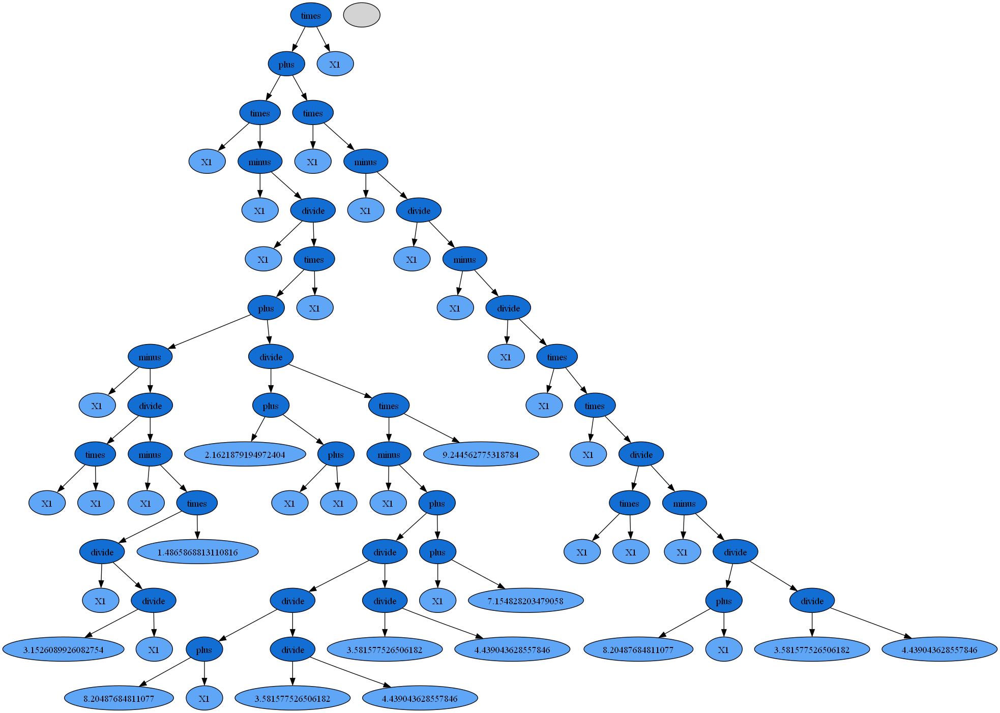

(plus (times (plus X1 X1) (times X1 X1)) (plus (plus X1 (minus 7.187945920909429 (times 0.5441954661085213 3.289048206260162))) (minus (divide (plus (times X1 X1) (minus 7.187945920909429 (times 0.5441954661085213 (times X1 (plus X1 X1))))) (minus (divide (minus (minus (minus (divide X1 X1) X1) (plus X1 4.175777580197022)) 7.418286948233133) (divide (plus (plus (times (divide 3.289048206260162 (minus X1 X1)) X1) X1) (divide 2.61737742956182 X1)) (plus (plus 9.473836328733043 X1) (minus X1 9.124507970682693)))) (times (times 0.5441954661085213 3.289048206260162) 7.658021877621354))) (minus (plus (plus X1 X1) (plus (times X1 X1) X1)) X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.53677
MSE         : 0.01490
DEPTH       : 13.00000
*******************************************************************
 
                        REDUCED TREE
             ((0.08839093221704261*X1**2 - 7.187945920909429)*(

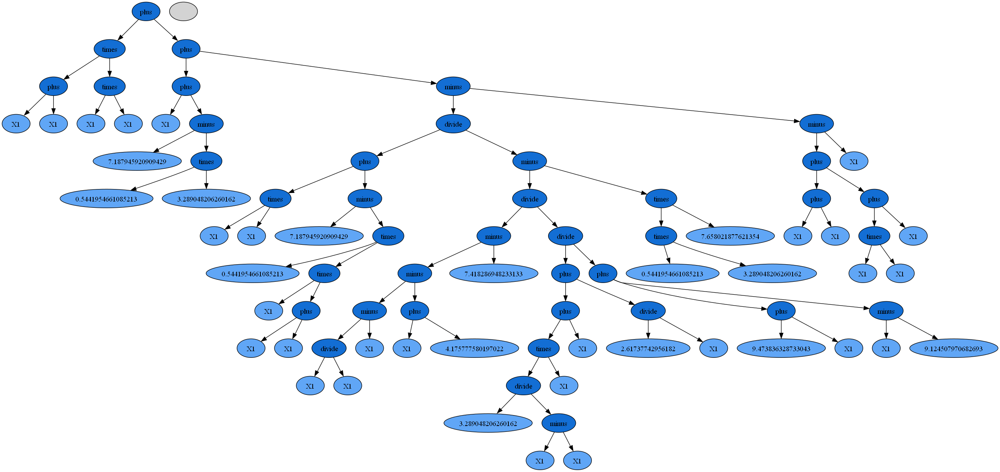

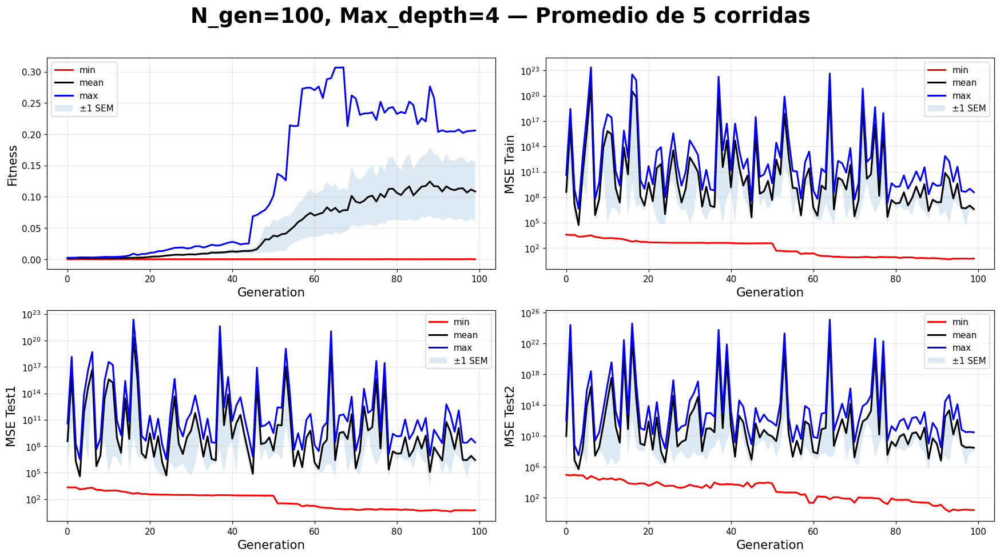

In [46]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 11

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 100/100 [00:04<00:00, 24.02it/s]


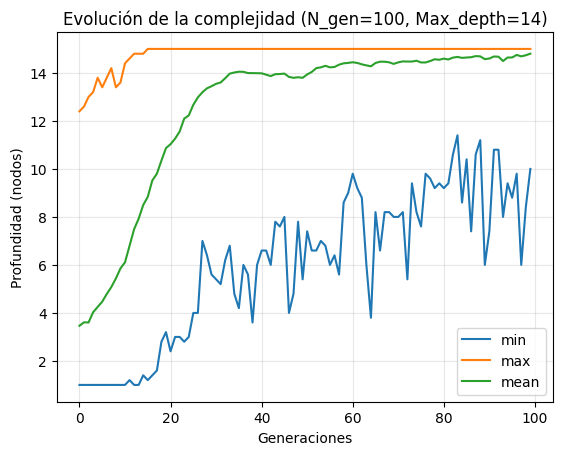

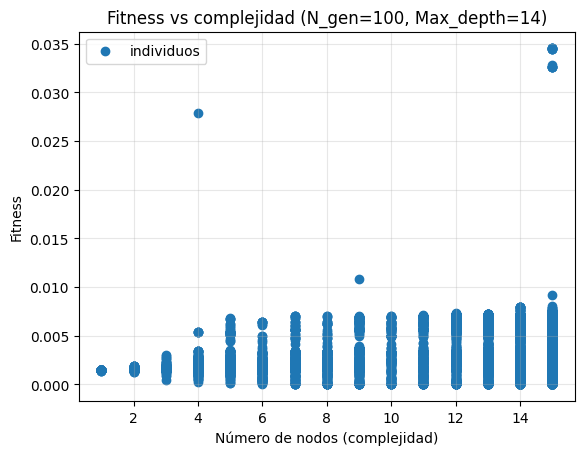

In [47]:
n_gen=100
max_depth=14
prob_mutation=0.15
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (minus (plus (plus 2.7614662281744318 (divide (minus (times (divide 1.0412977409601742 (times 9.456251202445852 3.8113812668892786)) (minus (divide 1.0412977409601742 (times 9.456251202445852 3.8113812668892786)) (times X1 X1))) (divide (minus 5.066949863058531 X1) (plus (plus X1 (times 3.34193867655077 (minus X1 X1))) (plus (plus 7.231019845599454 0.6820792490776284) (minus (divide X1 3.84320766026252) X1))))) (times X1 9.78624117924882))) (times (plus (divide (divide (minus (divide X1 3.84320766026252) X1) 3.260810909853099) (minus (minus (divide 5.680376037417313 X1) X1) (minus (times X1 (divide 4.056528109041602 X1)) (minus (plus (times 4.882537081428576 X1) (times X1 X1)) (minus (minus (times (times X1 (times X1 X1)) (minus X1 X1)) (times X1 X1)) (times (plus (minus X1 X1) X1) (plus X1 X1))))))) (minus (plus 9.702618903525552 (plus X1 (times (times 8.10965216213126 (plus X1 9.30457567269543)) (plus (times X1 X1) X1)))) (minus (minus (times (divide 1.0412977409601742 2.761466

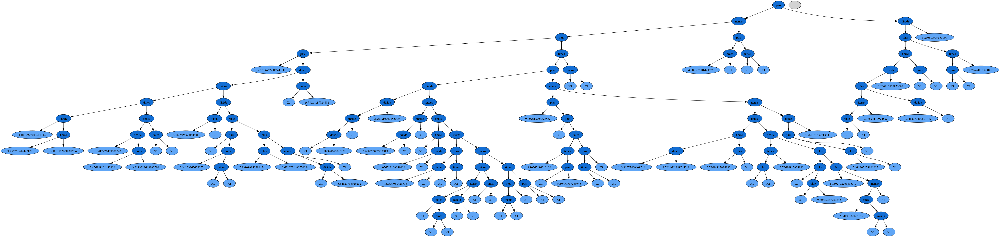

(minus (divide X1 (plus (divide (times (minus (times (times X1 X1) (plus (times (times (minus X1 (divide X1 X1)) X1) (minus X1 (times (times 2.044531414955105 X1) X1))) X1)) 2.6494614724005716) X1) 0.9283699591745298) (plus (divide (plus (divide X1 X1) (minus X1 X1)) (times (divide (divide (plus X1 (times (times 2.9955400318815695 (minus (divide (minus 6.062331305786103 X1) (times 1.8529898249182652 X1)) (times (divide X1 X1) (times 1.518019619381883 X1)))) (divide (divide (plus (divide X1 5.534261769363223) (plus 3.184518356567616 0.6587841251367843)) (divide X1 5.724844644046639)) (divide (times 5.850247222379965 (plus X1 X1)) (plus (minus 9.226313999790511 7.735077685615379) (plus X1 X1)))))) (times (divide 3.660662510430538 (times 3.237579666178262 (times (times (plus X1 5.098936376770304) (times X1 1.6758735000355551)) (times X1 2.562097699445082)))) (times (times X1 (times (divide (times X1 6.970166857835376) 6.585141356854538) (minus 3.6219348451538624 (divide X1 2.8984424703814

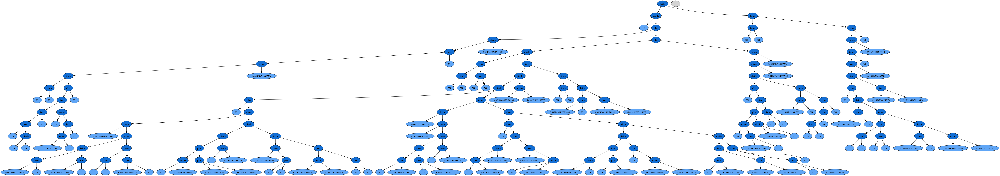

(plus (plus (plus (times (plus (minus X1 (divide (minus 8.799446412791662 (plus 6.422301945206861 (times (plus 0.9114275430016505 X1) (minus (times 6.133464921391234 X1) (times (minus 6.877052043312055 X1) X1))))) (plus (plus (minus X1 X1) (divide (minus (minus 8.689150859850557 X1) (times X1 6.276540581357373)) 6.133464921391234)) (plus (times (divide (times 6.133464921391234 X1) (plus 9.371663036004941 (plus 2.6720323076882435 5.17904268872525))) (divide (minus (plus 2.4327881858234255 X1) (plus X1 1.7951727784601157)) 9.161650448289976)) (times (minus 6.877052043312055 X1) X1))))) 5.17904268872525) X1) (divide (plus X1 (times 6.133464921391234 X1)) (divide (plus X1 7.278990066777482) (plus 9.371663036004941 (plus 2.6720323076882435 5.17904268872525))))) (plus 2.6720323076882435 (divide (divide (minus (times (divide 6.422301945206861 (plus 8.715488299602448 5.476896657019866)) 0.6261205078183618) (times (minus 6.877052043312055 X1) X1)) (plus (minus X1 (times X1 6.2947420515762085)) 

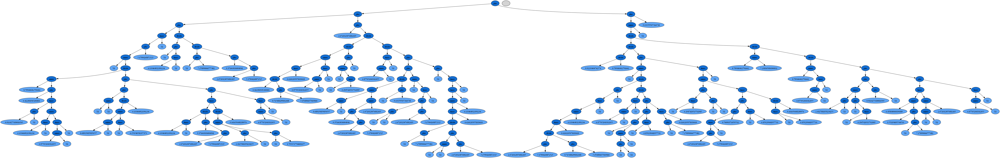

(minus (times (times X1 X1) (plus X1 X1)) (plus X1 (minus (times X1 X1) (plus (times (divide X1 X1) 3.9504592499155744) (times 1.830035835001227 (divide (plus X1 X1) (times 3.5450897322345765 X1)))))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.89209
MSE         : 0.00029
DEPTH       : 8.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.9828933902202264
*******************************************************************
 
                             TREE


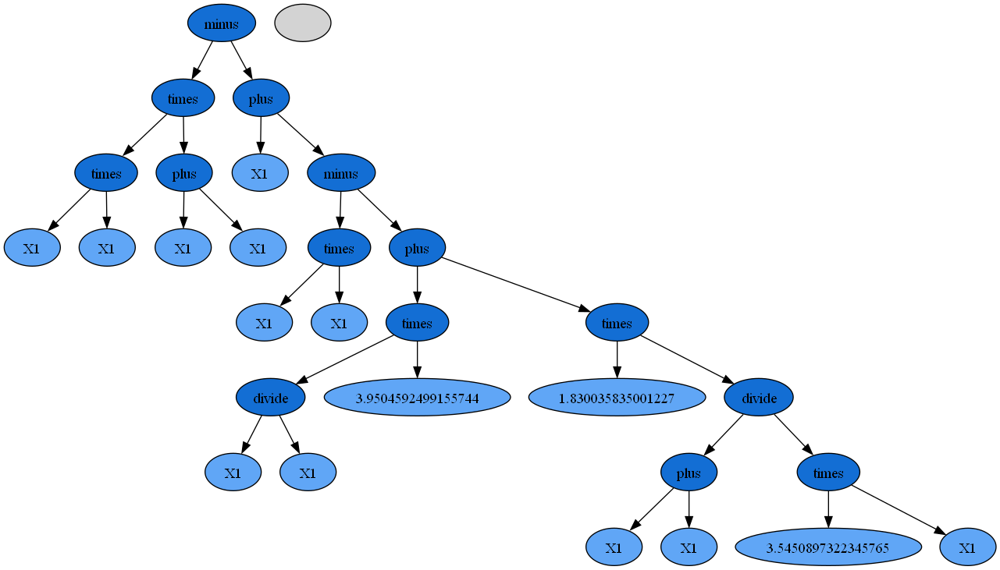

(plus (minus 0.8812735368835511 X1) (plus (times X1 (times X1 X1)) (plus (plus (times X1 (times X1 X1)) 3.7498511941571477) (minus (divide (plus (plus (minus 0.8812735368835511 X1) (plus X1 X1)) 9.00794781293413) (times (plus (times X1 X1) (minus 9.46194845313867 (plus X1 X1))) 4.10518464299818)) (times X1 X1)))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.39885
MSE         : 0.04543
DEPTH       : 10.00000
*******************************************************************
 
                        REDUCED TREE
             (X1 + (4.10518464299818*X1**2 - 8.21036928599636*X1 + 38.8430454826653)*(2*X1**3 - X1**2 - X1 + 4.6311247310406988) + 9.889221349817682)/(4.10518464299818*X1**2 - 8.21036928599636*X1 + 38.8430454826653)
*******************************************************************
 
                             TREE


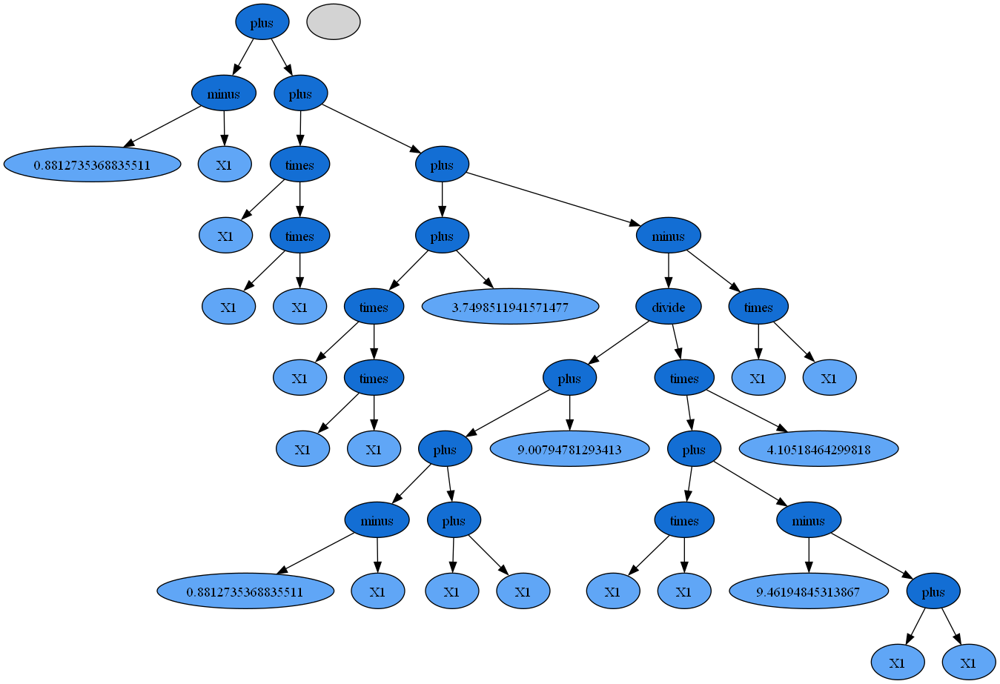

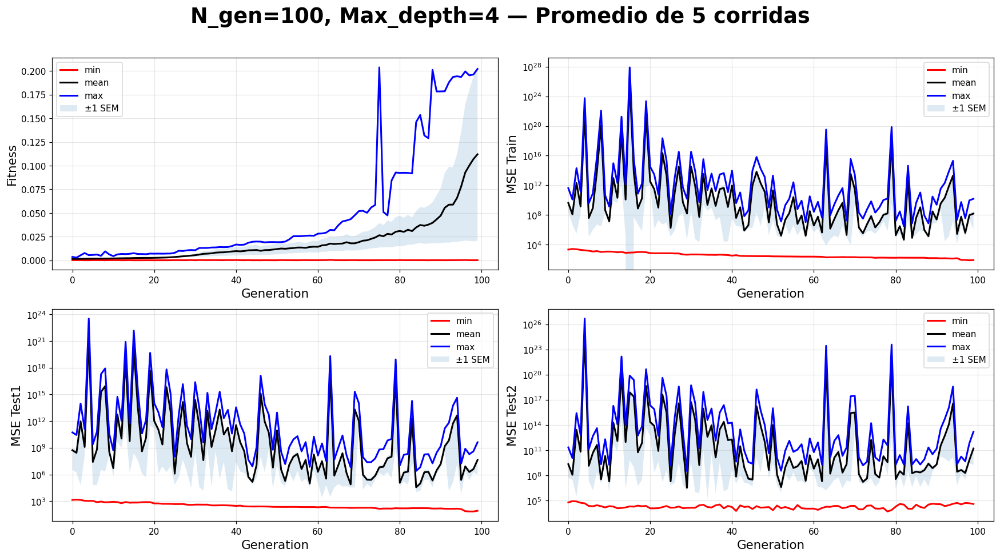

In [48]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 12 

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:03<00:00, 30.60it/s]


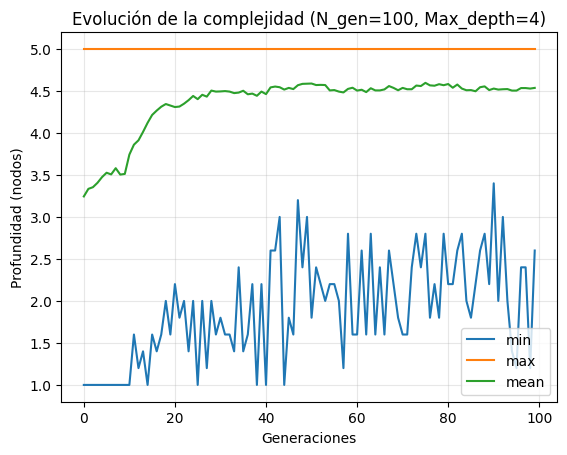

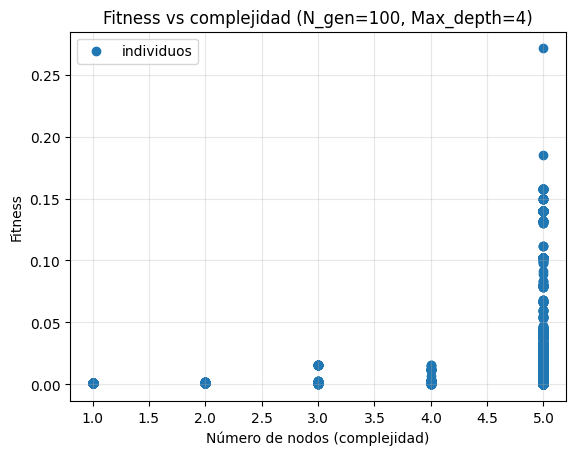

In [ ]:
n_gen=100
max_depth=14
prob_mutation=0.15
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (plus (times (plus X1 X1) (times X1 X1)) (minus (minus 3.7545859295374164 X1) (minus 2.1288874748188036 X1))) (minus (minus (times X1 X1) (minus 6.656599297731788 7.030294634087614)) (minus (minus 3.7545859295374164 X1) (minus 6.656599297731788 7.030294634087614))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.27107
MSE         : 0.14462
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.3802843842560292
*******************************************************************
 
                             TREE


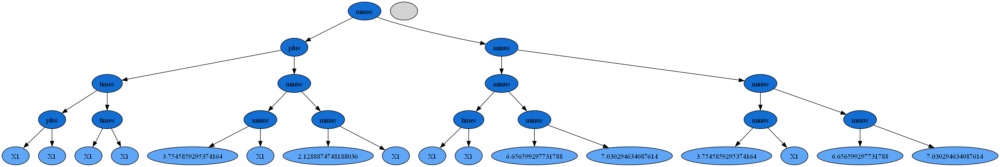

(plus (minus (minus 3.8263417130019963 X1) (times X1 X1)) (plus (times (times X1 X1) X1) (times (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.10754
MSE         : 1.37747
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 3.8263417130019963
*******************************************************************
 
                             TREE


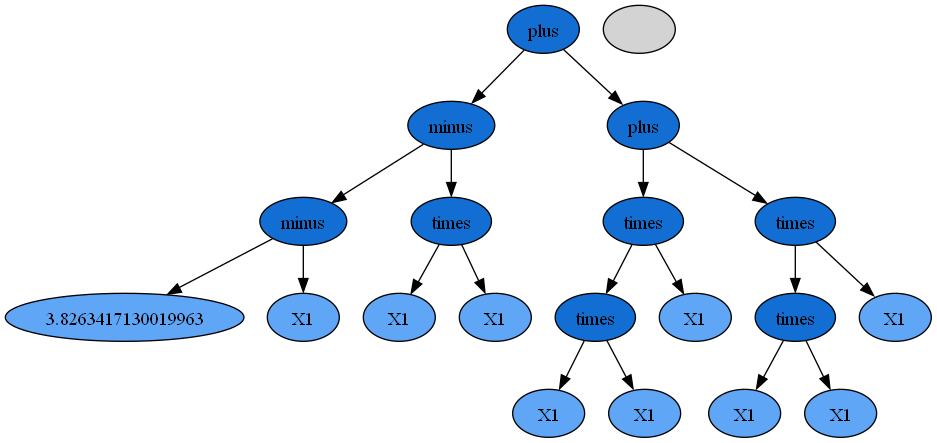

(minus (plus (times (times X1 X1) X1) (times (times X1 X1) X1)) (minus (times X1 X1) (minus (plus X1 5.539544984546975) (plus X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.20768
MSE         : 0.29111
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.539544984546975
*******************************************************************
 
                             TREE


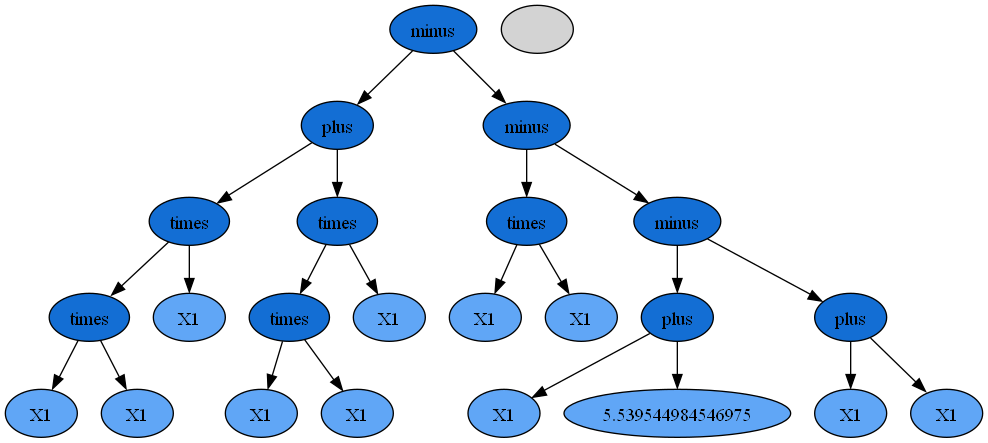

(times (plus X1 X1) (times X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01535
MSE         : 82.27885
DEPTH       : 3.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3
*******************************************************************
 
                             TREE


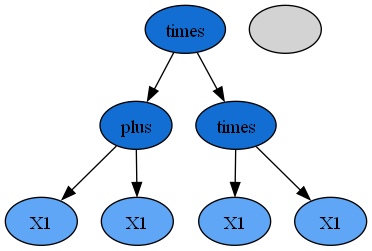

(plus (plus (minus (minus X1 X1) (times X1 X1)) (times X1 (times X1 X1))) (times X1 (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02379
MSE         : 33.67347
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2*X1 - 1)
*******************************************************************
 
                             TREE


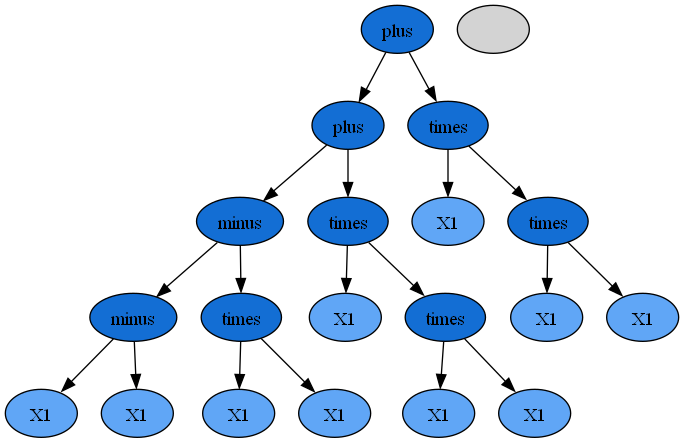

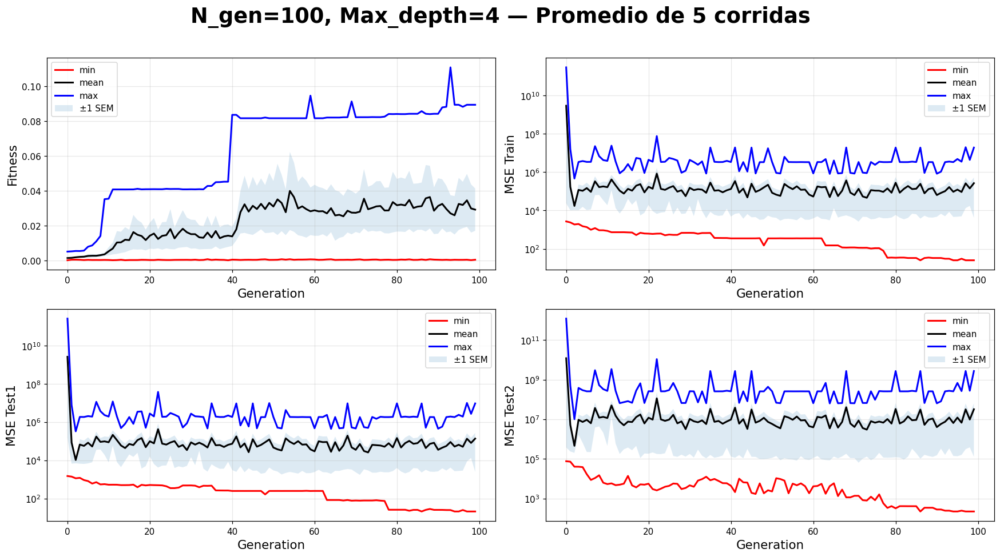

In [50]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 13

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Tournament

Generation: 100%|██████████| 100/100 [00:03<00:00, 26.18it/s]


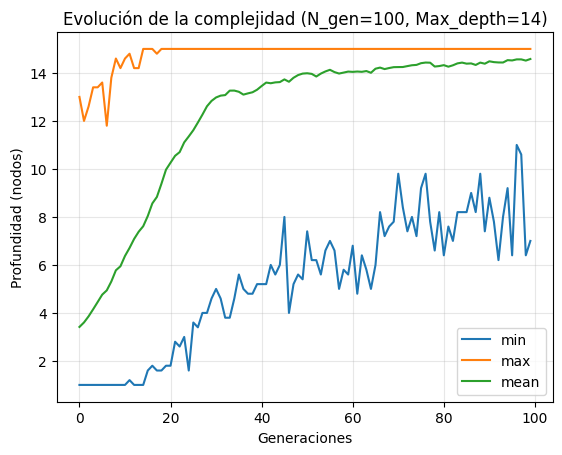

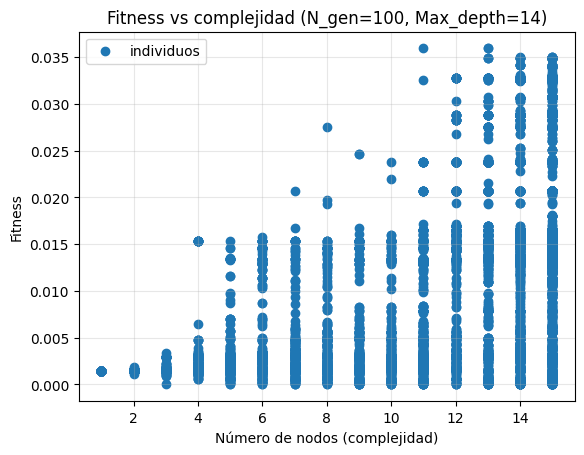

In [51]:
n_gen=100
max_depth=14
prob_mutation=0.10
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times X1 (times X1 X1)) (plus (divide (times X1 (plus (times X1 X1) (times X1 (divide X1 X1)))) (minus (plus (times X1 0.17235271493940552) (minus (plus (times (minus X1 X1) (times (plus X1 X1) (times X1 X1))) (divide X1 X1)) X1)) X1)) (times X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03593
MSE         : 14.39616
DEPTH       : 11.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(X1*(3.655294570121189*X1 - 2) - X1 - 1)/(1.8276472850605945*X1 - 1)
*******************************************************************
 
                             TREE


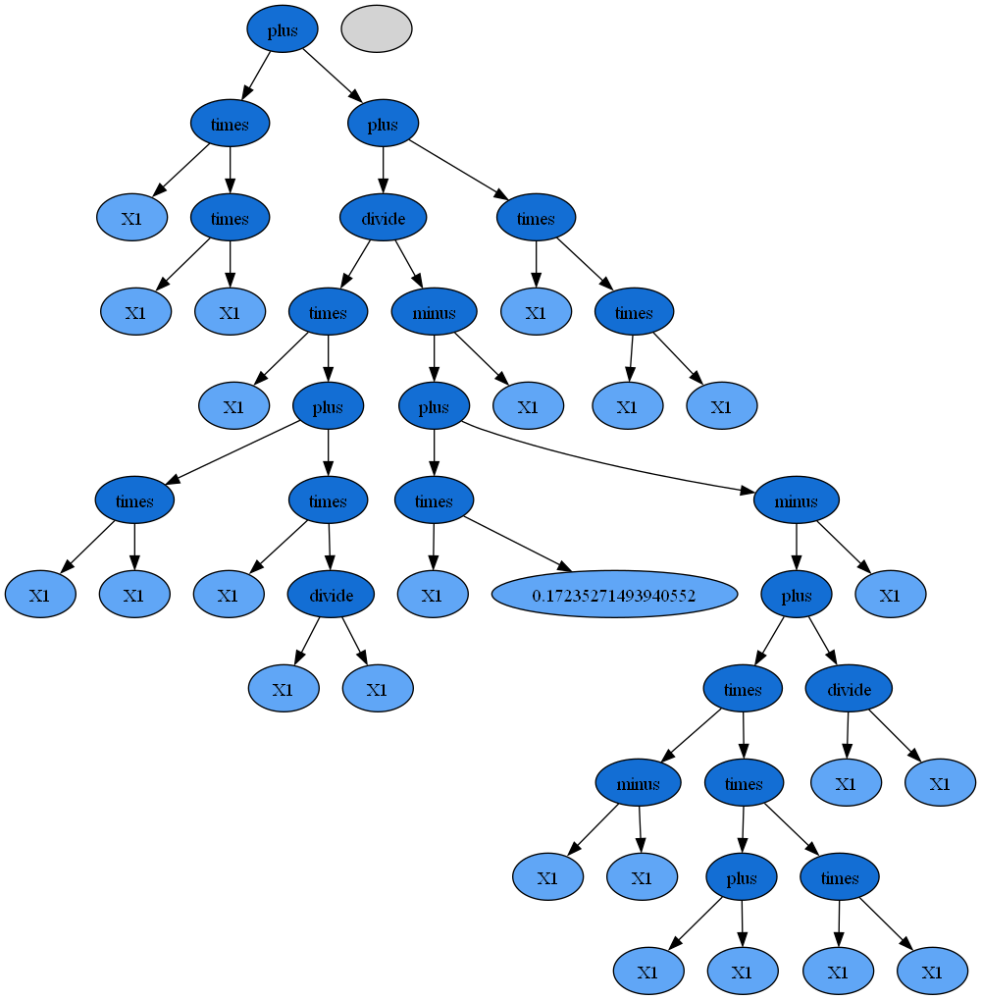

(plus (divide (divide X1 1.4984113616361838) X1) (minus (minus (minus (times (times X1 X1) (plus X1 X1)) 4.067884691103705) (plus (minus (minus (divide X1 (plus (plus (plus (divide 8.240579983375154 (plus X1 X1)) (minus X1 (plus (minus (divide 4.067884691103705 9.765545711977737) (plus X1 X1)) (plus 0.35238012684437825 0.2552329310881152)))) (plus (minus (times (plus X1 (times X1 X1)) X1) 4.067884691103705) (divide (plus (minus X1 X1) (plus 2.141095911325619 (minus 3.550965118440695 X1))) (divide 3.9949926874167363 X1)))) X1)) 8.243518218659542) (minus 6.953814945034793 X1)) (divide X1 (divide X1 (plus 6.721762780114852 (minus X1 X1)))))) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.79133
MSE         : 0.00139
DEPTH       : 15.00000
*******************************************************************
 
                        REDUCED TREE
             (2.0*X1**7 + 0.49937330140815582*X

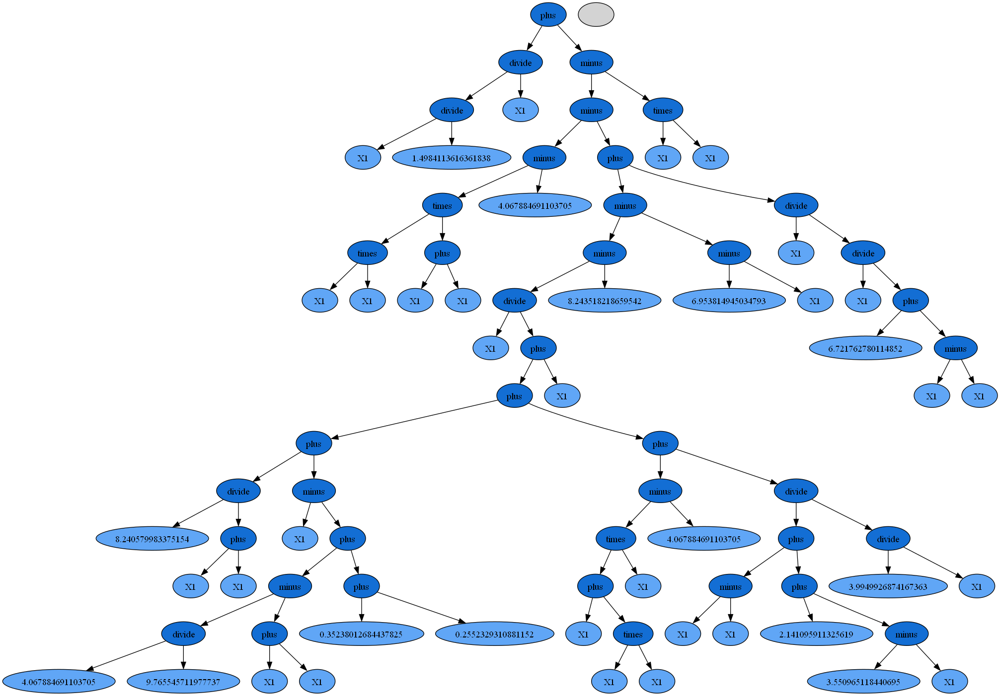

(plus (minus (times (times X1 X1) (plus X1 X1)) (divide (times (plus X1 2.439711291244117) (times (times (divide (times (plus (minus (times 1.6946576935518987 X1) 5.440974270200467) X1) (minus (plus 8.56590102859096 X1) 1.7176271608275484)) (times (plus 8.508912677831614 (minus X1 X1)) (times 1.6946576935518987 X1))) X1) (times 1.2094214582048124 X1))) (times (plus 8.508912677831614 (times (times (times (plus 8.508912677831614 (plus 8.56590102859096 X1)) (minus (minus (times (minus X1 X1) X1) X1) (times (divide (times (plus 8.56590102859096 X1) (minus (plus 8.56590102859096 X1) 1.7176271608275484)) (times X1 (times (divide 8.144047952191645 X1) (plus X1 X1)))) X1))) (divide (times (times (minus X1 X1) X1) (times X1 (times (times (times X1 X1) 9.256587498366315) (plus X1 X1)))) (times (plus (times X1 X1) X1) (times X1 (times (plus 8.508912677831614 2.439711291244117) X1))))) (plus X1 (minus (minus X1 4.8434575009906204) 1.7176271608275484)))) (times X1 0.22659067522736165)))) X1)
******

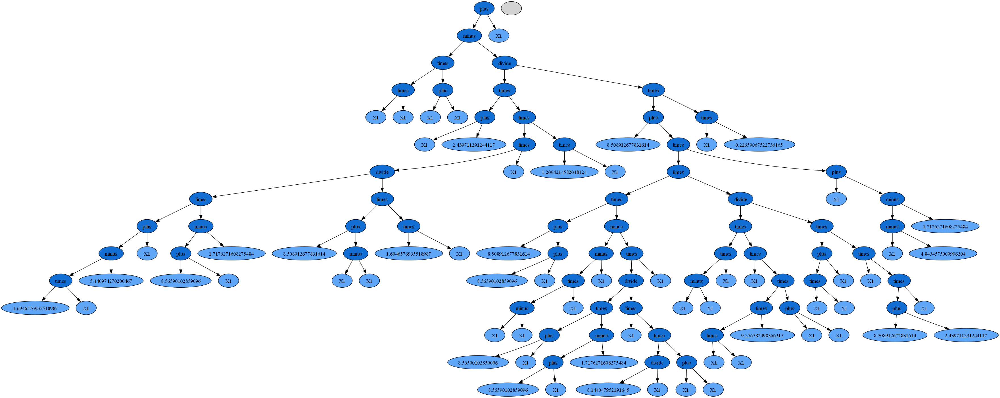

(plus (plus (plus (times 8.11400089594349 X1) (minus X1 (divide X1 (divide (divide X1 (minus (plus (plus (plus 1.1520741409906232 4.623984467405058) (minus 9.265008976321926 0.6886936207920491)) (minus (times 1.6014875819228247 X1) (times X1 X1))) (minus 4.200476125181226 (minus (minus X1 (divide X1 (minus (minus 6.647602542941815 2.8767185697050857) 1.1520741409906232))) (minus X1 X1))))) X1)))) (minus 6.5355034285110225 X1)) (plus (divide X1 (minus (times X1 (minus (minus X1 (divide X1 (plus (minus (minus X1 (divide X1 (plus X1 8.11400089594349))) (divide (times X1 (divide (minus X1 9.47428327598957) (times X1 X1))) X1)) (plus (minus X1 (times (times 5.6713699795791195 (divide 0.5883353257553081 X1)) (minus (minus 6.647602542941815 2.8767185697050857) 1.1520741409906232))) X1)))) (minus (plus (plus X1 X1) (minus 4.200476125181226 (minus (minus X1 (divide X1 (plus X1 8.11400089594349))) (minus X1 X1)))) (minus X1 X1)))) (minus (plus (times 6.86790203821449 3.2018898311052393) (divide 

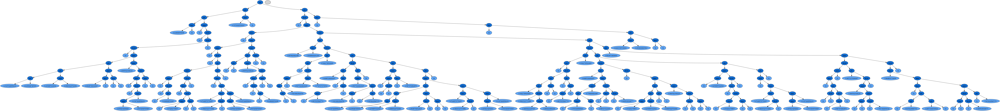

(times (times (times X1 3.7396680781172407) (divide 6.872381854834878 6.065651096617445)) (times (divide X1 2.774937846893325) (minus X1 1.012883404123529)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00596
MSE         : 555.87151
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(1.5268966909738317*X1 - 1.5465683180985268)
*******************************************************************
 
                             TREE


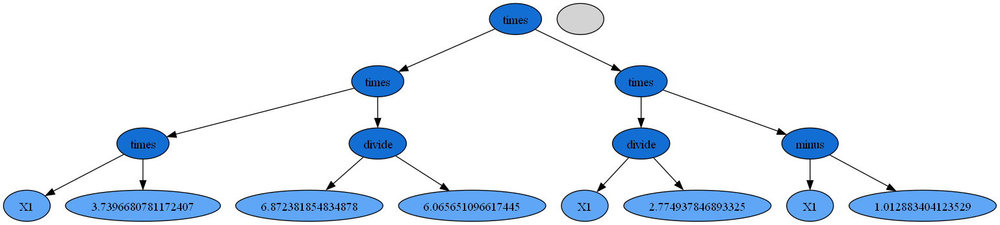

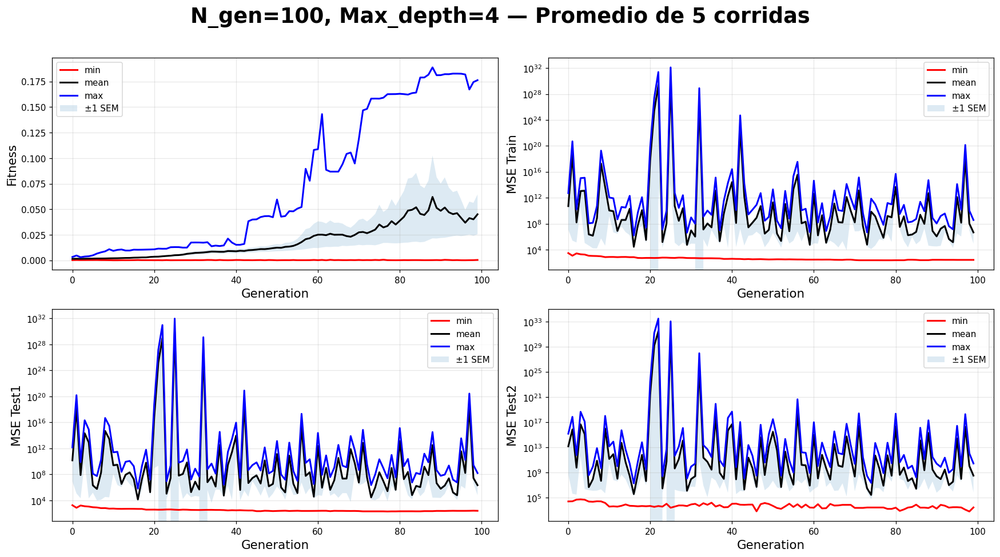

In [52]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 14

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:03<00:00, 25.20it/s]


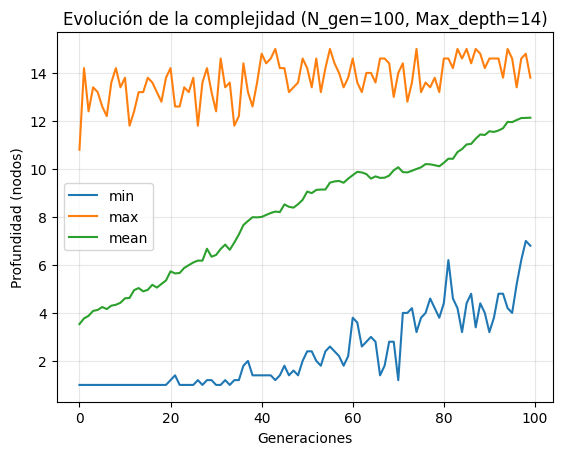

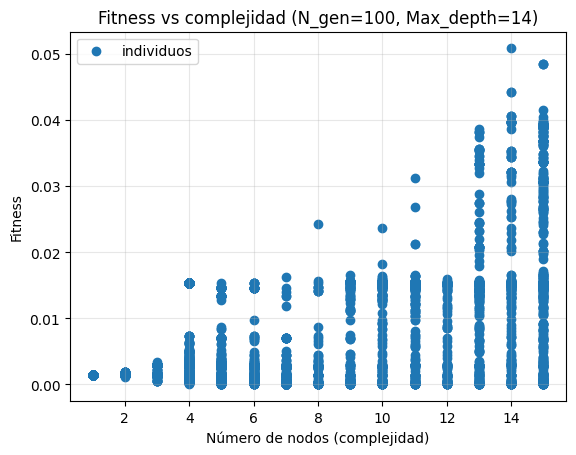

In [53]:
n_gen=100
max_depth=14
prob_mutation=0.10
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times X1 (plus (times X1 (plus (divide (divide (times X1 (divide (divide (plus (plus (times X1 X1) (times X1 X1)) (times X1 X1)) (plus (plus (times X1 X1) (plus (times X1 X1) (times X1 X1))) (times X1 X1))) 0.746185231097467)) (plus (times X1 X1) 4.9343084518694935)) (divide (divide (times X1 (minus 0.746185231097467 X1)) X1) (times X1 X1))) X1)) (times X1 (plus (divide (divide (times X1 X1) (times X1 (plus (divide (plus (plus (times X1 X1) (times X1 X1)) (times X1 (minus 0.746185231097467 X1))) (times X1 X1)) X1))) (times X1 X1)) X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.05086
MSE         : 6.96487
DEPTH       : 14.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2.0*X1**6 - 0.49748282403694244*X1**5 + 8.8635045418969786*X1**4 + 1.6412159205941809*X1**3 - 0.74618523109746704*X1**2 - 0.56046242984090523*X1 

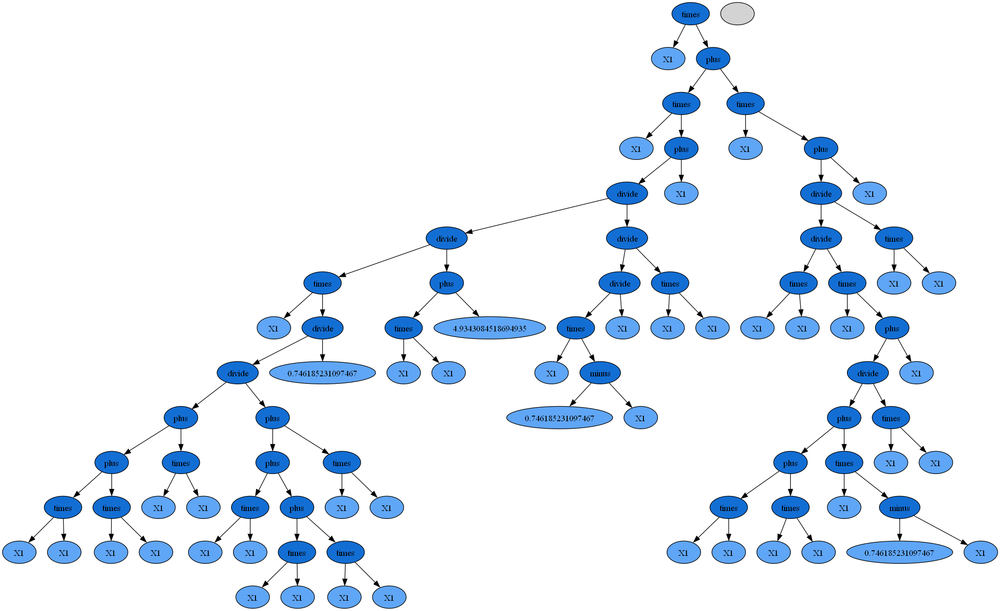

(times X1 (plus (minus (times X1 X1) X1) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02379
MSE         : 33.67347
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2*X1 - 1)
*******************************************************************
 
                             TREE


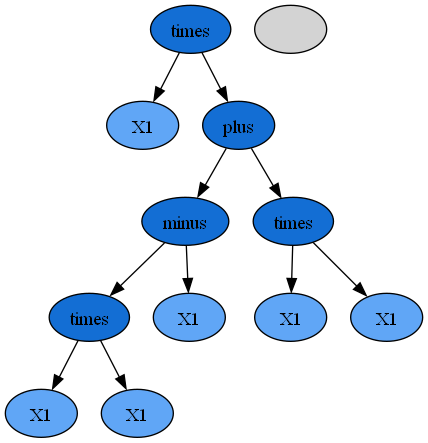

(plus (times (times (divide (times 5.871826281593834 X1) 2.887053690518461) X1) X1) (divide (times (divide (plus (minus 3.8112064752566868 X1) (times X1 X1)) (times (minus 8.932330528262861 X1) 4.397889559161249)) 2.2286427560915056) (plus (minus (plus 7.357384814455891 (divide 9.400351693676456 8.33978284254918)) 9.259454514572049) (divide (divide (minus 1.563783295754968 X1) (plus X1 X1)) (plus 4.843358309975273 X1)))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01593
MSE         : 76.31377
DEPTH       : 7.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(13.862393896521147*X1**5 - 47.738307825643828*X1**4 - 689.14813002358783*X1**3 + 142.07166747440828*X1**2 - 4.600595419264268*X1 + 82.277205110963201)/(6.8158480069183238*X1**3 - 23.471923585198605*X1**2 - 341.03121902008837*X1 + 61.430729676441074)
*****************

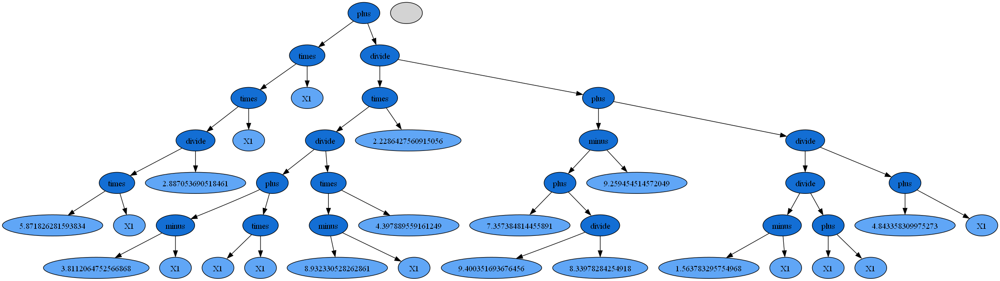

(minus (plus (plus (times 5.469877112316613 X1) (plus X1 X1)) (times X1 9.638521284944058)) (minus (plus X1 2.3678285495786087) (times X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00640
MSE         : 482.36077
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**3 + 16.10839839726067*X1 - 2.3678285495786087
*******************************************************************
 
                             TREE


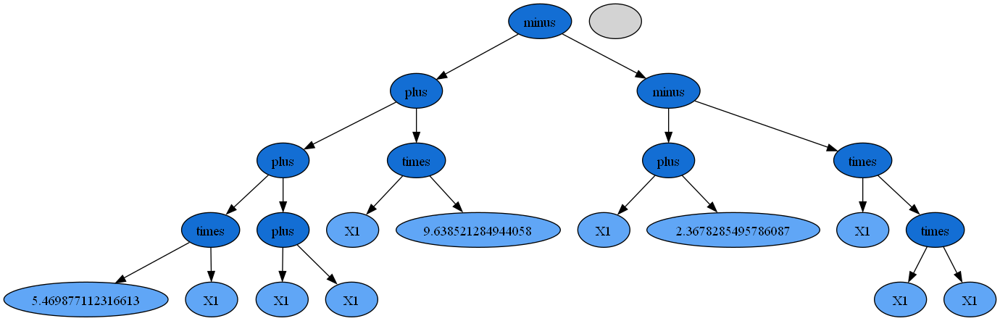

(plus (times 3.6926479587188954 (times 0.5971982031762391 (times (divide X1 2.452040953096283) (times 2.1092368212943646 (minus (minus (times X1 X1) (divide X1 2.452040953096283)) (divide (divide X1 (times 2.1092368212943646 (plus (times X1 X1) 1.9755838365543854))) (plus (divide X1 2.452040953096283) 2.1092368212943646))))))) (divide (divide X1 (minus (divide X1 2.452040953096283) (times 2.1092368212943646 (minus (times (divide (divide X1 7.701245213663364) (times 0.10438296720176266 (plus 6.618089481981546 8.616044285714054))) (divide (divide X1 5.686388992600856) (divide X1 2.452040953096283))) (divide X1 2.452040953096283))))) (divide 2.452040953096283 7.701245213663364)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.05704
MSE         : 5.46575
DEPTH       : 12.00000
*******************************************************************
 
                        REDUCED TREE
             (1.63174258

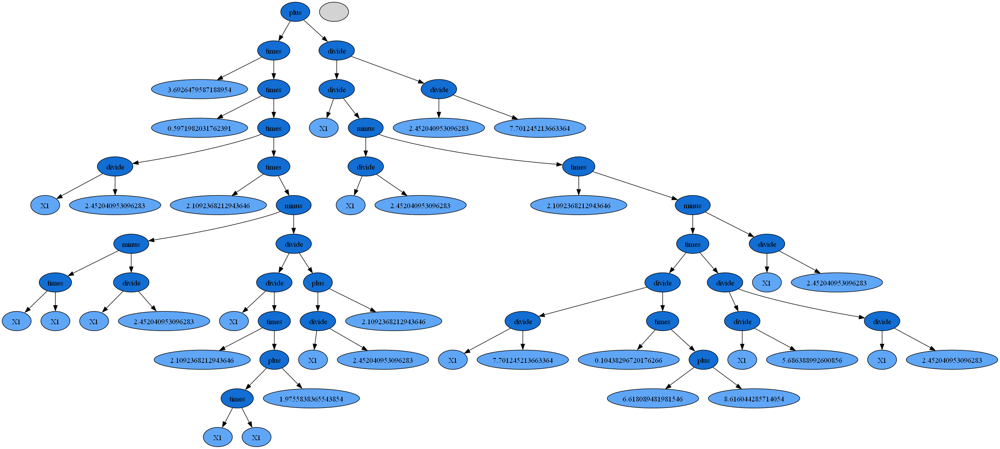

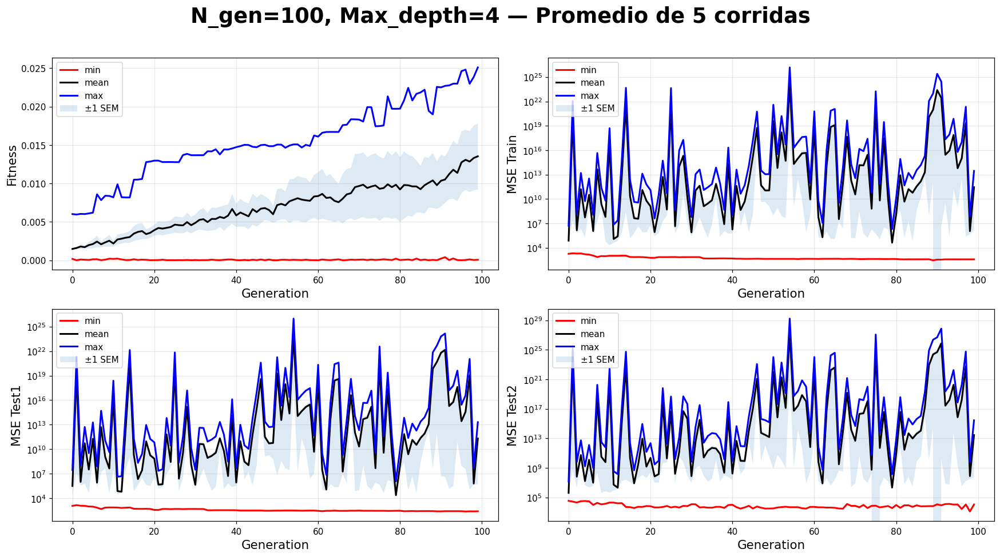

In [54]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 15 

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 100/100 [00:04<00:00, 24.28it/s]


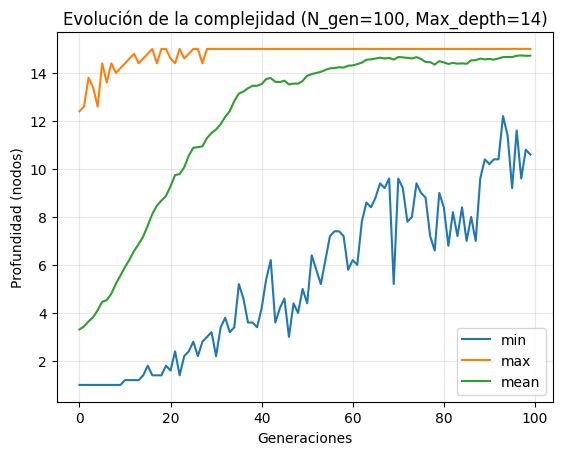

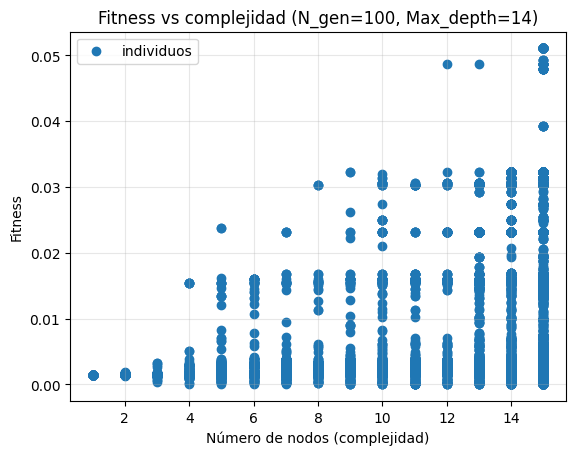

In [55]:
n_gen=100
max_depth=14
prob_mutation=0.10
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (plus (plus (times (minus (plus (times X1 (times X1 (plus (plus (times 8.639589821196624 X1) (plus (divide (times X1 (times X1 X1)) (times X1 X1)) (times X1 X1))) X1))) 5.19194330159248) (plus (plus (plus (minus X1 X1) (divide X1 9.43546448828361)) (times X1 X1)) (times X1 X1))) (minus X1 X1)) (divide (minus (plus (times X1 (minus X1 X1)) (minus 6.2169877540987635 X1)) (times X1 (times (divide X1 (divide X1 1.5251666484000093)) X1))) 2.0941221980709193)) (times X1 (times X1 X1))) (times X1 (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.05105
MSE         : 6.91066
DEPTH       : 15.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - 0.7283083335848189*X1**2 - 0.4775270521086058*X1 + 2.9687798352100844
*******************************************************************
 
                             T

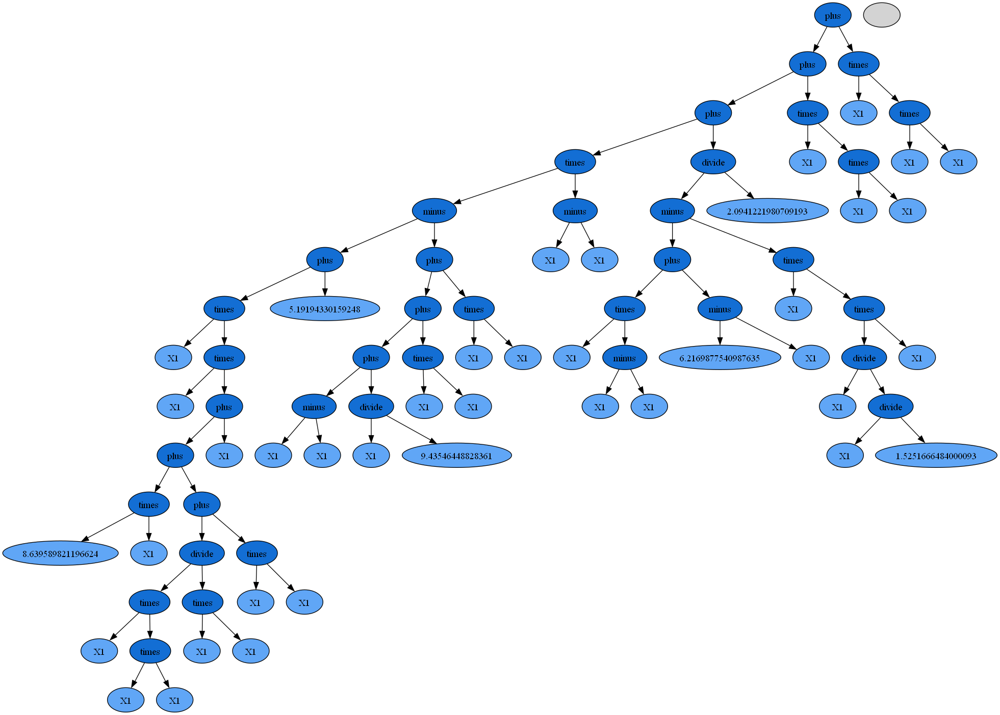

(plus (times X1 (times X1 X1)) (plus (divide (plus (plus X1 (plus (plus (times (minus X1 (times (divide (times X1 (times X1 X1)) X1) (times X1 9.831428980512682))) 0.6248868824036791) (minus (plus (minus X1 (times (divide (times X1 X1) X1) (times X1 9.831428980512682))) 7.66687640499967) (divide X1 (times X1 9.831428980512682)))) (divide X1 (times X1 9.831428980512682)))) (divide (divide X1 1.34607044933297) X1)) (minus (times X1 9.831428980512682) (divide (times 8.331156924469553 X1) (plus (plus X1 (times (times X1 (times X1 X1)) (times 8.331156924469553 X1))) (times X1 X1))))) (times X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03902
MSE         : 12.13292
DEPTH       : 14.00000
*******************************************************************
 
                        REDUCED TREE
             (163.8143552568577*X1**7 - 51.18272087471329*X1**6 - 62.2443196674035*X1**5 + 35.38

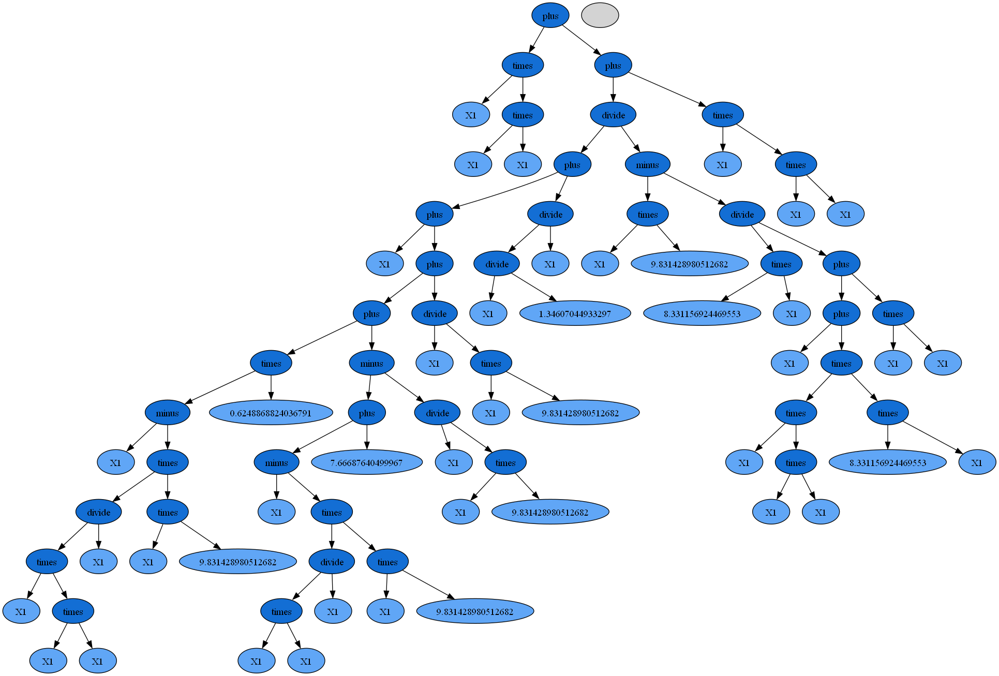

(plus (plus (plus (divide (minus (plus (plus (times X1 (minus (minus X1 (plus (divide X1 (divide (times X1 8.842613836989544) (plus 4.256179630249153 4.159096004004925))) 0.7948812451501164)) (plus (minus 9.517168852409938 X1) (times X1 8.74160355145417)))) (plus X1 (plus (times X1 8.842613836989544) (plus (minus 9.305431438612125 (plus 4.242591623380192 (times X1 1.0811305154308504))) (plus (times (times X1 X1) (times X1 8.64204173459161)) (times 6.548146600319907 X1)))))) (times 4.355393185444157 7.555185960886817)) 8.64204173459161) 9.971220380436819) (divide (minus (plus (plus (times X1 (minus (plus X1 X1) (times 6.548146600319907 X1))) (plus X1 (plus (minus X1 5.022399923945681) (plus X1 (plus (times (times X1 X1) (plus (times X1 8.64204173459161) X1)) (times X1 X1)))))) (plus (minus (divide 3.1323963165530078 X1) (divide (times X1 8.842613836989544) (times 4.355393185444157 7.555185960886817))) (divide (divide (plus 7.1699903758889985 X1) (times 8.332605366743412 X1)) (minus (tim

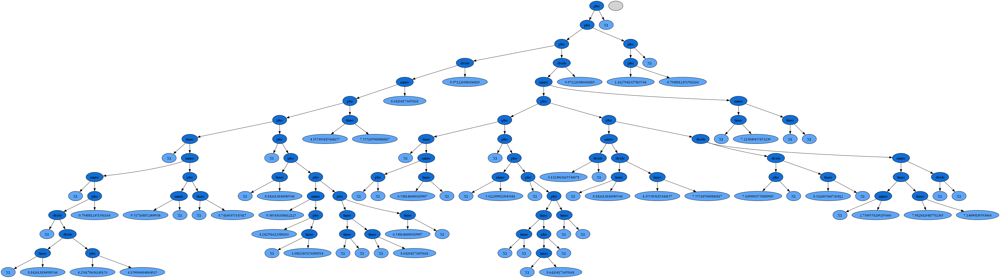

(plus (times (times X1 X1) (plus X1 X1)) (minus (divide (divide X1 (plus (minus X1 (divide (times (times (divide (plus X1 X1) (divide 0.20159576261356227 3.3455850791894557)) X1) X1) (times (times 3.3429242516308753 (times X1 7.072556453309043)) (divide 0.37787694051590104 X1)))) 0.45310013682268724)) X1) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01628
MSE         : 73.00550
DEPTH       : 12.00000
*******************************************************************
 
                        REDUCED TREE
             (X1*(2*X1**2 - 1)*(-3.7150727774040568*X1**3 + X1 + 0.45310013682268724) + 1)/(-3.7150727774040568*X1**3 + X1 + 0.45310013682268724)
*******************************************************************
 
                             TREE


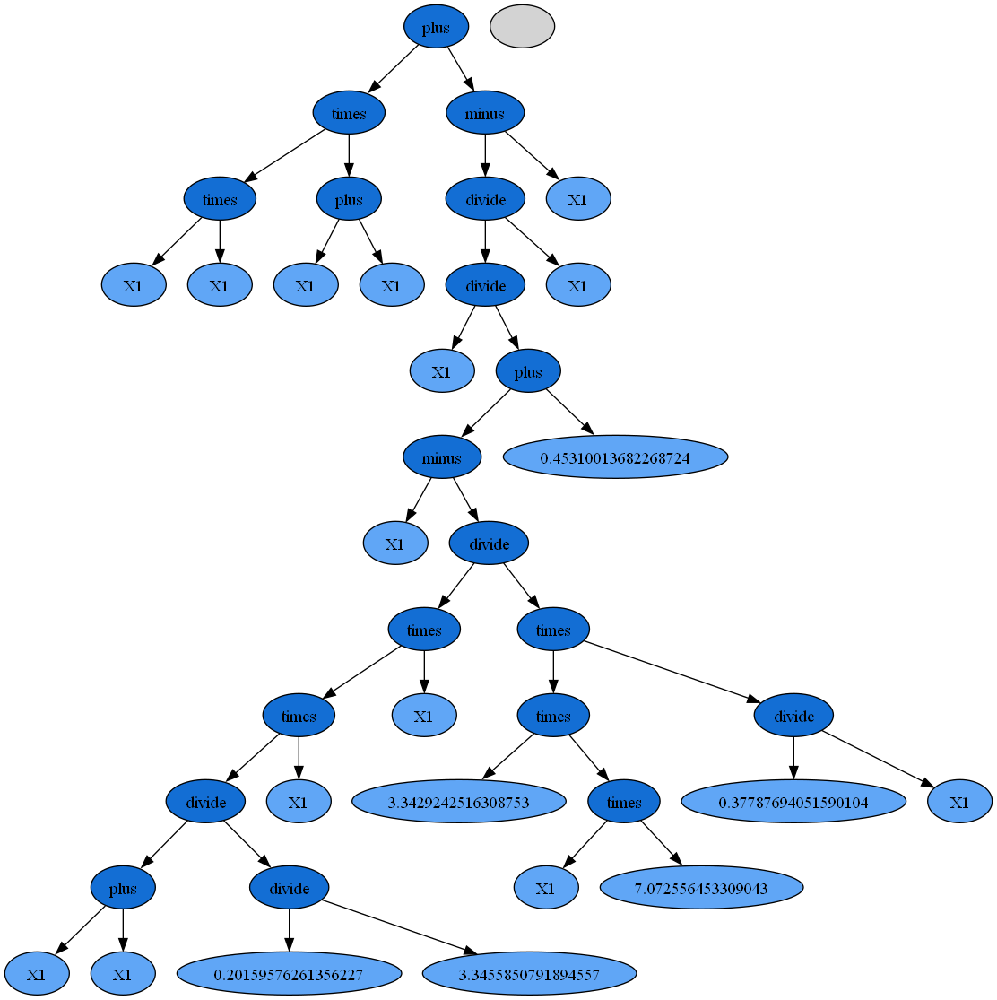

(plus (plus X1 (plus (minus (divide (times (times X1 X1) (times X1 5.453504558837231)) 5.453504558837231) (plus (plus (divide (times 1.609555958365274 (times (times X1 7.83722725315643) 4.066595770755457)) (plus (times (times 9.991560053088996 (times X1 X1)) (times (times X1 7.83722725315643) 4.066595770755457)) (minus (times (times 1.609555958365274 (plus 5.365138697186467 (times (times X1 X1) X1))) (times (times X1 7.83722725315643) 4.066595770755457)) (plus 1.609555958365274 (times X1 5.453504558837231))))) X1) X1)) 6.069640279422962)) (minus (divide (times (times X1 X1) (times X1 5.453504558837231)) 5.453504558837231) (plus (divide X1 (plus (minus (minus (times (times 1.609555958365274 (plus 5.365138697186467 (times (divide (times X1 4.066595770755457) (times 5.453504558837231 X1)) X1))) (times (plus 5.365138697186467 (times (times 6.942424211425484 X1) X1)) X1)) (minus (times (plus (plus (plus 5.974059902891301 X1) (plus X1 X1)) (minus (times X1 X1) X1)) 0.7148876872836152) (times

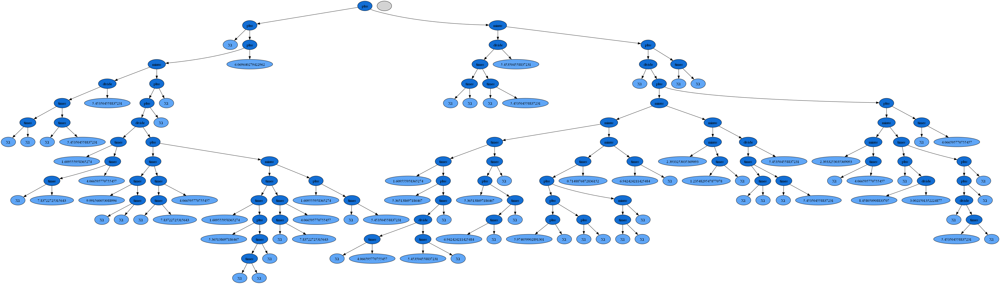

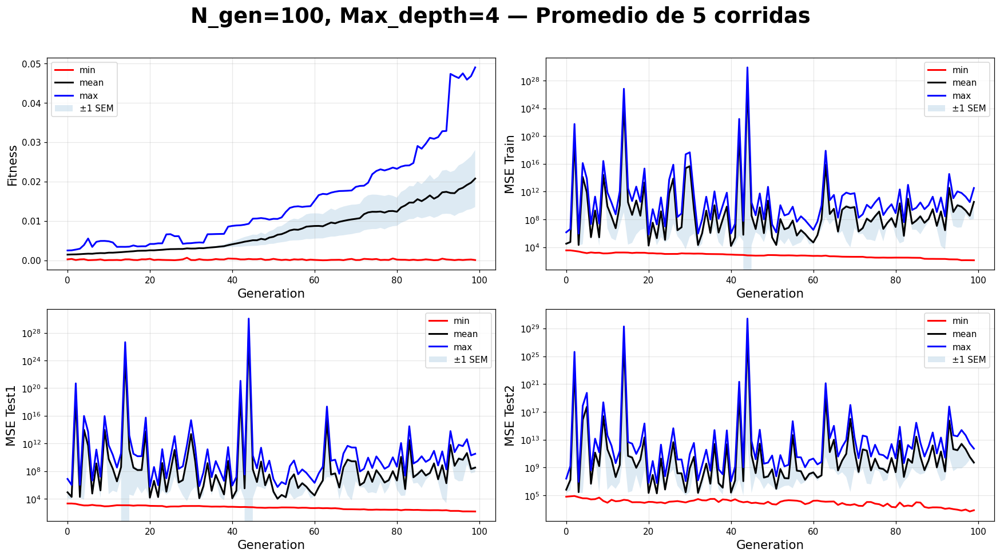

In [56]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 16 

- Numero de generaciones = 100
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:03<00:00, 25.03it/s]


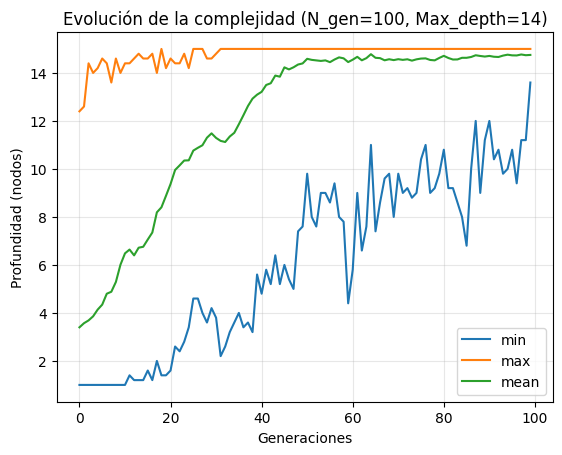

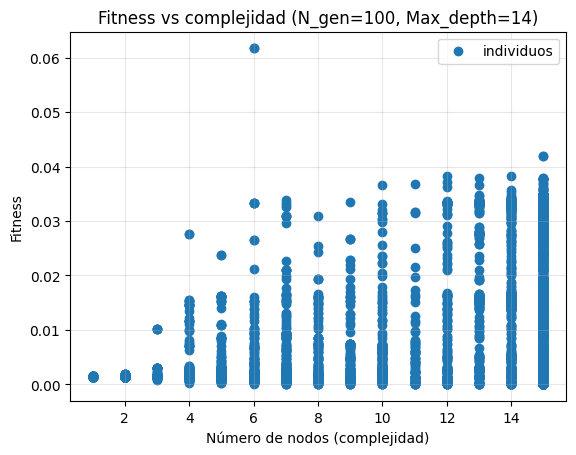

In [57]:
n_gen=100
max_depth=14
prob_mutation=0.10
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times (minus (plus (times X1 X1) (times X1 X1)) (minus (plus 0.5765979761307594 X1) (divide 6.4949131740111055 (plus X1 X1)))) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.06169
MSE         : 4.62629
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2*X1**2 - X1 - 0.5765979761307594) + 3.2474565870055528
*******************************************************************
 
                             TREE


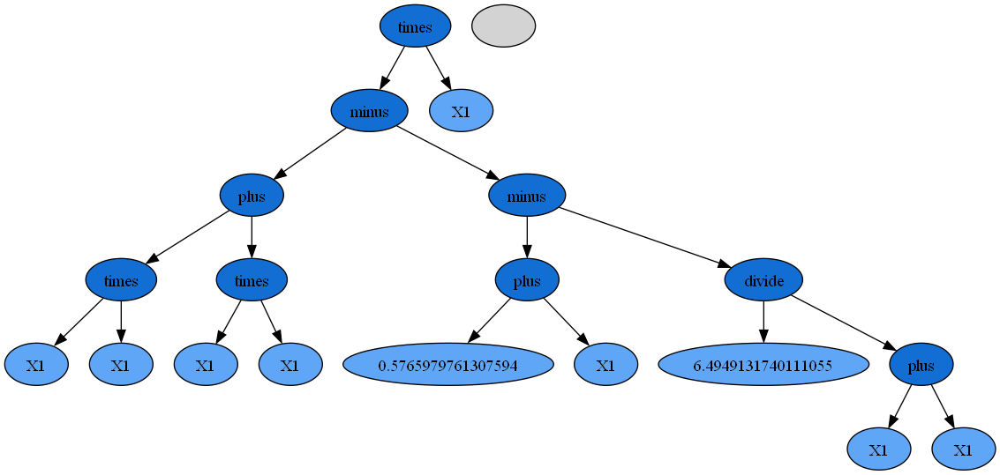

(plus (minus (divide (plus 8.729666782184356 (plus (minus (divide (minus (plus X1 0.6128977396212398) (divide X1 (minus (plus X1 (times 8.729666782184356 X1)) (plus X1 9.463574699544568)))) 8.128703784648877) (plus (times X1 0.8989275685877374) (plus X1 (minus (plus X1 (times (plus (divide 3.71017357917635 5.607633180971399) 3.7467001412191903) X1)) (plus (divide 3.71017357917635 5.607633180971399) 0.6128977396212398))))) (minus (times (plus (divide 3.71017357917635 5.607633180971399) 3.7467001412191903) X1) (plus (plus X1 0.0072317865339643905) (minus (minus (divide (times (plus (times X1 0.8989275685877374) 0.6128977396212398) (plus X1 0.0072317865339643905)) 8.128703784648877) (plus 9.463574699544568 4.9867198335495875)) (divide 3.71017357917635 5.607633180971399)))))) 8.128703784648877) X1) (minus (plus 8.729666782184356 (minus (plus 8.729666782184356 (plus X1 (minus (plus X1 (times (plus (divide 3.71017357917635 5.607633180971399) 3.7467001412191903) X1)) (plus (times X1 0.8989275

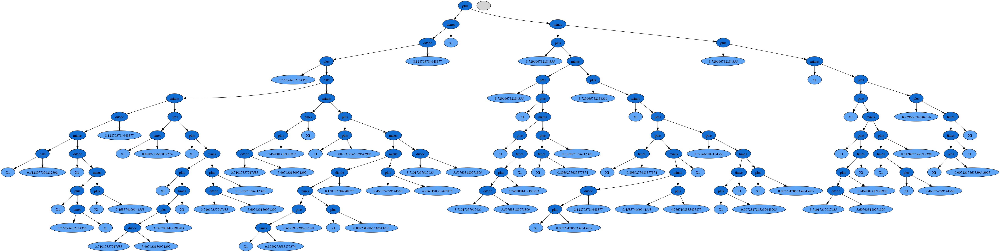

(times (times (minus X1 (divide (minus X1 (divide (plus (divide (plus (divide (times (divide X1 (times X1 X1)) X1) X1) (divide X1 2.994341621996559)) (plus (plus 2.117534985954439 X1) X1)) (plus (divide (plus (divide (minus 3.6162986933764776 X1) X1) (divide X1 2.994341621996559)) 2.994341621996559) 8.400692552188051)) (plus X1 X1))) (times (times (divide X1 (times X1 X1)) X1) (plus (times 1.5400421772694717 X1) (minus X1 (divide (plus (times X1 (plus (plus 2.117534985954439 X1) (plus (minus X1 X1) (plus 2.117534985954439 X1)))) (plus (times 1.5400421772694717 X1) (minus X1 3.4745943449676133))) (plus (plus (divide X1 2.994341621996559) (times 0.46578512200772804 3.4559961674145767)) (plus (times 1.5400421772694717 X1) (plus (times 1.5400421772694717 X1) (plus 2.117534985954439 X1)))))))))) X1) (plus X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.04624
MSE         : 8.50936
DEPTH       : 14.000

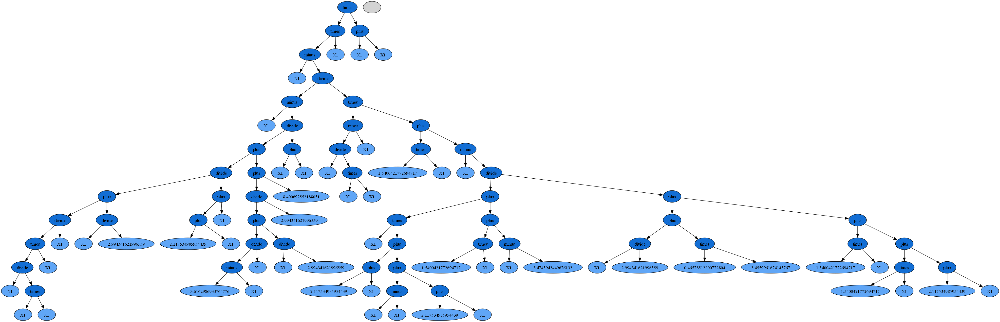

(times (minus (times 6.021888640310976 X1) (divide (times X1 (divide (plus X1 (times (times 4.551125684798532 X1) (minus (plus (plus X1 4.4053839412999585) (divide X1 X1)) (times 6.021888640310976 X1)))) 8.200303291231156)) (times (plus 8.7326235004385 X1) (times X1 (divide 4.482568816277379 X1))))) 4.551125684798532)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00422
MSE         : 1112.42509
DEPTH       : 11.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(12.684542891300829*X1**2 + 108.64275905711493*X1 + 1072.8110822978767)/(4.482568816277379*X1 + 39.144585787356628)
*******************************************************************
 
                             TREE


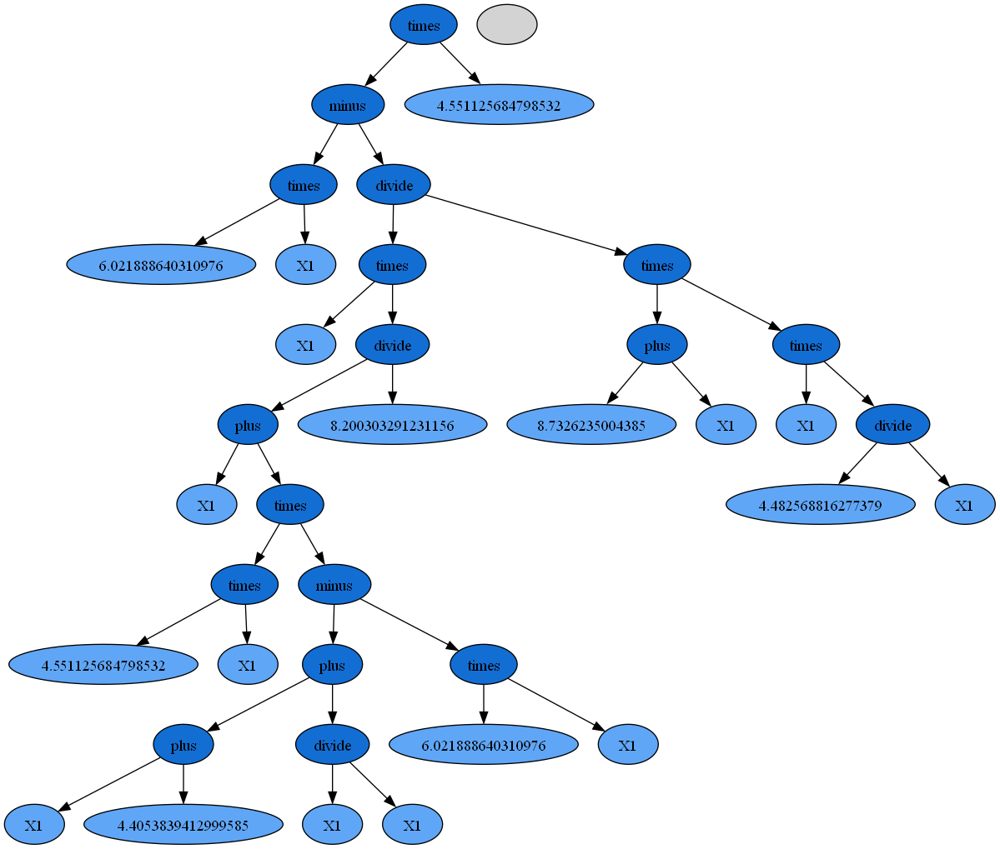

(minus (plus (times (plus (divide (times X1 (times 1.513931093350911 X1)) 1.8156931469267068) (plus (times (plus (divide (divide (times X1 X1) 8.615986591242823) X1) X1) X1) (divide 2.3829325795762335 (plus (divide (divide (plus X1 (plus (minus 4.623167643287339 (minus 2.9047373928819766 X1)) X1)) 8.615986591242823) X1) X1)))) X1) (plus (divide (divide X1 (times X1 X1)) (plus (times (divide (times (times X1 3.216064422353735) (divide (times (minus 2.7867186721177104 X1) 8.637607180516483) X1)) (plus (times X1 X1) (divide 2.3829325795762335 (plus (divide (times X1 X1) X1) X1)))) (minus 6.866803089062838 (times (plus (times 9.50174440360833 (times X1 X1)) X1) (times 1.513931093350911 X1)))) X1)) 2.693285006276638)) (times X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.11691
MSE         : 1.14105
DEPTH       : 14.00000
*******************************************************************
 
         

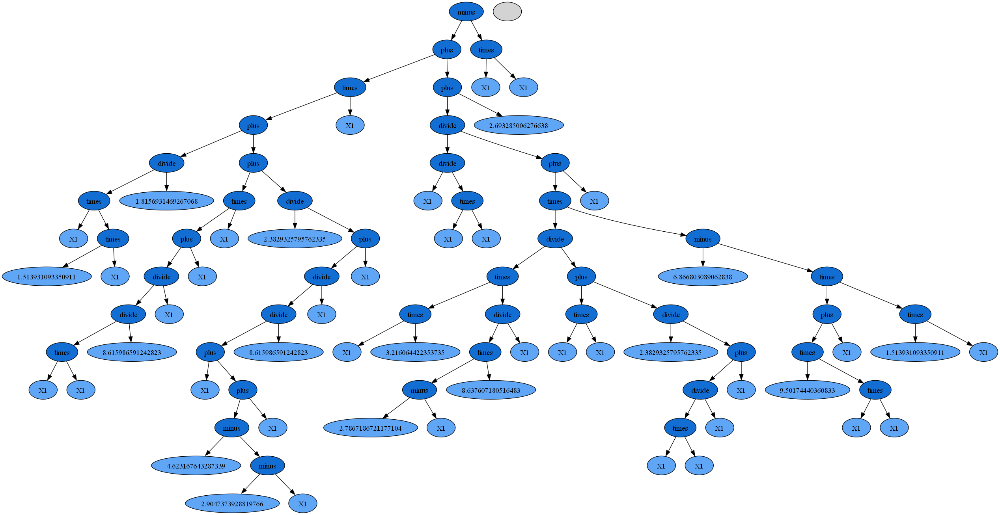

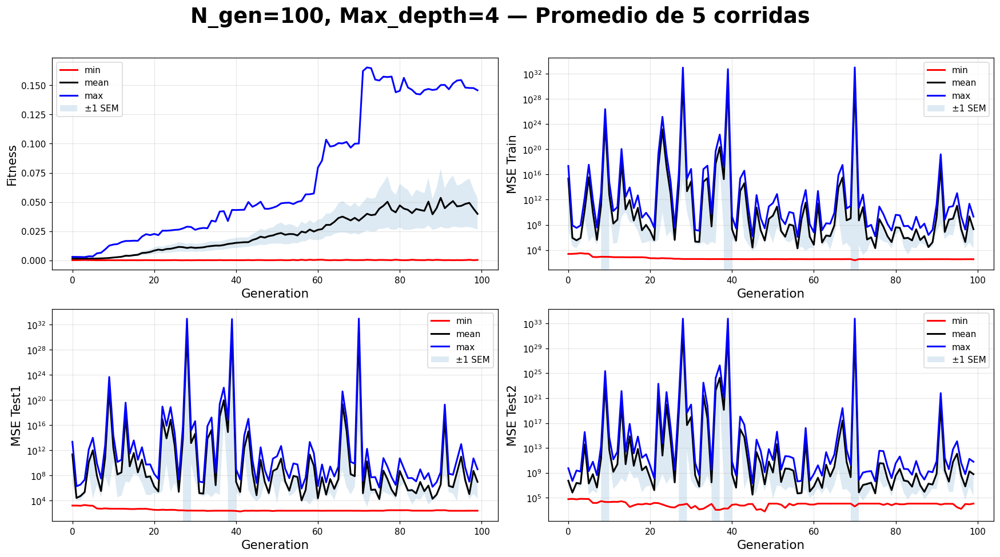

In [58]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

# Casos

## Caso 17 

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method = Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 34.32it/s]


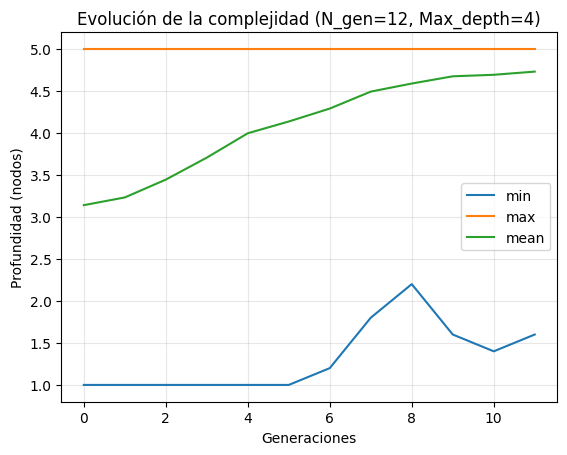

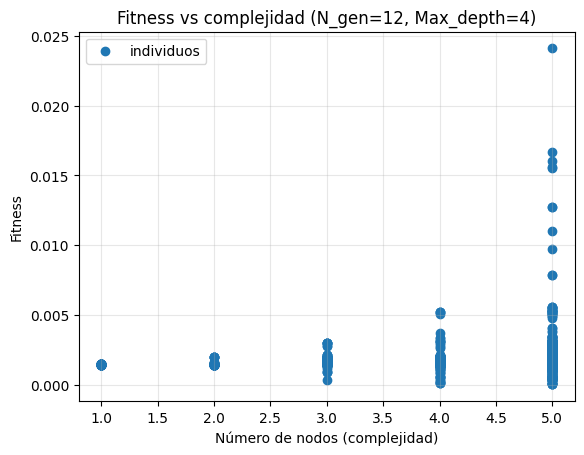

In [59]:
n_gen=12
max_depth=4
prob_mutation=0.15
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (plus (divide (minus X1 4.721947992838269) (times X1 9.896968491284131)) (times (times X1 X1) (plus X1 X1))) (times X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02410
MSE         : 32.78915
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 + 0.1010410410905784 - 0.4771105411719459/X1
*******************************************************************
 
                             TREE


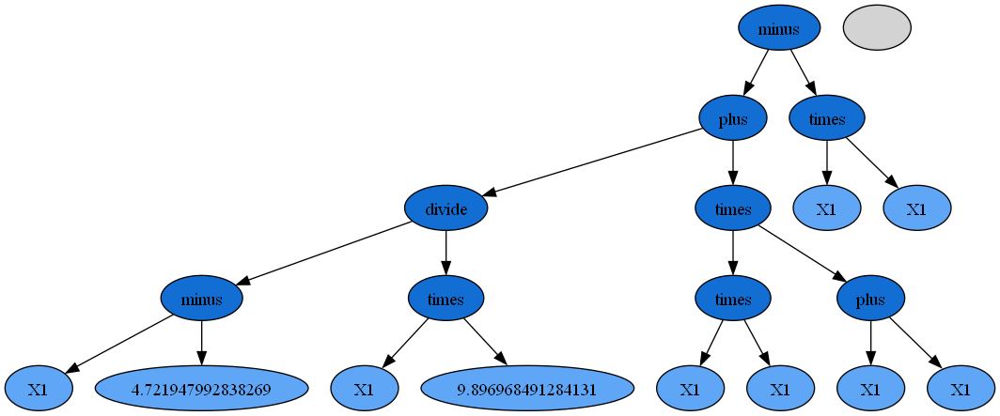

(minus (plus (times (plus X1 X1) (times X1 X1)) (plus (times X1 X1) (divide 3.207333882558724 9.35982662767754))) (plus (times X1 X1) (plus (divide 0.8934709272638741 X1) (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02427
MSE         : 32.32999
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 + 0.3426702235140184 - 0.8934709272638741/X1
*******************************************************************
 
                             TREE


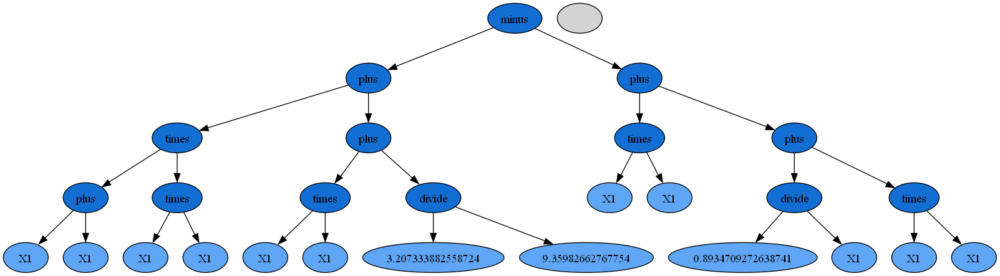

(plus (minus (times 7.555089947777592 (minus X1 X1)) (plus (minus 2.149435196481262 X1) X1)) (plus (times (times X1 X1) X1) (times (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01649
MSE         : 71.10716
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - 2.149435196481262
*******************************************************************
 
                             TREE


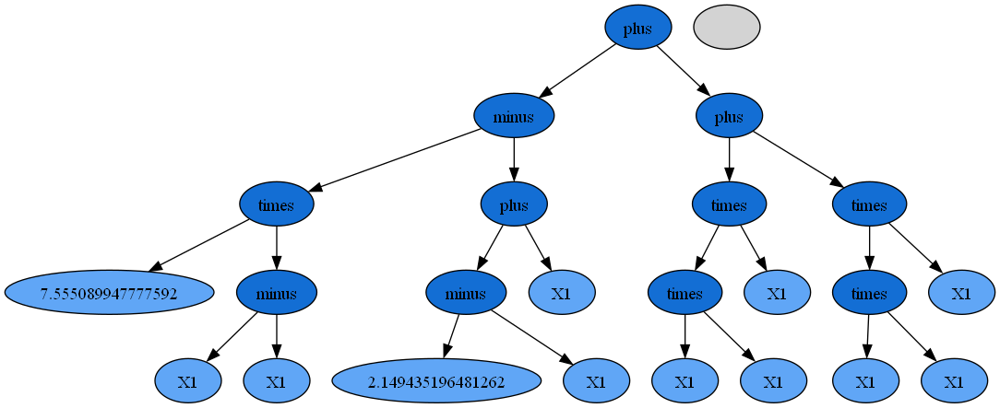

(plus (plus (plus (times 8.676444545267586 X1) X1) (plus (times 6.4754421234116855 X1) (times X1 4.1266100941897665))) (plus (plus X1 (times 4.855003717660961 X1)) (times X1 4.1266100941897665)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00344
MSE         : 1677.28078
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             30.260110574719765*X1
*******************************************************************
 
                             TREE


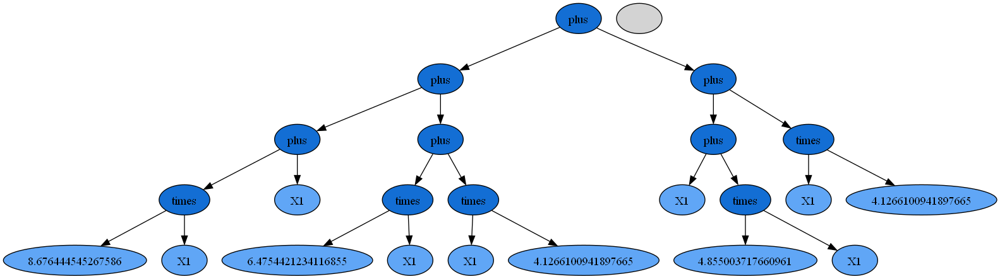

(plus (times (plus (times X1 X1) (times X1 X1)) (divide (times 1.5489056501301646 X1) (minus 4.738190048336448 1.6238592419467857))) (minus (times (times X1 X1) X1) (minus X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01548
MSE         : 80.91377
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.9946956482286853*X1**3
*******************************************************************
 
                             TREE


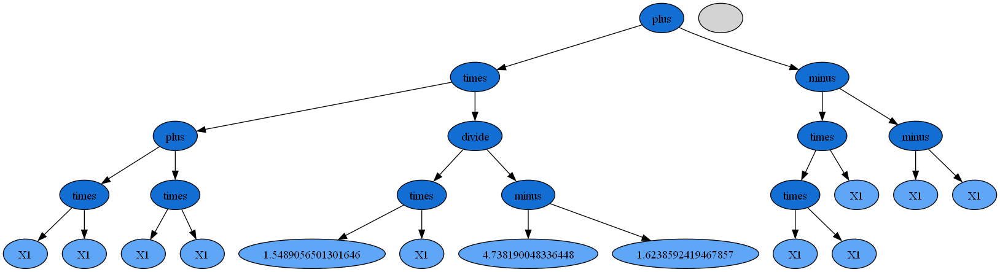

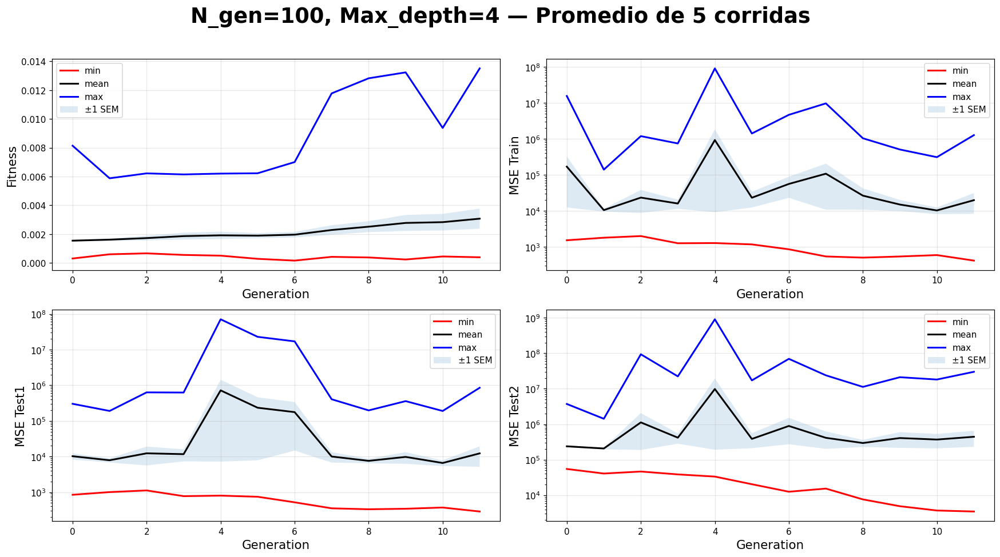

In [60]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 18

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 12/12 [00:00<00:00, 35.78it/s]


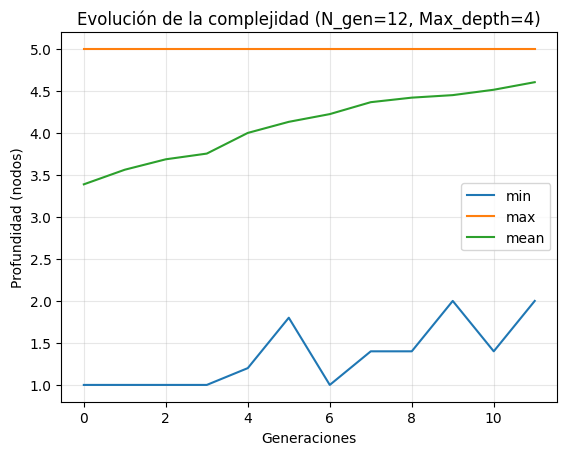

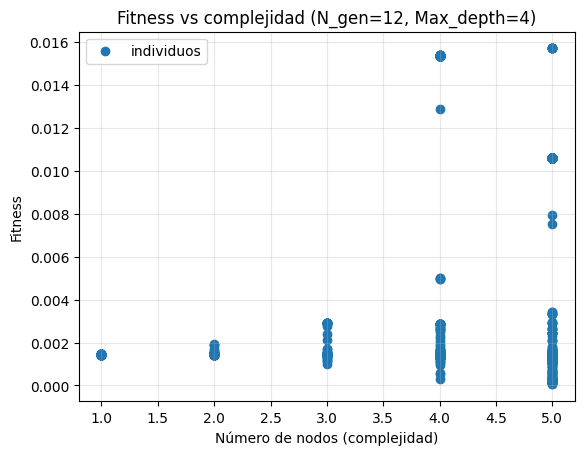

In [61]:
n_gen=12
max_depth=4
prob_mutation=0.15
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times (minus (times (plus X1 X1) X1) 1.749949768114254) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01571
MSE         : 78.48356
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2*X1**2 - 1.749949768114254)
*******************************************************************
 
                             TREE


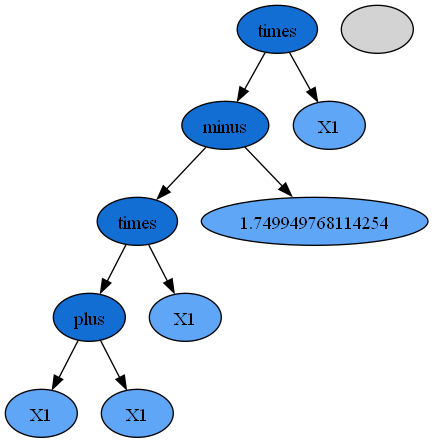

(times (plus X1 (minus X1 0.35233334825438223)) (times X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02359
MSE         : 34.26969
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2*X1 - 0.35233334825438223)
*******************************************************************
 
                             TREE


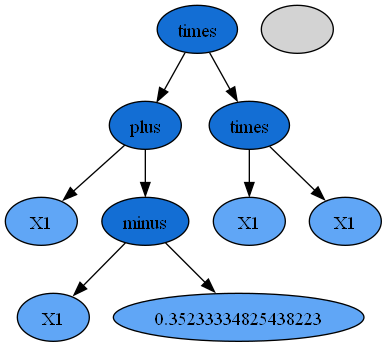

(plus (plus (minus (plus X1 7.455955649395172) (minus 5.881303739396592 X1)) (plus (times X1 2.9629268333391856) (plus X1 5.110679409851508))) (times (times X1 X1) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00404
MSE         : 1215.94782
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**3 + 5.9629268333391856*X1 + 6.685331319850088
*******************************************************************
 
                             TREE


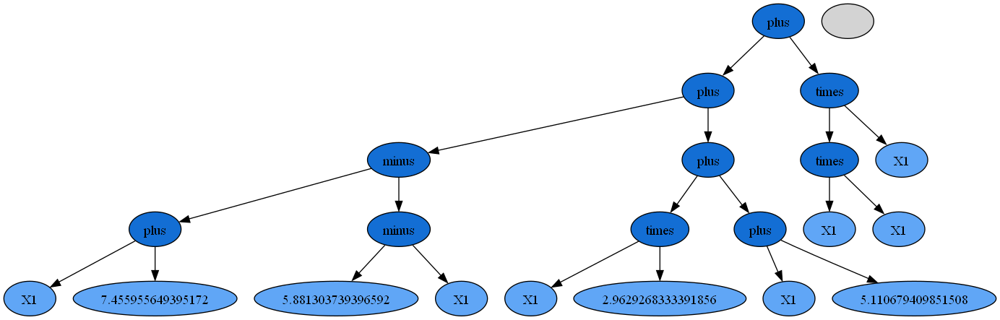

(minus (times (divide (divide X1 4.828869682876695) (divide 0.9678691702971398 9.065631165135432)) (plus (times X1 X1) (divide X1 4.828869682876695))) (plus (plus (times X1 X1) (divide 0.9678691702971398 9.065631165135432)) (divide X1 4.828869682876695)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03645
MSE         : 13.97962
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.939705977706697*X1**3 - 0.5983105560738265*X1**2 - 0.2070878001835559*X1 - 0.1067624694482793
*******************************************************************
 
                             TREE


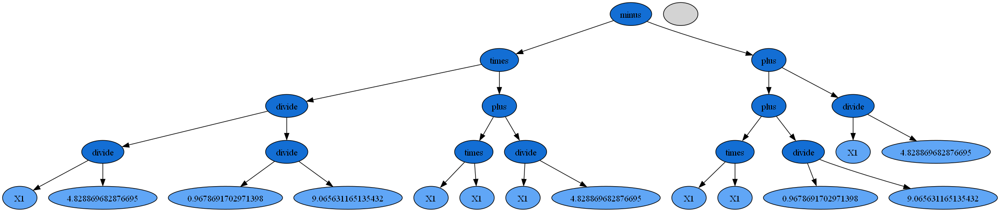

(plus (plus (times (plus X1 X1) (times X1 X1)) 2.040506526901553) (minus (plus 1.6258350944230948 1.6258350944230948) (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.04561
MSE         : 8.75884
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 + 5.2921767157477426
*******************************************************************
 
                             TREE


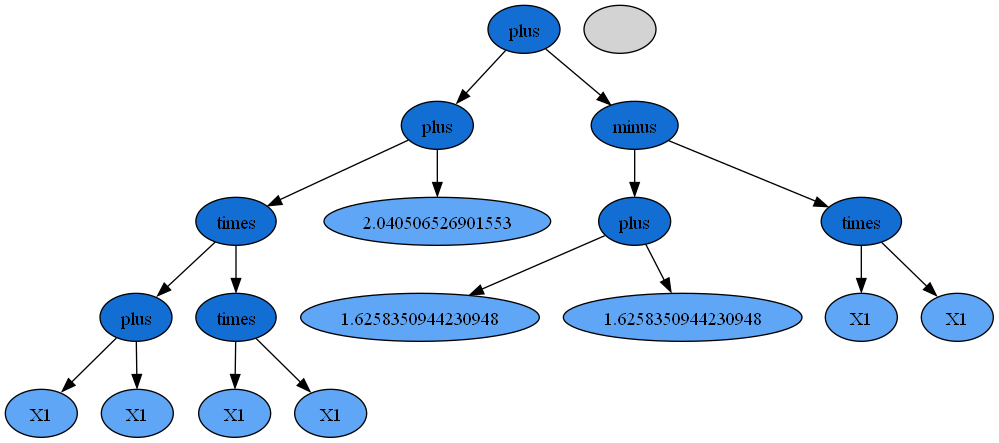

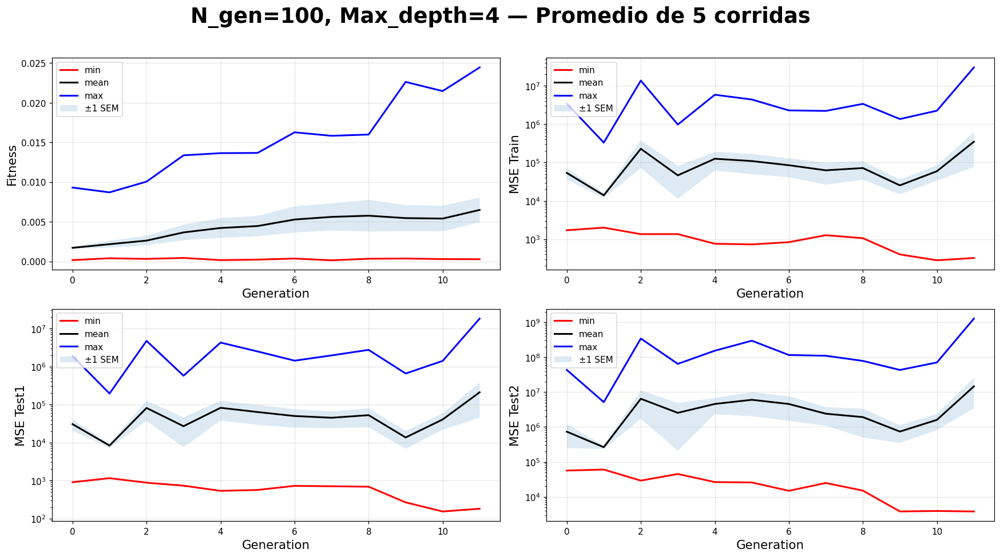

In [62]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 19 

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 33.21it/s]


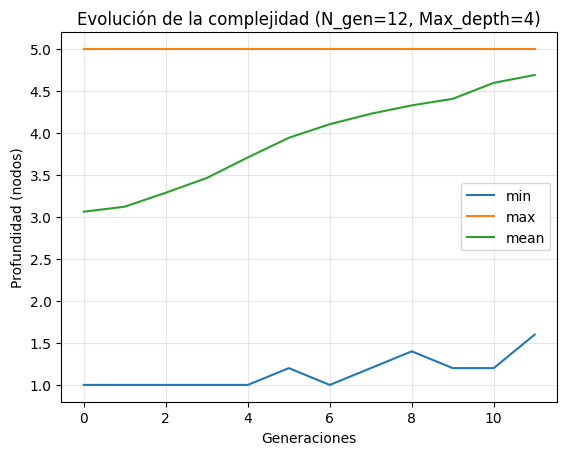

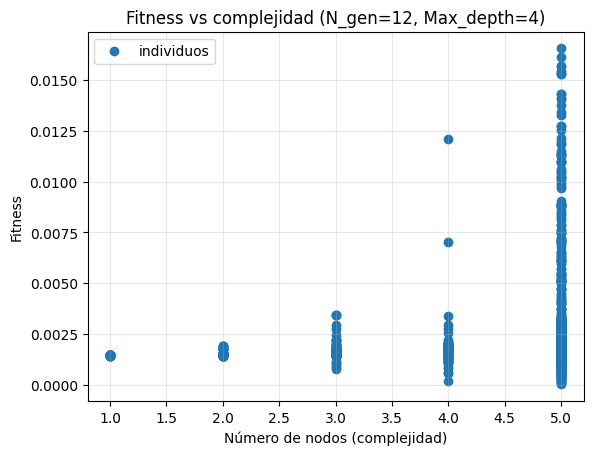

In [63]:
n_gen=12
max_depth=4
prob_mutation=0.15
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (plus (divide (plus X1 X1) (plus 5.676764114865768 X1)) (times (plus X1 X1) (times X1 X1))) (minus X1 (times X1 0.87222750190456)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01656
MSE         : 70.50966
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*((X1 + 5.676764114865768)*(2*X1**2 - 0.12777249809544) + 2)/(X1 + 5.676764114865768)
*******************************************************************
 
                             TREE


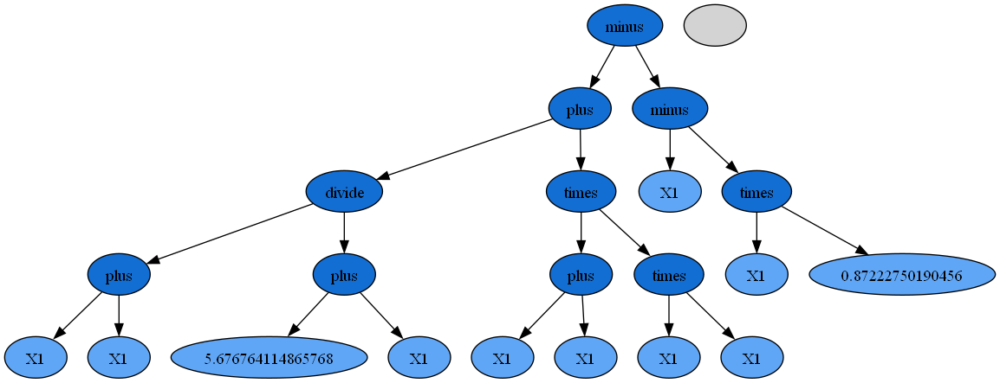

(divide (times (plus (divide X1 0.3060533863214465) (times X1 5.690659487600672)) (divide (plus 7.42939930095596 X1) (plus 5.9147555279617405 X1))) 0.5154323611424649)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00396
MSE         : 1266.82324
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             17.37970676892101*X1*(X1 + 7.42939930095596)/(X1 + 5.9147555279617405)
*******************************************************************
 
                             TREE


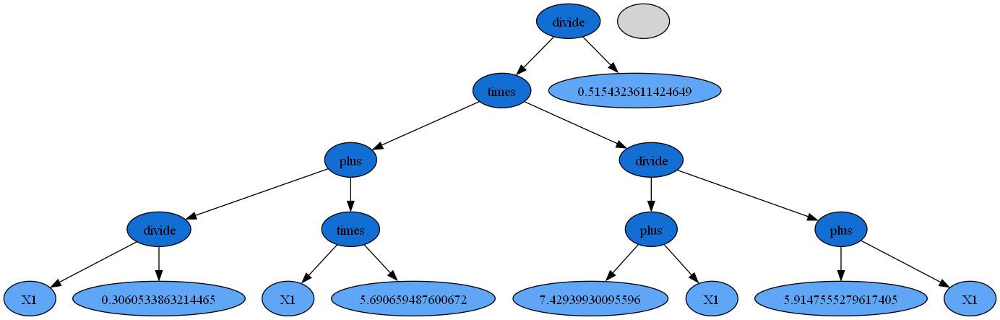

(times (times 4.362322322053785 X1) 6.9177398994038075)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00344
MSE         : 1677.26509
DEPTH       : 3.00000
*******************************************************************
 
                        REDUCED TREE
             30.177411181331335*X1
*******************************************************************
 
                             TREE


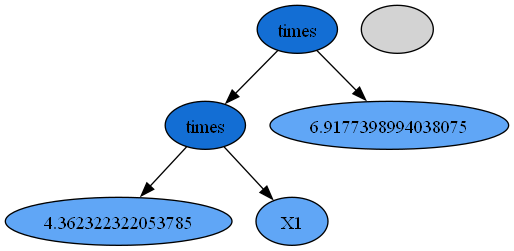

(minus (times (times X1 7.333098737759954) (minus 8.955375798287706 3.822181074812124)) (minus 0.2665077479179978 (minus (divide X1 4.193351467438266) (times 7.425850069171066 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00344
MSE         : 1675.89931
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             30.45484641483198*X1 - 0.2665077479179978
*******************************************************************
 
                             TREE


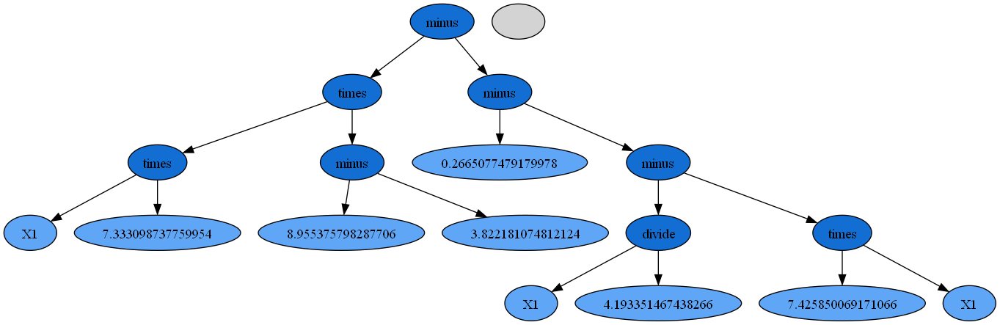

(plus (plus (plus (plus 3.1476309409131433 X1) (minus 5.974391065185576 3.9864307995091486)) (times X1 (times X1 X1))) (minus (times (times X1 X1) X1) 9.984417478586924))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01421
MSE         : 96.18635
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 + X1 - 4.8488262719973532
*******************************************************************
 
                             TREE


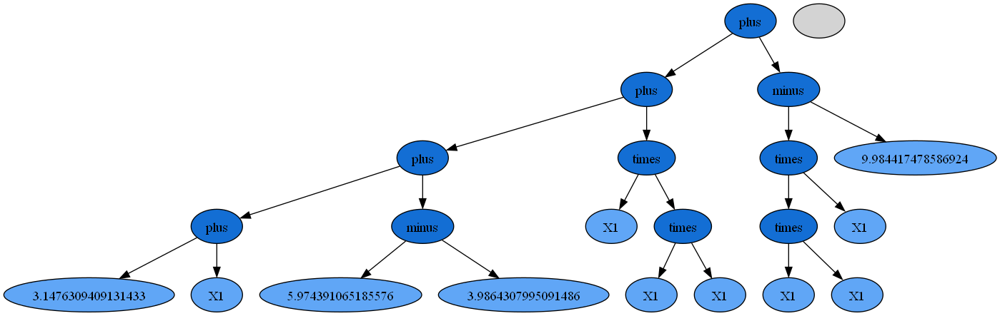

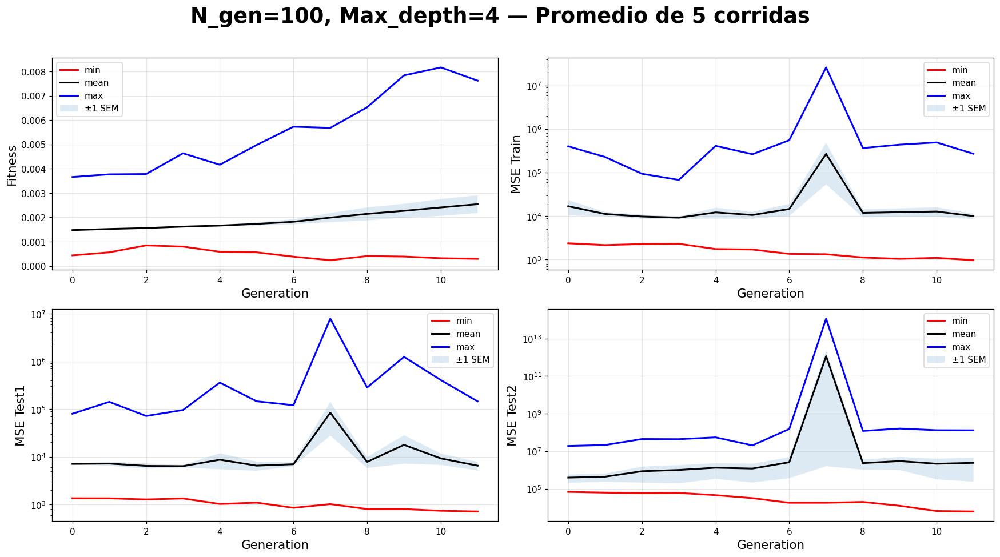

In [64]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 20 

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 12/12 [00:00<00:00, 31.46it/s]


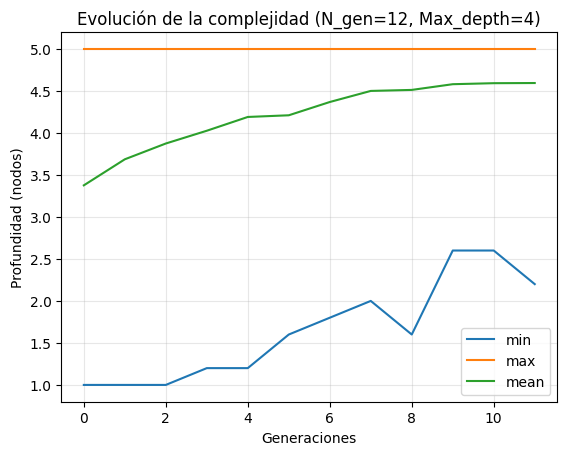

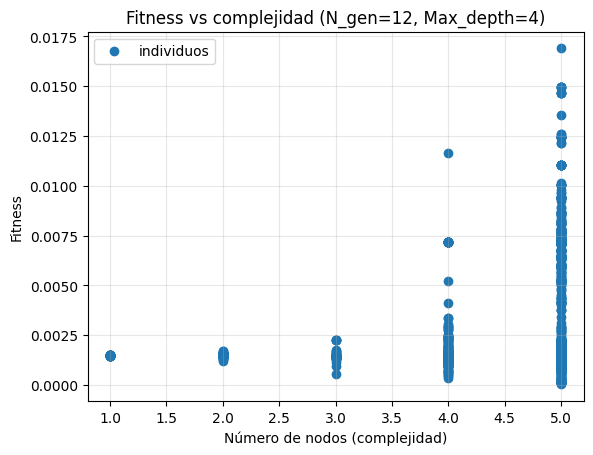

In [65]:
n_gen=12
max_depth=4
prob_mutation=0.15
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (divide (times X1 X1) (divide 1.9171404356012267 (times X1 3.1994353210054904))) (divide (times X1 (plus X1 X1)) (plus 5.566361914822129 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01690
MSE         : 67.67675
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(X1*(1.6688580875934258*X1 + 9.2894681000229378) - 2)/(X1 + 5.566361914822129)
*******************************************************************
 
                             TREE


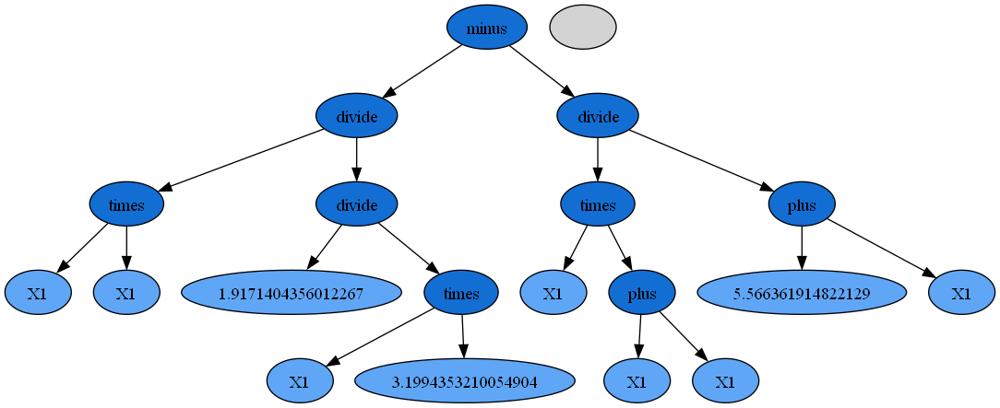

(plus (times X1 (plus (times X1 X1) (times X1 X1))) (minus X1 (times X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01798
MSE         : 59.69388
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2*X1**2 - X1 + 1)
*******************************************************************
 
                             TREE


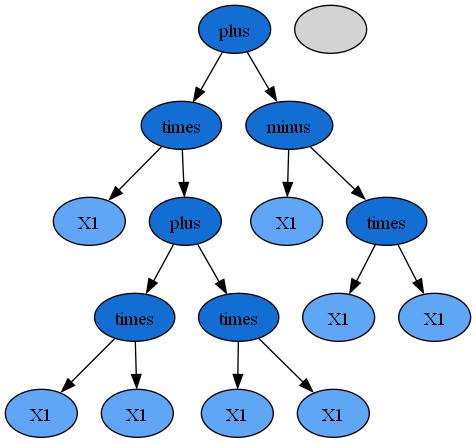

(plus (minus (divide (times 6.50697155240903 X1) X1) (plus (times X1 X1) X1)) (minus (times (times X1 X1) (times 2.004658435310065 X1)) 1.0724671533490449))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.22282
MSE         : 0.24332
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2.004658435310065*X1**3 - X1**2 - X1 + 5.4345043990599848
*******************************************************************
 
                             TREE


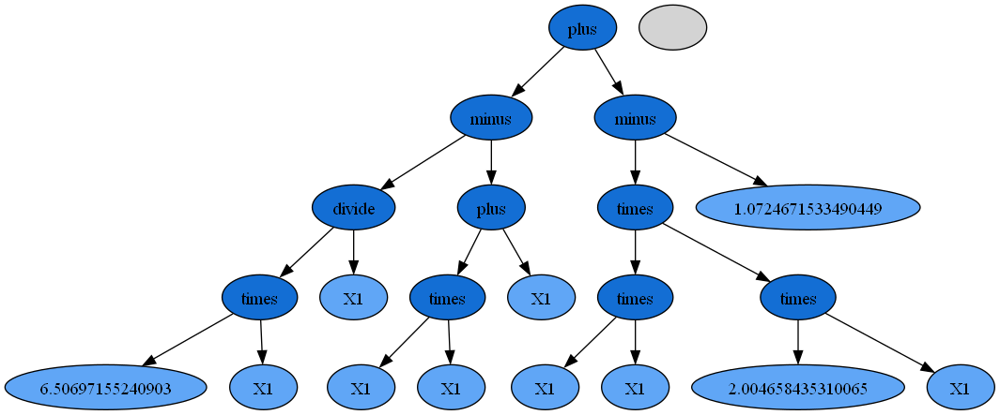

(times (times X1 (plus (divide 3.6967698105990934 X1) X1)) (plus (minus 5.230980811526086 6.153236868845578) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00365
MSE         : 1492.95374
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             (X1 - 0.922256057319492)*(X1**2 + 3.6967698105990934)
*******************************************************************
 
                             TREE


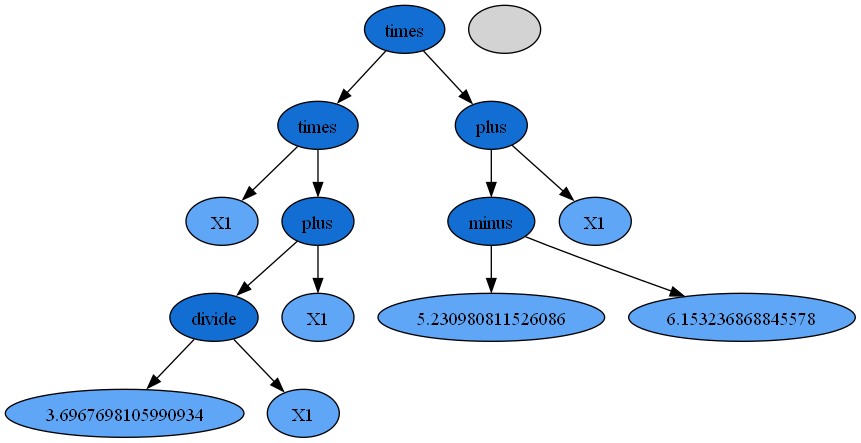

(plus (minus (minus (plus 3.5561917854707636 X1) (plus X1 X1)) (times X1 X1)) (times (times X1 X1) (plus X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.08921
MSE         : 2.08458
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 3.5561917854707636
*******************************************************************
 
                             TREE


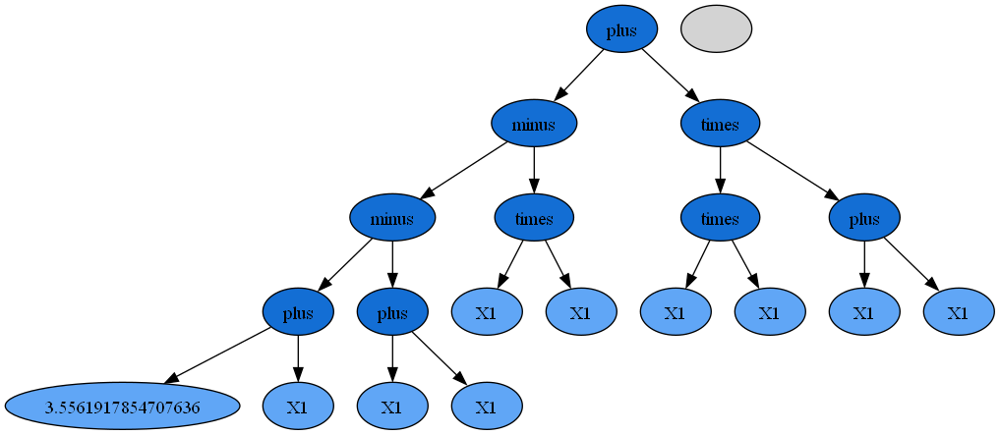

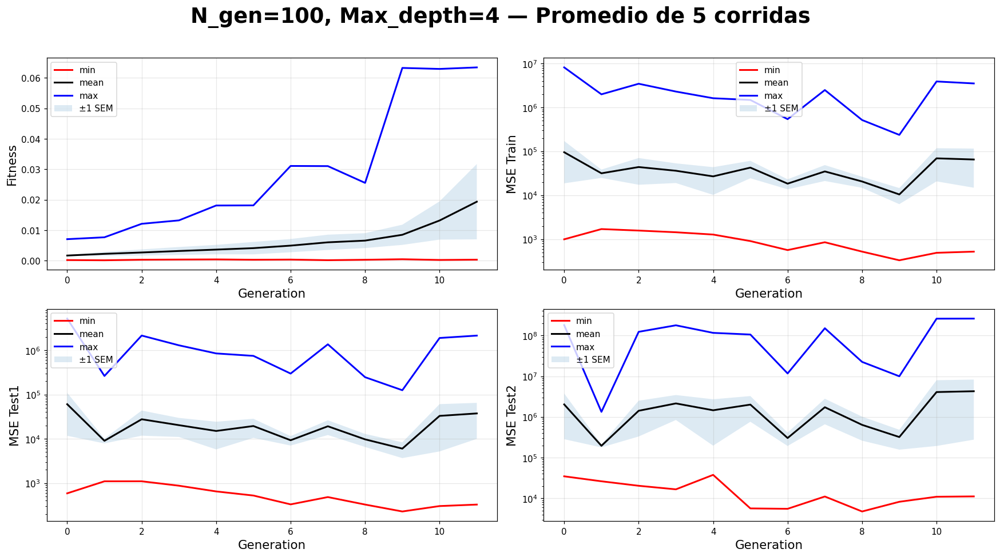

In [66]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 21

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 34.63it/s]


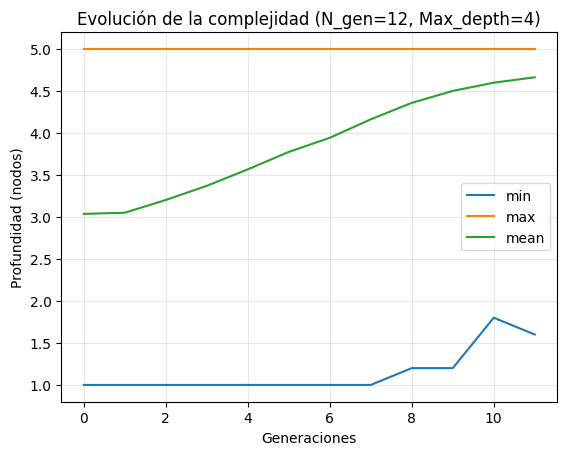

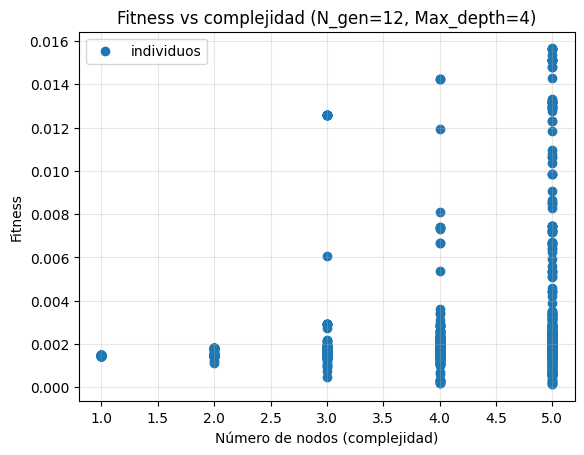

In [67]:
n_gen=12
max_depth=4
prob_mutation=0.10
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (plus (times 2.913959955857175 (plus X1 2.5469304562040707)) (times (times X1 X1) (times 1.807591220909931 X1))) (plus 9.086060271296374 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01566
MSE         : 79.05733
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.807591220909931*X1**3 + 1.913959955857175*X1 - 1.6644069115646656
*******************************************************************
 
                             TREE


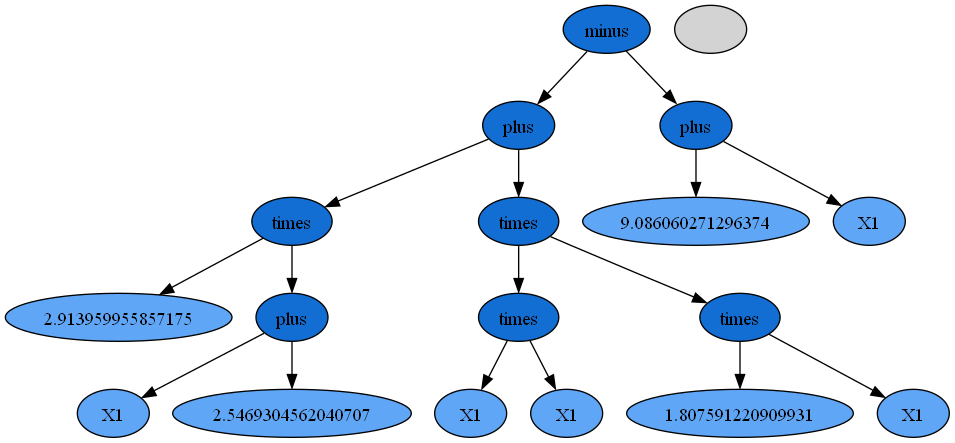

(plus (plus (times 9.382523813957738 X1) (minus (divide 0.8675388022180375 0.7852432120933983) (divide X1 X1))) (times (plus (divide 6.83726585462095 5.077863753448927) (times X1 X1)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00571
MSE         : 605.53055
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.0*X1**3 + 10.72900851433534*X1 + 0.1048026762373984
*******************************************************************
 
                             TREE


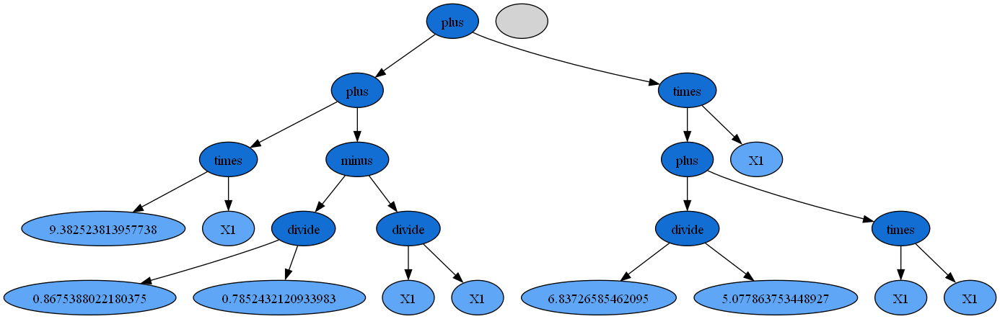

(times (plus X1 X1) (times X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01535
MSE         : 82.27885
DEPTH       : 3.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3
*******************************************************************
 
                             TREE


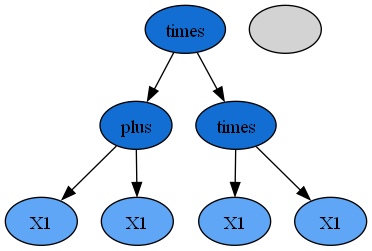

(times X1 (times X1 (plus X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01535
MSE         : 82.27885
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3
*******************************************************************
 
                             TREE


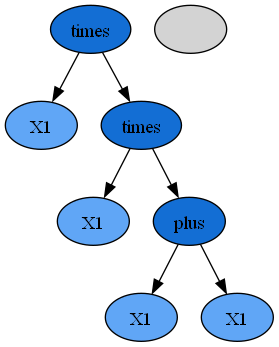

(plus (times (plus (times X1 X1) (times X1 X1)) X1) (divide X1 (plus (times X1 X1) (plus X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01505
MSE         : 85.64553
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             (2*X1**3*(X1 + 2) + 1)/(X1 + 2)
*******************************************************************
 
                             TREE


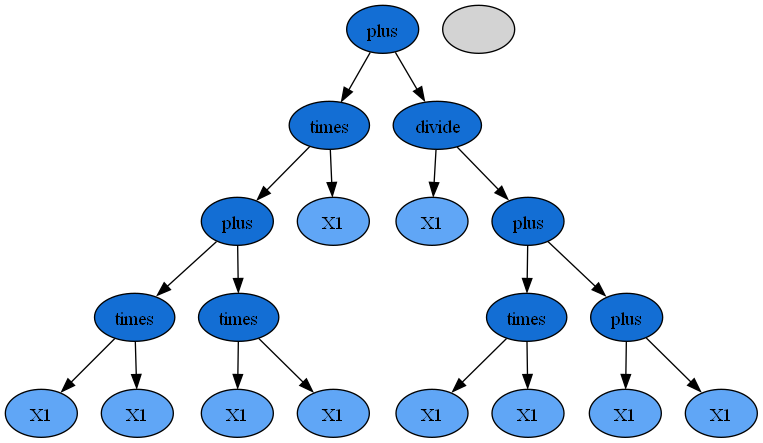

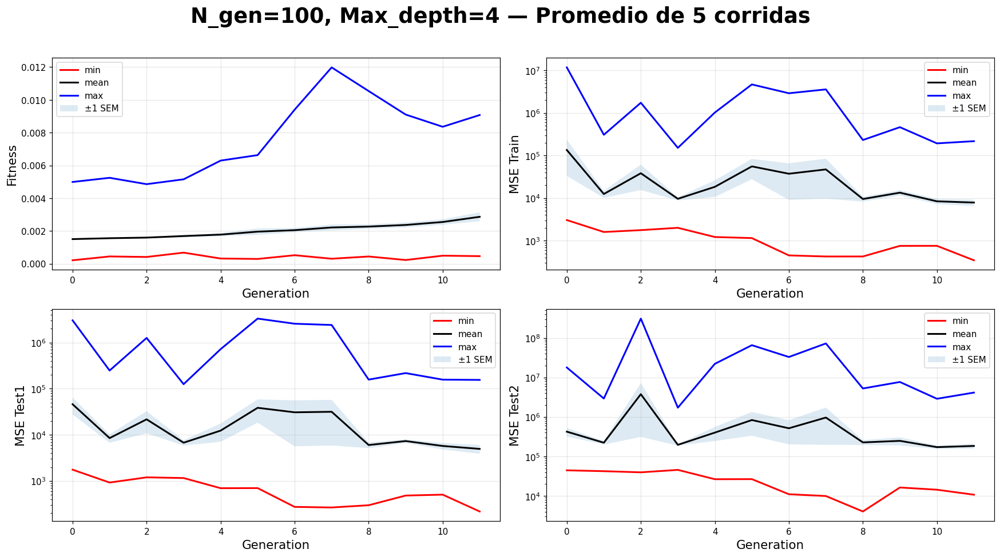

In [68]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 22

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 100/100 [00:03<00:00, 31.96it/s]


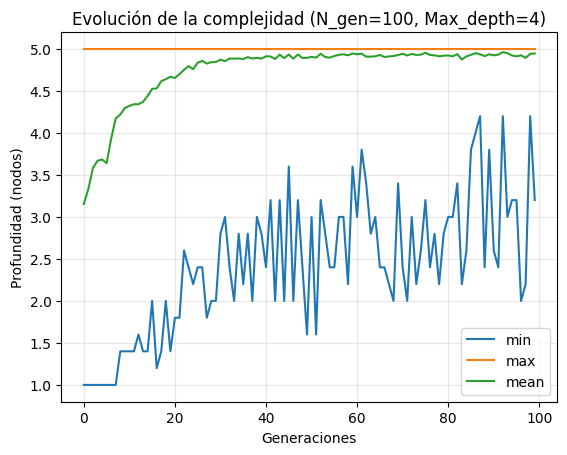

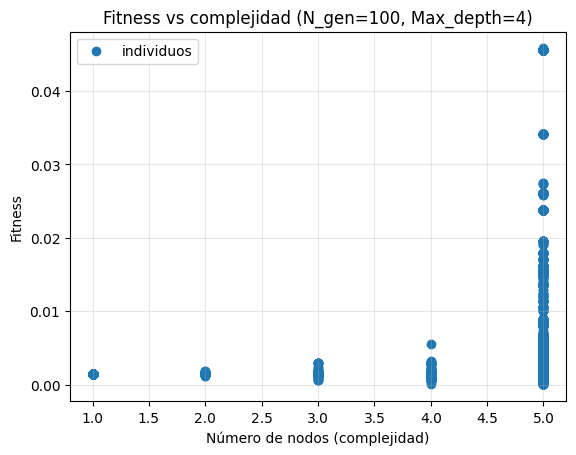

In [69]:
n_gen=100
max_depth=4
prob_mutation=0.10
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times (minus (times X1 X1) X1) X1) (plus 4.886989405588168 (times (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.04579
MSE         : 8.68624
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 + 4.886989405588168
*******************************************************************
 
                             TREE


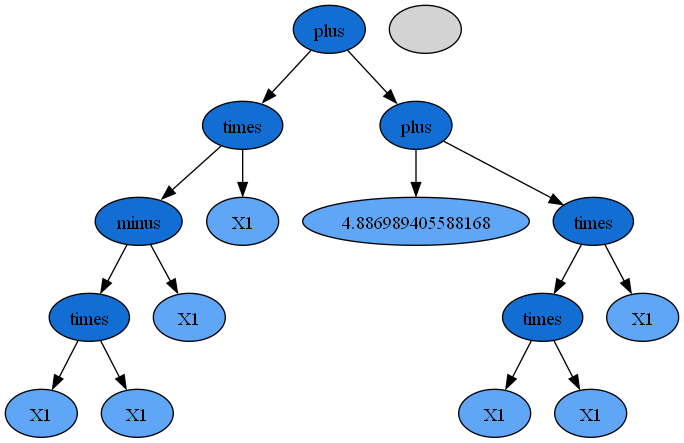

(plus (minus (times (times X1 X1) X1) (minus (times X1 X1) 6.844442443659764)) (minus (times (times X1 X1) X1) (minus (plus X1 9.522175394173917) 6.844442443659764)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.14509
MSE         : 0.69437
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 4.166709493145611
*******************************************************************
 
                             TREE


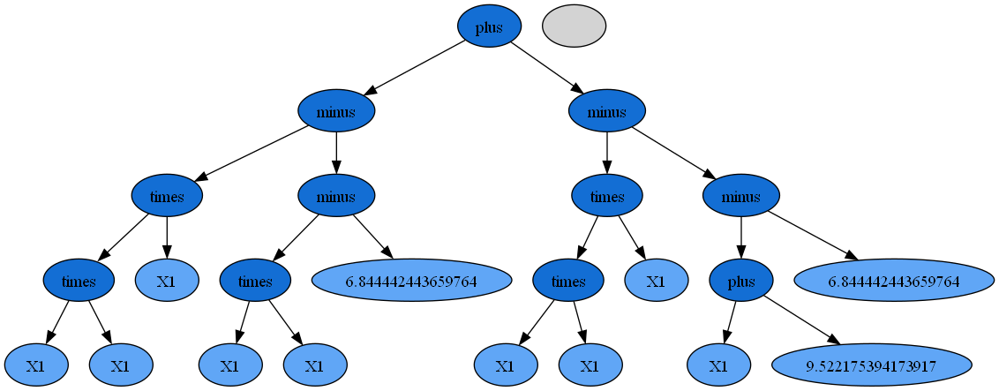

(minus (plus 5.312564537862992 (times (plus X1 X1) (times X1 X1))) (plus (times X1 X1) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.31151
MSE         : 0.09770
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - X1 + 5.312564537862992
*******************************************************************
 
                             TREE


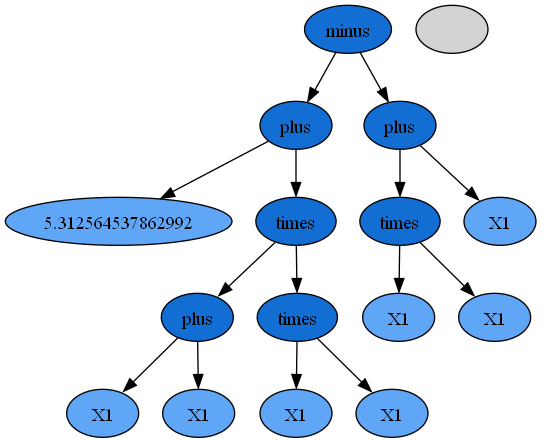

(minus (minus (times (plus X1 X1) (times X1 X1)) (times X1 X1)) (plus (minus X1 1.221049897672104) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02867
MSE         : 22.95393
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1**2 - 2*X1 + 1.221049897672104
*******************************************************************
 
                             TREE


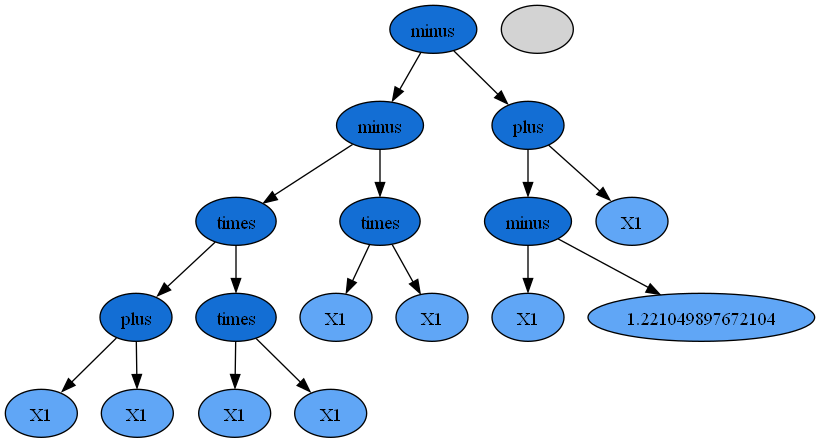

(plus (plus 4.578932442395658 (times (divide X1 4.578932442395658) (times X1 X1))) (times 4.438219192787855 (plus X1 (times 4.438219192787855 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00368
MSE         : 1462.31981
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             0.2183915164899897*X1**3 + 24.13600879601833*X1 + 4.578932442395658
*******************************************************************
 
                             TREE


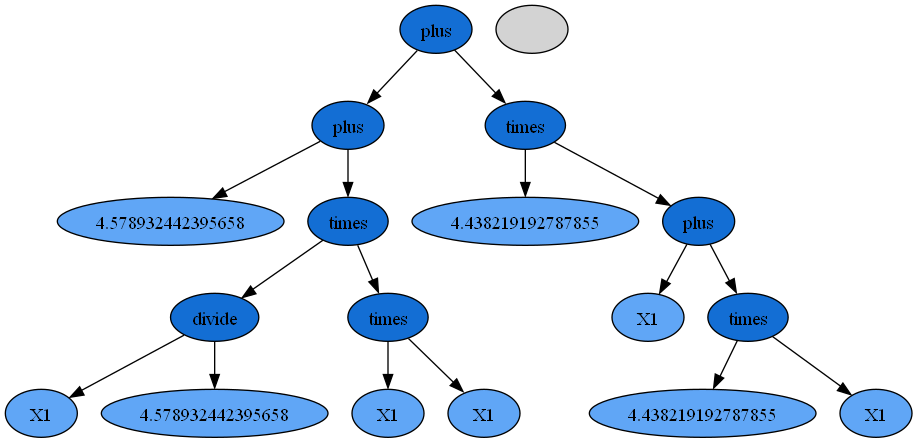

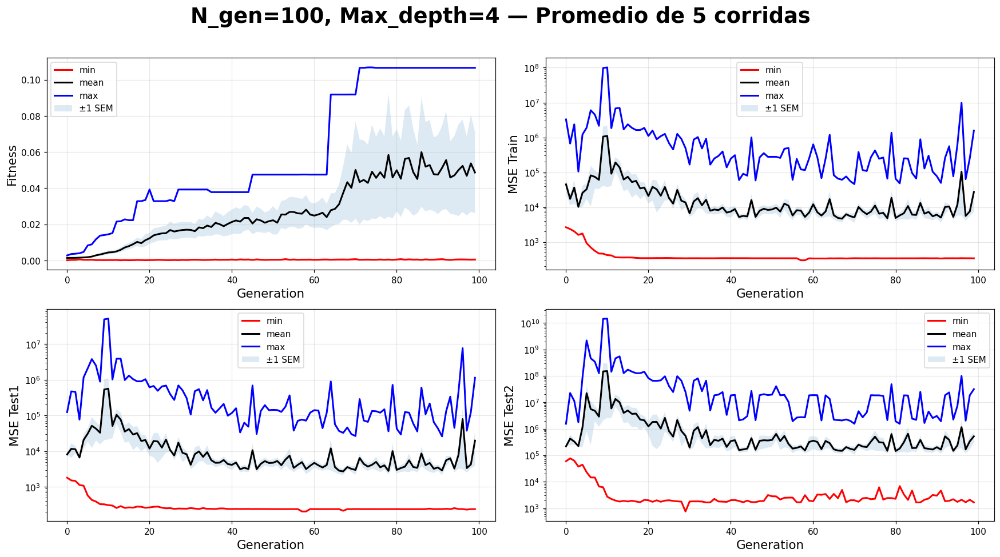

In [70]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 23 

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 31.64it/s]


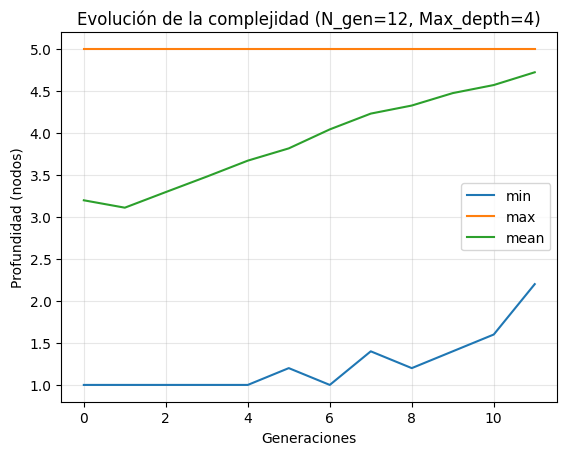

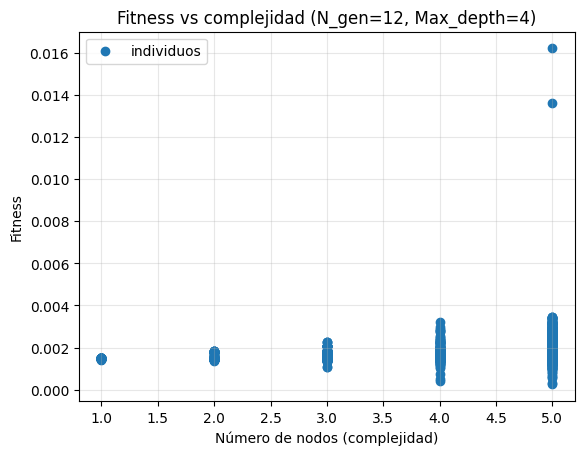

In [71]:
n_gen=12
max_depth=4
prob_mutation=0.10
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (times (times 2.0054667725401454 (times X1 X1)) X1) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01621
MSE         : 73.68048
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2.0054667725401454*X1**3 - X1
*******************************************************************
 
                             TREE


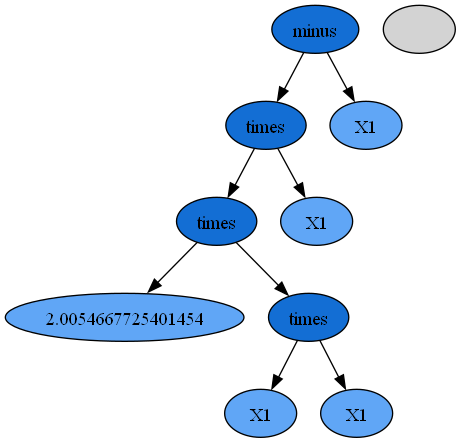

(minus (times (times X1 X1) (plus X1 X1)) (plus 0.7919663021815493 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01681
MSE         : 68.41407
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1 - 0.7919663021815493
*******************************************************************
 
                             TREE


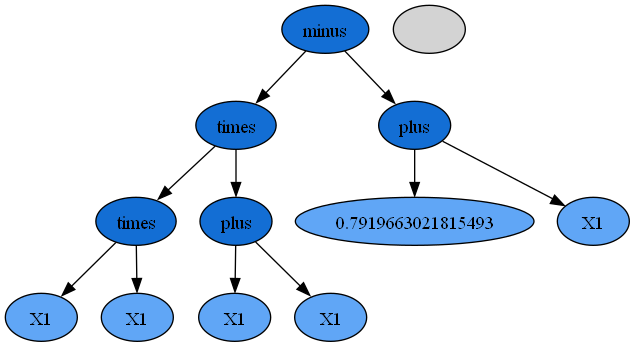

(plus (plus X1 (times X1 (times X1 X1))) (plus (divide 2.3101717355740767 (divide 0.24702403073256107 X1)) (times 1.264273541639177 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00598
MSE         : 551.93708
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1**2 + 11.61628568686714)
*******************************************************************
 
                             TREE


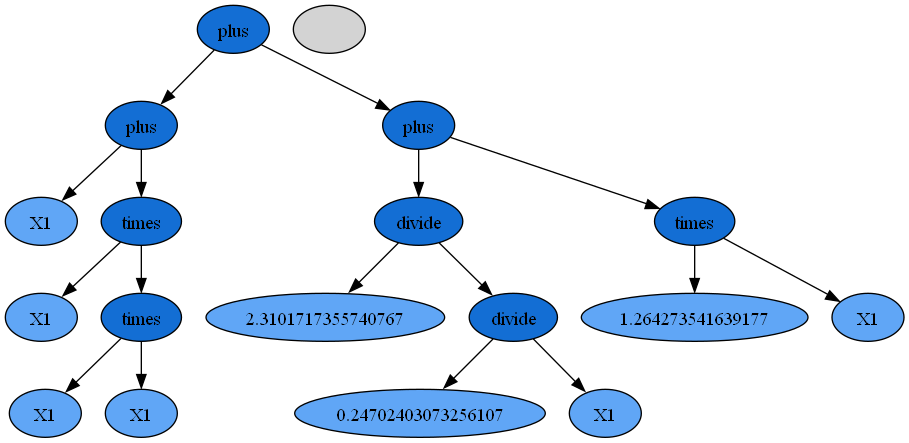

(minus (plus (times (times X1 X1) X1) (times (times X1 X1) X1)) (divide (divide 4.201493492265982 5.75497816179714) 0.3141263437511643))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01655
MSE         : 70.60526
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - 2.324104522712166
*******************************************************************
 
                             TREE


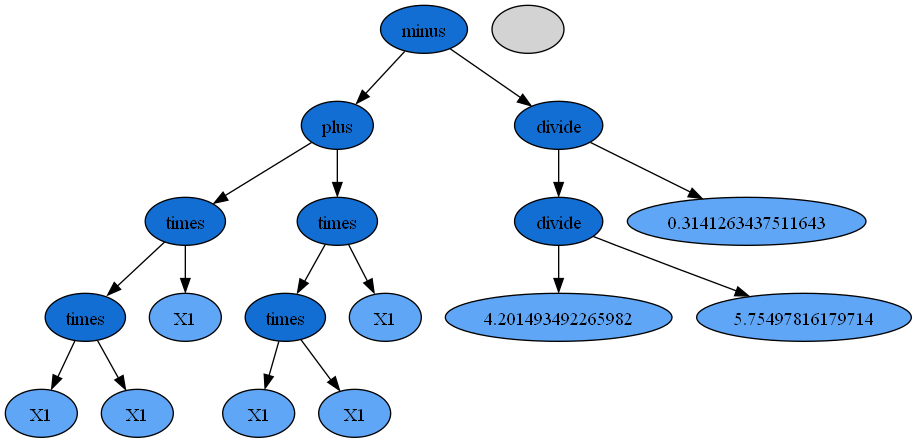

(minus (times 3.4557695498677363 (times 8.599788375715688 X1)) (divide (divide (plus X1 X1) X1) (plus 0.016623702492770676 1.6529305442712827)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00345
MSE         : 1671.96454
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             29.718886804104795*X1 - 1.1979245381672503
*******************************************************************
 
                             TREE


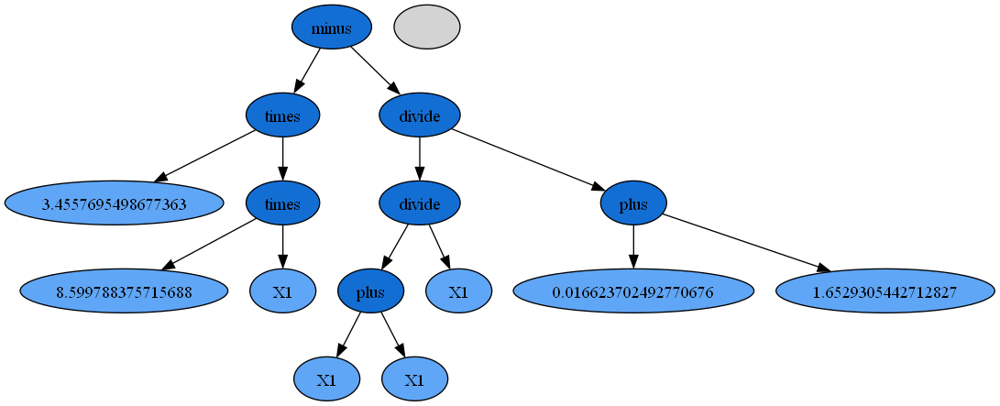

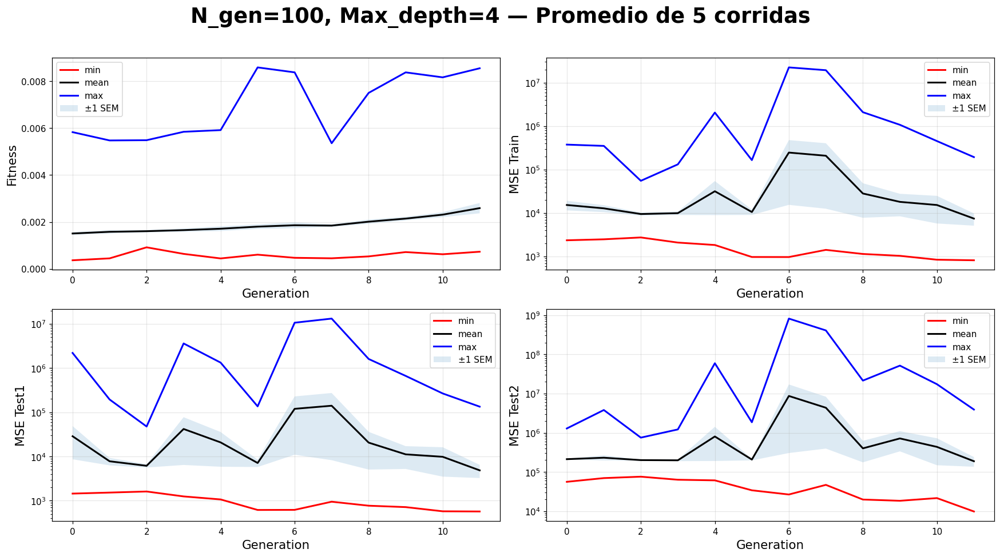

In [72]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 24 

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 12/12 [00:00<00:00, 36.90it/s]


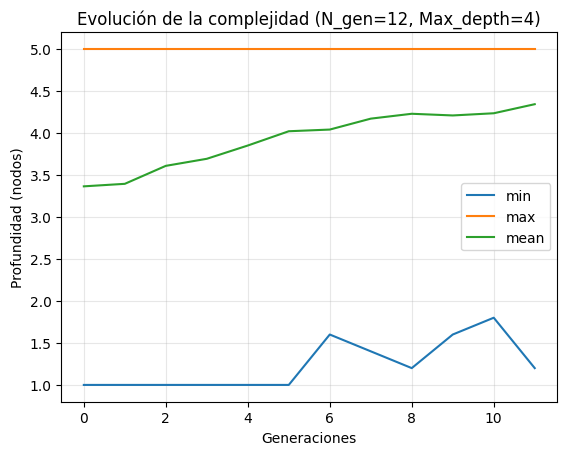

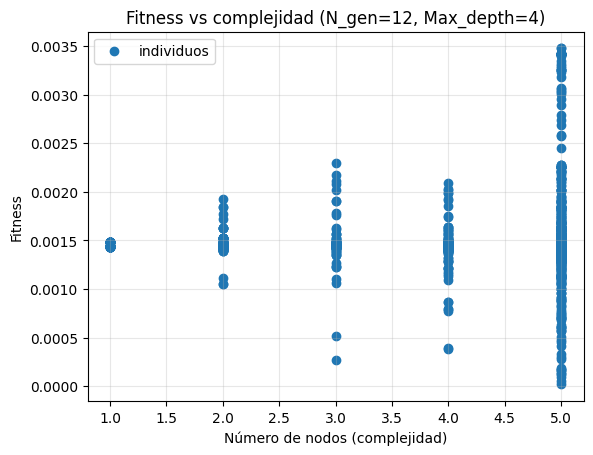

In [73]:
n_gen=12
max_depth=4
prob_mutation=0.10
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times (plus (divide 1.4437925729269263 X1) (minus X1 X1)) (minus (plus X1 3.6988532553815068) (plus X1 6.646201572989571))) (divide (times 5.99579950627111 7.462936442278285) (plus (divide 1.4437925729269263 X1) (minus X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00348
MSE         : 1643.07709
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             30.992173997150441*X1 - 4.2553596107911946/X1
*******************************************************************
 
                             TREE


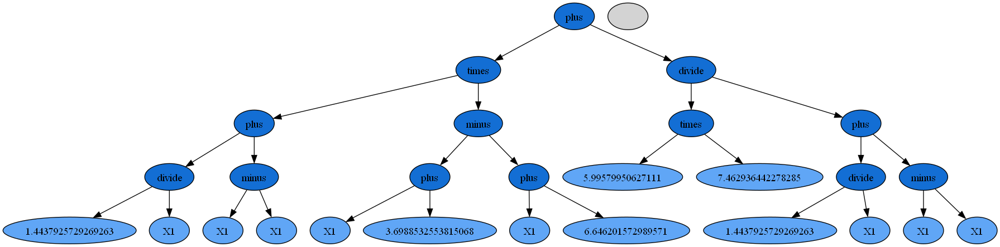

(times (times (plus X1 X1) X1) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01535
MSE         : 82.27885
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3
*******************************************************************
 
                             TREE


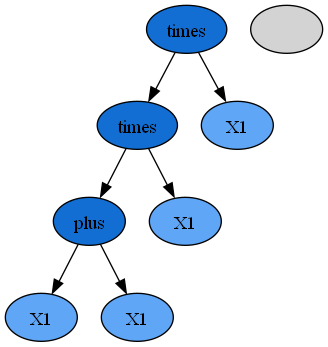

(plus (times (plus (minus X1 5.7215305913591665) (times X1 X1)) (divide (times 4.634359554938831 X1) (plus 6.1353086028767745 2.7218485602527966))) (times (plus (minus 7.738858443067331 X1) (times X1 X1)) (times (divide X1 X1) (plus 0.6645888570910385 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00769
MSE         : 333.31543
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             1.5232332981772828*X1**3 + 0.18782215526832129*X1**2 + 4.0805742640372165*X1 + 5.1431590878674511
*******************************************************************
 
                             TREE


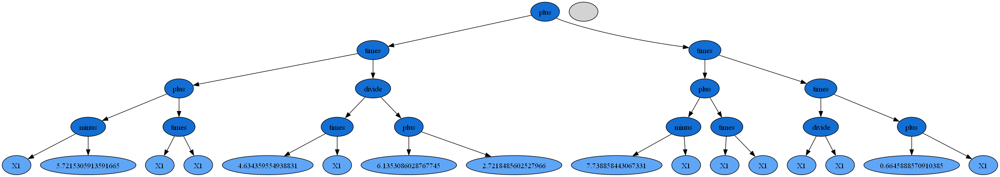

(times (plus (minus 0.2805596301851654 0.7591720294486748) (plus X1 0.5737610663973769)) (times (times (divide 5.775510470053462 8.174144735218956) X1) (times X1 3.105545613371876)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00847
MSE         : 273.97472
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2.194249280659138*X1 + 0.2087798944141645)
*******************************************************************
 
                             TREE


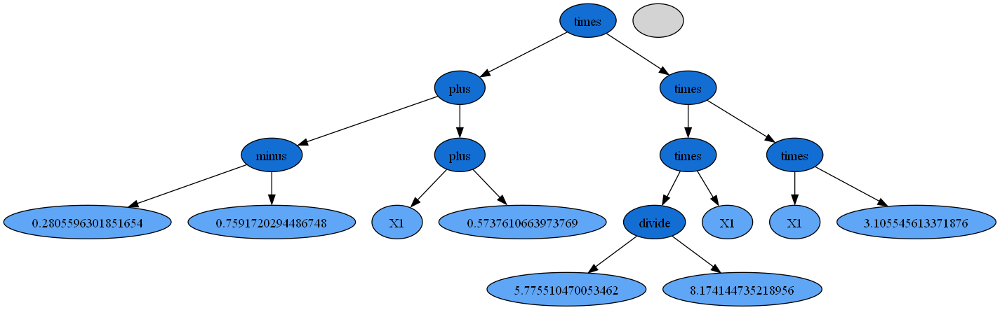

(minus (plus (times X1 (times X1 X1)) (times X1 (times X1 X1))) (plus (divide X1 4.172291035477235) (plus X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02724
MSE         : 25.49825
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2*X1**2 - X1 - 1.239676473068859)
*******************************************************************
 
                             TREE


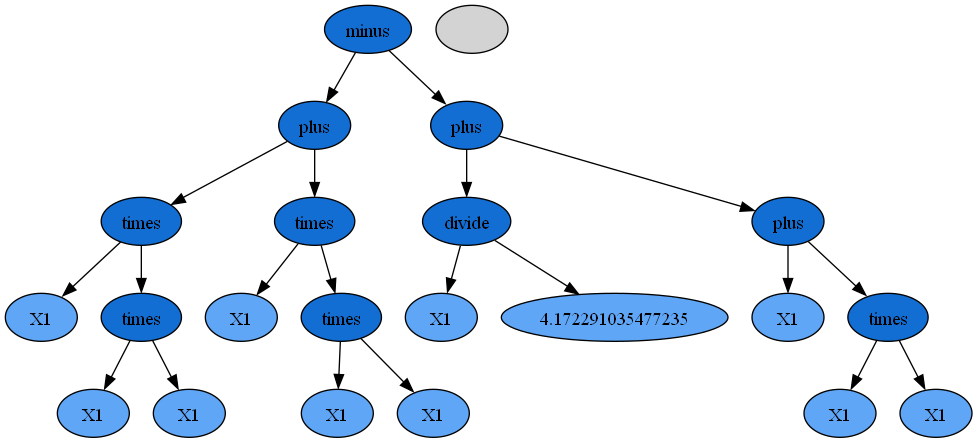

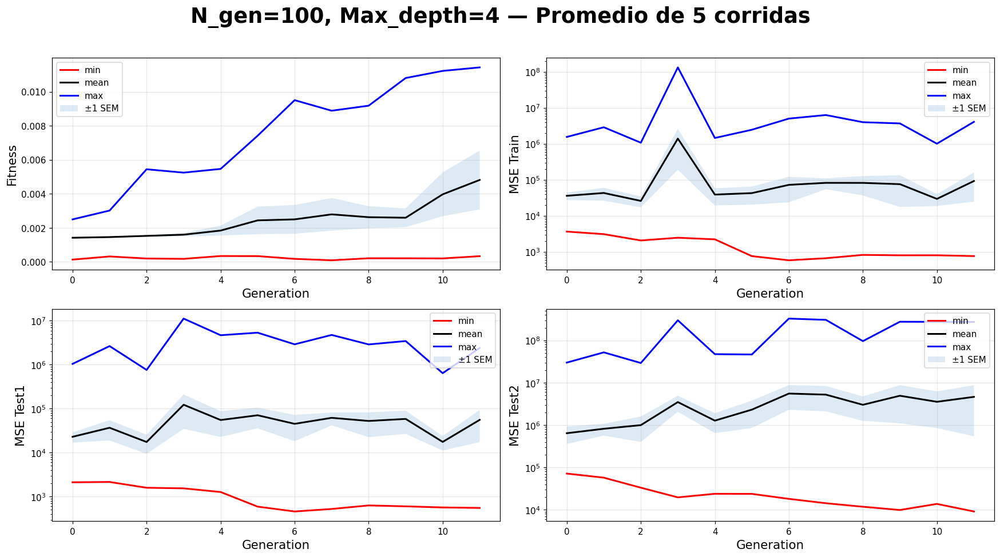

In [74]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 25 

- Numero de generaciones = 12
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method = Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 34.09it/s]


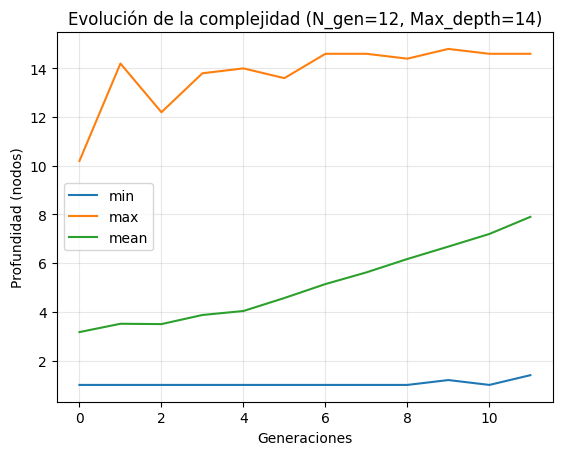

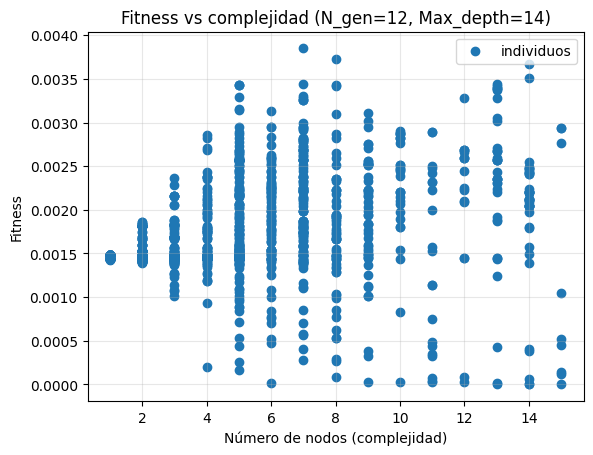

In [75]:
n_gen=12
max_depth=14
prob_mutation=0.15
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (times (plus X1 7.272721302384749) (plus X1 X1)) (minus (times X1 X1) (times (plus (times (divide X1 X1) (minus X1 6.35348069903877)) (divide (divide 5.503202692394055 X1) (divide 2.8725926669942723 4.400156207489676))) (divide (times (plus 1.3415394359099109 X1) (minus 0.3639160852855372 X1)) (plus (minus 6.8246602442287845 8.034357098055558) (divide X1 6.032779783262549))))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00385
MSE         : 1339.81754
DEPTH       : 7.00000
*******************************************************************
 
                        REDUCED TREE
             (-0.83423893529572923*X1**4 + 6.5772285473490765*X1**3 - 19.325707535711094*X1**2 - 11.342841626041919*X1 + 4.1154208318824524)/(X1*(0.16576106470427077*X1 - 1.2096968538267736))
*******************************************************************
 
                             TREE


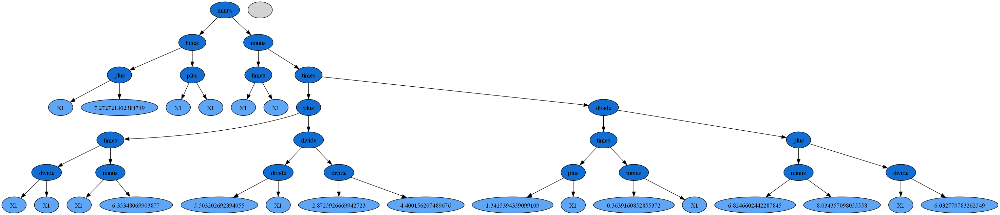

(times (plus (divide X1 0.4465980941335712) (minus 3.555470618041603 9.712222151418326)) (plus (times X1 X1) (plus X1 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00544
MSE         : 667.65837
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1 + 2)*(2.239149725750764*X1 - 6.156751533376723)
*******************************************************************
 
                             TREE


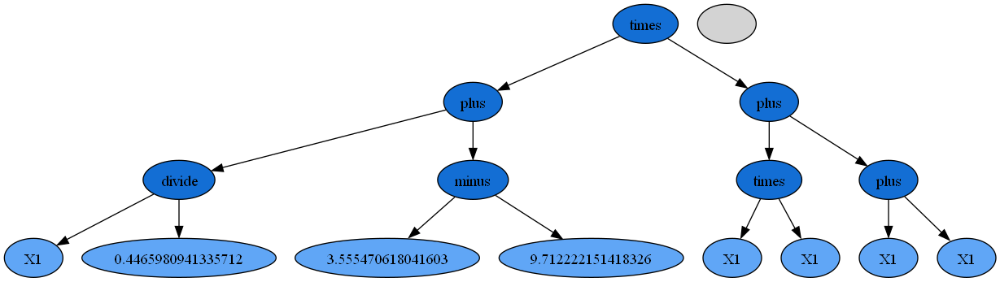

(plus 3.3739243710662525 (divide (minus (times 9.21871298392768 X1) X1) (divide (divide 8.115000882442429 X1) (times (divide 6.2917942768201085 6.289867519685198) (plus X1 X1)))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01238
MSE         : 127.25929
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             2.02618107326805*X1**3 + 3.3739243710662525
*******************************************************************
 
                             TREE


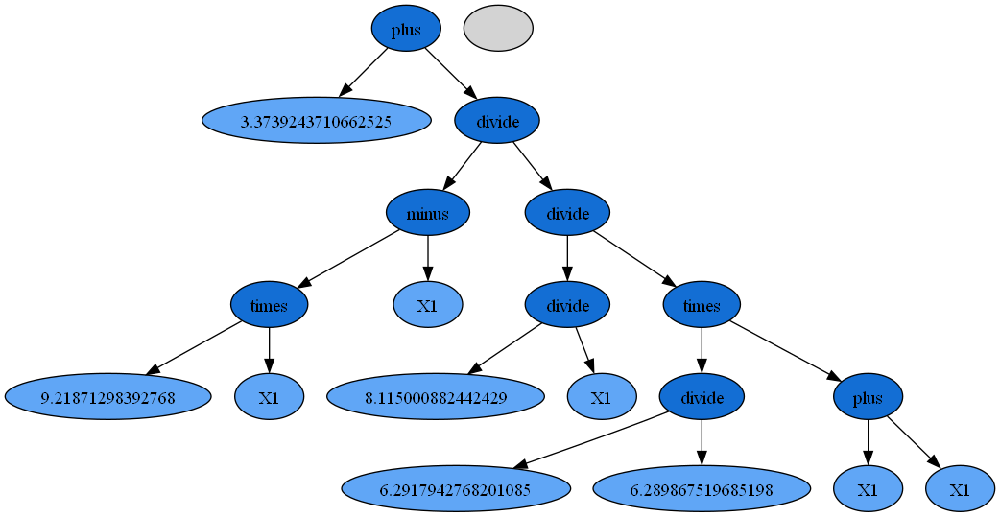

(plus (times 9.212302167999528 X1) (plus (times 9.212302167999528 X1) (times (plus (plus 1.404572740145561 (minus X1 4.854983786605423)) (times X1 X1)) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00499
MSE         : 794.99304
DEPTH       : 7.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1**2 + X1 + 14.97419328953919)
*******************************************************************
 
                             TREE


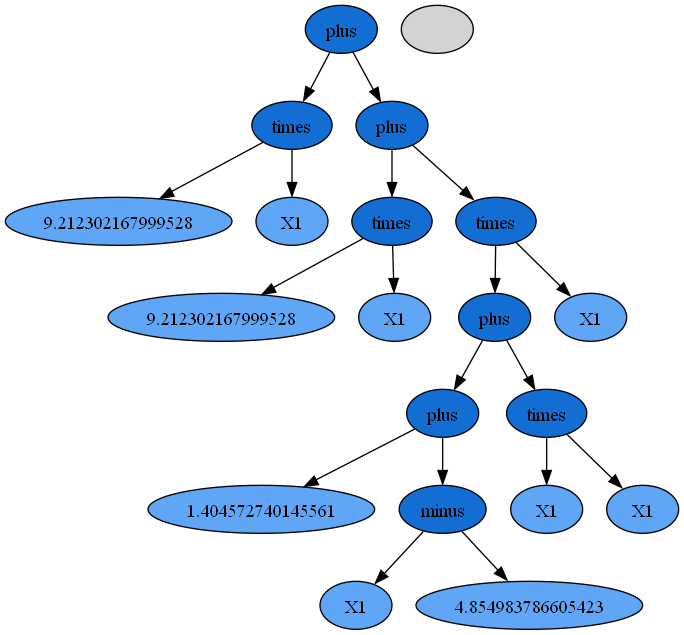

(plus (times (divide X1 (divide 1.6268188401045969 X1)) (minus (times X1 3.304032174383579) (divide 6.658452938224313 X1))) (divide (divide (times X1 X1) (minus 6.541323600570761 X1)) (minus X1 (times 2.2105662533657524 (times (divide 0.7699942964886497 (plus X1 (minus (times 1.132735970459784 X1) (plus (divide (times (divide (divide (minus X1 2.1186317742658476) (minus X1 0.35659273349791465)) (minus 7.229855639122614 X1)) (times 3.5990328208791578 0.9446411421235268)) 8.35939476266563) 1.943143977497287)))) X1)))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01219
MSE         : 131.43956
DEPTH       : 15.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(4.3315383939192929*X1**6 - 68.598442120173029*X1**5 + 322.81278443710209*X1**4 - 330.57760856051805*X1**3 - 513.71577536374813*X1**2 + 919.84643930632793*X1 - 268.80988

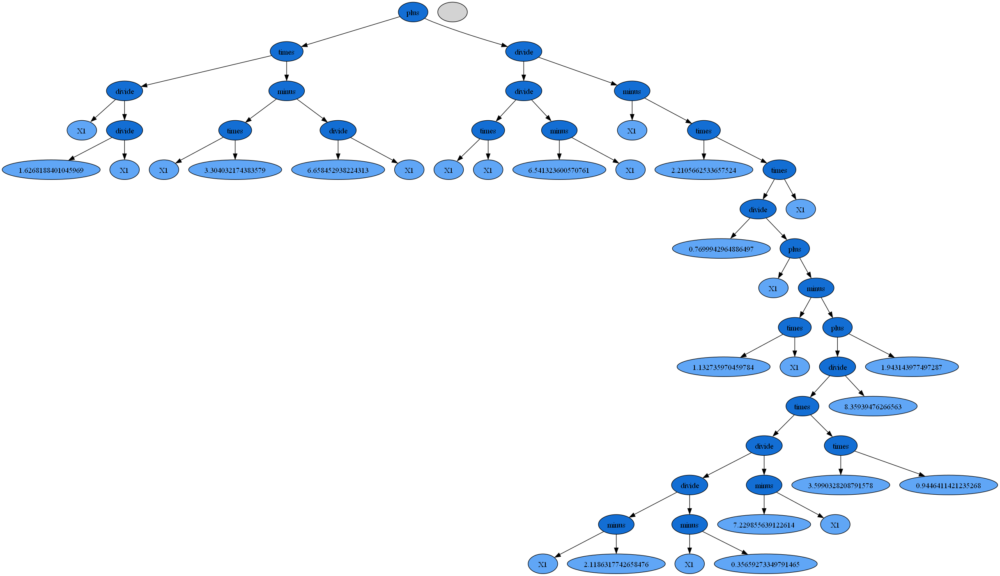

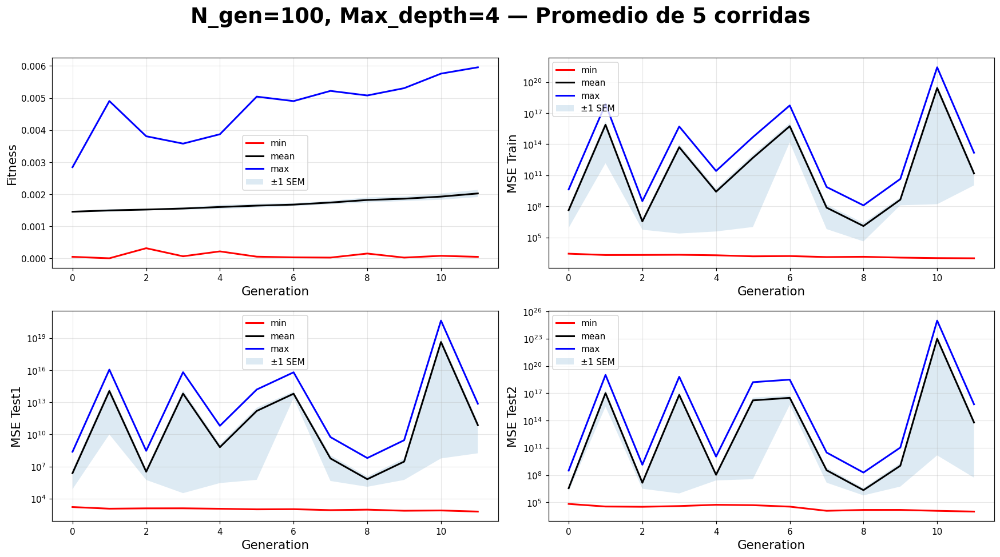

In [76]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 26

- Numero de generaciones = 12
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 12/12 [00:00<00:00, 33.47it/s]


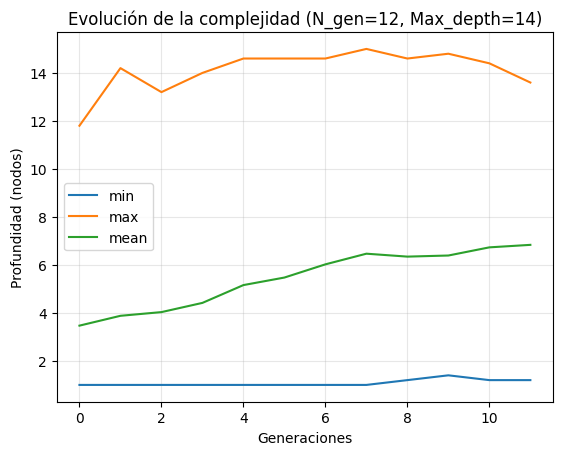

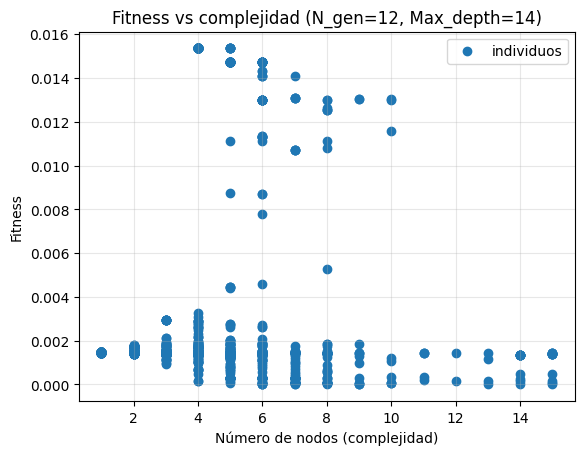

In [77]:
n_gen=12
max_depth=14
prob_mutation=0.15
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times (times (plus X1 X1) X1) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01535
MSE         : 82.27885
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3
*******************************************************************
 
                             TREE


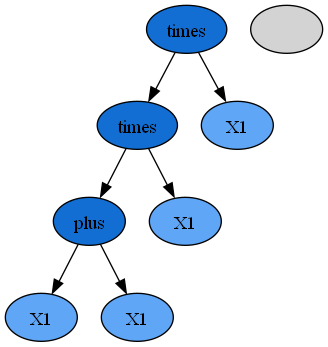

(times (times 0.39359270092051646 (times 5.269379690822598 X1)) (plus (times X1 X1) 2.201890819610278))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00650
MSE         : 467.62265
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             2.0739893846865823*X1*(X1**2 + 2.201890819610278)
*******************************************************************
 
                             TREE


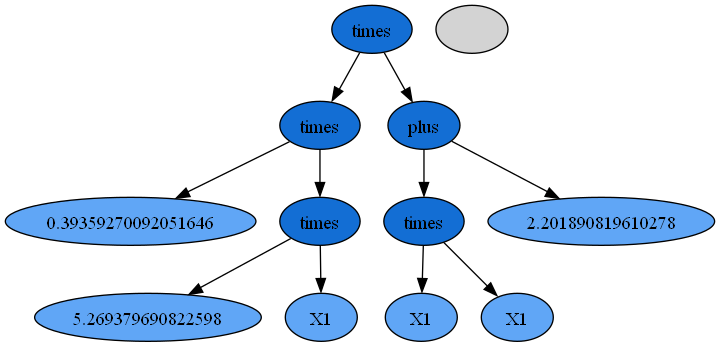

(plus (plus (times (times X1 X1) X1) (minus (times (times X1 X1) X1) (minus 5.424474886890396 (divide X1 2.365025946383371)))) (plus (plus 0.17431298731106715 (minus X1 X1)) 1.86370327909273))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01579
MSE         : 77.75231
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 + 0.4228283421284292*X1 - 3.386458620486599
*******************************************************************
 
                             TREE


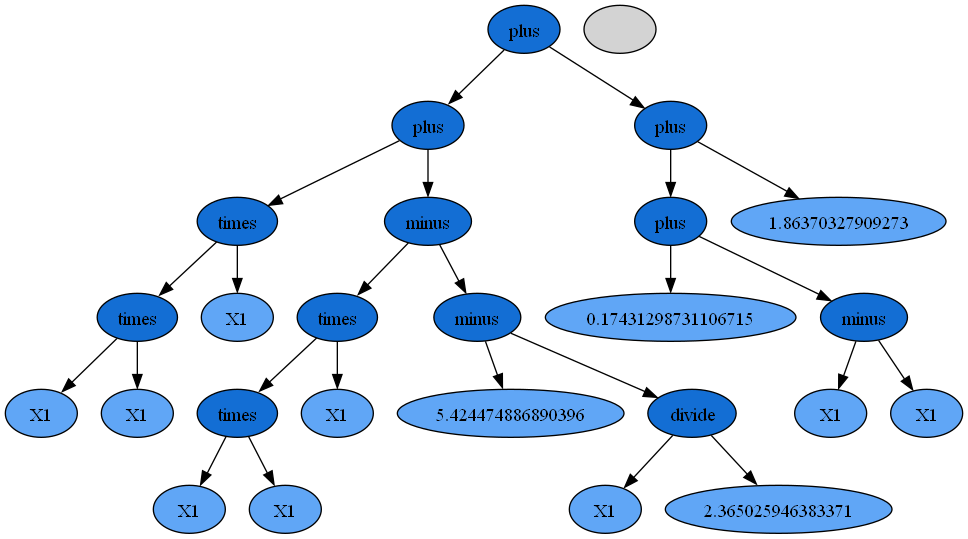

(plus (times (plus (times X1 6.252199245120255) (divide (divide X1 X1) (divide 1.403343163112497 0.3845514990664345))) (times (divide X1 X1) (times 0.5742640874589822 5.569333088436043))) (plus (times (divide (plus (divide 8.43452221692957 1.8956516806405488) (plus (plus X1 X1) (times X1 4.650827427093297))) (divide 6.919212545087719 X1)) X1) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00448
MSE         : 987.93096
DEPTH       : 8.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(0.9612116095226817*X1 + 0.64305078801556422) + 20.9962086739181*X1 + 0.8764062703332061
*******************************************************************
 
                             TREE


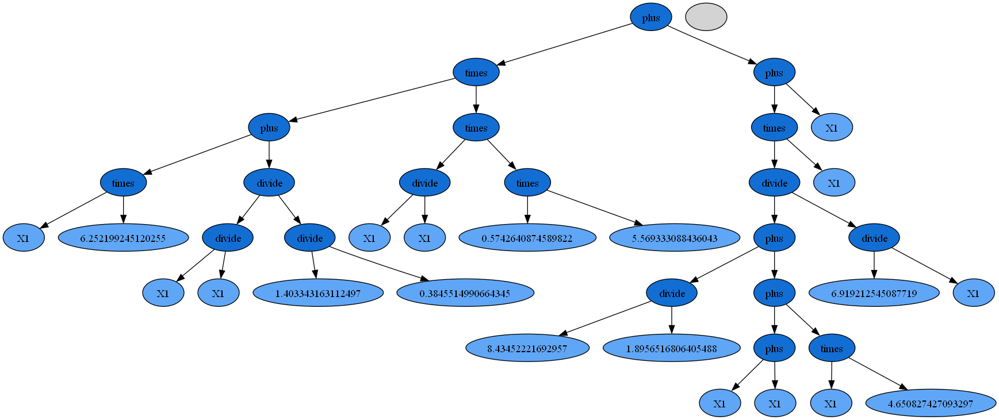

(times (plus (divide 0.35380641572162697 (times (plus (plus (divide (minus (minus (plus (divide 0.35380641572162697 (times X1 0.18507821313812567)) (plus (times X1 X1) (times X1 X1))) X1) (plus (divide (minus X1 (times (minus (minus X1 1.7734971465676141) (plus X1 X1)) (plus (divide X1 5.362734463429844) (minus X1 1.7734971465676141)))) (plus (divide 1.8323329699075241 X1) 4.796713006676302)) (plus 3.5401283137274597 3.0202888354067836))) (plus (divide (times 0.26954646917392466 6.963557279513056) (minus (plus (times X1 X1) (times 0.870985138076058 1.8853131506261378)) 1.6631833862492196)) 4.796713006676302)) (plus 3.5401283137274597 3.0202888354067836)) (plus (times X1 X1) (divide 1.8323329699075241 X1))) X1)) (plus (times X1 X1) (times X1 X1))) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01538
MSE         : 81.93599
DEPTH       : 15.00000
*******************************************************

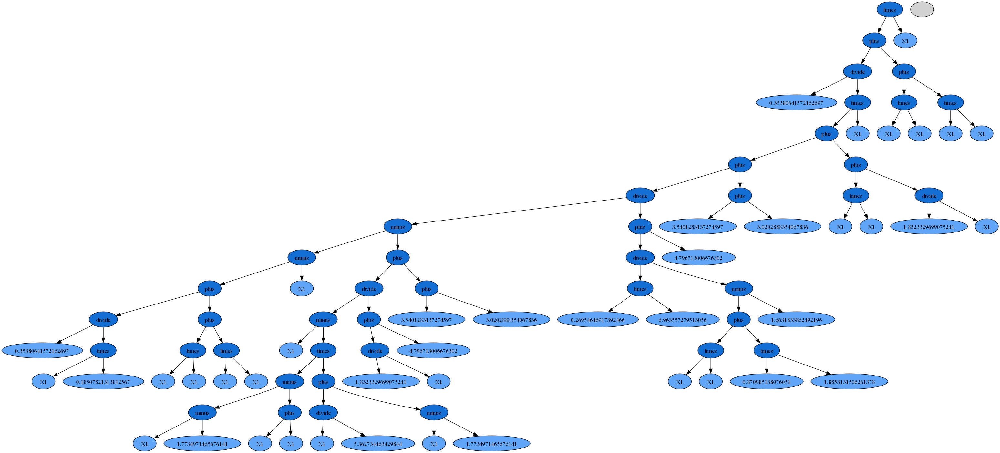

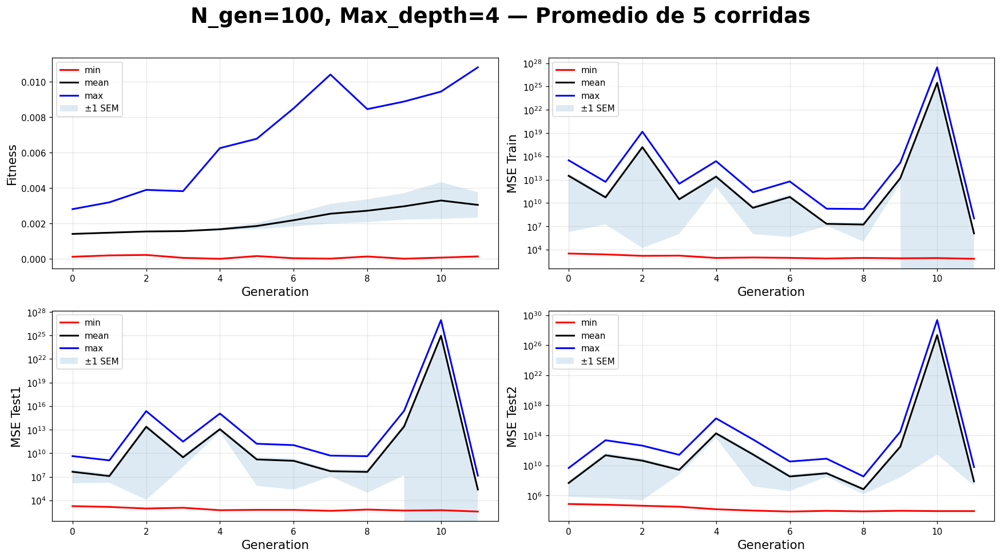

In [78]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 27

- Numero de generaciones = 12
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 34.77it/s]


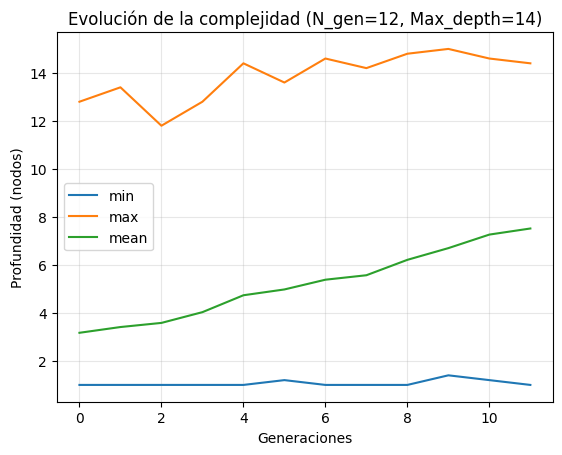

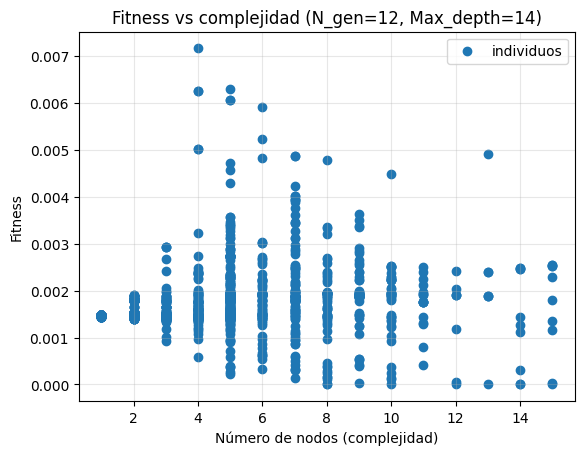

In [79]:
n_gen=12
max_depth=14
prob_mutation=0.15
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times (times X1 X1) (divide X1 (minus 7.494599569685601 6.867864524072912)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00717
MSE         : 383.80083
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             1.595570579625736*X1**3
*******************************************************************
 
                             TREE


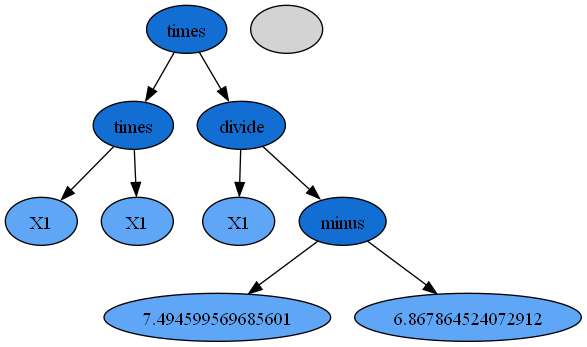

(minus (times (divide X1 (divide 0.769204595261016 X1)) (plus (minus X1 X1) (plus X1 X1))) (plus (minus (divide (times X1 X1) X1) (divide X1 (plus 9.864638968017818 X1))) (minus (times X1 X1) X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00420
MSE         : 1124.73436
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1*(X1 + 9.864638968017818)*(2.6000884710281*X1 - 1) + 1)/(X1 + 9.864638968017818)
*******************************************************************
 
                             TREE


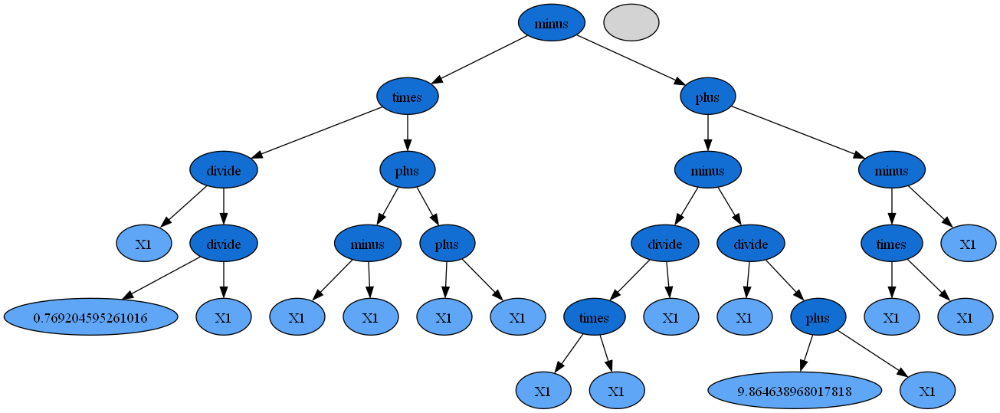

(times (plus (divide 8.225071038532416 7.145148960798324) (minus (minus (times X1 X1) 7.987862486710454) X1)) (plus (times 2.034367742157148 X1) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00390
MSE         : 1303.23617
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             -3.034367742157148*X1*(-X1**2 + X1 + 6.836721889970056)
*******************************************************************
 
                             TREE


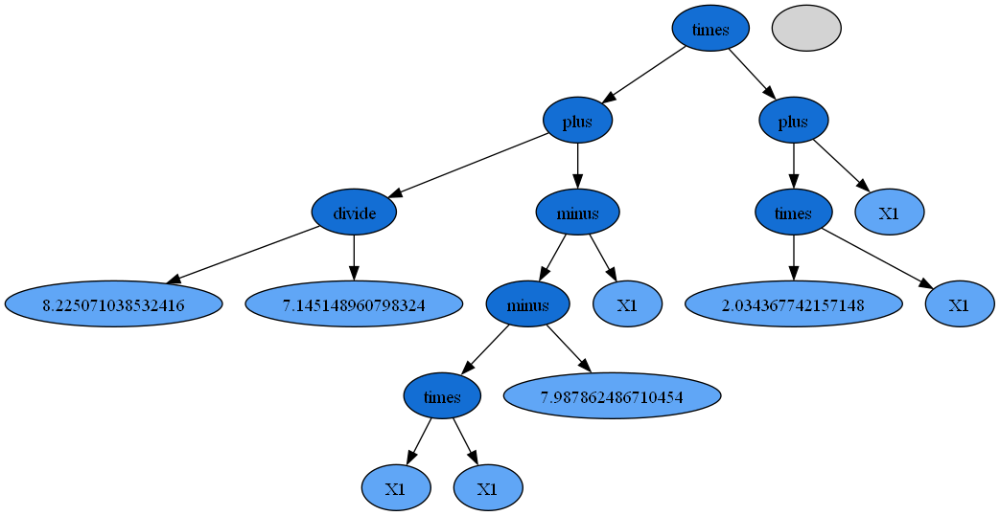

(minus (plus (plus (times 4.483928621673169 X1) (plus (plus (times X1 4.7745031062237375) (divide (plus (divide (plus 5.569705110569295 X1) 2.1118860479169865) (plus 6.395196772209849 X1)) (minus 2.0880007878553464 0.8971349041254328))) X1)) (plus (plus (times (times X1 X1) (plus X1 1.8143131962242565)) (minus X1 X1)) (minus X1 X1))) 5.421061028007669)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00373
MSE         : 1426.22525
DEPTH       : 10.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(X1 + 1.8143131962242565) + 11.495775426018888*X1 + 2.1637645775802224
*******************************************************************
 
                             TREE


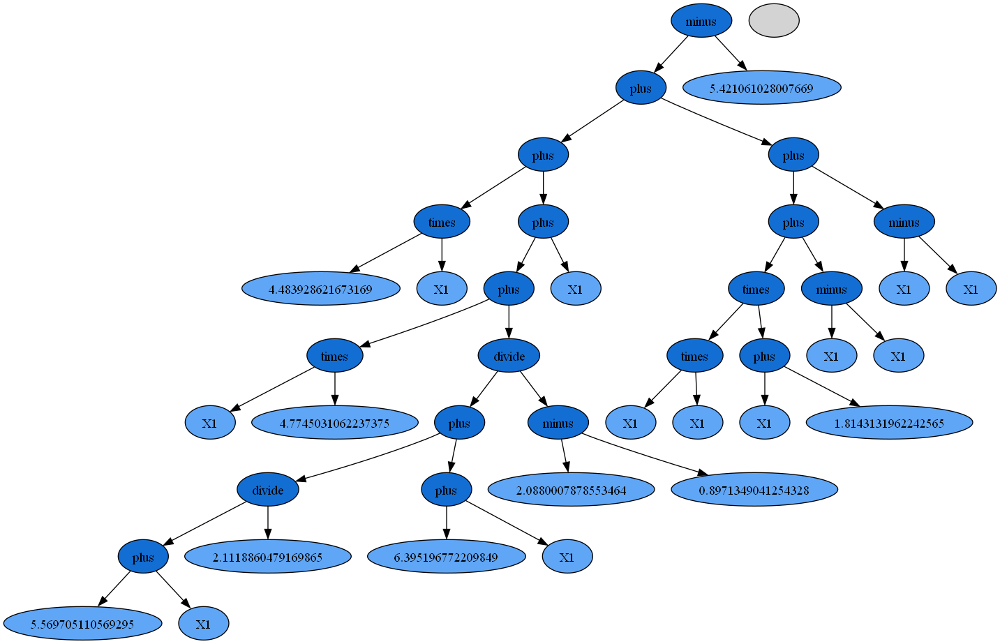

(plus (times (divide (times X1 X1) (divide 7.584041977206148 X1)) 7.622105774004842) (times (divide (minus (times X1 X1) 0.6207146900960225) (plus X1 (plus (minus (plus 1.7721845810304504 9.53038005927105) X1) X1))) (times X1 5.239170177525905)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00675
MSE         : 433.15884
DEPTH       : 8.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(1.0050189327687129*X1**3 + 16.59846162987111*X1**2 - 3.2520298931033153)/(1.0*X1 + 11.3025646403015)
*******************************************************************
 
                             TREE


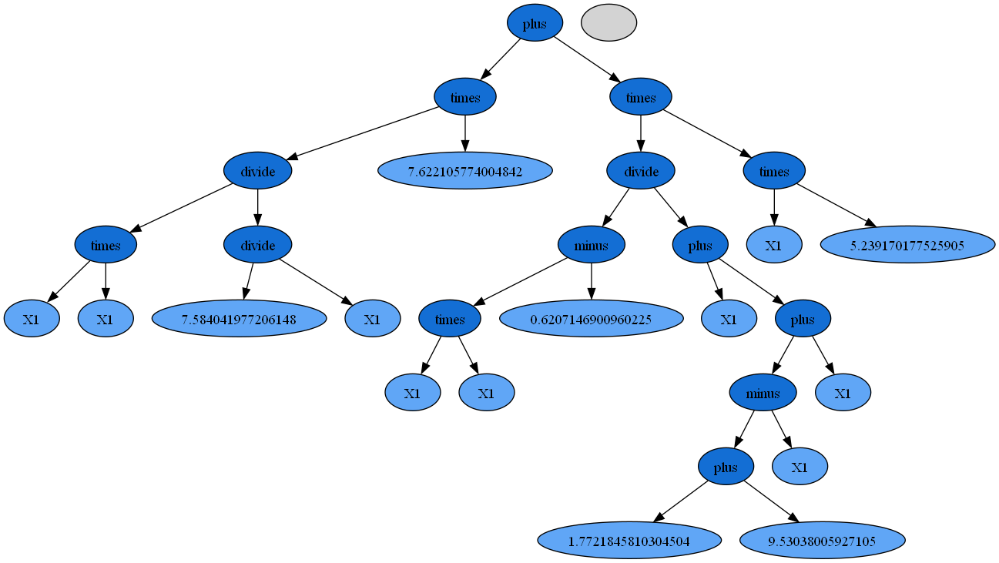

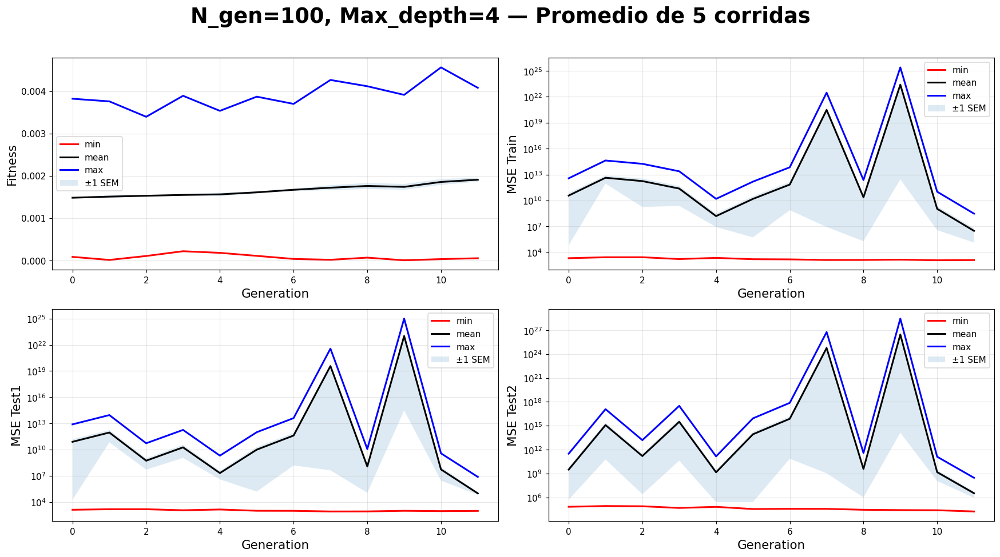

In [80]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 28

- Numero de generaciones = 12
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.15
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 12/12 [00:00<00:00, 36.30it/s]


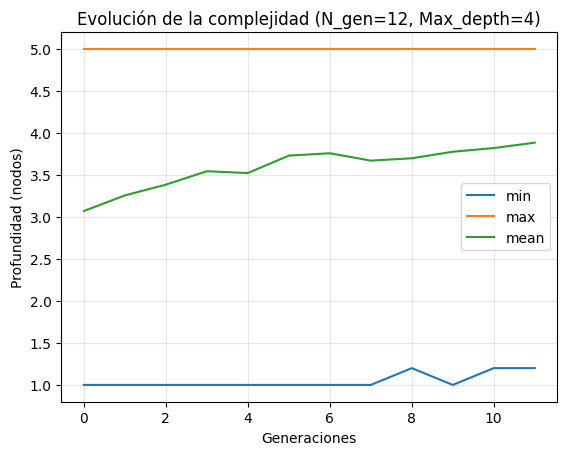

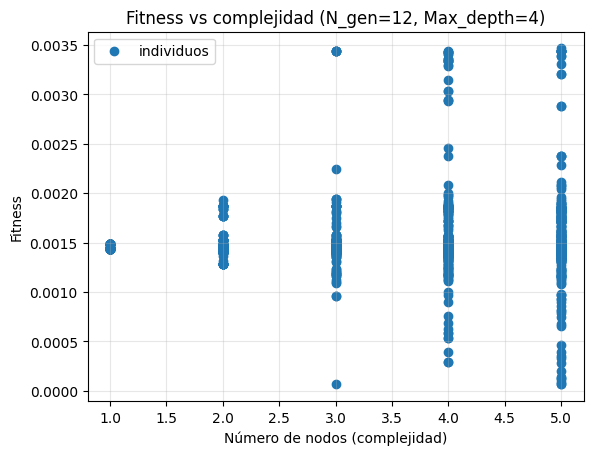

In [81]:
n_gen=12
max_depth=4
prob_mutation=0.15
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times (times 7.684468330016253 6.107740480404875) (divide X1 1.5686331519151908)) (plus X1 (minus X1 (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00347
MSE         : 1654.10156
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(31.920786917148539 - X1)
*******************************************************************
 
                             TREE


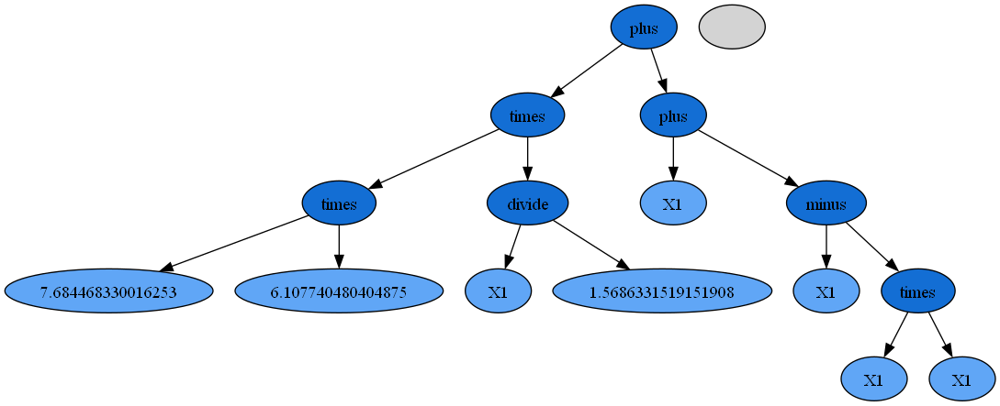

(divide (times (times (times 5.349210379955648 X1) (divide X1 X1)) (times X1 (times X1 X1))) (plus (minus (plus X1 X1) (divide X1 3.0492645925882957)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01530
MSE         : 82.80529
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2.001910977965257*X1**3
*******************************************************************
 
                             TREE


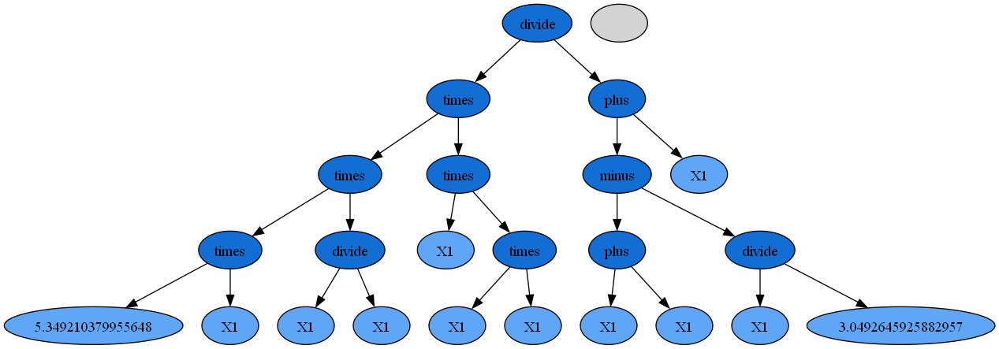

(plus (plus (times 6.948702023964312 X1) (times X1 (times X1 X1))) (plus (plus 0.7478994367863501 9.536438197399766) (times X1 5.7577251813726775)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00537
MSE         : 687.07279
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**3 + 12.70642720533699*X1 + 10.28433763418612
*******************************************************************
 
                             TREE


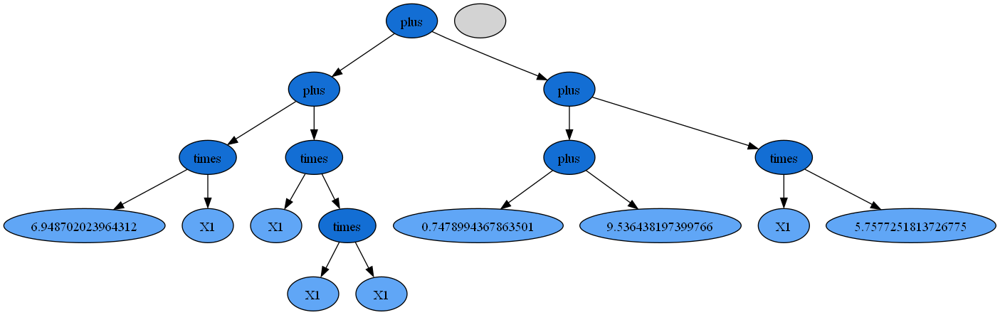

(plus X1 (times 3.369244289158603 (times 8.68683324665672 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00344
MSE         : 1677.28854
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             30.26806330717124*X1
*******************************************************************
 
                             TREE


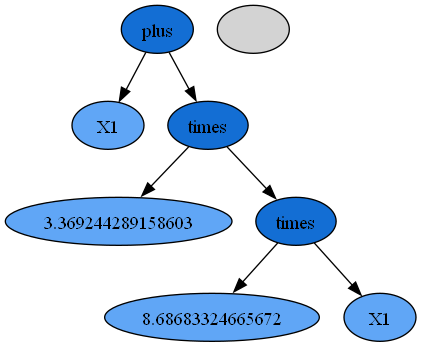

(times (times X1 1.8594012859553843) (times X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01438
MSE         : 93.89357
DEPTH       : 3.00000
*******************************************************************
 
                        REDUCED TREE
             1.8594012859553843*X1**3
*******************************************************************
 
                             TREE


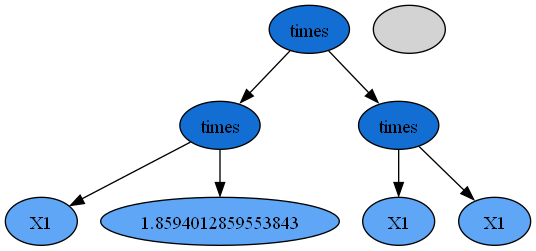

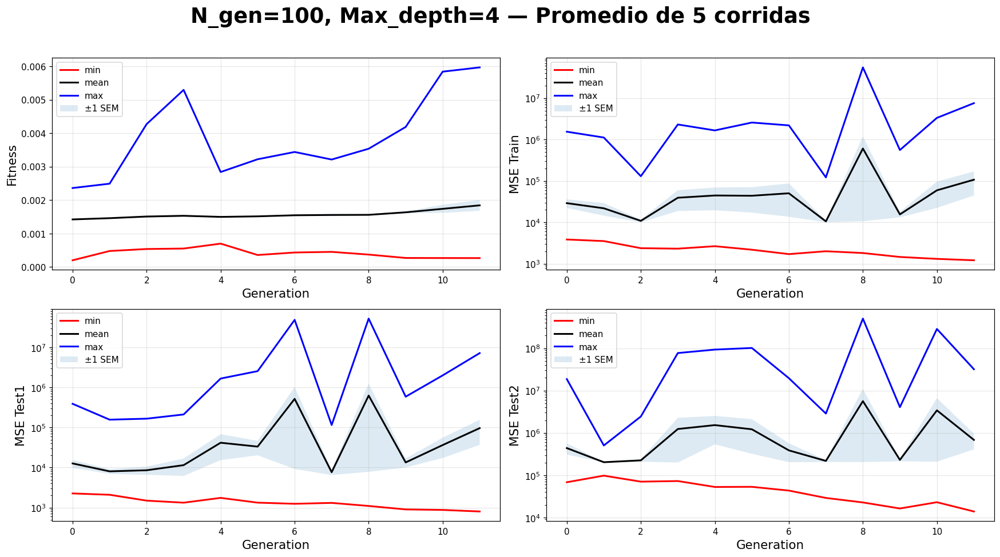

In [82]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 29

- Numero de generaciones = 12
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 34.29it/s]


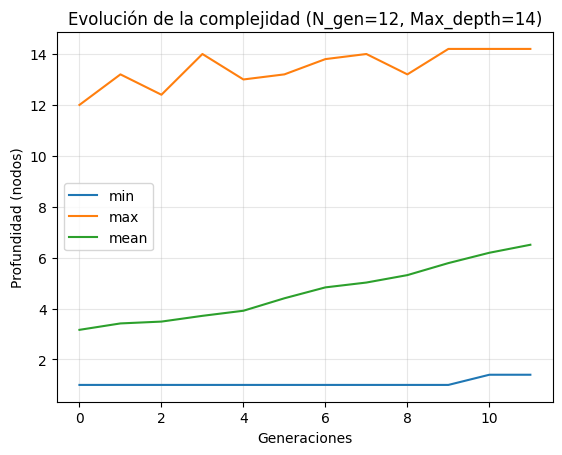

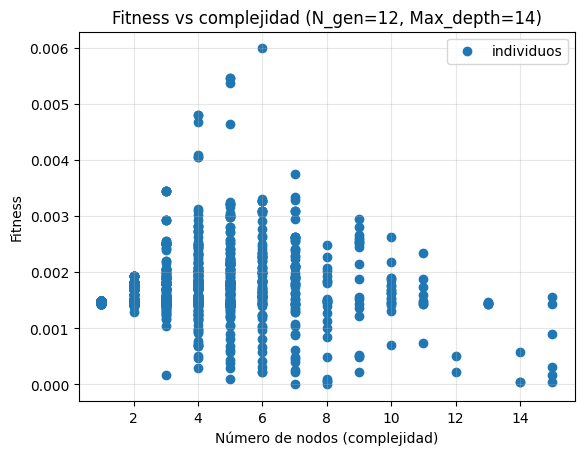

In [83]:
n_gen=12
max_depth=14
prob_mutation=0.10
prob_crossover=0.70
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (plus X1 (plus X1 (times 5.4333696113118455 (minus X1 X1)))) (plus (times (times X1 X1) X1) (times 9.61795506798152 X1)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00598
MSE         : 551.85059
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1**2 + 11.6179550679815)
*******************************************************************
 
                             TREE


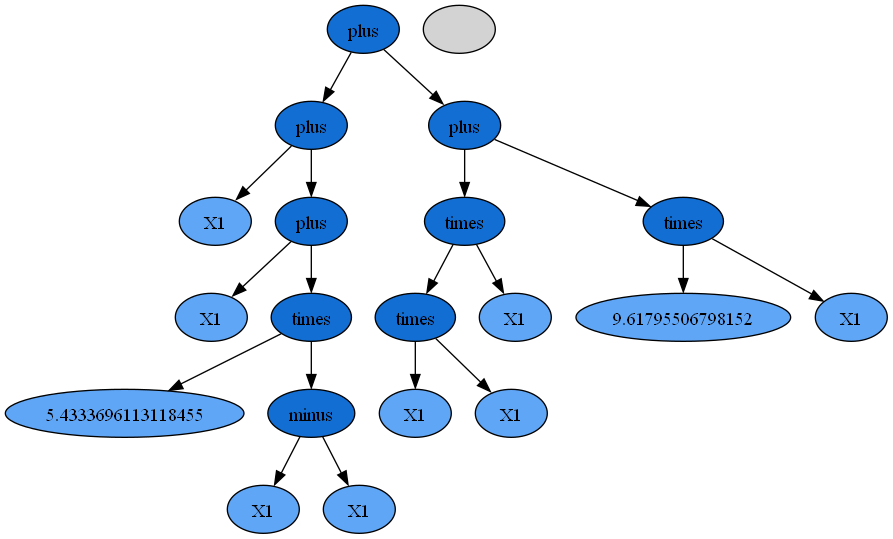

(plus (plus (divide 3.3719162390239985 8.846985920209775) (minus 9.086024167795653 X1)) (times (times X1 X1) (minus (times 1.892212450643469 X1) 1.433303967189149)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.02161
MSE         : 40.98204
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(1.892212450643469*X1 - 1.433303967189149) - X1 + 9.4671614578778379
*******************************************************************
 
                             TREE


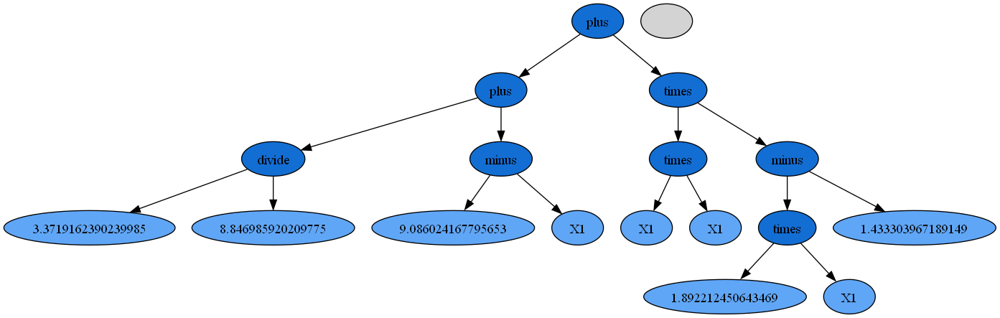

(plus (times X1 (times X1 X1)) (plus (times X1 4.310375893145193) (times X1 7.974904260314217)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00616
MSE         : 521.14747
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1**2 + 12.28528015345941)
*******************************************************************
 
                             TREE


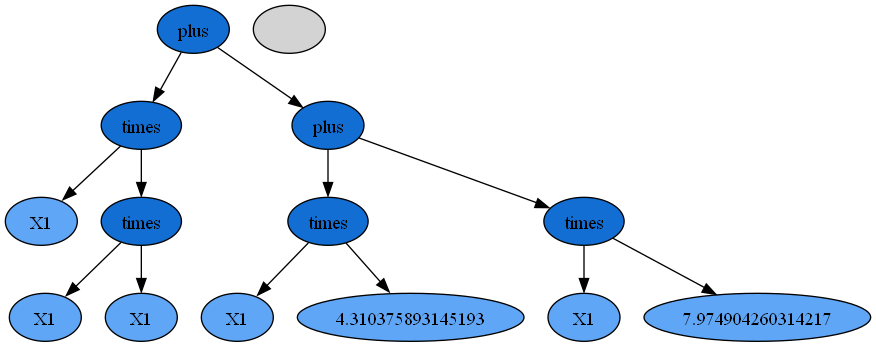

(plus (times (plus 7.951901732069518 X1) (divide 1.420034043887075 0.5017691424488069)) (plus (times X1 (times (plus X1 X1) X1)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00457
MSE         : 947.73451
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 + 3.830054548505749*X1 + 22.50431566611408
*******************************************************************
 
                             TREE


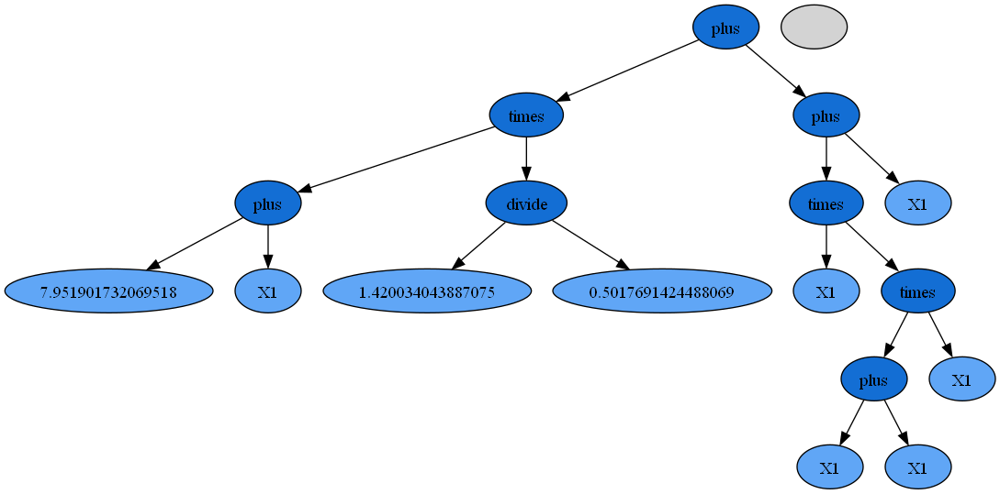

(times (times (times X1 5.192233673236384) (divide X1 4.145926137440093)) (divide (times X1 5.519730060689371) (minus 6.577877260213619 2.9684294537122247)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01582
MSE         : 77.39746
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             1.9151806356639408*X1**3
*******************************************************************
 
                             TREE


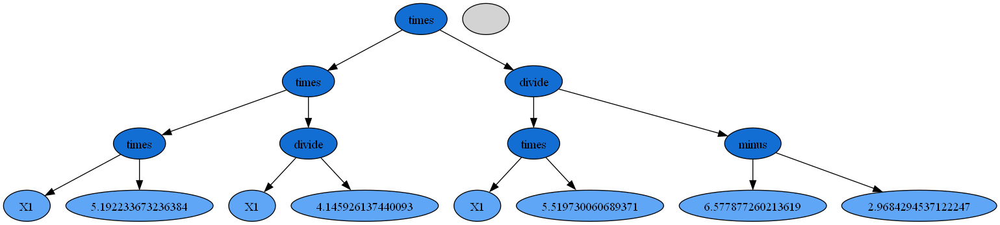

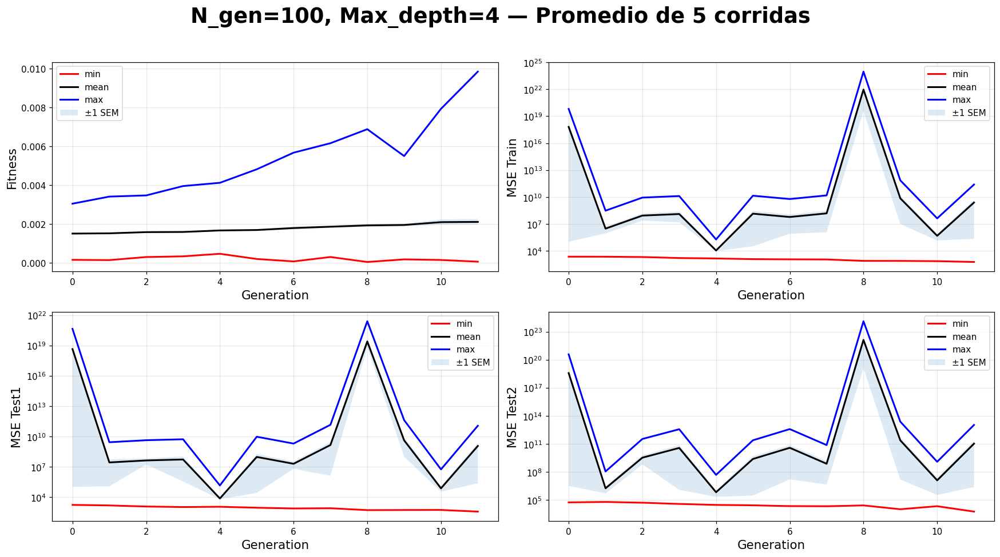

In [84]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 30

- Numero de generaciones = 12
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.7
- Selection Method =Roulette

Generation: 100%|██████████| 12/12 [00:00<00:00, 34.64it/s]


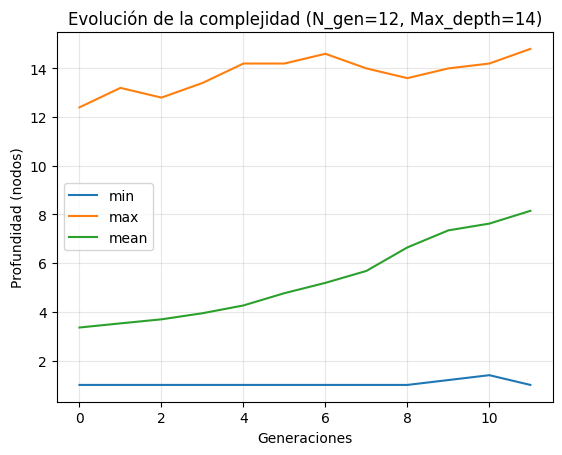

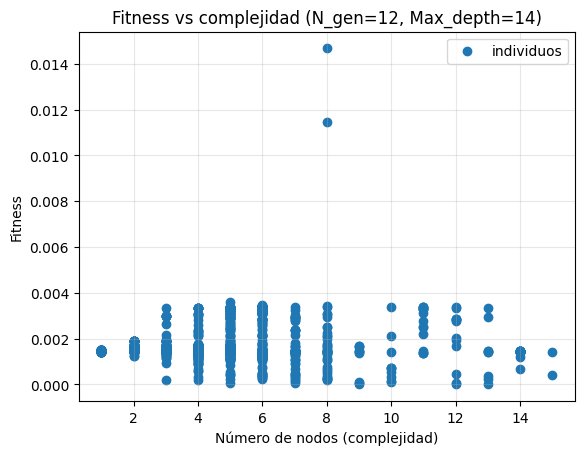

In [85]:
n_gen=12
max_depth=14
prob_mutation=0.10
prob_crossover=0.70
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(minus (times (minus (times (plus 0.05061724883266505 X1) (divide (times X1 (plus X1 X1)) 6.451761936445429)) 0.24975228967161311) 6.451761936445429) (plus X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01467
MSE         : 90.21580
DEPTH       : 8.00000
*******************************************************************
 
                        REDUCED TREE
             X1**2*(2.0*X1 + 0.1012344976653301) - 2*X1 - 1.6113423160434063
*******************************************************************
 
                             TREE


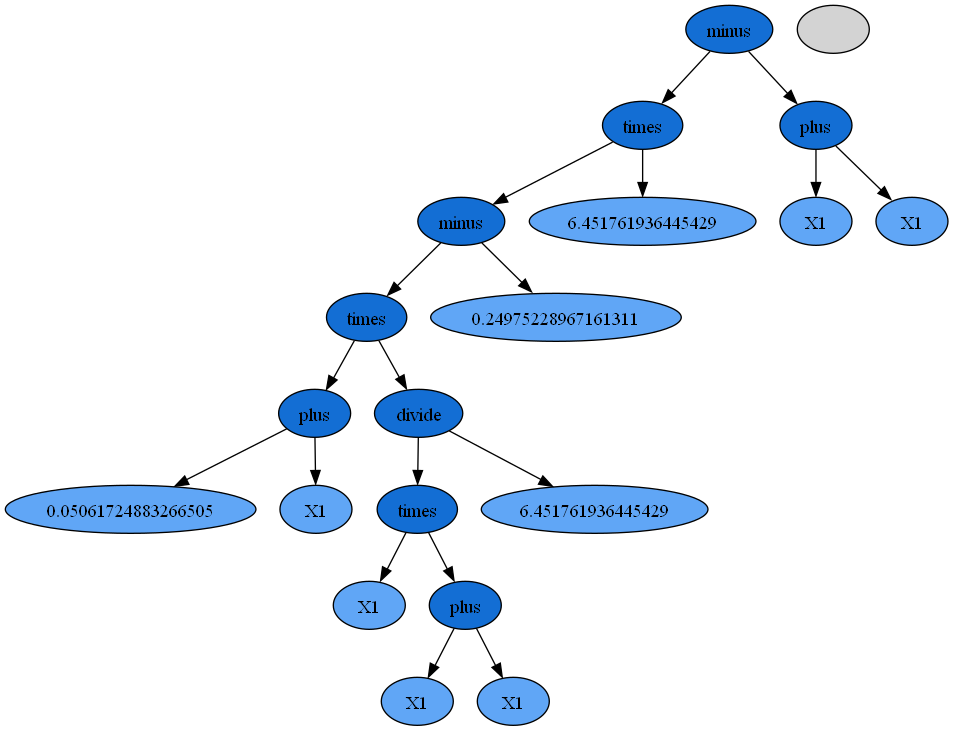

(plus (times (plus 7.285257471314911 6.539176203838258) (plus X1 X1)) (times (minus (divide X1 (plus (minus (plus (plus (divide (plus (plus (divide (plus 9.825914437368292 7.706657998665822) X1) X1) (times (divide (divide X1 4.258189302261423) 3.3068676746921066) X1)) 1.6141647764258682) (minus (divide 1.2835655916917965 (minus 5.740308275758737 X1)) (times (times (minus 7.608555850518874 (plus 1.195533778161031 X1)) (divide (minus 6.031306505697644 9.072950779995768) (times X1 1.136230958363661))) (plus (times X1 (divide X1 9.04403879425417)) (divide (minus 1.3397769720894326 5.339386890939651) (minus 5.077102860016235 X1)))))) (plus 8.938149071580114 (divide 9.105668917241282 X1))) (minus (times 1.463455028076115 6.2419958755146006) X1)) (plus 7.326251853324086 4.6697805103220515))) (times X1 (divide (minus (minus 6.869301075328802 (times (divide (minus (plus (divide (plus X1 2.289425155793289) (plus (plus X1 X1) X1)) (minus (divide 3.606532712006328 2.332562826352078) (divide 8.0258

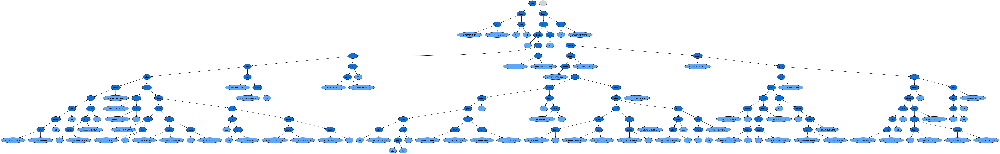

(minus (times (times X1 (plus X1 X1)) X1) (plus 5.612793747587616 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01739
MSE         : 63.87199
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - X1 - 5.612793747587616
*******************************************************************
 
                             TREE


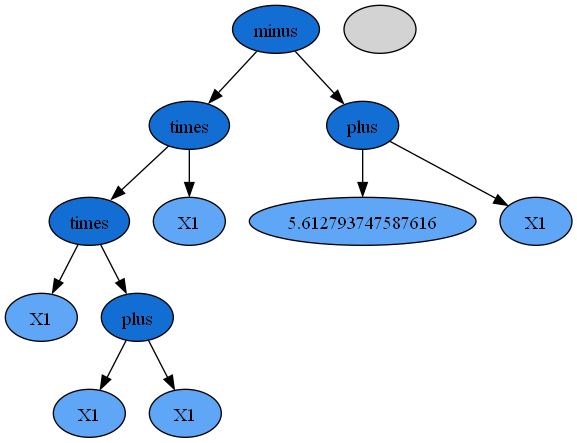

(times (times (plus (divide X1 9.24577442364935) (times X1 5.167186326971156)) (times (plus 6.406291774900627 1.4308902744413043) (divide 0.735029667568946 X1))) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00344
MSE         : 1677.54157
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             30.388941675572165*X1
*******************************************************************
 
                             TREE


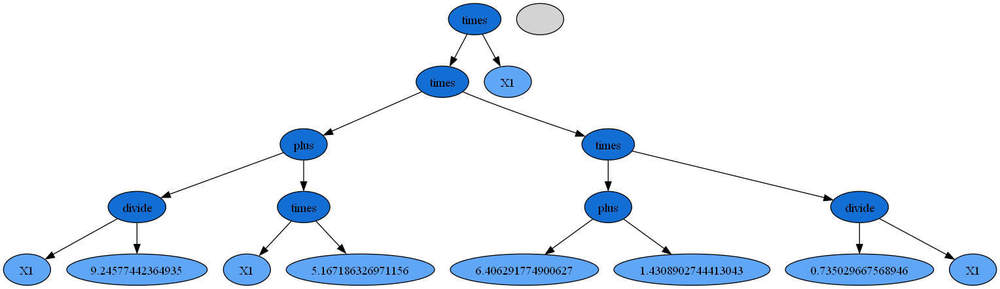

(times (plus (plus (minus (minus (times X1 X1) (plus X1 X1)) (divide X1 X1)) (plus (plus (divide X1 (minus (times X1 (plus X1 X1)) 0.2365056285426259)) (times X1 X1)) (divide X1 4.5317035734093745))) X1) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.04156
MSE         : 10.63473
DEPTH       : 10.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1 + (2*X1**2 - 0.2365056285426259)*(2*X1**2 - 0.77933243342135425*X1 - 1))/(2*X1**2 - 0.2365056285426259)
*******************************************************************
 
                             TREE


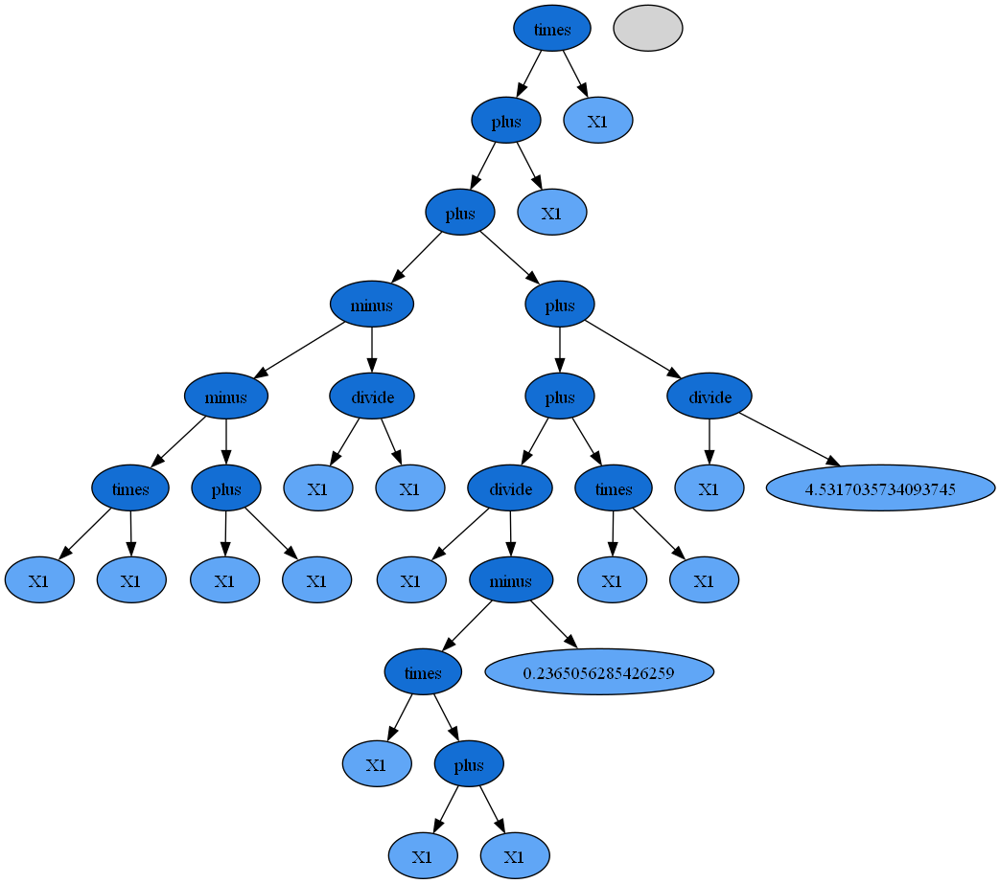

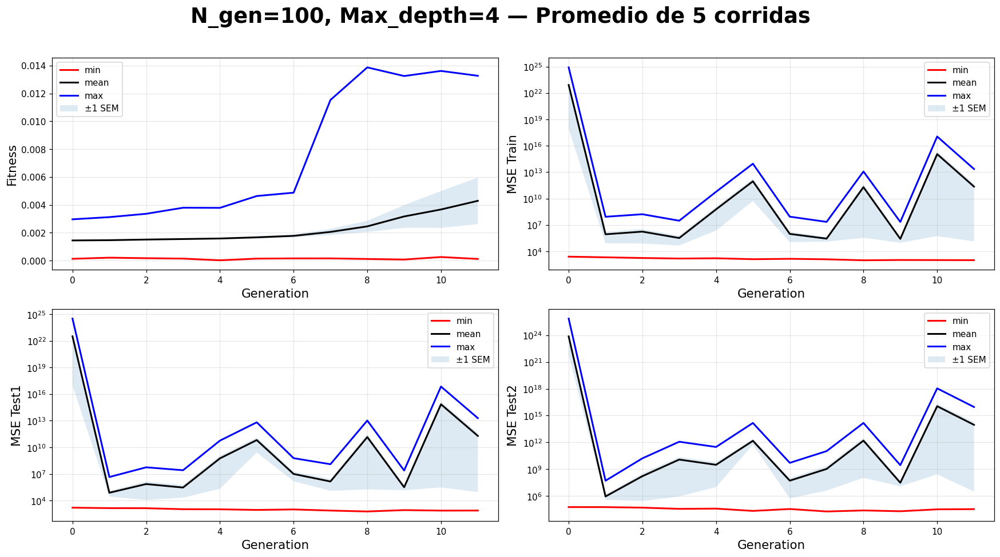

In [86]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 31

- Numero de generaciones = 12
- Máximo de profundidad = 4
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Tournament

Generation: 100%|██████████| 12/12 [00:00<00:00, 33.88it/s]


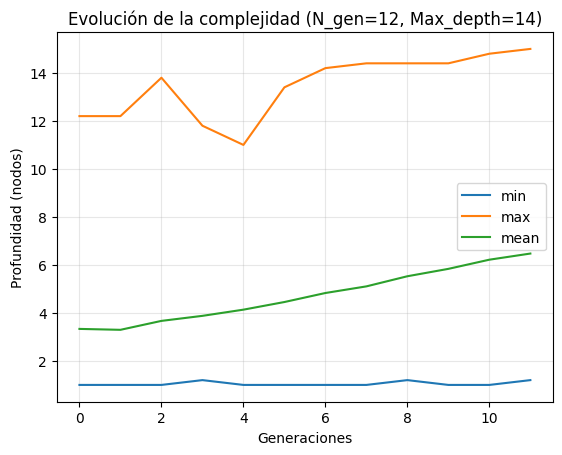

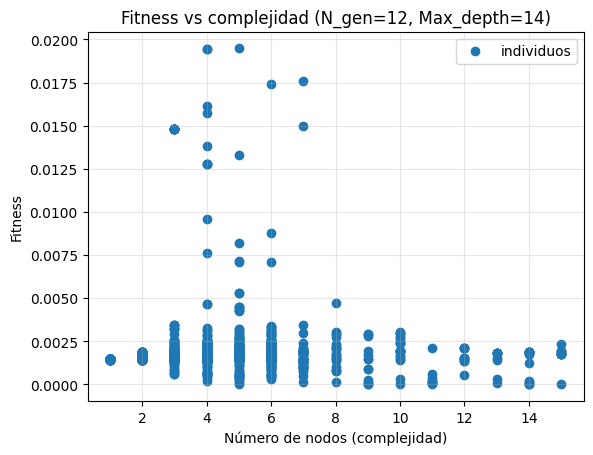

In [87]:
n_gen=12
max_depth=14
prob_mutation=0.10
prob_crossover=0.80
selection_method='tournament'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(plus (times (minus (divide 7.1117968986756965 X1) X1) X1) (plus X1 (times (times 2.019534207982817 X1) (times X1 X1))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01948
MSE         : 50.68744
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2.019534207982817*X1**3 - X1**2 + X1 + 7.1117968986756965
*******************************************************************
 
                             TREE


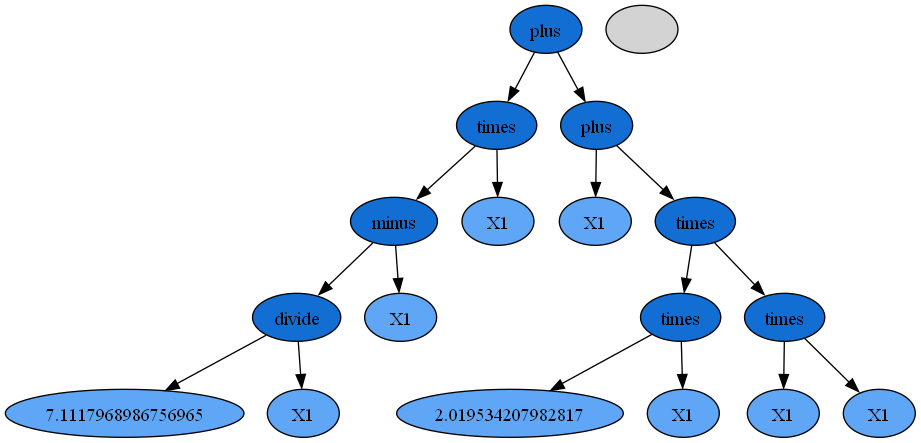

(plus (times (plus (times X1 0.9543328885912827) (times X1 X1)) (times X1 0.9543328885912827)) (plus (minus (times (plus (minus (minus X1 (minus X1 2.039735957595118)) (minus 3.014390353827353 X1)) (times 3.0865919508057704 X1)) 5.268865898394621) (plus X1 4.316981990058815)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00446
MSE         : 997.37167
DEPTH       : 9.00000
*******************************************************************
 
                        REDUCED TREE
             0.9543328885912827*X1**2*(X1 + 0.9543328885912827) + 21.531704970254472*X1 - 9.452305301087237
*******************************************************************
 
                             TREE


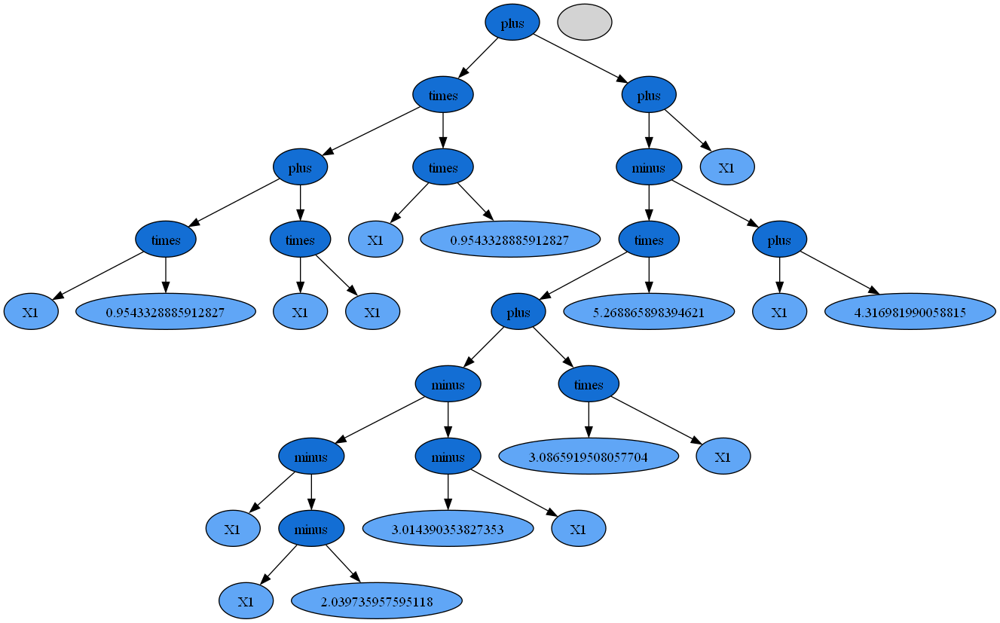

(plus (plus X1 3.194013981847361) (plus (times (plus (times X1 X1) 1.1491759285239045) (times X1 1.4032196779042316)) X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00668
MSE         : 441.61850
DEPTH       : 6.00000
*******************************************************************
 
                        REDUCED TREE
             1.4032196779042316*X1**3 + 3.6125462762786095*X1 + 3.194013981847361
*******************************************************************
 
                             TREE


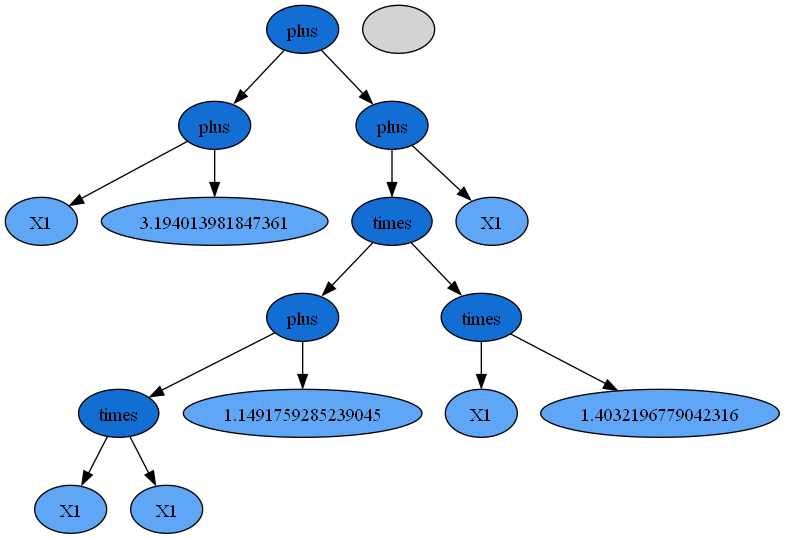

(plus (plus (times (times X1 X1) (plus X1 X1)) (minus X1 2.5903821366334334)) (times (minus (divide 2.8670002116976323 X1) (plus 5.8090188136013055 9.001395882491549)) (times X1 0.20984944918982507)))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01622
MSE         : 73.59660
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - 2.107957366247976*X1 - 1.9887437213815734
*******************************************************************
 
                             TREE


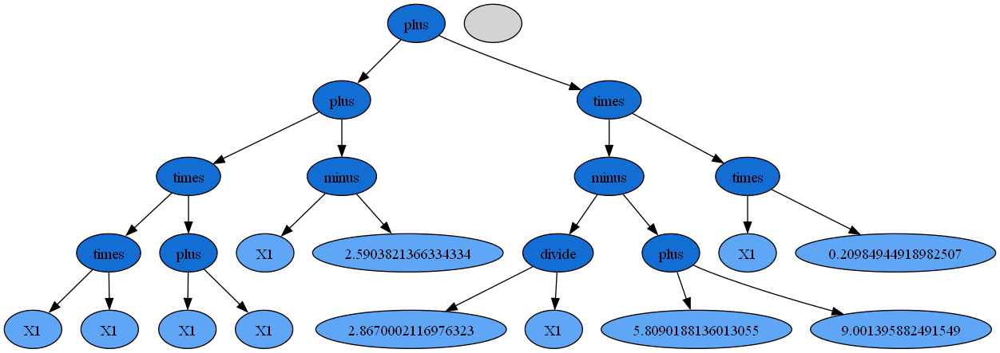

(plus (plus X1 X1) (times (plus X1 X1) (divide (times X1 X1) (divide 8.370660756636006 6.705755634548351))))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00931
MSE         : 226.26084
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(1.60220461191961*X1**2 + 2)
*******************************************************************
 
                             TREE


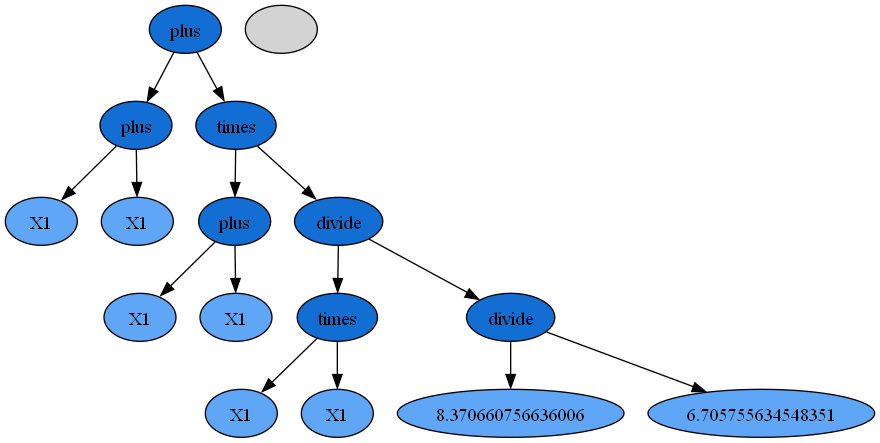

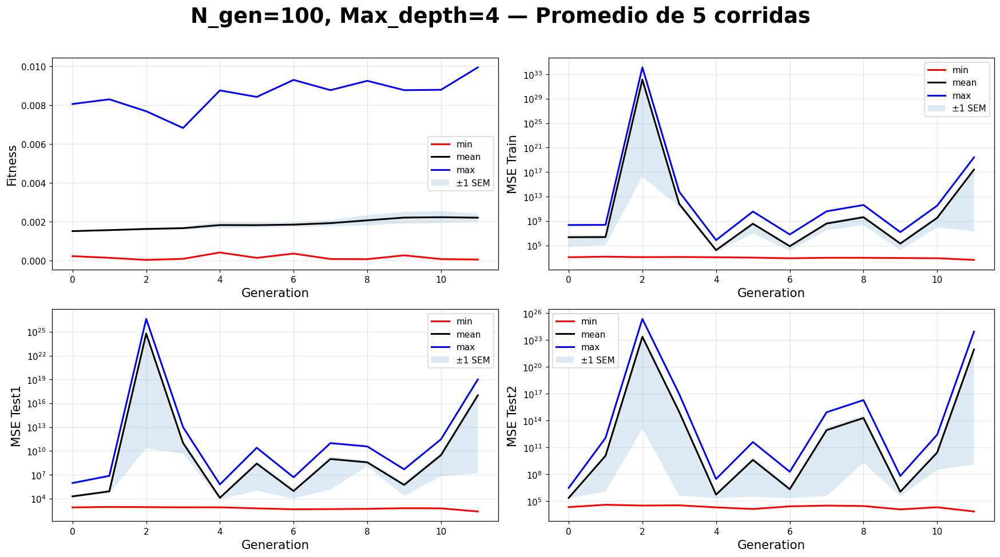

In [88]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')

## Caso 32

- Numero de generaciones = 12
- Máximo de profundidad = 14
- Probabilidad de mutación = 0.10
- Probabilidad de Crossover = 0.8
- Selection Method =Roulette

Generation: 100%|██████████| 12/12 [00:00<00:00, 33.75it/s]


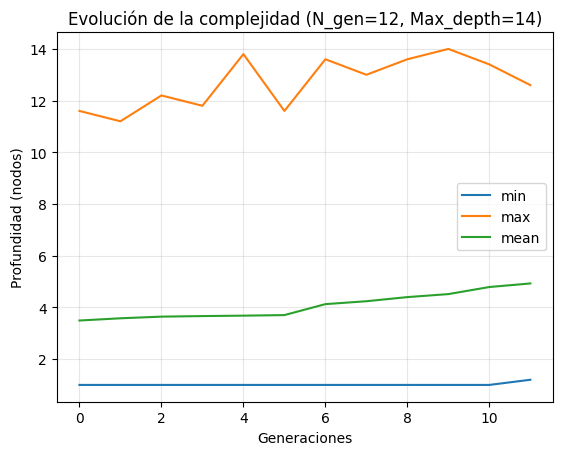

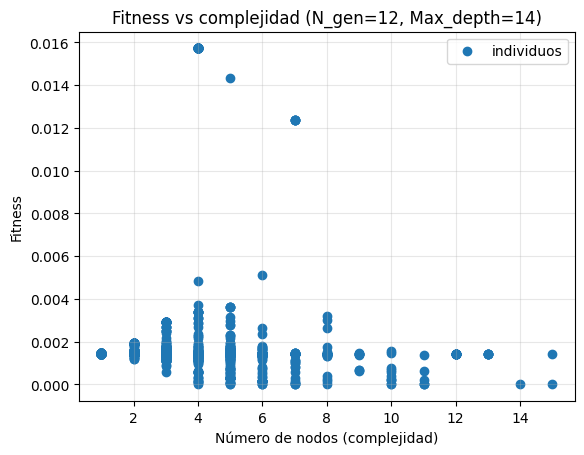

In [89]:
n_gen=12
max_depth=14
prob_mutation=0.10
prob_crossover=0.80
selection_method='roulette'
config = build_gp_config(n_generations=n_gen, max_depth=max_depth, prob_mutation=prob_mutation, prob_crossover=prob_crossover,  selection_method=selection_method)
R1, evo1 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R2, evo2 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R3, evo3 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R4, evo4 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
R5, evo5 = run_gp(config, x_train, y_train, x_test1, y_test1, x_test2, y_test2)
Rt = depth_vs_gen_plot(R1, R2, R3, R4, R5, n_gen, max_depth)
fitness_vs_nodes_plot(Rt, n_gen, max_depth)

(times (times (times X1 X1) X1) 1.9090502053915515)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01572
MSE         : 78.44566
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             1.9090502053915515*X1**3
*******************************************************************
 
                             TREE


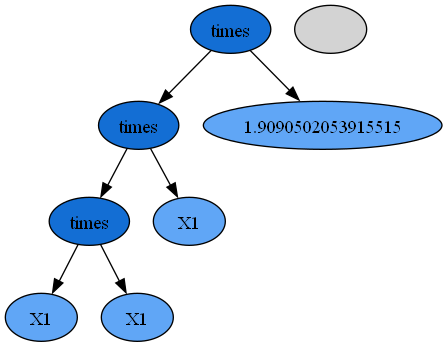

(times (plus X1 (plus X1 X1)) 8.805977358182709)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00332
MSE         : 1801.83694
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             26.41793207454813*X1
*******************************************************************
 
                             TREE


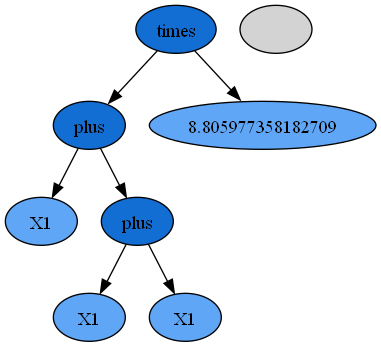

(minus (times (plus (times X1 X1) (times X1 X1)) X1) 7.139156996855878)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.01549
MSE         : 80.79547
DEPTH       : 5.00000
*******************************************************************
 
                        REDUCED TREE
             2*X1**3 - 7.139156996855878
*******************************************************************
 
                             TREE


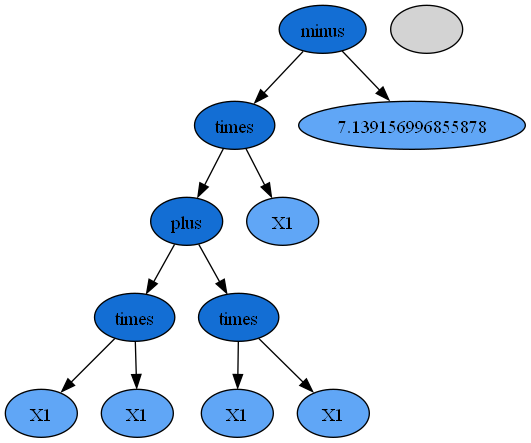

(times (minus (minus (times X1 X1) (divide (divide (divide X1 X1) 4.3943427711994385) 8.383550119601374)) (divide X1 2.5635400226268024)) (plus X1 X1))
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.03048
MSE         : 20.23078
DEPTH       : 7.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(2.0*X1**2 - 0.78017116266850576*X1 - 0.054288532292047893)
*******************************************************************
 
                             TREE


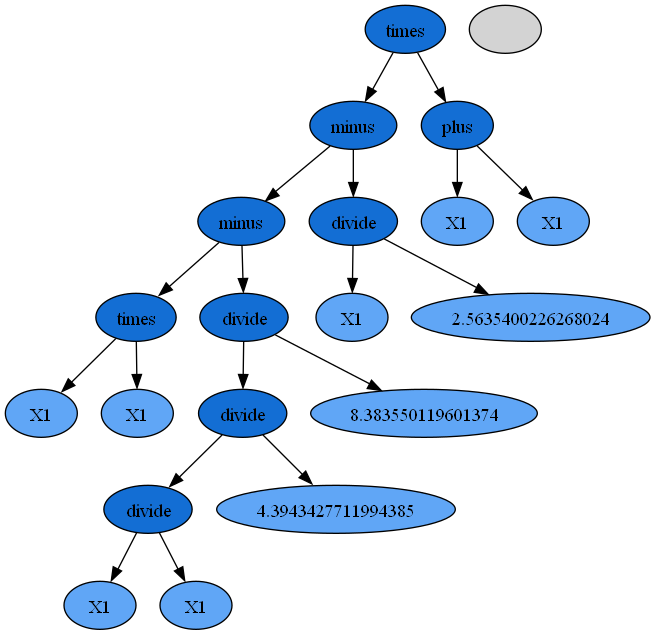

(times (plus (times X1 X1) (plus 0.00885384731762362 9.175417357780717)) X1)
*******************************************************************
                    WINNER TREE, BEST SO FAR 
 
FITNESS     : 0.00521
MSE         : 729.28013
DEPTH       : 4.00000
*******************************************************************
 
                        REDUCED TREE
             X1*(X1**2 + 9.184271205098341)
*******************************************************************
 
                             TREE


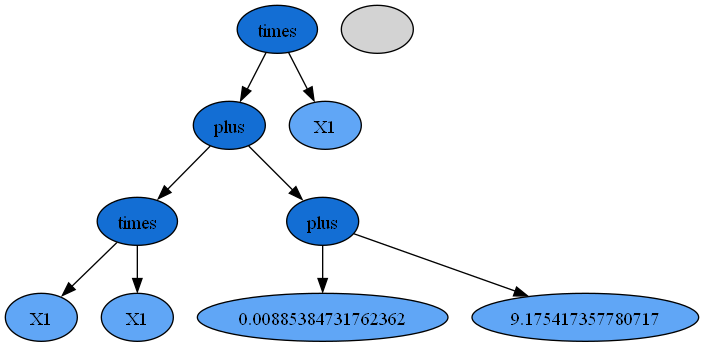

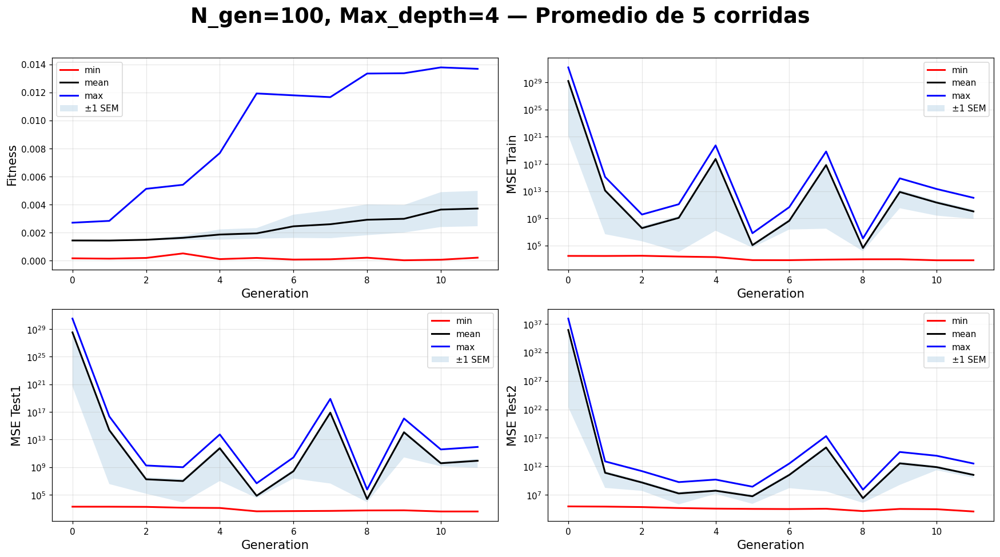

In [90]:
plt.close()
tree_function(evo1)
tree_function(evo2)
tree_function(evo3)
tree_function(evo4)
tree_function(evo5)
R_list = [R1, R2, R3, R4, R5]
Rt = summary_plot_per_gen_multi(R_list, n_gen=100, max_depth=4, title_extra='Promedio de 5 corridas')